<a href="https://colab.research.google.com/github/budennovsk/Pandas/blob/master/forecast_Favorita_Grocery_1_week.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install catboost
!pip install skforecast
!pip install xgboost
!pip install lightgbm
!pip install nolds

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%%time
import pandas as pd
import numpy as np
chunksize = 1_000_000_0  # Размер порции данных
train = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/zvezda/MIO_1/Corporación Favorita Grocery Sales Forecasting/train.csv',chunksize=chunksize,low_memory=False)

# Ленивая фильтрация и группировка
filtered_grouped_data = pd.DataFrame()
io = 0
# Итерация по каждой порции данных

filters = []

ii = 0
for chunk in train:
    # if ii == 0:
    #     # for i in range(1, 2):
    #     #     filter_condition = (chunk['store_nbr'] == i) & (chunk['item_nbr'] == 314384)
    #     #     filters.append(filter_condition)
    #     # for i in range(1, 3):
    #     #     filter_condition = f"(chunk['store_nbr'] == {i}) & (chunk['item_nbr'] == 314384)"
    #     #     filters.append(filter_condition)
    #     # filter_string = ' | '.join(filters)


    #     # grouped_data = chunk.eval(filter_string)
    #     # print(grouped_data)
    #     print('____')

    # Ленивая фильтрация
    # filtered_data = chunk[chunk['column'] > 100]  # Пример фильтрации по значению столбца

    # # Ленивая группировка
    # grouped_data = filtered_data.groupby('column2').sum()  # Пример группировки и суммирования
    # 502331

    grouped_data = chunk[(chunk['store_nbr'] == 1) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 2) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 3) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 4) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 5) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 6) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 7) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 8) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 9) & (chunk['item_nbr'] == 314384) |
                          (chunk['store_nbr'] == 10) & (chunk['item_nbr'] == 314384)
                         ]
    # grouped_data = chunk[np.any(filters, axis=0)]


    infores = chunk['item_nbr'].value_counts().sort_values(ascending=False)[:5]
    # print(infores)

    # Добавление результатов операций в общий DataFrame
    filtered_grouped_data = pd.concat([filtered_grouped_data, grouped_data])
    io+=1
    ii+=1

# # Вывод результата
# print(filtered_grouped_data)
# print(io)

CPU times: user 1min 25s, sys: 32.4 s, total: 1min 58s
Wall time: 2min 24s


In [ ]:
filtered_grouped_data

/usr/local/lib/python3.10/dist-packages/IPython/lib/pretty.py:700: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  output = repr(obj)
/usr/local/lib/python3.10/dist-packages/google/colab/_interactive_table_hint_button.py:178: FutureWarning: In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.
  df_html=dataframe._repr_html_(),  # pylint: disable=protected-access


,id,date,store_nbr,item_nbr,unit_sales,onpromotion
793,793,2013-01-02,1,314384,41.0,NaN
1820,1820,2013-01-02,2,314384,69.0,NaN
2943,2943,2013-01-02,3,314384,143.0,NaN
4126,4126,2013-01-02,4,314384,71.0,NaN
5169,5169,2013-01-02,5,314384,82.0,NaN
...,...,...,...,...,...,...
125405050,125405050,2017-08-15,6,314384,46.0,True
125407310,125407310,2017-08-15,7,314384,42.0,True
125409589,125409589,2017-08-15,8,314384,46.0,True
125411984,125411984,2017-08-15,9,314384,35.0,True


In [ ]:
even_df = filtered_grouped_data[filtered_grouped_data['store_nbr']==10][['date','unit_sales']]
even_df['date'] = pd.to_datetime(even_df['date'])
even_df = even_df.set_index('date')
even_df = even_df.asfreq('D')
even_df

,unit_sales
date,
2013-01-02,16.0
2013-01-03,14.0
2013-01-04,6.0
2013-01-05,8.0
2013-01-06,10.0
...,...
2017-08-11,10.0
2017-08-12,8.0
2017-08-13,5.0


In [ ]:
for i in range(1,11):
    res = filtered_grouped_data[filtered_grouped_data['store_nbr']==i]
    if res.shape[0] < 1600:
        continue
    print(i)

1
2
3
4
5
6
7
8
9
10


In [ ]:
mow = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/zvezda/MIO_1/Corporación Favorita Grocery Sales Forecasting/transactions.csv')
mow

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922
...,...,...,...
83483,2017-08-15,50,2804
83484,2017-08-15,51,1573
83485,2017-08-15,52,2255
83486,2017-08-15,53,932


In [ ]:
test = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/zvezda/MIO_1/Corporación Favorita Grocery Sales Forecasting/test.csv')
test

,id,date,store_nbr,item_nbr,onpromotion
0,125497040,2017-08-16,1,96995,False
1,125497041,2017-08-16,1,99197,False
2,125497042,2017-08-16,1,103501,False
3,125497043,2017-08-16,1,103520,False
4,125497044,2017-08-16,1,103665,False
...,...,...,...,...,...
3370459,128867499,2017-08-31,54,2132163,False
3370460,128867500,2017-08-31,54,2132318,False
3370461,128867501,2017-08-31,54,2132945,False
3370462,128867502,2017-08-31,54,2132957,False


In [ ]:
test[(test['store_nbr']==54) & (test['item_nbr']==96995)]

,id,date,store_nbr,item_nbr,onpromotion
206753,125703793,2017-08-16,54,96995,False
417407,125914447,2017-08-17,54,96995,False
628061,126125101,2017-08-18,54,96995,False
838715,126335755,2017-08-19,54,96995,False
1049369,126546409,2017-08-20,54,96995,False
1260023,126757063,2017-08-21,54,96995,False
1470677,126967717,2017-08-22,54,96995,False
1681331,127178371,2017-08-23,54,96995,False
1891985,127389025,2017-08-24,54,96995,False
2102639,127599679,2017-08-25,54,96995,False


In [ ]:
import numpy as np
# Функция для расчета MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.tsa.stattools import kpss
from statsmodels.tsa.stattools import adfuller


def static_resid(residuals,y_true,SKU,model,name_regress):

    # Работа с остатками после обученя модели

    # График остатков
    plt.subplots(figsize=(22, 6))
    plt.scatter(y_true, residuals)
    plt.axhline(0, color='r', linestyle='--')
    plt.xlabel('Предсказанные значения')
    plt.ylabel('Остатки')
    plt.title(f'SKU_{SKU}_{model}_{name_regress} График остатков')
    plt.show()
    print()

    # Q-Q график
    plt.subplots(figsize=(22, 6))
    stats.probplot(residuals, dist='norm', plot=plt)
    plt.title(f'SKU_{SKU}_{model}_{name_regress} Q-Q график остатков')
    plt.show()
    print()
    # Диаграмма распределения остатков
    plt.figure(figsize=(22, 6))
    sns.histplot(residuals, kde=True)
    plt.xlabel('Остатки')
    plt.ylabel('Частота')
    plt.title(f'SKU_{SKU}_{model}_{name_regress} Диаграмма распределения остатков')
    plt.show()
    print()

    # Визуализация ACF остатков
    fig, ax = plt.subplots(figsize=(22, 6))
    # Построение графика автокорреляционной функции с указанием подграфика для отображения
    plot_acf(residuals, lags=10, ax=ax)
    # Отображение графика
    plt.show()
    print()

    # Визуализация PACF остатков
    fig, ax = plt.subplots(figsize=(22, 6))
    plot_pacf(residuals, lags=10, ax=ax)
    # Отображение графика
    plt.show()
    print()

    print(f"Статисткика по остаткам SKU_{SKU}_{model}_{name_regress}")
    # Применение теста Шапиро-Уилка к остаткам
    shapiro_test = stats.shapiro(residuals)

    # Проверка условия и вывод сообщения
    if shapiro_test.pvalue >= 0.05:
        print('Остатки временного ряда распределены согласно нормальному закону')
    else:
        print('Остатки временного ряда НЕ распределены согласно нормальному закону')
    # Вывод результатов
    print('Статистика теста Шапиро-Уилка :', shapiro_test.statistic)
    print('p-value Шапиро-Уилка :', shapiro_test.pvalue)
    print()
    print('Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках')
    box_pierce = acorr_ljungbox(residuals,boxpierce=True)
    box_pierce['result'] = box_pierce.apply(lambda row: 'белый шум' if row['lb_pvalue'] >= 0.05 and row['bp_pvalue'] >= 0.05 else 'не белый шум', axis=1)
    print(box_pierce)
    # Тест Дарбина-Уотсона
    print()
    dw_test = sm.stats.stattools.durbin_watson(residuals)
    print('Тест Дарбина-Уотсона:', dw_test)
    if dw_test < 1.0:
        print("Положительная автокорреляция первого порядка в остатках.")
    elif dw_test > 3.0:
        print("Отрицательная автокорреляция первого порядка в остатках.")
    else:
        print("Отсутствие автокорреляции первого порядка в остатках.")

    print()

    print('Тест на стационарность КПСС (Kwiatkowski-Phillips-Schmidt-Shin test)')
    #KPSS
    kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')
    # check p-value against significance level
    if p_value < 0.05:
        print('I По p-value, ряд НЕ стационарен метод KPSS')
    else:
        print('I По p-value, ряд стационарен метод KPSS')

    # check KPSS statistic against critical value

    if abs(kpss_stat) > abs(max(crit.values())):
        print('II По значению KPSS статистики, ряд НЕ стационарен метод KPSS')
    else:
        print('II По значению KPSS статистики, ряд стационарен метод KPSS')
    print()
    print('kpss_stat', kpss_stat)
    print('p_value', p_value)
    print('lags', lags)
    print('crit', crit)



    print()
    print('Тест на стационарность Дики-Фуллера (Dickey-Fuller test')
    adf,pvalue,usedlag,nobs,critical_values,icbest = adfuller(residuals)
    print()
    print('Дики — Фуллера проверки на стационарность , \n')
    print('kpss_stat', adf)
    print('pvalue', pvalue)
    print('usedlag', usedlag)
    print('nobs', nobs)
    print('critical_values', critical_values)

    print('Results of Dickey-Fuller Test:')

    if pvalue <= 0.05:
        print('I По p-value, ряд стационарен метод ADF')
    else:
        print('I По p-value, ряд НЕ стационарен метод ADF')

    # check ADF statistic against critical value
    if abs(adf) > abs(max(critical_values.values())):
        print('II По значению ADF статистики, ряд стационарен, метод ADF' )
    else:
        print('II По значению ADF статистики, ряд НЕ стационарен, метод ADF')
    # print('resstore', resstore)

    print()



In [ ]:
import pandas as pd
from catboost import CatBoostRegressor
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm

from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import grid_search_forecaster
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from xgboost import XGBRegressor
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.model_selection import backtesting_forecaster
from skforecast.preprocessing import TimeSeriesDifferentiator
from sklearn.metrics import mean_absolute_error,mean_squared_error, r2_score
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.seasonal import STL
from math import sqrt
from statsmodels.tsa.stattools import acf
from statsmodels.graphics.tsaplots import plot_acf

from skforecast.ForecasterBaseline import ForecasterEquivalentDate
from skforecast.model_selection import backtesting_forecaster
from skforecast.model_selection import grid_search_forecaster
from skforecast.model_selection import bayesian_search_forecaster

from lightgbm import LGBMRegressor

import random


def func_model(data, SKU):
    import matplotlib.pyplot as plt

    random.seed(1)
    np.random.seed(1)

    end_train = '2016-06-01 23:59:59'
    end_valid = '2017-01-01 23:59:59'




    # Добавление прогноза на график
    plt.figure(figsize=(22, 6))
    plt.plot(data.index[data.index<=end_train], data[:end_train], label='Тренеровачные данные')
    plt.plot(data.index[(data.index <= end_valid) & (data.index >= end_train)], data[end_train:end_valid],label='Valid данные')
    plt.plot(data.index[data.index >= end_valid], data[end_valid:],label='Test данные')
    # Добавление точки на график
    # plt.plot(random_date, data.loc[random_date], 'ro')  # 'ro' означает красные круглые маркеры
    # plt.plot(random_date, data.loc[random_date]/1.5, 'yo')  # 'ro' означает красные круглые маркеры

    plt.xlabel('Дата')
    plt.ylabel('Значение')
    plt.title(f'График временного ряда с прогнозом forecaster SKU: {SKU}')
    plt.legend()
    plt.grid(True)
    plt.show()
    # diferenciator = TimeSeriesDifferentiator(order=1)
    # data_diff = diferenciator.fit_transform(data)
    # data_diff = pd.Series(data_diff, index=data.index).dropna()
    # data_diff

    print()
    stl = STL(data, seasonal=13)
    result = stl.fit()

    fig, axes = plt.subplots(4, 1, sharex=False)
    fig.suptitle(f' SKU: {SKU} STL Decomposition', fontsize=16)
    fig.set_size_inches(22, 12)

    # График исходных данных
    axes[0].plot(result.observed)
    axes[0].set_title('Observed')
    axes[0].grid(True)

    # График тренда
    axes[1].plot(result.trend)
    axes[1].set_title('Trend')
    axes[1].grid(True)

    # График сезонности
    axes[2].plot(result.seasonal)
    axes[2].set_title('Seasonality')
    axes[2].grid(True)

    # График остатка
    axes[3].plot(result.resid)
    axes[3].set_title('Residuals')
    axes[3].grid(True)

    # Добавляем пространство между графиками
    plt.subplots_adjust(hspace=0.5)

    # Показываем графики
    plt.show()
    # ===================================


    print()

    #=======================================

    # acf_values_1 = acf(data)

    # Создание подграфика с нужным размером
    fig, ax = plt.subplots(figsize=(22, 6))

    # Построение графика автокорреляционной функции с указанием подграфика для отображения
    plot_acf(data, lags=47, ax=ax)

    # Отображение графика
    plt.show()
    print()


    # Создание подграфика с нужным размером
    fig, ax = plt.subplots(figsize=(22, 6))

    # Построение графика функции частичной автокорреляции с указанием подграфика для отображения
    from statsmodels.graphics.tsaplots import plot_pacf
    plot_pacf(data, lags=47, ax=ax)

    # Отображение графика
    plt.show()

    #=======================================

    # Data partition train-test
    # ==============================================================================


    print(
        f"Train dates : {data.index.min()} --- {data.loc[:end_train].index.max()}  "
        f"(n={len(data.loc[:end_train])})")
    print(
        f"Valid dates  : {data.loc[end_train:].index.min()} --- {data.loc[:end_valid].index.max()}  "
        f"(n={len(data.loc[end_train:end_valid])})")

    print(
        f"Test dates  : {data.loc[end_valid:].index.min()} --- {data.index.max()}  "
        f"(n={len(data.loc[end_valid:])})")



    #=================================метрики R============


    # Forecasting with differentiation
    # ==============================================================================
    steps = len(data.loc[end_train:])



    lags_grid = [4, 8, [1, 2, 3, 27 ,52]]

    # Regressor hyperparameters search space
    def search_space_cb_52(trial):
        search_space  = {
            'depth' : trial.suggest_int('depth', 9, 12, step=1),
            'learning_rate' : trial.suggest_float('learning_rate', 0.01, 0.5),
            'iterations' : trial.suggest_int('iterations', 100, 300, step=100)
        }
        return search_space



    # Regressor hyperparameters search space
    def search_space_gb_52(trial):
        search_space_gb  = {
            'max_depth' : trial.suggest_int('max_depth', 9, 12, step=1),
            # '‍learning_rate' : trial.suggest_float('learning_rate', 0.01, 0.5),
            'reg_alpha' : trial.suggest_float('reg_alpha', 0, 1, step=0.1),
            'reg_lambda' : trial.suggest_float('reg_lambda', 0, 1, step=0.1),
            'n_estimators' : trial.suggest_int('n_estimators', 600, 1200, step=100)
        }
        return search_space_gb




    def search_space_lg_52(trial):
        search_space_lgb  = {
            'n_estimators'  : trial.suggest_int('n_estimators', 600, 1200, step=100),
            'max_depth'     : trial.suggest_int('max_depth', 3, 10, step=1),
            'learning_rate' : trial.suggest_float('learning_rate', 0.01, 0.5),
            'reg_alpha'     : trial.suggest_float('reg_alpha', 0, 1, step=0.1),
            'reg_lambda'    : trial.suggest_float('reg_lambda', 0, 1, step=0.1),
        }
        return search_space_lgb




    calendar_features_52 = pd.DataFrame(index=data.index)
    calendar_features_52['Values'] = data
    calendar_features_52['month'] = calendar_features_52.index.month
    calendar_features_52['week_of_year'] = calendar_features_52.index.isocalendar().week
    calendar_features_52['year'] = calendar_features_52.index.year


    forecaster_cb_52_best_params_exog = ForecasterAutoreg(
                    regressor = CatBoostRegressor(random_state=963,silent=True),
                    lags      = 52,
                    differentiation = 1
                )

    forecaster_gb_52_best_params_exog = ForecasterAutoreg(
                        regressor       = XGBRegressor(random_state=963),
                        lags            = 52,
                        differentiation = 1
                        )

    forecaster_lg_52_best_params_exog = ForecasterAutoreg(
                        regressor       = LGBMRegressor(random_state=963,verbose=-1),
                        lags            = 52,
                        differentiation = 1
                        )

    bayesian_search_forecaster(
                                      forecaster         = forecaster_cb_52_best_params_exog,
                                      y                  = calendar_features_52.loc[:end_valid,'Values'],
                                      exog               = calendar_features_52.loc[:end_valid,['month',	'week_of_year','year']],
                                      steps              = 52,
                                      metric             = 'mean_absolute_error',
                                      search_space       = search_space_cb_52,
                                      lags_grid          = lags_grid,
                                      initial_train_size = len(data[:end_train]),
                                      refit              = False,
                                      n_trials           = 20, # Increase for more exhaustive search
                                      random_state       = 123,
                                      return_best        = True,
                                      n_jobs             = 'auto',
                                      verbose            = False,
                                      show_progress      = False
                                  )


    bayesian_search_forecaster(
                                      forecaster         = forecaster_gb_52_best_params_exog,
                                      y                  = calendar_features_52.loc[:end_valid,'Values'],
                                      exog               = calendar_features_52.loc[:end_valid,['month',	'week_of_year','year']],
                                      steps              = 52,
                                      metric             = 'mean_absolute_error',
                                      search_space       = search_space_gb_52,
                                      lags_grid          = lags_grid,
                                      initial_train_size = len(data[:end_train]),
                                      refit              = False,
                                      n_trials           = 20, # Increase for more exhaustive search
                                      random_state       = 123,
                                      return_best        = True,
                                      n_jobs             = 'auto',
                                      verbose            = False,
                                      show_progress      = False
                                  )

    bayesian_search_forecaster(
                                      forecaster         = forecaster_lg_52_best_params_exog,
                                      y                  = calendar_features_52.loc[:end_valid,'Values'],
                                      exog               = calendar_features_52.loc[:end_valid,['month',	'week_of_year','year']],
                                      steps              = 52,
                                      metric             = 'mean_absolute_error',
                                      search_space       = search_space_lg_52,
                                      lags_grid          = lags_grid,
                                      initial_train_size = len(data[:end_train]),
                                      refit              = False,
                                      n_trials           = 20, # Increase for more exhaustive search
                                      random_state       = 123,
                                      return_best        = True,
                                      n_jobs             = 'auto',
                                      verbose            = False,
                                      show_progress      = False
                                  )


    forecaster_cb_52_best_params_exog.fit(y = calendar_features_52.loc[:end_train,'Values'],
                                          exog =calendar_features_52.loc[:end_train,['month',	'week_of_year','year']]
                                          )

    forecaster_gb_52_best_params_exog.fit(y = calendar_features_52.loc[:end_train,'Values'],
                                          exog =calendar_features_52.loc[:end_train,['month',	'week_of_year','year']]
                                          )

    forecaster_lg_52_best_params_exog.fit(y = calendar_features_52.loc[:end_train,'Values'],
                                          exog =calendar_features_52.loc[:end_train,['month',	'week_of_year','year']]
                                          )


    predict_cb_52_best_params_exog = forecaster_cb_52_best_params_exog.predict(
                                                            steps=steps,
                                                            exog = calendar_features_52.loc[end_train:,['month',	'week_of_year','year']]
                                                                          )

    predict_gb_52_best_params_exog = forecaster_gb_52_best_params_exog.predict(
                                                            steps=steps,
                                                            exog = calendar_features_52.loc[end_train:,['month',	'week_of_year','year']]
                                                                          )

    predict_lg_52_best_params_exog = forecaster_lg_52_best_params_exog.predict(
                                                            steps=steps,
                                                            exog = calendar_features_52.loc[end_train:,['month',	'week_of_year','year']]
                                                                          )



    # Hyperparameters search tuning
    # ==============================================================================
    forecaster_cb_ht = ForecasterAutoreg(
                    regressor = CatBoostRegressor(random_state=963,silent=True),
                    lags      = 52,
                    differentiation = 1
                )
    forecaster_gb_ht = ForecasterAutoreg(
                        regressor       = XGBRegressor(random_state=963),
                        lags            = 52,
                        differentiation = 1
                        )
    forecaster_lgb_ht = ForecasterAutoreg(
                        regressor       = LGBMRegressor(random_state=963,verbose=-1),
                        lags            = 52,
                        differentiation = 1
                        )


    bayesian_search_forecaster(
                                      forecaster         = forecaster_cb_ht,
                                      y                  = calendar_features_52.loc[:end_valid,'Values'],
                                      exog               = calendar_features_52.loc[:end_valid,['month',	'week_of_year','year']],
                                      steps              = 10,
                                      metric             = 'mean_absolute_error',
                                      search_space       = search_space_cb_52,
                                      lags_grid          = lags_grid,
                                      initial_train_size = len(data[:end_train]),
                                      refit              = False,
                                      n_trials           = 20, # Increase for more exhaustive search
                                      random_state       = 123,
                                      return_best        = True,
                                      n_jobs             = 'auto',
                                      verbose            = False,
                                      show_progress      = False
                                  )

    bayesian_search_forecaster(
                                      forecaster         = forecaster_gb_ht,
                                      y                  = calendar_features_52.loc[:end_valid,'Values'],
                                      exog               = calendar_features_52.loc[:end_valid,['month',	'week_of_year','year']],
                                      steps              = 10,
                                      metric             = 'mean_absolute_error',
                                      search_space       = search_space_gb_52,
                                      lags_grid          = lags_grid,
                                      initial_train_size = len(data[:end_train]),
                                      refit              = False,
                                      n_trials           = 20, # Increase for more exhaustive search
                                      random_state       = 123,
                                      return_best        = True,
                                      n_jobs             = 'auto',
                                      verbose            = False,
                                      show_progress      = False
                                  )

    bayesian_search_forecaster(
                                      forecaster         = forecaster_lgb_ht,
                                      y                  = calendar_features_52.loc[:end_valid,'Values'],
                                      exog               = calendar_features_52.loc[:end_valid,['month',	'week_of_year','year']],
                                      steps              = 10,
                                      metric             = 'mean_absolute_error',
                                      search_space       = search_space_lg_52,
                                      lags_grid          = lags_grid,
                                      initial_train_size = len(data[:end_train]),
                                      refit              = False,
                                      n_trials           = 20, # Increase for more exhaustive search
                                      random_state       = 123,
                                      return_best        = True,
                                      n_jobs             = 'auto',
                                      verbose            = False,
                                      show_progress      = False
                                  )

    metric_cb_back_ht, predictions_cb_back_ht = backtesting_forecaster(
                              forecaster         = forecaster_cb_ht,
                              y                  = calendar_features_52['Values'],
                              exog               = calendar_features_52.iloc[:,1:],
                              steps              = 10,
                              metric             = 'mean_absolute_error',
                              initial_train_size = len(data.loc[:end_train]),
                              refit              = False,
                              n_jobs             = 'auto',
                              verbose            = False,
                              show_progress      = False
                          )
    metric_gb_back_ht, predictions_gb_back_ht = backtesting_forecaster(
                              forecaster         = forecaster_gb_ht,
                              y                  = calendar_features_52['Values'],
                              exog               = calendar_features_52.iloc[:,1:],
                              steps              = 10,
                              metric             = 'mean_absolute_error',
                              initial_train_size = len(data.loc[:end_train]),
                              refit              = False,
                              n_jobs             = 'auto',
                              verbose            = False,
                              show_progress      = False
                          )

    metric_lgb_back_ht, predictions_lgb_back_ht = backtesting_forecaster(
                              forecaster         = forecaster_lgb_ht,
                              y                  = calendar_features_52['Values'],
                              exog               = calendar_features_52.iloc[:,1:],
                              steps              = 10,
                              metric             = 'mean_absolute_error',
                              initial_train_size = len(data.loc[:end_train]),
                              refit              = False,
                              n_jobs             = 'auto',
                              verbose            = False,
                              show_progress      = False

                          )



    # backtesting hyper tuning errors___________
    # Расчет MAE

    error_cb_back_ht = mean_absolute_error(data.loc[end_train:], predictions_cb_back_ht)
    error_gb_back_ht = mean_absolute_error(data.loc[end_train:], predictions_gb_back_ht)
    error_lgb_back_ht = mean_absolute_error(data.loc[end_train:], predictions_lgb_back_ht)

    # Расчет RMSE
    error_rmse_cb_back_ht = mean_squared_error(data.loc[end_train:], predictions_cb_back_ht, squared=False)
    error_rmse_gb_back_ht = mean_squared_error(data.loc[end_train:], predictions_gb_back_ht, squared=False)
    error_rmse_lgb_back_ht = mean_squared_error(data.loc[end_train:], predictions_lgb_back_ht, squared=False)

    # Расчет R2
    r2_cb_back_ht = r2_score(data.loc[end_train:], predictions_cb_back_ht)
    r2_gb_back_ht = r2_score(data.loc[end_train:], predictions_gb_back_ht)
    r2_lgb_back_ht = r2_score(data.loc[end_train:], predictions_lgb_back_ht)

    mape_cb_back_ht = mean_absolute_percentage_error(data.loc[end_train:], predictions_cb_back_ht)
    mape_gb_back_ht = mean_absolute_percentage_error(data.loc[end_train:], predictions_gb_back_ht)
    mape_lgb_back_ht = mean_absolute_percentage_error(data.loc[end_train:], predictions_lgb_back_ht)


    # Plot
    fig, ax = plt.subplots(figsize=(22, 6), sharex=True, sharey=True)
    data.loc[:end_train].plot(ax=ax, label='train',color='#1f77b4')
    data.loc[end_train:].plot(ax=ax, label='test',color='black')
    predict_cb_52_best_params_exog.plot(ax=ax, label='Catboost',color='green')
    predict_gb_52_best_params_exog.plot(ax=ax, label='XGB',color='red')
    predict_lg_52_best_params_exog.plot(ax=ax, label='LGBM',color='purple')
    ax.set_title(f'SKU: {SKU} *_1_3 model Forecasting with differentiation Huper tuning EXOG 52 недели рекурентно без добавление новых данных')
    ax.set_xlabel('')
    ax.grid(True)
    ax.legend()
    plt.show()
    print()

    fig, ax = plt.subplots(figsize=(22, 6), sharex=True, sharey=True)
    data.loc[end_train:].plot(ax=ax, label='test', color='black')
    predict_cb_52_best_params_exog.plot(ax=ax, label='Catboost', color='green')
    predict_gb_52_best_params_exog.plot(ax=ax, label='XGB', color='red')
    predict_lg_52_best_params_exog.plot(ax=ax, label='LGBM', color='purple')
    ax.set_title(f'SKU: {SKU} *_1_3 model max SIZE Forecasting with differentiation Huper tuning EXOG 52 недели рекурентно без добавление новых данных')
    ax.set_xlabel('')
    ax.grid(True)
    ax.legend()
    plt.show()
    print()


    dict_regress = {'Catboost':predict_cb_52_best_params_exog,'XGB':predict_gb_52_best_params_exog, 'LGBM':predict_lg_52_best_params_exog}

    for regress in dict_regress:
        residuals = data.loc[end_train:]['unit_sales'] - dict_regress[regress]
        static_resid(residuals,data.loc[end_train:],SKU, '*_1_3 model',regress)




    #================back_ht
    fig, ax = plt.subplots(figsize=(22, 6), sharex=True, sharey=True)
    data.loc[:end_train].plot(ax=ax, label='train',color='#1f77b4')
    data.loc[end_train:].plot(ax=ax, label='test',color='black')
    predictions_cb_back_ht['pred'].plot(ax=ax, label='Catboost',color='green')
    predictions_gb_back_ht['pred'].plot(ax=ax, label='XGB', color='red')
    predictions_lgb_back_ht['pred'].plot(ax=ax, label='XGB',color='purple')
    ax.set_title(f'SKU: {SKU} *_2_3 Forecasting with differentiation with Backtesting with Hyper Tuning + EXOG по 10 недель добавляет данные из test в обучение')
    ax.set_xlabel('')
    ax.grid(True)
    ax.legend()
    plt.show()
    print()

    fig, ax = plt.subplots(figsize=(22, 6), sharex=True, sharey=True)
    data.loc[end_train:].plot(ax=ax, label='test',color='black')
    predictions_cb_back_ht['pred'].plot(ax=ax, label='Catboost',color='green')
    predictions_gb_back_ht['pred'].plot(ax=ax, label='XGB', color='red')
    predictions_lgb_back_ht['pred'].plot(ax=ax, label='XGB',color='purple')
    ax.set_title(f'SKU: {SKU} *_2_3 max SIZE Forecasting with differentiation with Backtesting with Hyper Tuning + EXOG по 10 недель добавляет данные из test в обучение')
    ax.set_xlabel('')
    ax.grid(True)
    ax.legend()
    plt.show()
    print()


    dict_regress_2 = {'Catboost':predictions_cb_back_ht,'XGB':predictions_gb_back_ht, 'LGBM':predictions_lgb_back_ht}

    for regress_2 in dict_regress_2:
        residuals_2 = data.loc[end_train:]['unit_sales'] - dict_regress[regress_2]
        static_resid(residuals_2,data.loc[end_train:],SKU, '*_2_3 model',regress_2)



    #==============52 недели без обучения + EXOG дучшая модель ================


    # Расчет MAE

    error_cb_ht_52_exog = mean_absolute_error(data.loc[end_train:], predict_cb_52_best_params_exog)
    error_gb_ht_52_exog = mean_absolute_error(data.loc[end_train:], predict_gb_52_best_params_exog)
    error_lgb_ht_52_exog = mean_absolute_error(data.loc[end_train:], predict_lg_52_best_params_exog)

    # Расчет RMSE
    error_rmse_cb_ht_52_exog = mean_squared_error(data.loc[end_train:], predict_cb_52_best_params_exog, squared=False)
    error_rmse_gb_ht_52_exog = mean_squared_error(data.loc[end_train:], predict_gb_52_best_params_exog, squared=False)
    error_rmse_lgb_ht_52_exog = mean_squared_error(data.loc[end_train:], predict_lg_52_best_params_exog, squared=False)

    # Расчет R2
    r2_cb_back_ht_52_exog = r2_score(data.loc[end_train:], predict_cb_52_best_params_exog)
    r2_gb_back_ht_52_exog = r2_score(data.loc[end_train:], predict_gb_52_best_params_exog)
    r2_lgb_back_ht_52_exog = r2_score(data.loc[end_train:], predict_lg_52_best_params_exog)

    mape_cb_back_ht_52_exog = mean_absolute_percentage_error(data.loc[end_train:], predict_cb_52_best_params_exog)
    mape_gb_back_ht_52_exog = mean_absolute_percentage_error(data.loc[end_train:], predict_gb_52_best_params_exog)
    mape_lgb_back_ht_52_exog = mean_absolute_percentage_error(data.loc[end_train:], predict_lg_52_best_params_exog)



    print()
    print(f'SKU: {SKU} *_1_3 model Ошибки при прогнозе Catboost прогноз + huper tuning + EXOG на 52 недели без добавление новых данных без переучивании,XGB')
    # Вывод результатов
    print(f"Error (MAE) - средняя абсолютная ошибка Catboost: {error_cb_ht_52_exog:.2f}")
    print(f"Error (MAE) - средняя абсолютная ошибка XGB: {error_gb_ht_52_exog:.2f}")
    print(f"Error (MAE) - средняя абсолютная ошибка LGBM: {error_lgb_ht_52_exog:.2f}")
    print(f"Error (RMSE) - Среднеквадратичная ошибка Catboost: {error_rmse_cb_ht_52_exog:.2f}")
    print(f"Error (RMSE) - Среднеквадратичная ошибка XGB: {error_rmse_gb_ht_52_exog:.2f}")
    print(f"Error (RMSE) - Среднеквадратичная ошибка LGBM: {error_rmse_lgb_ht_52_exog:.2f}")
    print(f"R2 - Коэффициент детерминации Catboost: {r2_cb_back_ht_52_exog:.2f}")
    print(f"R2 - Коэффициент детерминации XGB: {r2_gb_back_ht_52_exog:.2f}")
    print(f"R2 - Коэффициент детерминации LGBM: {r2_lgb_back_ht_52_exog:.2f}")
    print(f"MAPE - Средняя абсолютная процентная ошибка Catboost: {mape_cb_back_ht_52_exog:.2f} %")
    print(f"MAPE - Средняя абсолютная процентная ошибка XGB: {mape_gb_back_ht_52_exog:.2f} %")
    print(f"MAPE - Средняя абсолютная процентная ошибка lGBM: {mape_lgb_back_ht_52_exog:.2f} %")
    print()
    print()




    #Backtesting hyper tuning ______________errors

    print(f'SKU: {SKU} *_2_3 model Ошибки при прогнозе backtesting hyper tuning + EXOG Catboost,XGB, LGB по 10 недель добавляет данные из test в обучение')
    # Вывод результатов
    print(f"Error backtesting hyper tuning (MAE) - средняя абсолютная ошибка Catboost: {error_cb_back_ht:.2f}")
    print(f"Error backtesting hyper tuning (MAE) - средняя абсолютная ошибка XGB: {error_gb_back_ht:.2f}")
    print(f"Error backtesting hyper tuning (MAE) - средняя абсолютная ошибка LGBM: {error_lgb_back_ht:.2f}")
    print(f"Error backtesting hyper tuning (RMSE) - Среднеквадратичная ошибка Catboost: {error_rmse_cb_back_ht:.2f}")
    print(f"Error backtesting hyper tuning (RMSE) - Среднеквадратичная ошибка XGB: {error_rmse_gb_back_ht:.2f}")
    print(f"Error backtesting hyper tuning (RMSE) - Среднеквадратичная ошибка LGBM: {error_rmse_lgb_back_ht:.2f}")
    print(f"R2 - backtesting hyper tuning Коэффициент детерминации Catboost: {r2_cb_back_ht:.2f}")
    print(f"R2 - backtesting hyper tuning Коэффициент детерминации XGB: {r2_gb_back_ht:.2f}")
    print(f"R2 - backtesting hyper tuning Коэффициент детерминации LGBM: {r2_lgb_back_ht:.2f}")
    print(f"MAPE - backtesting hyper tuning Средняя абсолютная процентная ошибка Catboost: {mape_cb_back_ht:.2f} %")
    print(f"MAPE - backtesting hyper tuning Средняя абсолютная процентная ошибка XGB: {mape_gb_back_ht:.2f} %")
    print(f"MAPE - backtesting hyper tuning Средняя абсолютная процентная ошибка LGBM: {mape_lgb_back_ht:.2f} %")
    print()

    print()


    #   #=================================метрики R============
    # import nolds
    # from scipy.stats import entropy
    # from scipy.fft import fft
    # from statsmodels.stats.diagnostic import acorr_ljungbox
    # from statsmodels.tsa.stattools import adfuller


    # from statsmodels.tsa.stattools import kpss

    # coef_hurst = nolds.hurst_rs(data)




    # # Применение быстрого преобразования Фурье (FFT) к временному ряду
    # fft_result = fft(data.values.tolist())
    # # Вычисление амплитудного спектра
    # amplitude_spectrum = np.abs(fft_result)
    # # Нормализация амплитудного спектра
    # normalized_spectrum = amplitude_spectrum / np.sum(amplitude_spectrum)
    # # Вычисление спектральной энтропии
    # feat_spectral = entropy(normalized_spectrum,base=len(data))


    # box_pierce = acorr_ljungbox(data,boxpierce=True)
    # ljung_box = acorr_ljungbox(data)



    #   #=============================
    # kpss_stat,p_value, lags,crit = kpss(data,regression = 'ct')



    # #=============================

    # adf,pvalue,usedlag,nobs,critical_values,icbest = adfuller(data)




    # # sm.graphics.tsa.plot_pacf(data, lags=52, method="ywm")
    # # plt.show()

    # unitroot_kpss = kpss(data,regression = 'ct')

    # shift_level_index= data.rolling(window=10).mean().idxmax()


    # print()
    # print(f'SKU: {SKU} CТАТИСТИКА ОСНОВАНАЯ НА R')
    # print()
    # print('coef_hurst коэффициент Херста',coef_hurst)
    # if coef_hurst < 0.5:
    #     print("Ряд имеет антипериодическую зависимость (значения в противоположных направлениях)")
    # elif coef_hurst == 0.5:
    #     print("Ряд не имеет зависимости")
    # else:
    #     print("Ряд имеет периодическую зависимость (значения в одном направлении)")
    # print()
    # print('feat_spectral спектральную энтропию (Шеннона)',feat_spectral)
    # print()
    # print('box_pierce статистика Бокс-Пирса для проверки того, является ли временной ряд белым шумом,\n',box_pierce)
    # print()
    # print('ljung_box cтатистика Юнга-Бокса для проверки того, является ли временной ряд белым шумом,\n',ljung_box)
    # print()
    # print('shift_level_index указывает индекс, при котором происходит наибольший средний сдвиг',shift_level_index)
    # print()
    # print('____________________________________')
    # print()
    # print('unitroot_kpss статистика Квятковского-Филлипса-Шмидта-Шина (KPSS) для проверки, является ли ряд стационарным, \n')
    # print()
    # # check p-value against significance level
    # if p_value < 0.05:
    #     print('I По p-value, ряд НЕ стационарен метод KPSS')
    # else:
    #     print('I По p-value, ряд стационарен метод KPSS')

    # # check KPSS statistic against critical value

    # if abs(kpss_stat) > abs(max(crit.values())):
    #     print('II По значению KPSS статистики, ряд НЕ стационарен метод KPSS')
    # else:
    #     print('II По значению KPSS статистики, ряд стационарен метод KPSS')
    # print()
    # print('kpss_stat', kpss_stat)
    # print('p_value', p_value)
    # print('lags', lags)
    # print('crit', crit)
    # # print('resstore', resstore)
    # print()
    # print('Дики — Фуллера проверки на стационарность , \n')
    # print('kpss_stat', adf)
    # print('pvalue', pvalue)
    # print('usedlag', usedlag)
    # print('nobs', nobs)
    # print('critical_values', critical_values)

    # print('Results of Dickey-Fuller Test:')

    # if pvalue <= 0.05:
    #     print('I По p-value, ряд стационарен метод ADF')
    # else:
    #     print('I По p-value, ряд НЕ стационарен метод ADF')

    # # check ADF statistic against critical value
    # if abs(adf) > abs(max(critical_values.values())):
    #     print('II По значению ADF статистики, ряд стационарен, метод ADF' )
    # else:
    #     print('II По значению ADF статистики, ряд НЕ стационарен, метод ADF')
    # # print('resstore', resstore)

    # print()


In [ ]:
def static_stacionar(data, SKU):
    import matplotlib.pyplot as plt

    random.seed(1)
    np.random.seed(1)

    end_train = '2016-06-01 23:59:59'
    end_valid = '2017-01-01 23:59:59'





    # Добавление прогноза на график
    plt.figure(figsize=(22, 6))
    plt.plot(data.index[data.index<=end_train], data[:end_train], label='Тренеровачные данные')
    plt.plot(data.index[(data.index <= end_valid) & (data.index >= end_train)], data[end_train:end_valid],label='Valid данные')
    plt.plot(data.index[data.index >= end_valid], data[end_valid:],label='Test данные')
    # Добавление точки на график

    plt.xlabel('Дата')
    plt.ylabel('Значение')
    plt.title(f'График временного ряда с прогнозом forecaster SKU: {SKU}')
    plt.legend()
    plt.grid(True)
    plt.show()
    # diferenciator = TimeSeriesDifferentiator(order=1)
    # data_diff = diferenciator.fit_transform(data)
    # data_diff = pd.Series(data_diff, index=data.index).dropna()
    # data_diff

    print()
    stl = STL(data, seasonal=13)
    result = stl.fit()

    fig, axes = plt.subplots(4, 1, sharex=False)
    fig.suptitle(f' SKU: {SKU} STL Decomposition', fontsize=16)
    fig.set_size_inches(22, 12)

    # График исходных данных
    axes[0].plot(result.observed)
    axes[0].set_title('Observed')
    axes[0].grid(True)

    # График тренда
    axes[1].plot(result.trend)
    axes[1].set_title('Trend')
    axes[1].grid(True)

    # График сезонности
    axes[2].plot(result.seasonal)
    axes[2].set_title('Seasonality')
    axes[2].grid(True)

    # График остатка
    axes[3].plot(result.resid)
    axes[3].set_title('Residuals')
    axes[3].grid(True)

    # Добавляем пространство между графиками
    plt.subplots_adjust(hspace=0.5)

    # Показываем графики
    plt.show()
    # ===================================


    print()

    #=======================================

    # acf_values_1 = acf(data)

    # Создание подграфика с нужным размером
    fig, ax = plt.subplots(figsize=(22, 6))

    # Построение графика автокорреляционной функции с указанием подграфика для отображения
    plot_acf(data, lags=47, ax=ax)

    # Отображение графика
    plt.show()
    print()


    # Создание подграфика с нужным размером
    fig, ax = plt.subplots(figsize=(22, 6))

    # Построение графика функции частичной автокорреляции с указанием подграфика для отображения
    from statsmodels.graphics.tsaplots import plot_pacf
    plot_pacf(data, lags=47, ax=ax)

    # Отображение графика
    plt.show()

    print()
    import nolds
    from scipy.stats import entropy
    from scipy.fft import fft
    from statsmodels.stats.diagnostic import acorr_ljungbox
    from statsmodels.tsa.stattools import adfuller


    from statsmodels.tsa.stattools import kpss


    coef_hurst = nolds.hurst_rs(data)




    # Применение быстрого преобразования Фурье (FFT) к временному ряду
    fft_result = fft(data.values.tolist())
    # Вычисление амплитудного спектра
    amplitude_spectrum = np.abs(fft_result)
    # Нормализация амплитудного спектра
    normalized_spectrum = amplitude_spectrum / np.sum(amplitude_spectrum)
    # Вычисление спектральной энтропии
    feat_spectral = entropy(normalized_spectrum,base=len(data))


    box_pierce = acorr_ljungbox(data,boxpierce=True)
    ljung_box = acorr_ljungbox(data)
    #=============================
    kpss_stat,p_value, lags,crit = kpss(data,regression = 'ct')



    #=============================

    adf,pvalue,usedlag,nobs,critical_values,icbest = adfuller(data)




    # sm.graphics.tsa.plot_pacf(data, lags=52, method="ywm")
    # plt.show()

    unitroot_kpss = kpss(data,regression = 'ct')

    shift_level_index= data.rolling(window=10).mean().idxmax()
    print()
    print(f'SKU: {SKU} CТАТИСТИКА ОСНОВАНАЯ НА R')
    print()
    print('coef_hurst коэффициент Херста',coef_hurst)
    if coef_hurst < 0.5:
        print("Ряд имеет антипериодическую зависимость (значения в противоположных направлениях)")
    elif coef_hurst == 0.5:
        print("Ряд не имеет зависимости")
    else:
        print("Ряд имеет периодическую зависимость (значения в одном направлении)")
    print()
    print('feat_spectral спектральную энтропию (Шеннона)',feat_spectral)
    print()
    print('box_pierce статистика Бокс-Пирса для проверки того, является ли временной ряд белым шумом,\n',box_pierce)
    print()
    print('ljung_box cтатистика Юнга-Бокса для проверки того, является ли временной ряд белым шумом,\n',ljung_box)
    print()
    print('shift_level_index указывает индекс, при котором происходит наибольший средний сдвиг',shift_level_index)
    print()
    print('____________________________________')
    print()
    print('unitroot_kpss статистика Квятковского-Филлипса-Шмидта-Шина (KPSS) для проверки, является ли ряд стационарным, \n')
    print()
    # check p-value against significance level
    if p_value < 0.05:
        print('I По p-value, ряд НЕ стационарен метод KPSS')
    else:
        print('I По p-value, ряд стационарен метод KPSS')

    # check KPSS statistic against critical value

    if abs(kpss_stat) > abs(max(crit.values())):
        print('II По значению KPSS статистики, ряд НЕ стационарен метод KPSS')
    else:
        print('II По значению KPSS статистики, ряд стационарен метод KPSS')
    print()
    print('kpss_stat', kpss_stat)
    print('p_value', p_value)
    print('lags', lags)
    print('crit', crit)
    # print('resstore', resstore)
    print()
    print('Дики — Фуллера проверки на стационарность , \n')
    print('kpss_stat', adf)
    print('pvalue', pvalue)
    print('usedlag', usedlag)
    print('nobs', nobs)
    print('critical_values', critical_values)

    print('Results of Dickey-Fuller Test:')

    if pvalue <= 0.05:
        print('I По p-value, ряд стационарен метод ADF')
    else:
        print('I По p-value, ряд НЕ стационарен метод ADF')

    # check ADF statistic against critical value
    if abs(adf) > abs(max(critical_values.values())):
        print('II По значению ADF статистики, ряд стационарен, метод ADF' )
    else:
        print('II По значению ADF статистики, ряд НЕ стационарен, метод ADF')
    # print('resstore', resstore)

    print()



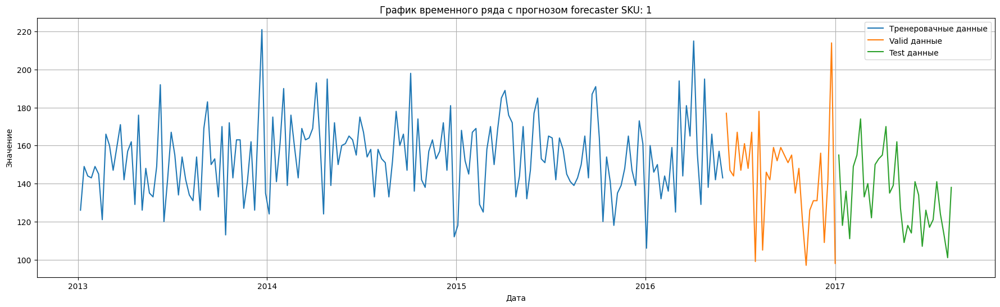

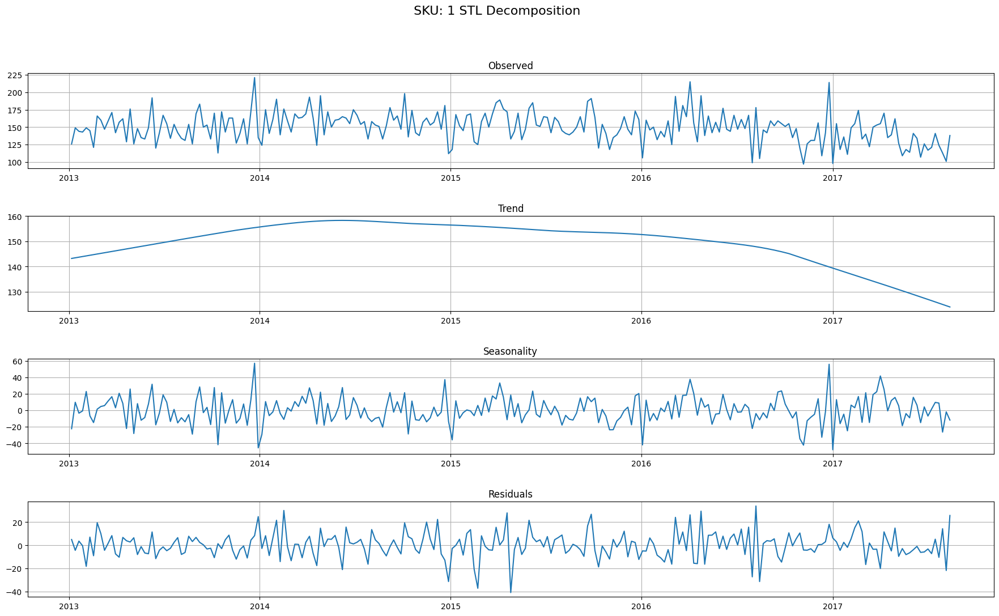

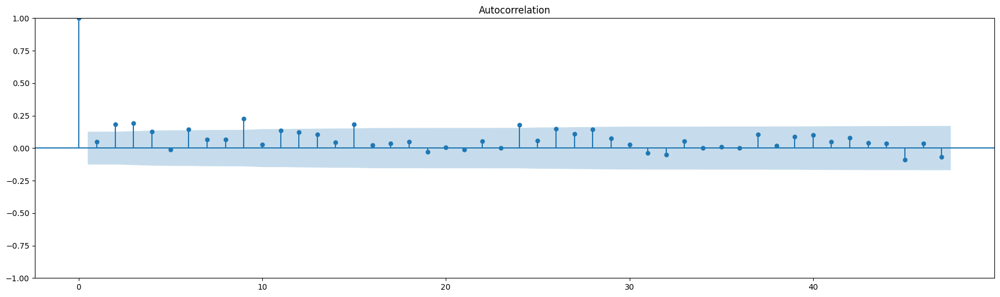

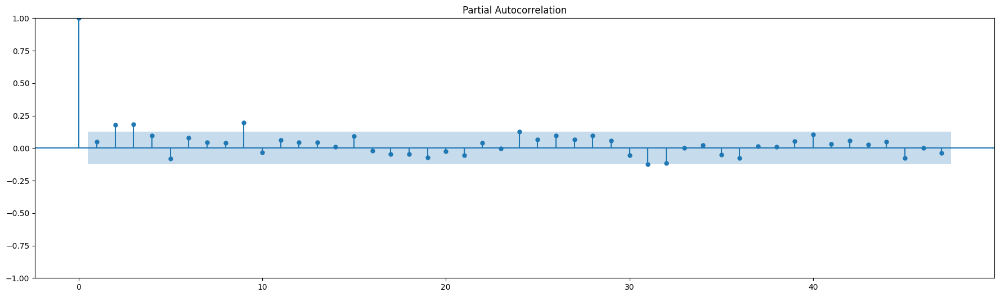

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'depth': 10, 'learning_rate': 0.17815722791392602, 'iterations': 300}
  Backtesting metric: 17.410585562582902

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'max_depth': 12, 'reg_alpha': 0.7000000000000001, 'reg_lambda': 0.8, 'n_estimators': 600}
  Backtesting metric: 17.507611536450923

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found l

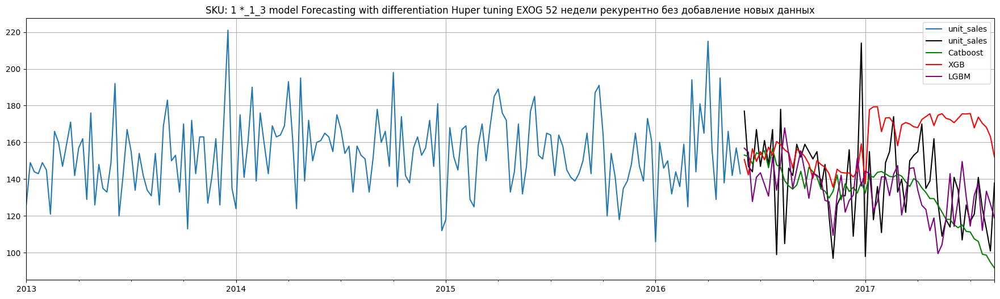

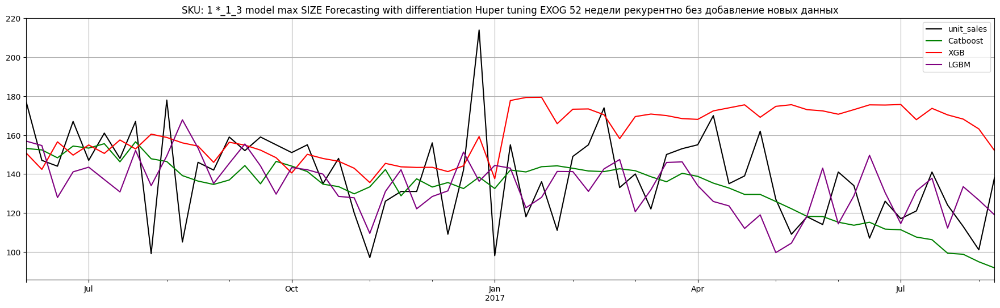

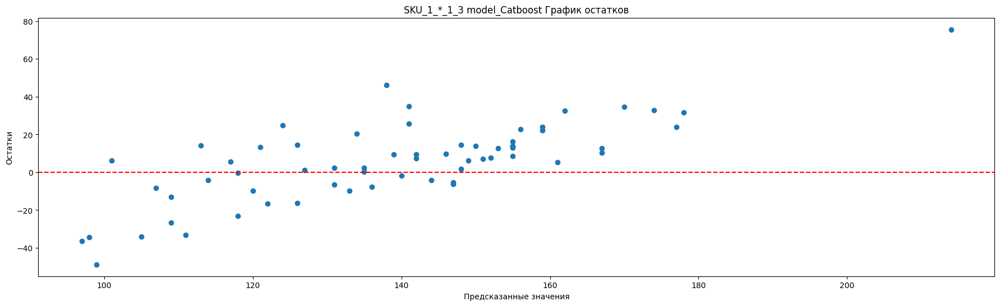

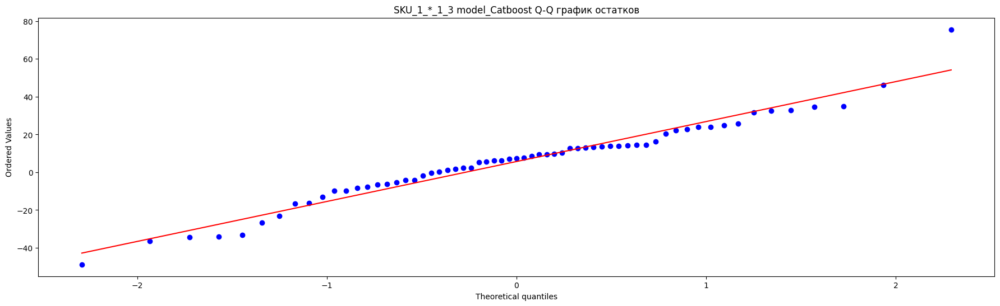

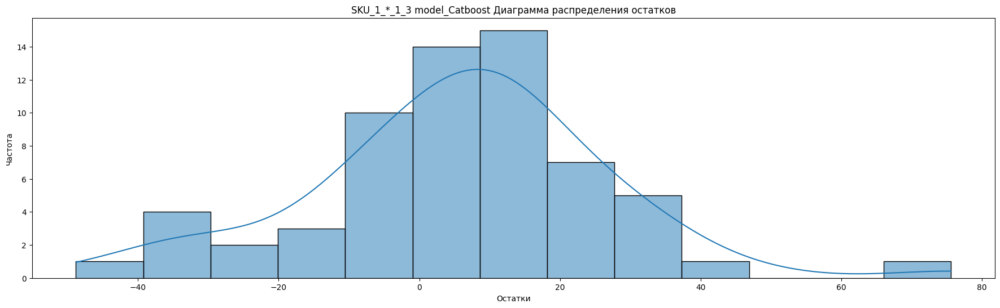

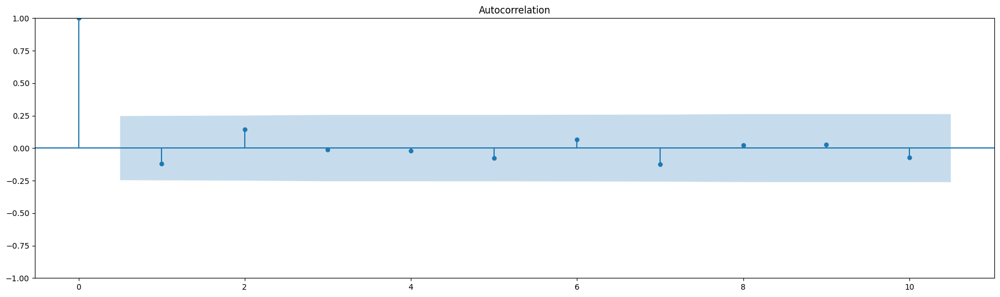

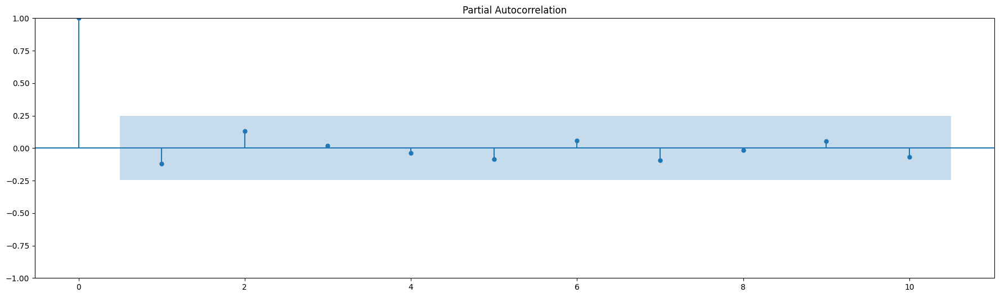


Статисткика по остаткам SKU_1_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9682909250259399
p-value Шапиро-Уилка : 0.1035723015666008

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
     lb_stat  lb_pvalue   bp_stat  bp_pvalue     result
1   0.955739   0.328263  0.911628   0.339683  белый шум
2   2.328292   0.312189  2.199716   0.332918  белый шум
3   2.336416   0.505580  2.207215   0.530529  белый шум
4   2.362580   0.669400  2.230964   0.693365  белый шум
5   2.767033   0.735849  2.591860   0.762602  белый шум
6   3.074998   0.799377  2.861922   0.825967  белый шум
7   4.217644   0.754396  3.846356   0.797294  белый шум
8   4.255217   0.833394  3.878148   0.867947  белый шум
9   4.306298   0.890122  3.920585   0.916561  белый шум
10  4.714646   0.909407  4.253545   0.935185  белый шум

Тест Дарбина-Уотсона: 2.0202024558900065
Отсутствие автокорреляции первого порядка в остатках.

Тес

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


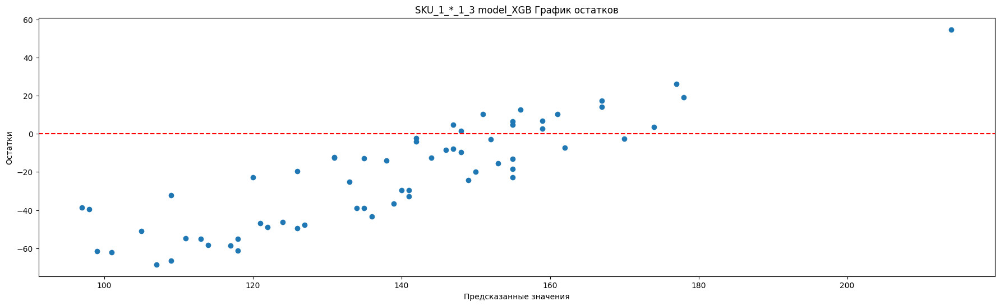

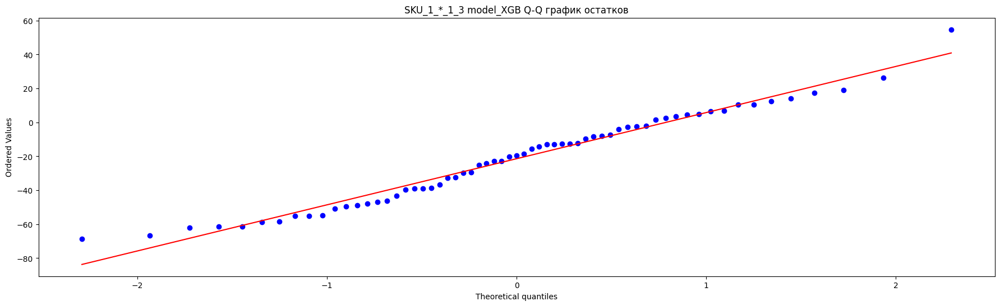

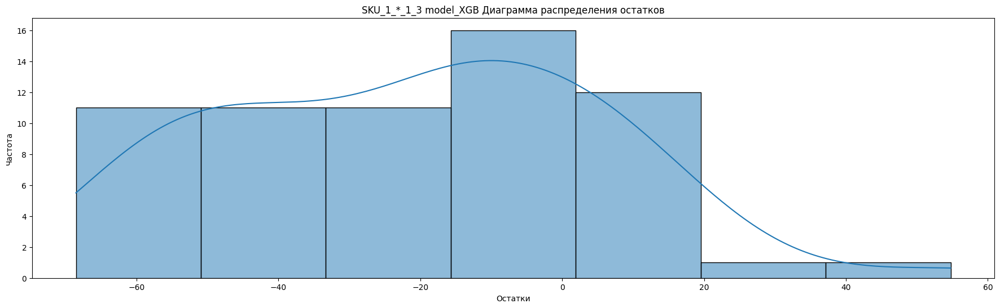

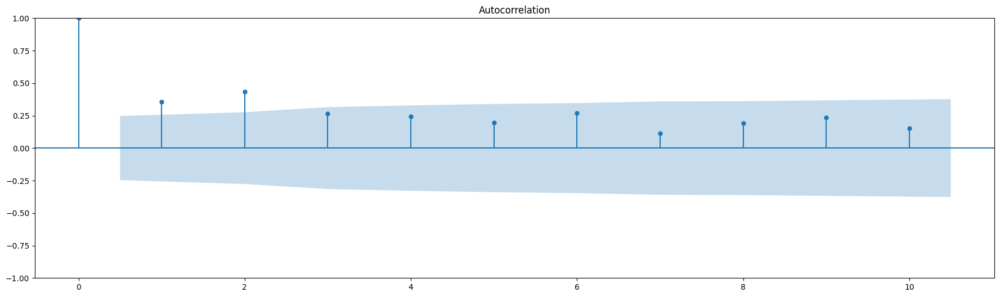

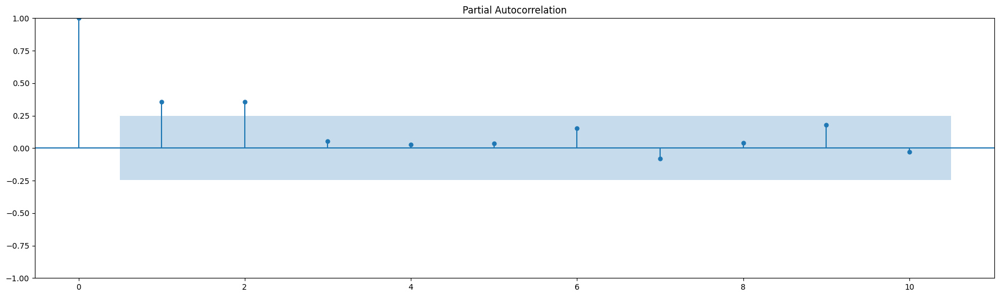


Статисткика по остаткам SKU_1_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9734451174736023
p-value Шапиро-Уилка : 0.18996670842170715

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat  bp_pvalue        result
1    8.318095  3.925206e-03   7.934183   0.004851  не белый шум
2   21.067220  2.662632e-05  19.898747   0.000048  не белый шум
3   25.856151  1.022223e-05  24.319298   0.000021  не белый шум
4   30.033976  4.817103e-06  28.111477   0.000012  не белый шум
5   32.780994  4.159663e-06  30.562663   0.000011  не белый шум
6   38.004290  1.121193e-06  35.143092   0.000004  не белый шум
7   38.976736  1.974548e-06  35.980892   0.000007  не белый шум
8   41.758515  1.503128e-06  38.334704   0.000007  не белый шум
9   45.943414  6.169506e-07  41.811390   0.000004  не белый шум
10  47.795883  6.762615e-07  43.321864   0.000004  не белый шум

Тест Дарбина-Уо

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


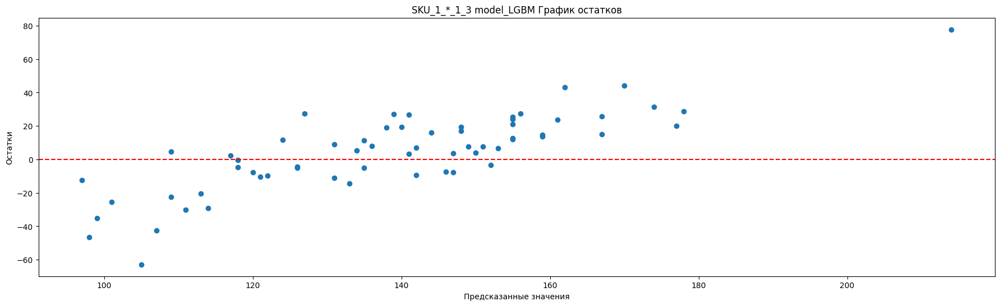

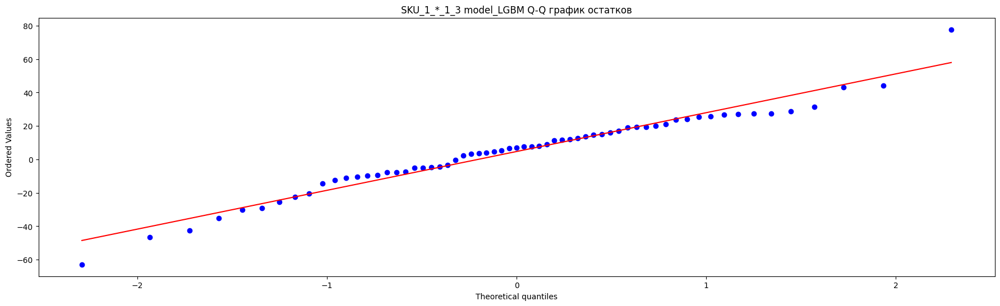

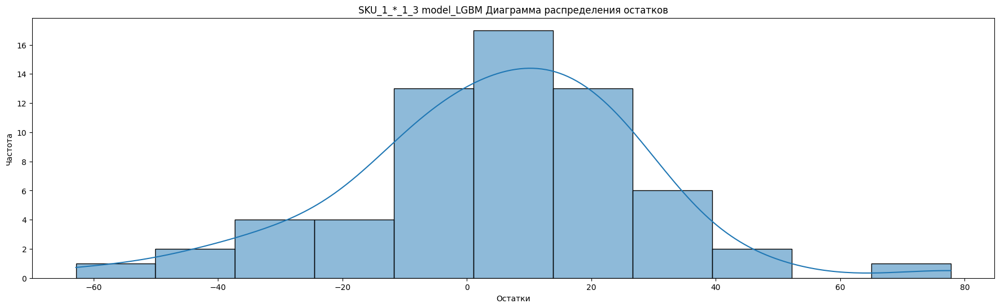

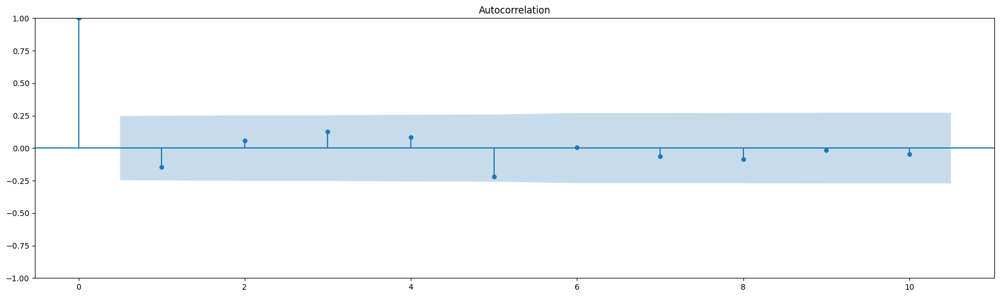

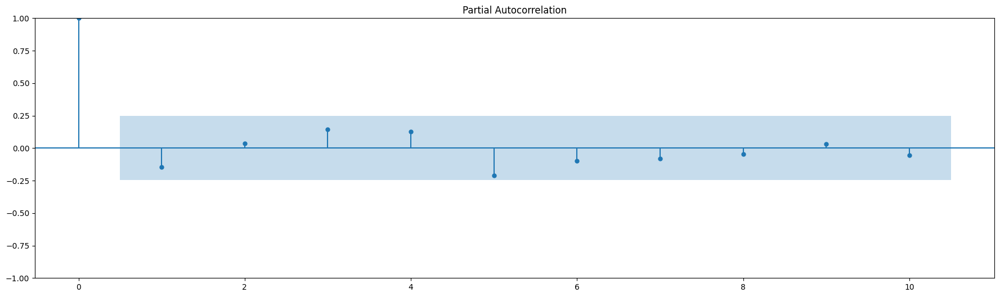


Статисткика по остаткам SKU_1_*_1_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9699593186378479
p-value Шапиро-Уилка : 0.12618276476860046

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
     lb_stat  lb_pvalue   bp_stat  bp_pvalue     result
1   1.410799   0.234924  1.345685   0.246034  белый шум
2   1.630773   0.442468  1.552123   0.460215  белый шум
3   2.737692   0.433860  2.573894   0.462085  белый шум
4   3.245244   0.517654  3.034595   0.552053  белый шум
5   6.587080   0.253205  6.016541   0.304613  белый шум
6   6.589764   0.360455  6.018895   0.421077  белый шум
7   6.894468   0.439950  6.281409   0.507302  белый шум
8   7.451069   0.488837  6.752379   0.563570  белый шум
9   7.471272   0.588176  6.769163   0.661139  белый шум
10  7.649227   0.663057  6.914264   0.733513  белый шум

Тест Дарбина-Уотсона: 2.186449887347612
Отсутствие автокорреляции первого порядка в остатках.

Тест на

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


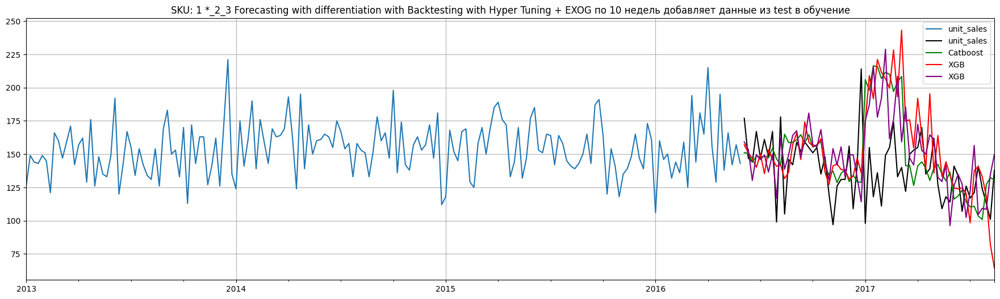

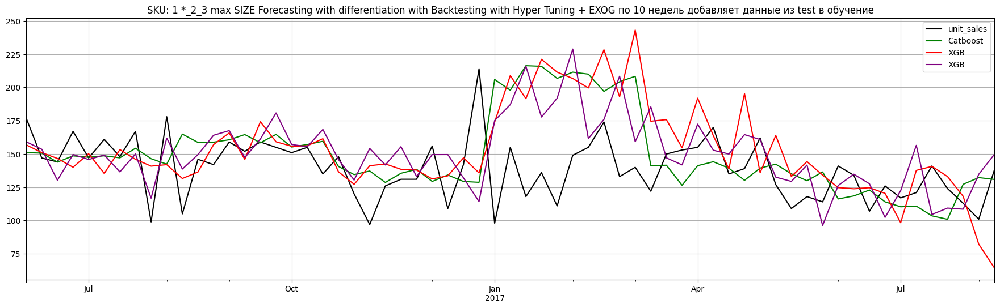

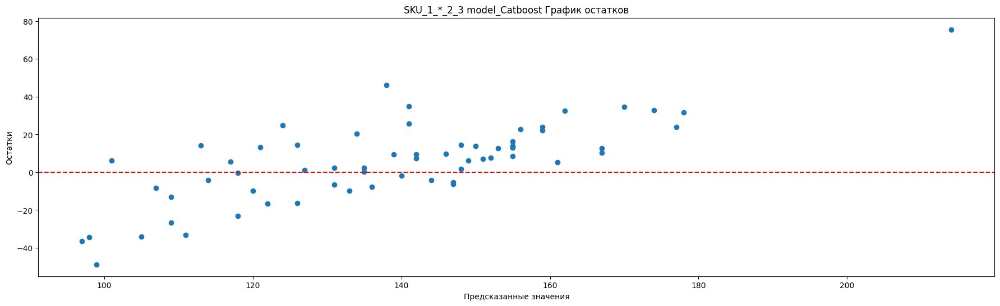

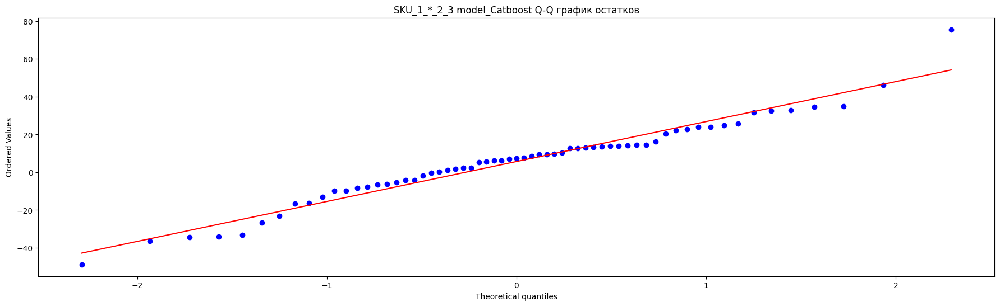

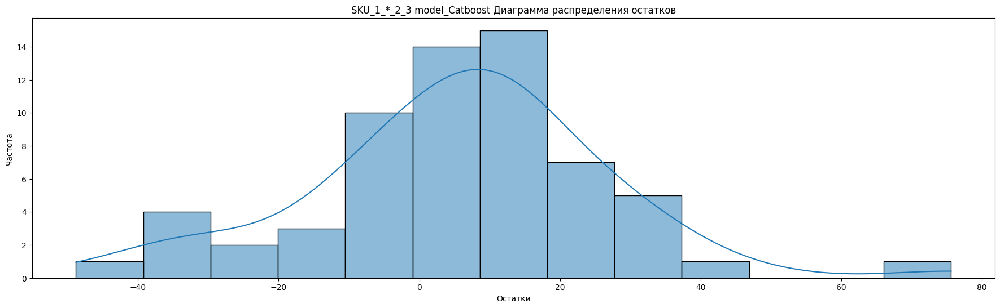

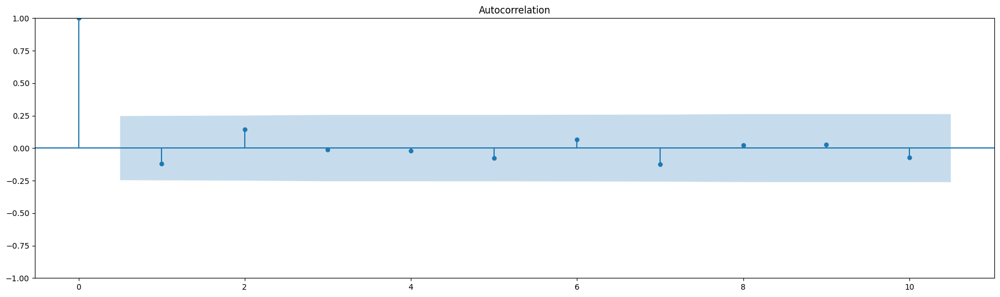

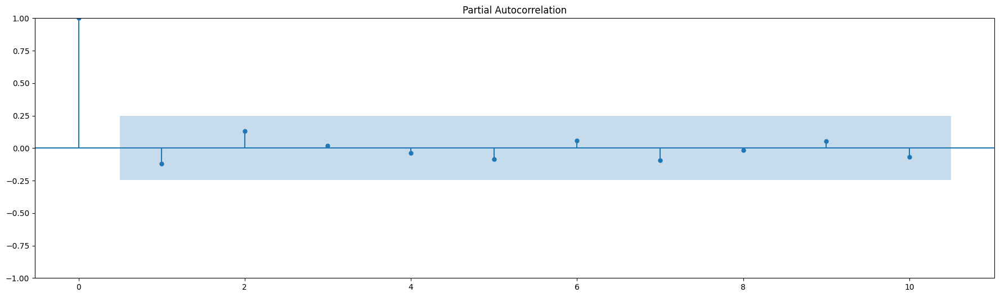


Статисткика по остаткам SKU_1_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9682909250259399
p-value Шапиро-Уилка : 0.1035723015666008

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
     lb_stat  lb_pvalue   bp_stat  bp_pvalue     result
1   0.955739   0.328263  0.911628   0.339683  белый шум
2   2.328292   0.312189  2.199716   0.332918  белый шум
3   2.336416   0.505580  2.207215   0.530529  белый шум
4   2.362580   0.669400  2.230964   0.693365  белый шум
5   2.767033   0.735849  2.591860   0.762602  белый шум
6   3.074998   0.799377  2.861922   0.825967  белый шум
7   4.217644   0.754396  3.846356   0.797294  белый шум
8   4.255217   0.833394  3.878148   0.867947  белый шум
9   4.306298   0.890122  3.920585   0.916561  белый шум
10  4.714646   0.909407  4.253545   0.935185  белый шум

Тест Дарбина-Уотсона: 2.0202024558900065
Отсутствие автокорреляции первого порядка в остатках.

Тес

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


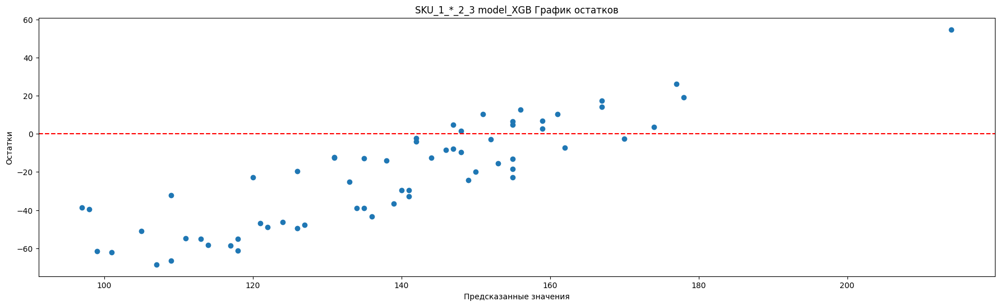

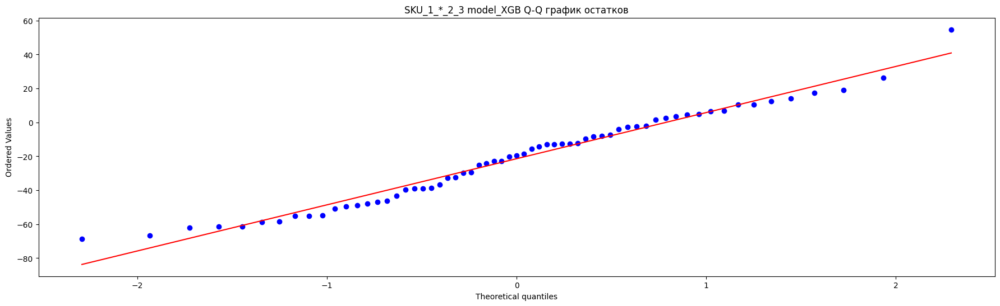

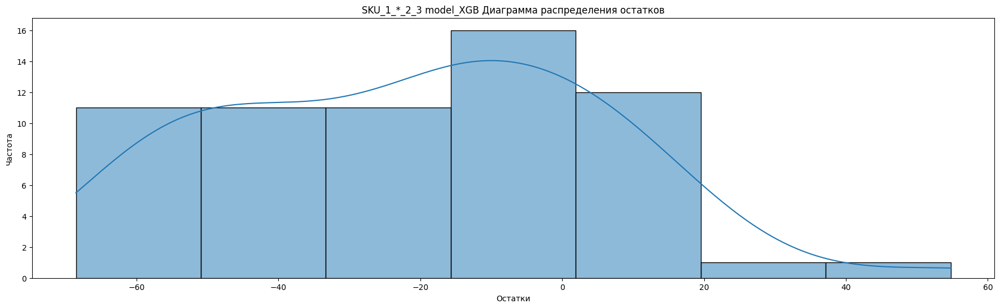

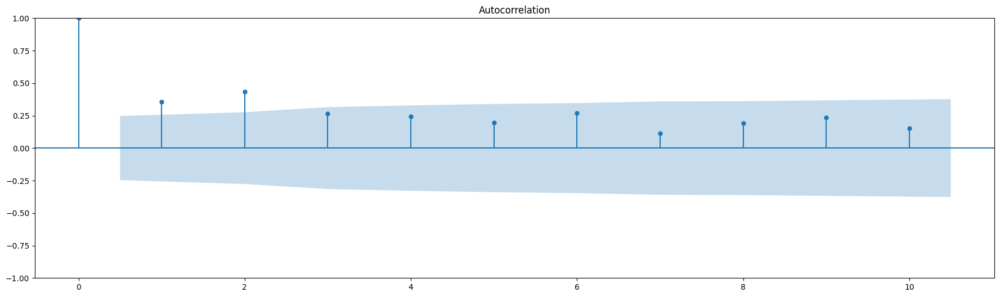

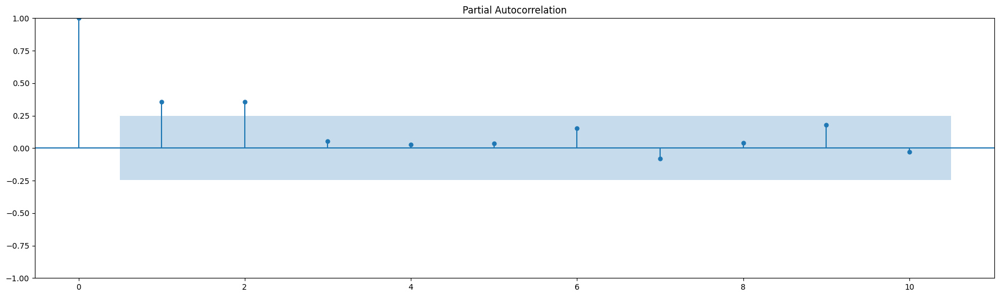


Статисткика по остаткам SKU_1_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9734451174736023
p-value Шапиро-Уилка : 0.18996670842170715

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat  bp_pvalue        result
1    8.318095  3.925206e-03   7.934183   0.004851  не белый шум
2   21.067220  2.662632e-05  19.898747   0.000048  не белый шум
3   25.856151  1.022223e-05  24.319298   0.000021  не белый шум
4   30.033976  4.817103e-06  28.111477   0.000012  не белый шум
5   32.780994  4.159663e-06  30.562663   0.000011  не белый шум
6   38.004290  1.121193e-06  35.143092   0.000004  не белый шум
7   38.976736  1.974548e-06  35.980892   0.000007  не белый шум
8   41.758515  1.503128e-06  38.334704   0.000007  не белый шум
9   45.943414  6.169506e-07  41.811390   0.000004  не белый шум
10  47.795883  6.762615e-07  43.321864   0.000004  не белый шум

Тест Дарбина-Уо

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


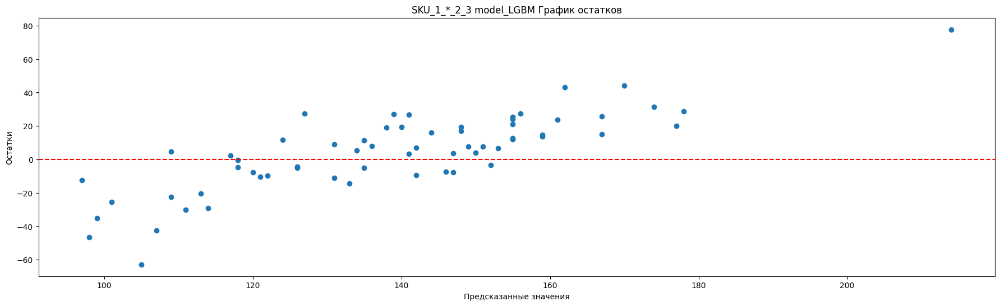

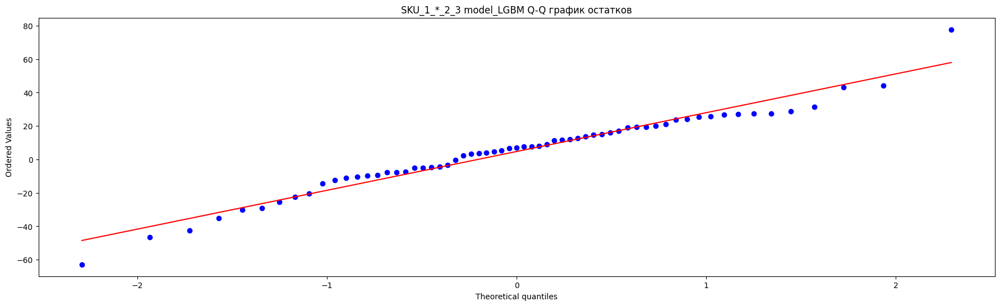

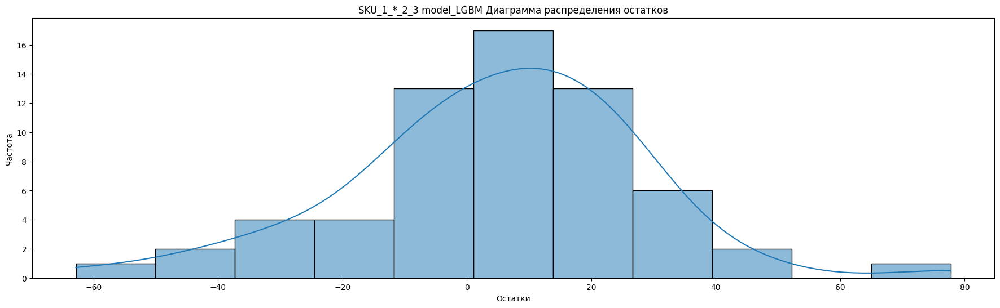

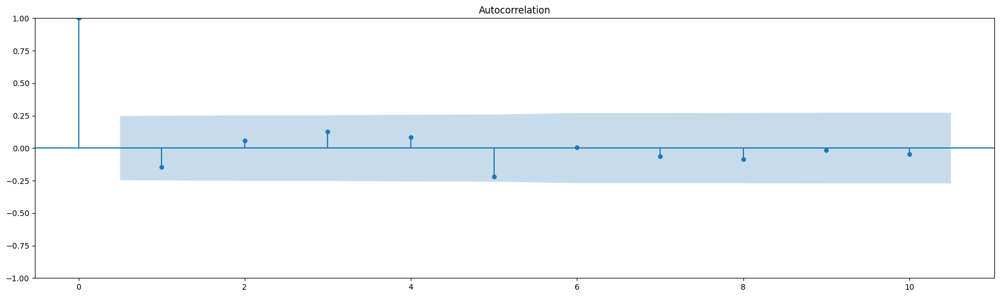

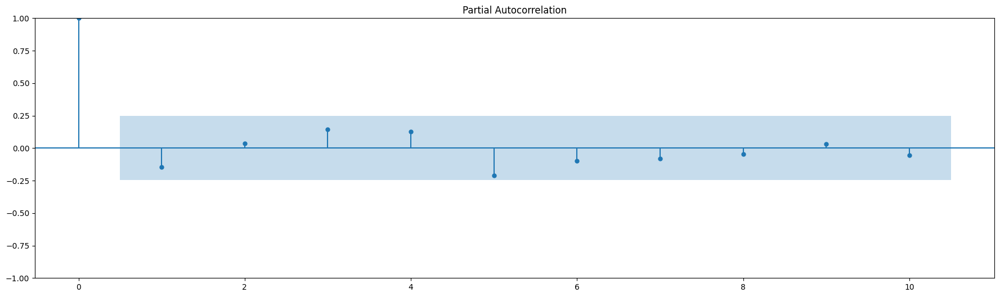


Статисткика по остаткам SKU_1_*_2_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9699593186378479
p-value Шапиро-Уилка : 0.12618276476860046

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
     lb_stat  lb_pvalue   bp_stat  bp_pvalue     result
1   1.410799   0.234924  1.345685   0.246034  белый шум
2   1.630773   0.442468  1.552123   0.460215  белый шум
3   2.737692   0.433860  2.573894   0.462085  белый шум
4   3.245244   0.517654  3.034595   0.552053  белый шум
5   6.587080   0.253205  6.016541   0.304613  белый шум
6   6.589764   0.360455  6.018895   0.421077  белый шум
7   6.894468   0.439950  6.281409   0.507302  белый шум
8   7.451069   0.488837  6.752379   0.563570  белый шум
9   7.471272   0.588176  6.769163   0.661139  белый шум
10  7.649227   0.663057  6.914264   0.733513  белый шум

Тест Дарбина-Уотсона: 2.186449887347612
Отсутствие автокорреляции первого порядка в остатках.

Тест на

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


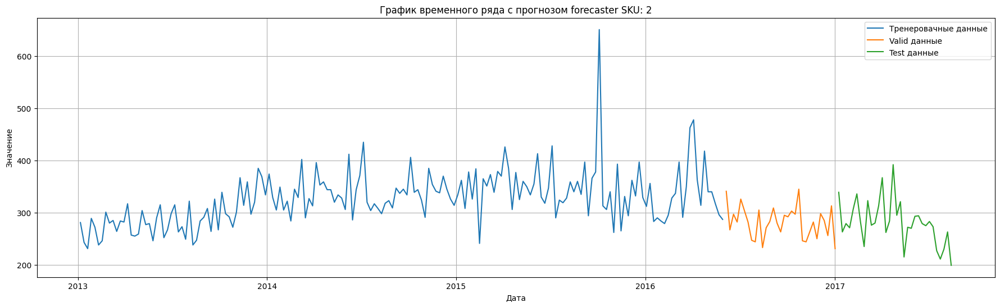

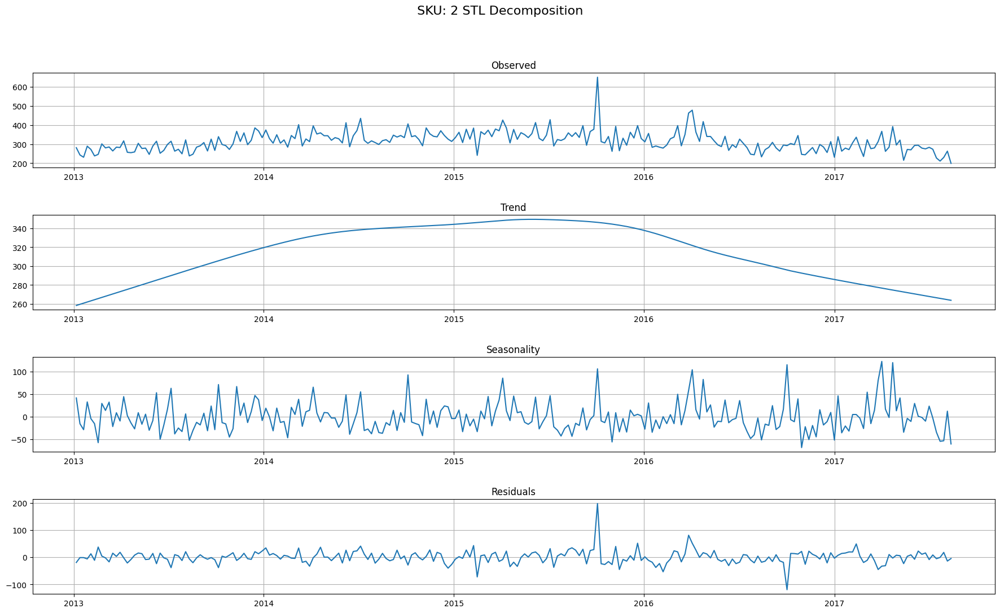

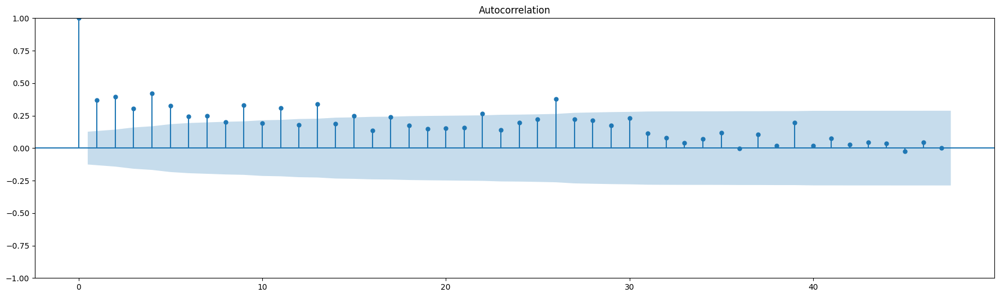

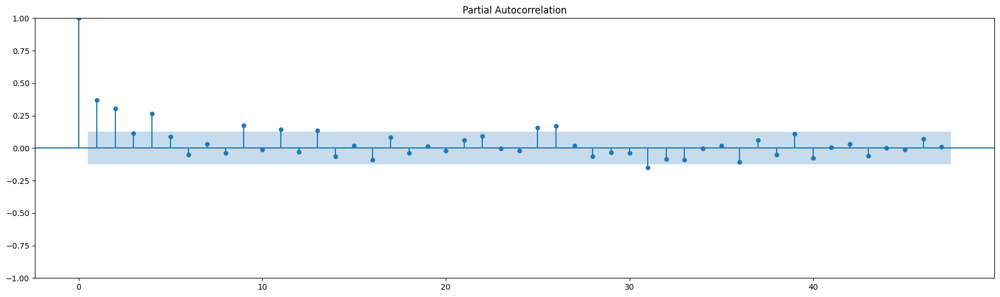

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'depth': 9, 'learning_rate': 0.22864694393692667, 'iterations': 100}
  Backtesting metric: 23.065579675649214

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'max_depth': 9, 'reg_alpha': 0.6000000000000001, 'reg_lambda': 0.0, 'n_estimators': 600}
  Backtesting metric: 33.74868402846398

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags

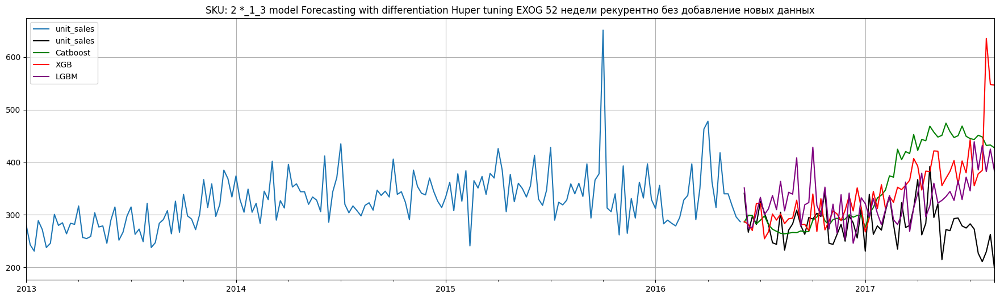

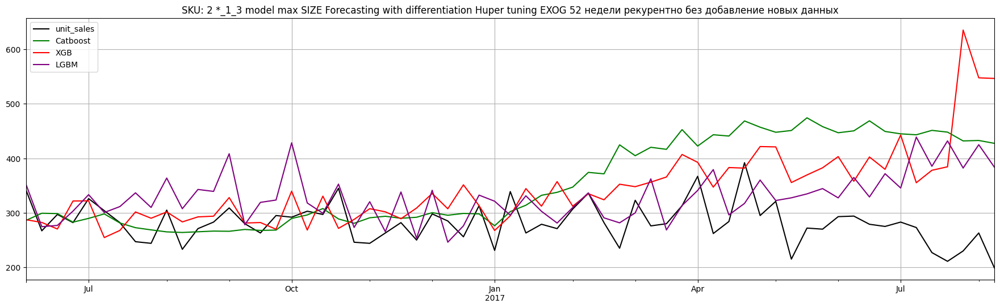

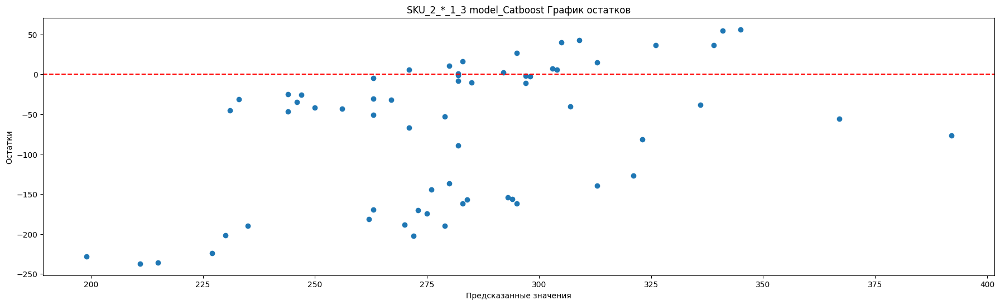

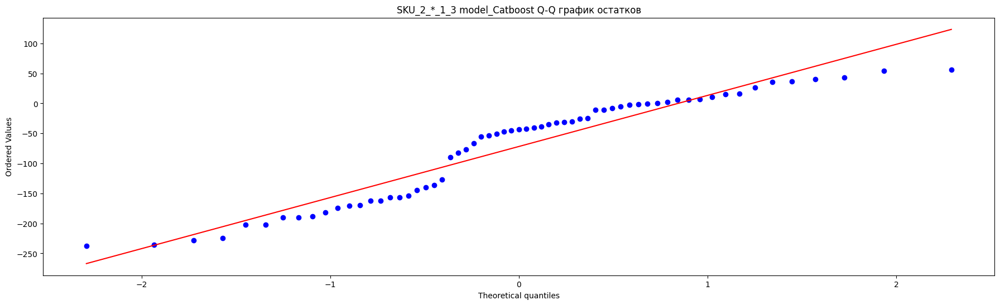

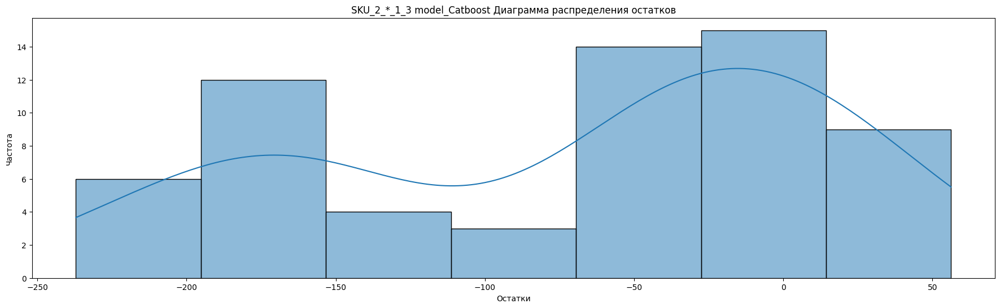

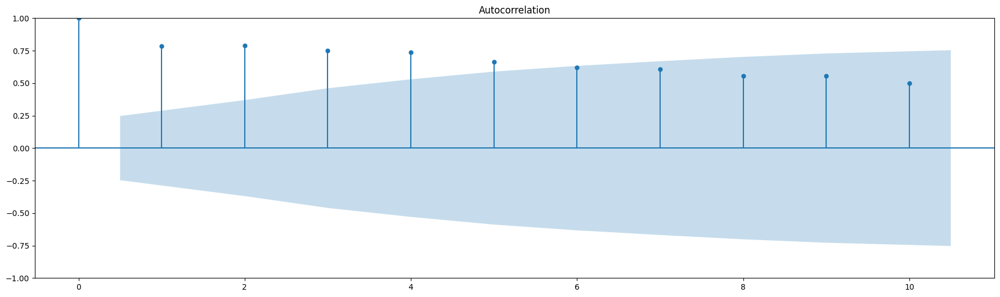

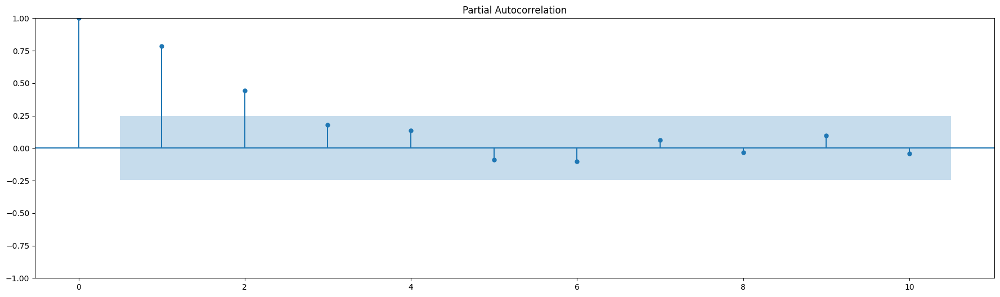


Статисткика по остаткам SKU_2_*_1_3 model_Catboost
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9157879948616028
p-value Шапиро-Уилка : 0.00037216185592114925

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
       lb_stat     lb_pvalue     bp_stat     bp_pvalue        result
1    40.873456  1.624121e-10   38.986989  4.266395e-10  не белый шум
2    82.544352  1.190479e-18   78.093522  1.102065e-17  не белый шум
3   120.736200  5.356481e-26  113.347535  2.088448e-24  не белый шум
4   158.393076  3.232482e-33  147.528392  6.891445e-31  не белый шум
5   189.642539  4.658222e-39  175.412529  5.104688e-36  не белый шум
6   217.269384  3.976077e-44  199.639147  2.264710e-40  не белый шум
7   244.418069  4.269476e-49  223.028783  1.501148e-44  не белый шум
8   267.547872  3.261793e-53  242.600154  6.371803e-48  не белый шум
9   290.791592  2.339932e-57  261.910322  3.039865e-51  не белый шум
10  309.946799  1.2

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


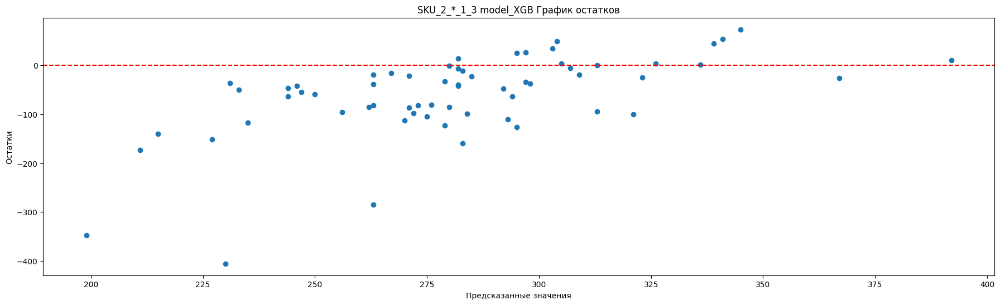

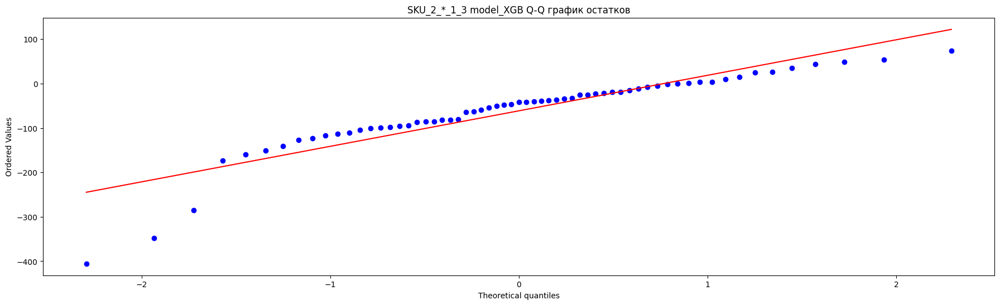

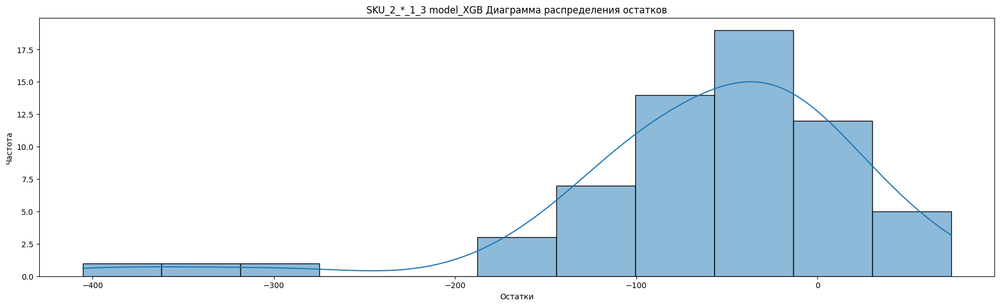

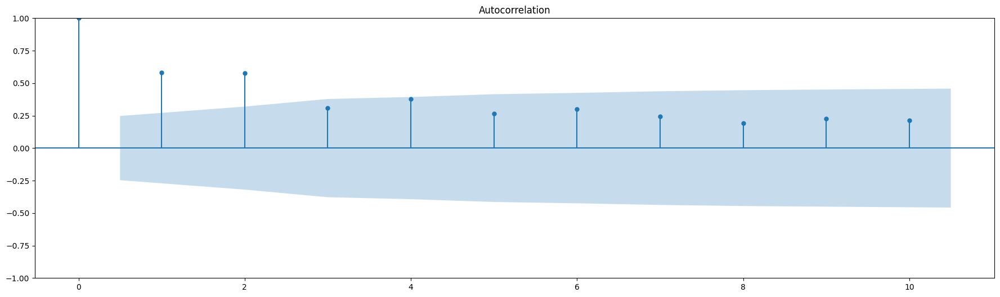

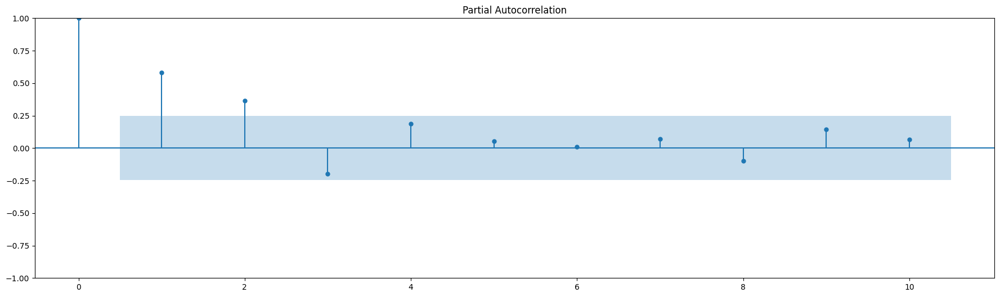


Статисткика по остаткам SKU_2_*_1_3 model_XGB
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.8548398017883301
p-value Шапиро-Уилка : 2.686496600290411e-06

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   22.246074  2.398486e-06  21.219333  4.096120e-06  не белый шум
2   44.708095  1.957765e-10  42.299075  6.529390e-10  не белый шум
3   51.265724  4.294174e-11  48.352271  1.791863e-10  не белый шум
4   61.130279  1.678558e-12  57.306251  1.067029e-11  не белый шум
5   66.059831  6.754362e-13  61.704929  5.397370e-12  не белый шум
6   72.492929  1.258385e-13  67.346261  1.429758e-12  не белый шум
7   76.874789  5.964494e-14  71.121402  8.765126e-13  не белый шум
8   79.638542  5.780279e-14  73.459962  1.002792e-12  не белый шум
9   83.527143  3.209877e-14  76.690492  7.321619e-13  не белый шум
10  87.082606  2.025090e-14  79.589562  6.041

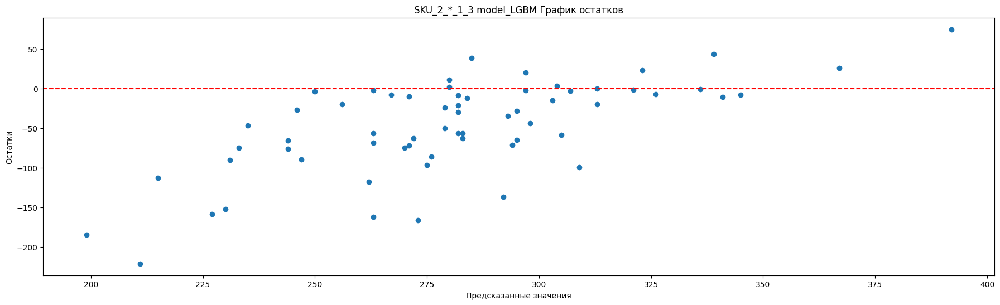

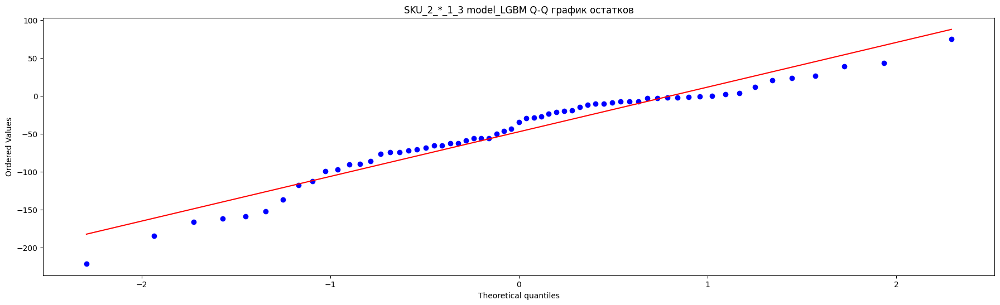

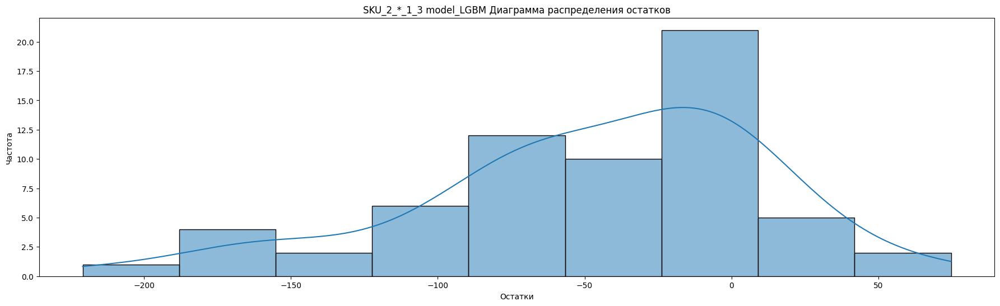

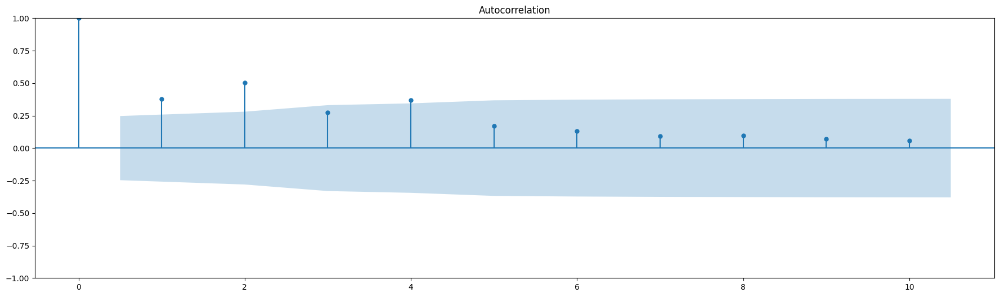

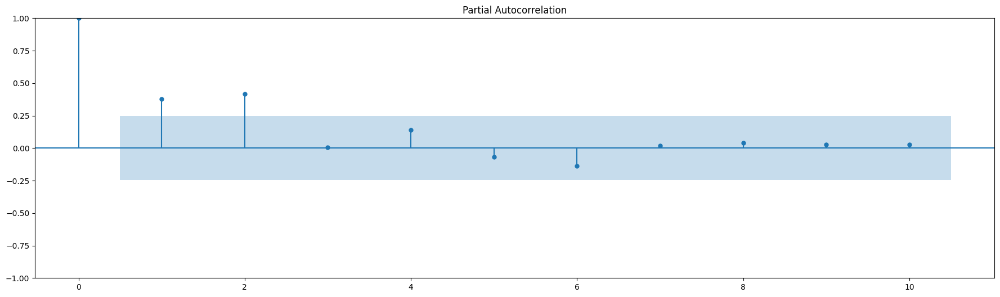


Статисткика по остаткам SKU_2_*_1_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9517244100570679
p-value Шапиро-Уилка : 0.01500337477773428

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    9.510314  2.043202e-03   9.071376  2.596416e-03  не белый шум
2   26.432545  1.820731e-06  24.952240  3.816717e-06  не белый шум
3   31.586171  6.397167e-07  29.709433  1.588578e-06  не белый шум
4   41.154383  2.497090e-08  38.394425  9.290689e-08  не белый шум
5   43.244795  3.296079e-08  40.259716  1.323676e-07  не белый шум
6   44.448853  6.021693e-08  41.315582  2.509335e-07  не белый шум
7   45.075546  1.322192e-07  41.855502  5.543927e-07  не белый шум
8   45.761771  2.638152e-07  42.436154  1.121462e-06  не белый шум
9   46.142812  5.665413e-07  42.752712  2.392961e-06  не белый шум
10  46.402965  1.212162e-06  42.964836  5.0455

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


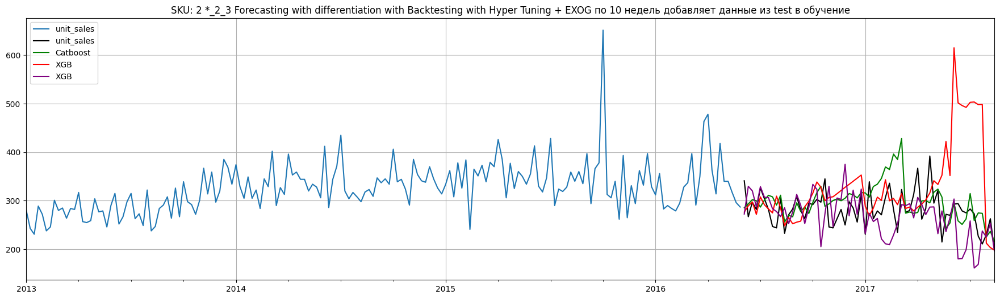

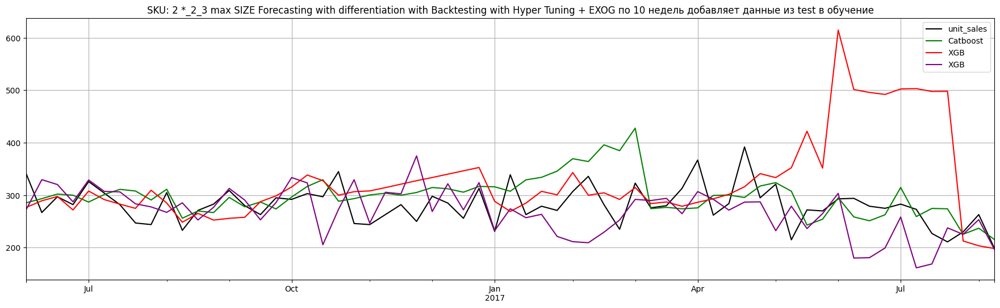

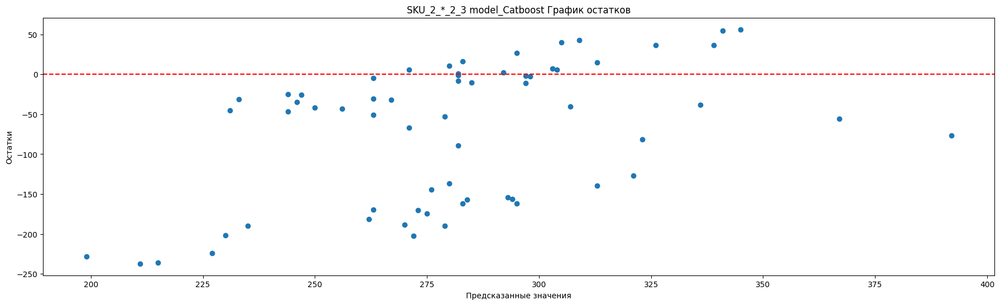

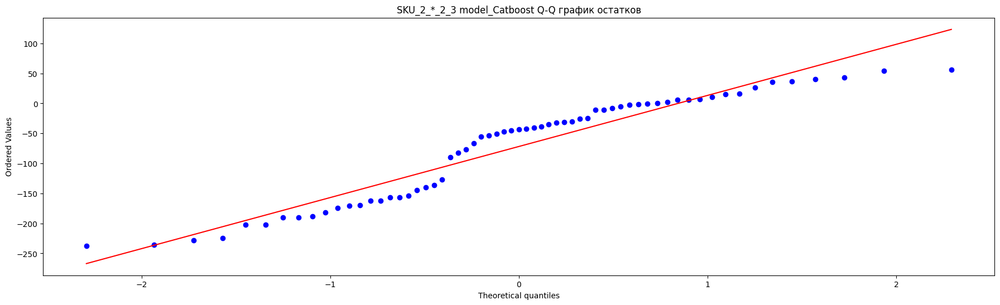

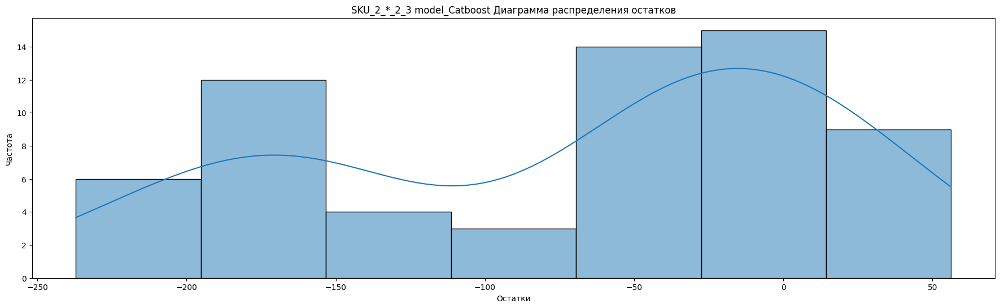

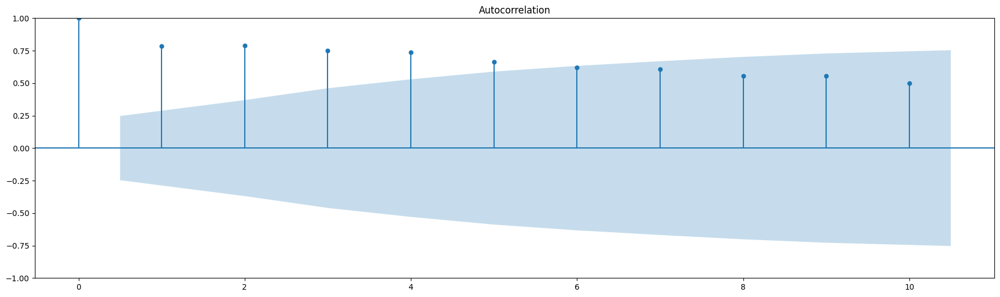

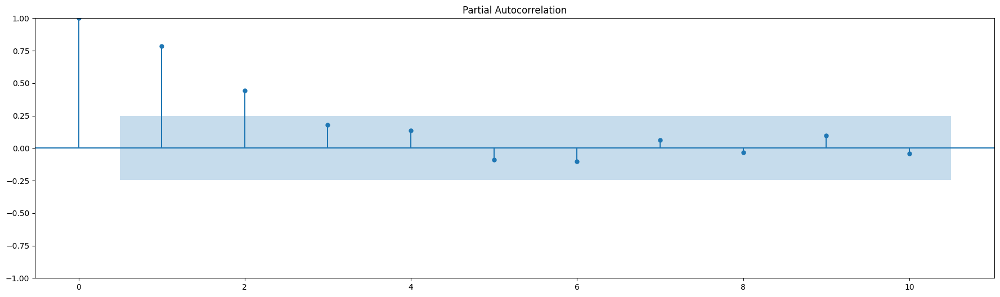


Статисткика по остаткам SKU_2_*_2_3 model_Catboost
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9157879948616028
p-value Шапиро-Уилка : 0.00037216185592114925

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
       lb_stat     lb_pvalue     bp_stat     bp_pvalue        result
1    40.873456  1.624121e-10   38.986989  4.266395e-10  не белый шум
2    82.544352  1.190479e-18   78.093522  1.102065e-17  не белый шум
3   120.736200  5.356481e-26  113.347535  2.088448e-24  не белый шум
4   158.393076  3.232482e-33  147.528392  6.891445e-31  не белый шум
5   189.642539  4.658222e-39  175.412529  5.104688e-36  не белый шум
6   217.269384  3.976077e-44  199.639147  2.264710e-40  не белый шум
7   244.418069  4.269476e-49  223.028783  1.501148e-44  не белый шум
8   267.547872  3.261793e-53  242.600154  6.371803e-48  не белый шум
9   290.791592  2.339932e-57  261.910322  3.039865e-51  не белый шум
10  309.946799  1.2

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


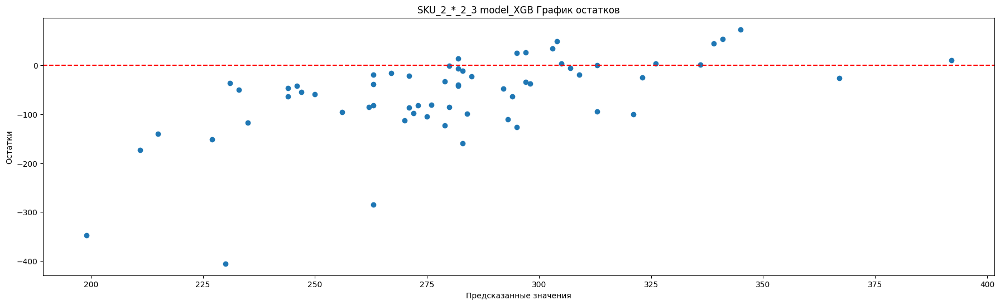

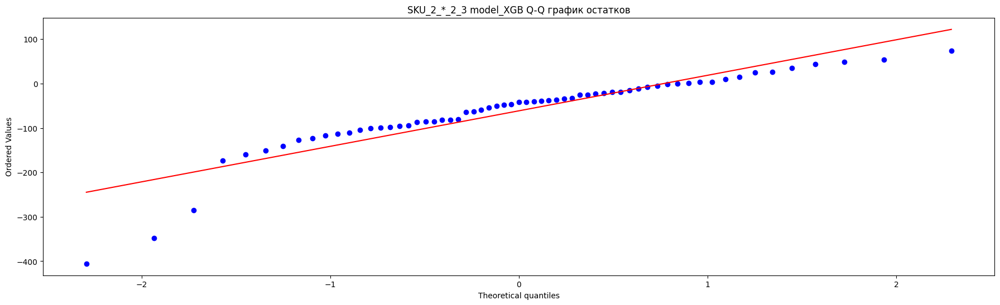

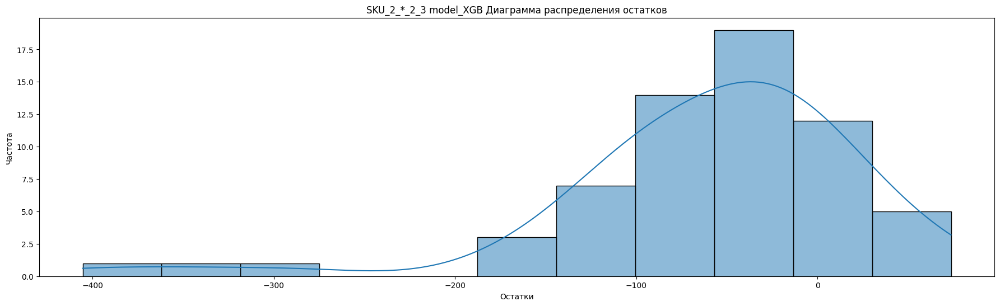

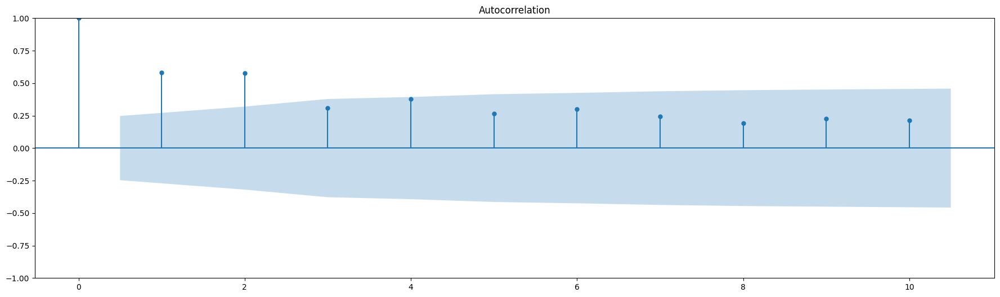

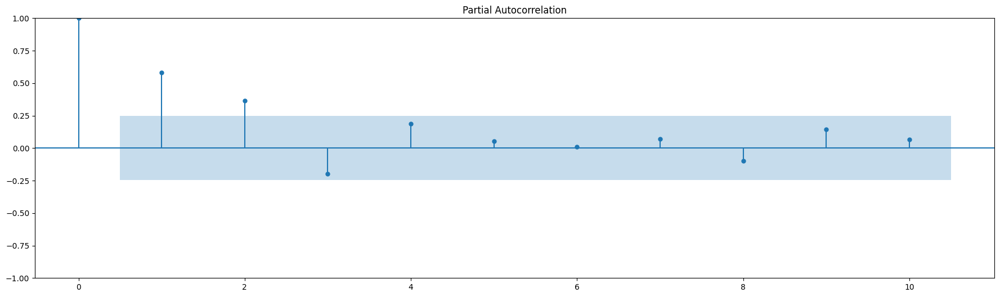


Статисткика по остаткам SKU_2_*_2_3 model_XGB
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.8548398017883301
p-value Шапиро-Уилка : 2.686496600290411e-06

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   22.246074  2.398486e-06  21.219333  4.096120e-06  не белый шум
2   44.708095  1.957765e-10  42.299075  6.529390e-10  не белый шум
3   51.265724  4.294174e-11  48.352271  1.791863e-10  не белый шум
4   61.130279  1.678558e-12  57.306251  1.067029e-11  не белый шум
5   66.059831  6.754362e-13  61.704929  5.397370e-12  не белый шум
6   72.492929  1.258385e-13  67.346261  1.429758e-12  не белый шум
7   76.874789  5.964494e-14  71.121402  8.765126e-13  не белый шум
8   79.638542  5.780279e-14  73.459962  1.002792e-12  не белый шум
9   83.527143  3.209877e-14  76.690492  7.321619e-13  не белый шум
10  87.082606  2.025090e-14  79.589562  6.041

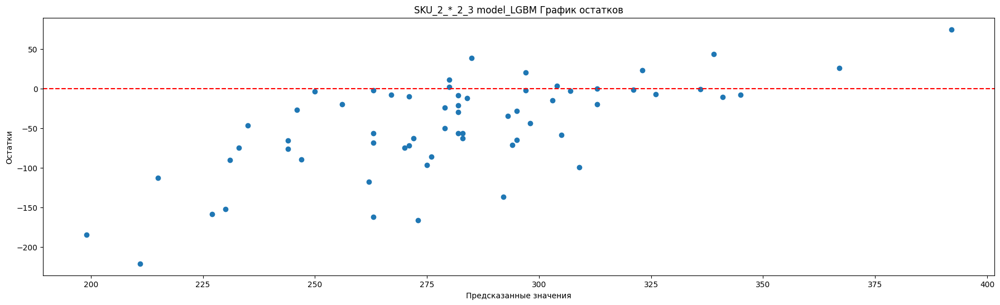

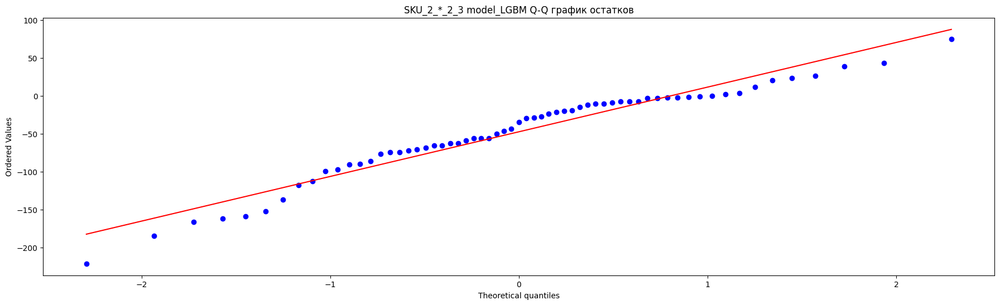

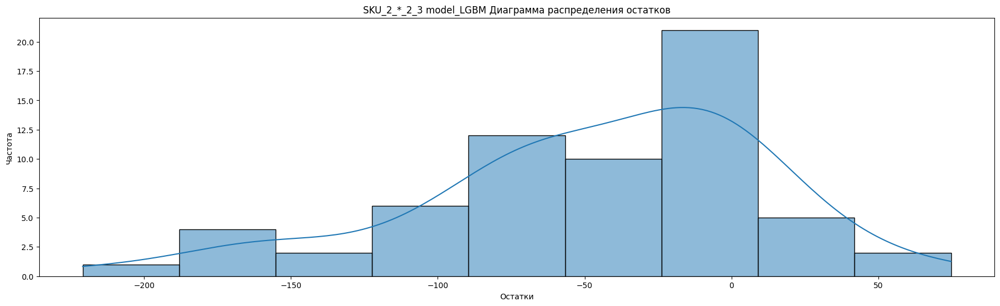

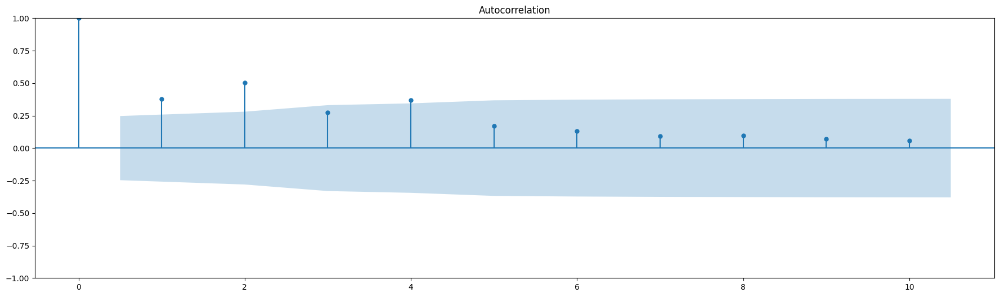

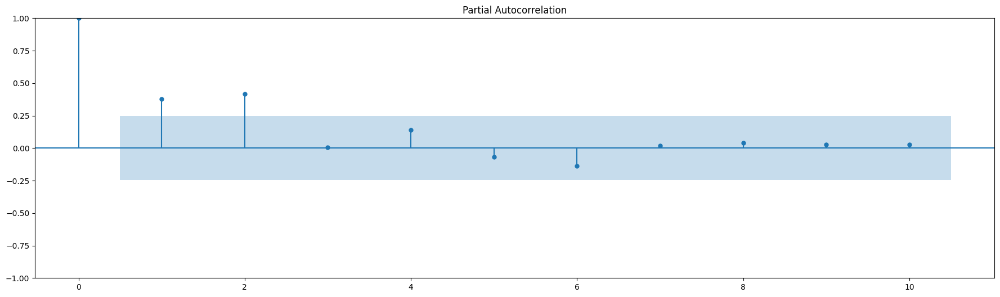


Статисткика по остаткам SKU_2_*_2_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9517244100570679
p-value Шапиро-Уилка : 0.01500337477773428

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    9.510314  2.043202e-03   9.071376  2.596416e-03  не белый шум
2   26.432545  1.820731e-06  24.952240  3.816717e-06  не белый шум
3   31.586171  6.397167e-07  29.709433  1.588578e-06  не белый шум
4   41.154383  2.497090e-08  38.394425  9.290689e-08  не белый шум
5   43.244795  3.296079e-08  40.259716  1.323676e-07  не белый шум
6   44.448853  6.021693e-08  41.315582  2.509335e-07  не белый шум
7   45.075546  1.322192e-07  41.855502  5.543927e-07  не белый шум
8   45.761771  2.638152e-07  42.436154  1.121462e-06  не белый шум
9   46.142812  5.665413e-07  42.752712  2.392961e-06  не белый шум
10  46.402965  1.212162e-06  42.964836  5.0455

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


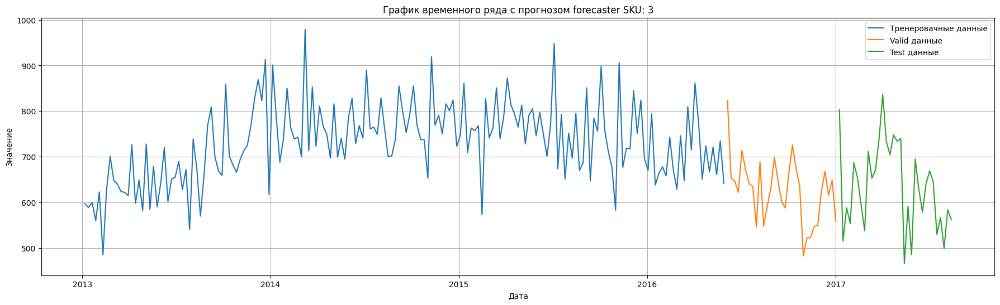

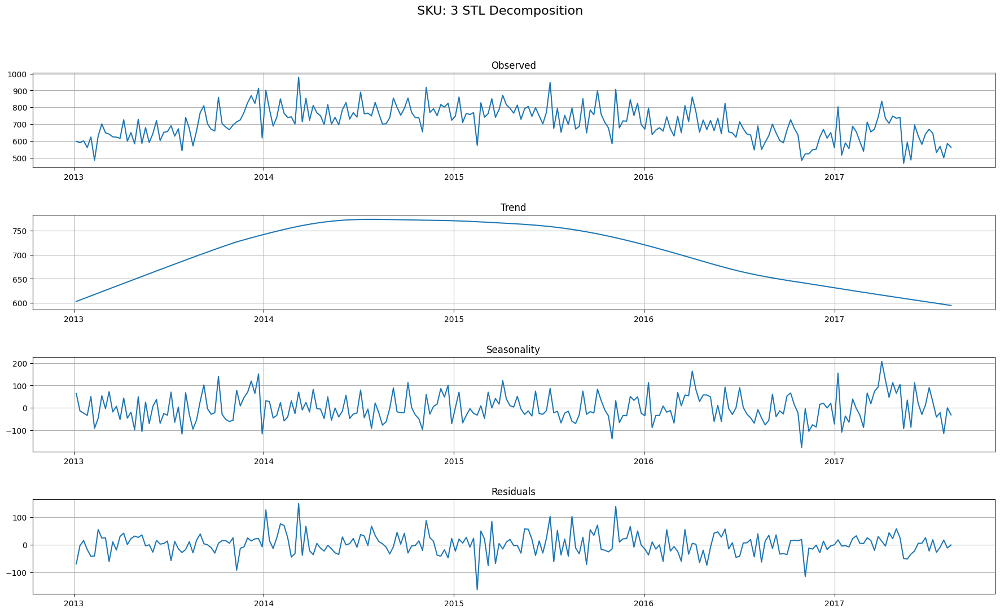

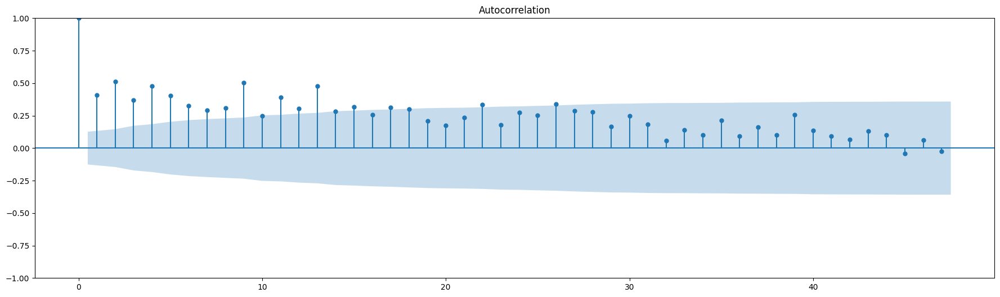

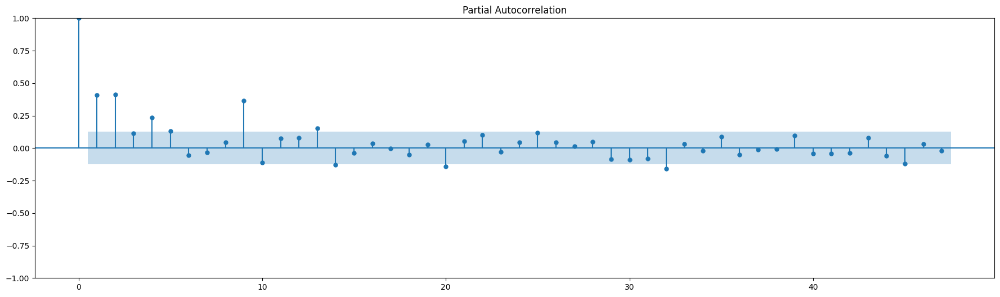

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'depth': 12, 'learning_rate': 0.334936476129682, 'iterations': 200}
  Backtesting metric: 51.26167827214639

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'max_depth': 12, 'reg_alpha': 0.1, 'reg_lambda': 0.8, 'n_estimators': 800}
  Backtesting metric: 67.71324579177364

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and par

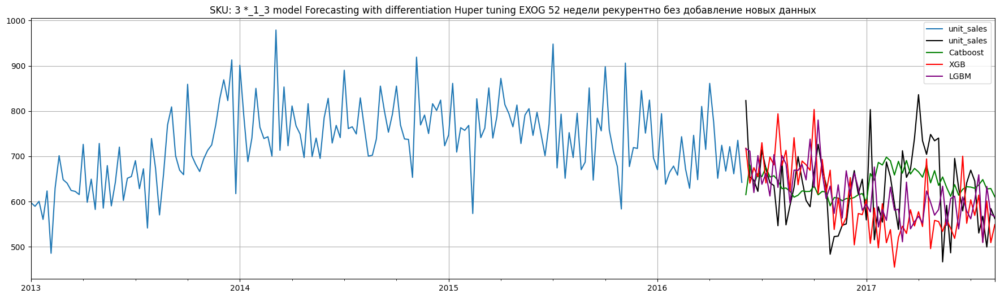

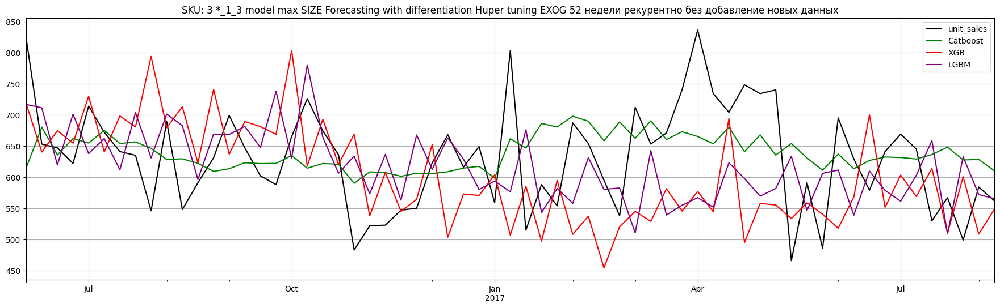

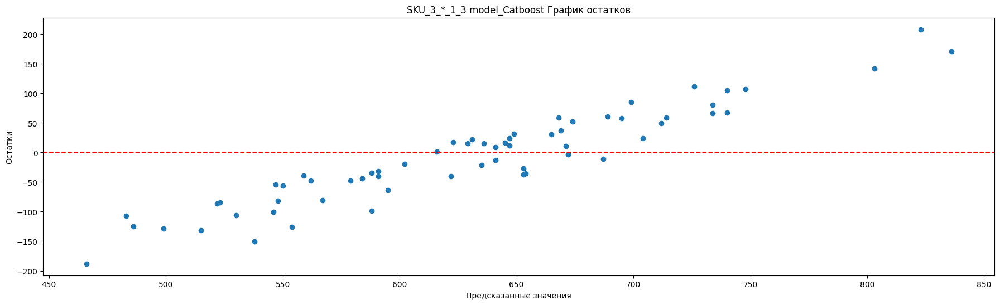

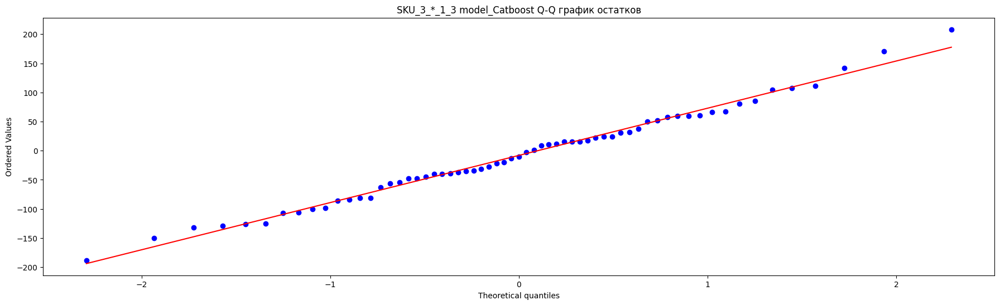

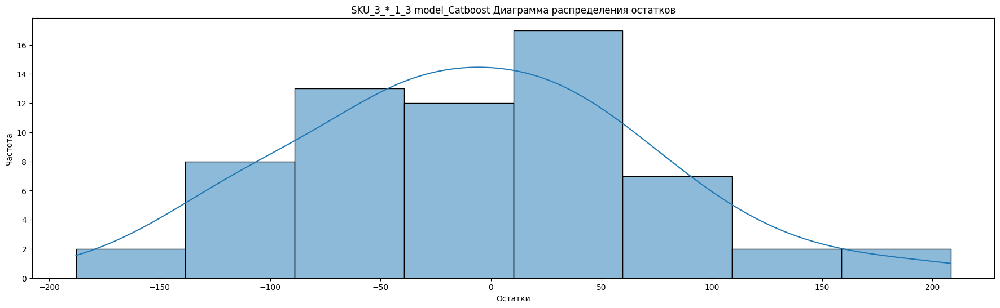

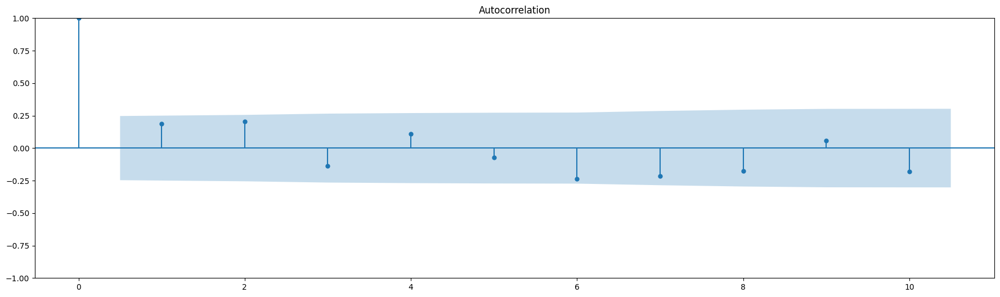

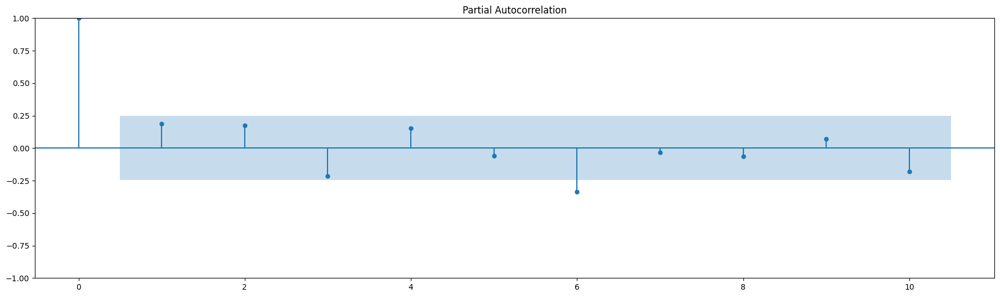


Статисткика по остаткам SKU_3_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9916377067565918
p-value Шапиро-Уилка : 0.9473419189453125

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    2.341190   0.125993   2.233136   0.135079     белый шум
2    5.131108   0.076877   4.851366   0.088418     белый шум
3    6.419104   0.092908   6.040285   0.109667     белый шум
4    7.267584   0.122405   6.810444   0.146251     белый шум
5    7.646001   0.176855   7.148108   0.209856     белый шум
6   11.669084   0.069772  10.676043   0.098920     белый шум
7   15.103936   0.034690  13.635300   0.058061  не белый шум
8   17.374515   0.026437  15.556559   0.049185  не белый шум
9   17.635017   0.039652  15.772976   0.071776  не белый шум
10  20.133100   0.028019  17.809875   0.058257  не белый шум

Тест Дарбина-Уотсона: 1.484611881662065
Отсу

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


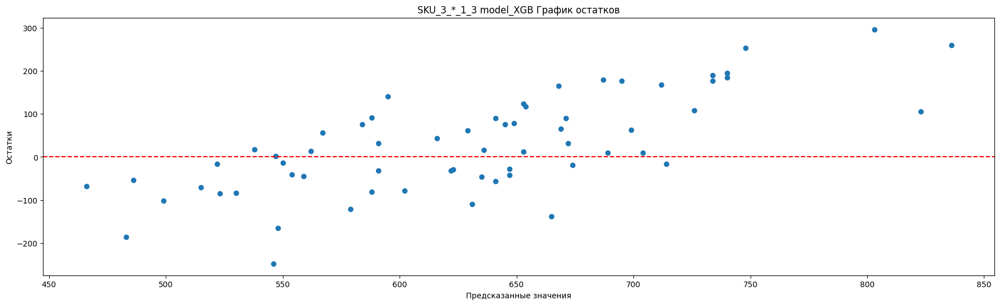

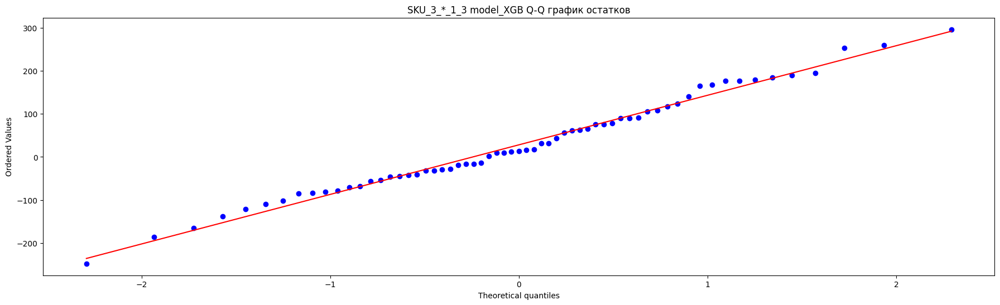

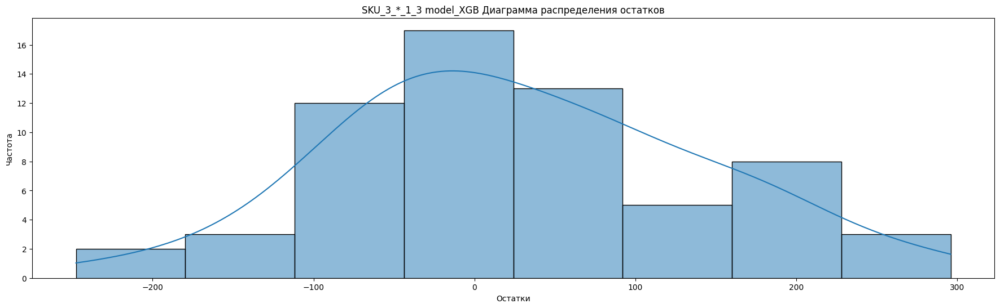

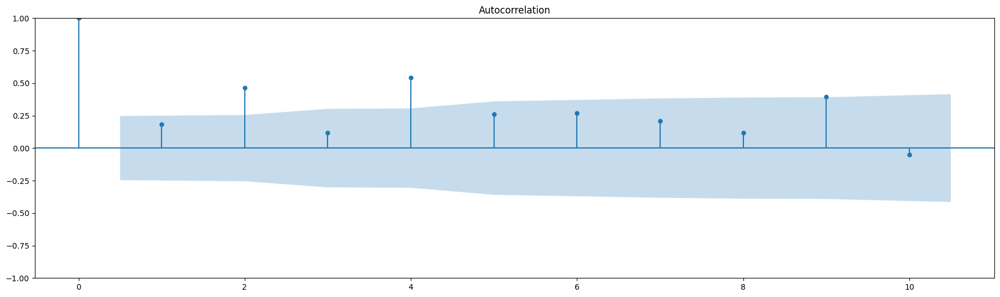

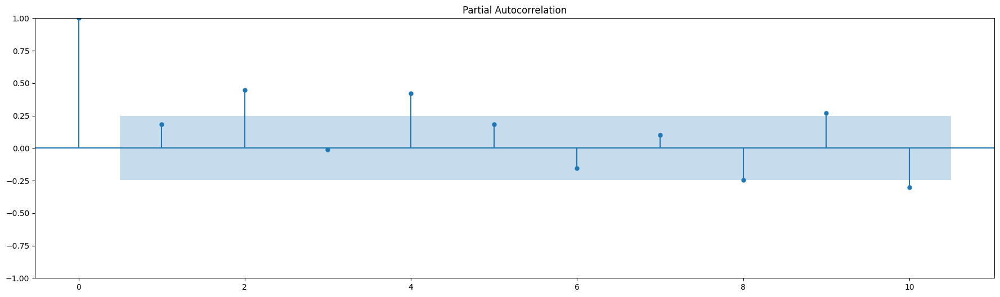


Статисткика по остаткам SKU_3_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.989284873008728
p-value Шапиро-Уилка : 0.860752522945404

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    2.208460  1.372557e-01   2.106531  1.466715e-01     белый шум
2   16.763166  2.290471e-04  15.765563  3.771825e-04  не белый шум
3   17.745172  4.964120e-04  16.672030  8.254276e-04  не белый шум
4   38.270511  9.854199e-08  35.302722  4.025519e-07  не белый шум
5   42.999145  3.696551e-08  39.522119  1.864194e-07  не белый шум
6   48.141304  1.107236e-08  44.031397  7.286871e-08  не белый шум
7   51.343327  7.864018e-09  46.790062  6.133787e-08  не белый шум
8   52.399208  1.409268e-08  47.683500  1.135579e-07  не белый шум
9   64.192406  2.070903e-10  57.480926  4.087562e-09  не белый шум
10  64.381782  5.321018e-10  57.635341  1.012475e-08 

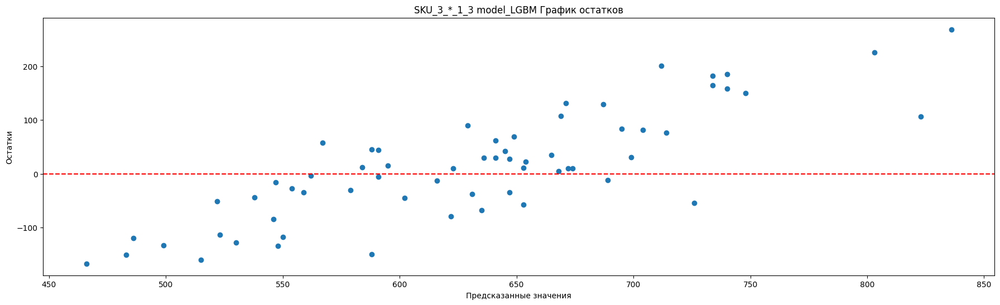

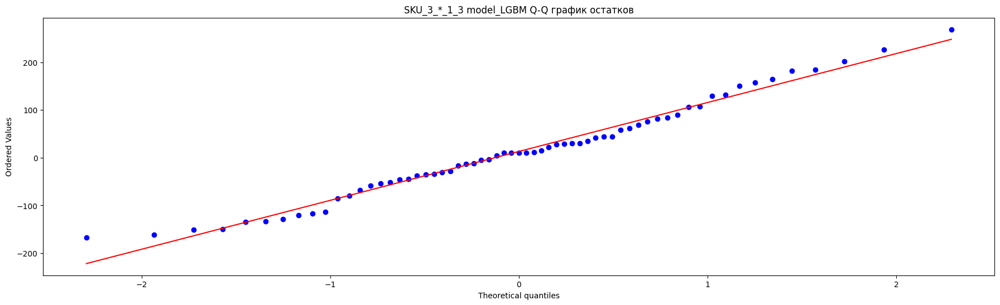

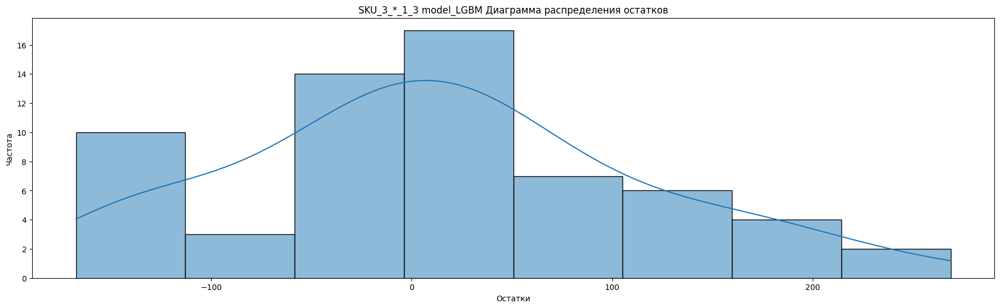

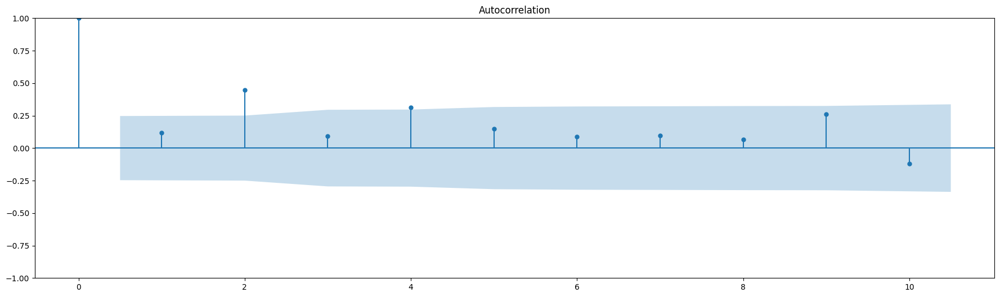

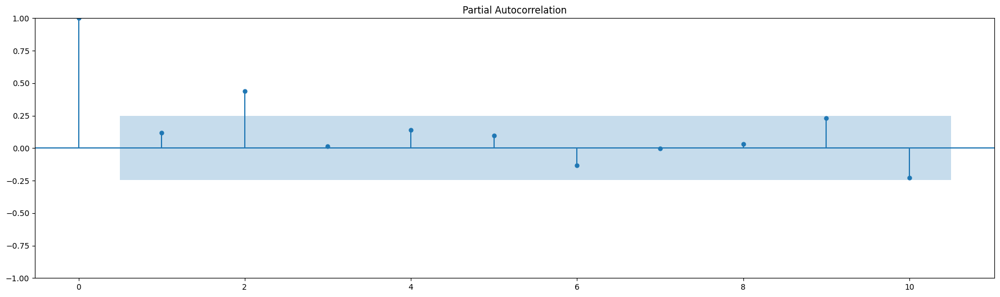


Статисткика по остаткам SKU_3_*_1_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9798495769500732
p-value Шапиро-Уилка : 0.38917994499206543

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    0.896961   0.343598   0.855563   0.354983     белый шум
2   14.304400   0.000783  13.437929   0.001208  не белый шум
3   14.891720   0.001912  13.980070   0.002932  не белый шум
4   21.713839   0.000228  20.172455   0.000462  не белый шум
5   23.234472   0.000304  21.529328   0.000643  не белый шум
6   23.812506   0.000565  22.036219   0.001193  не белый шум
7   24.484174   0.000936  22.614887   0.001989  не белый шум
8   24.815505   0.001670  22.895244   0.003501  не белый шум
9   29.908380   0.000455  27.126248   0.001333  не белый шум
10  30.985581   0.000590  28.004581   0.001802  не белый шум

Тест Дарбина-Уотсона: 1.7228721342203546
Отсутс

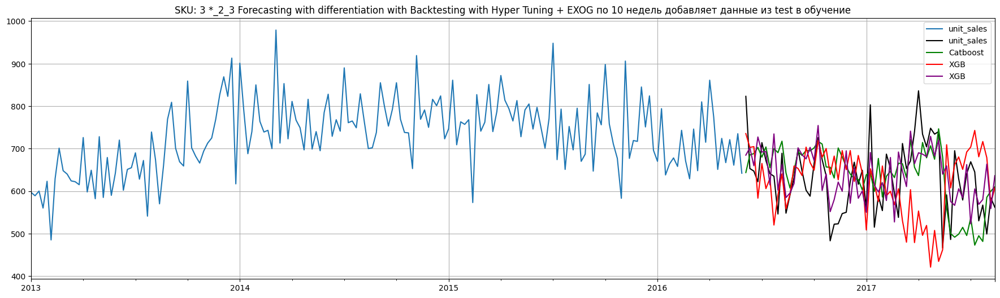

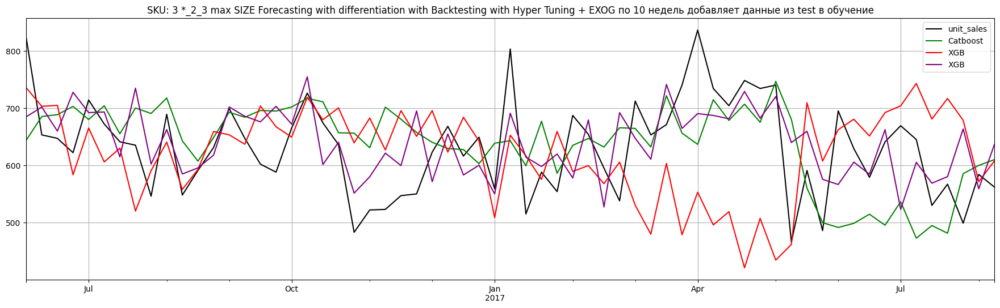

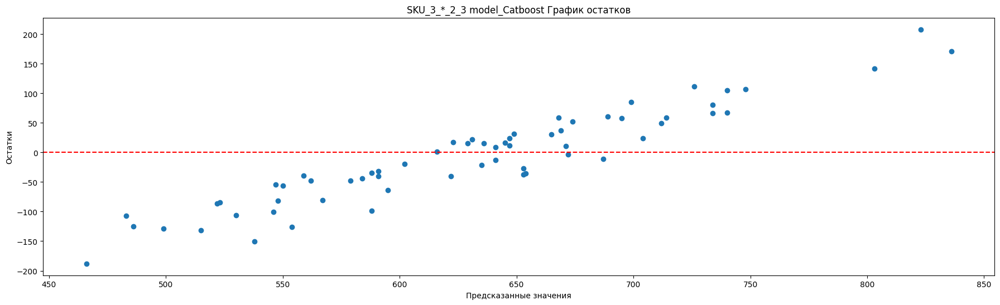

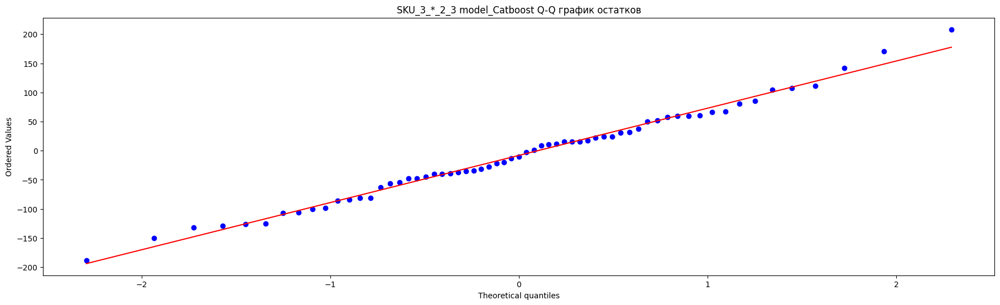

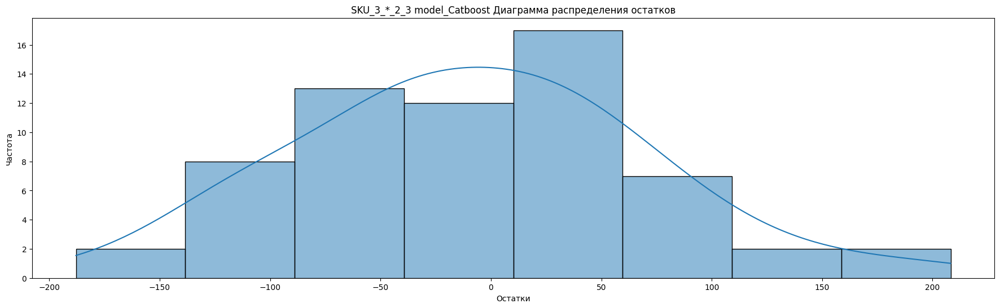

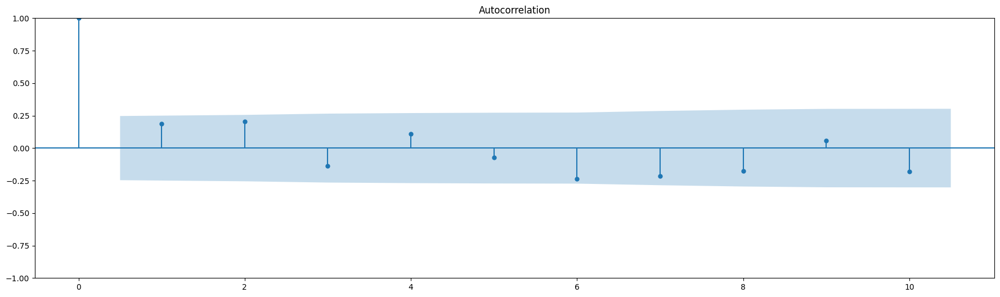

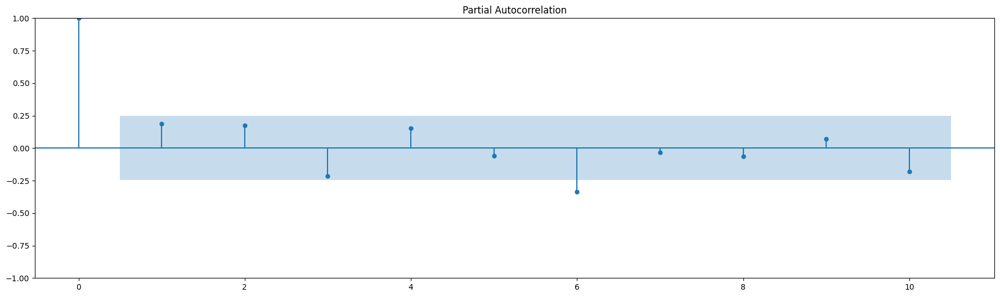


Статисткика по остаткам SKU_3_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9916377067565918
p-value Шапиро-Уилка : 0.9473419189453125

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    2.341190   0.125993   2.233136   0.135079     белый шум
2    5.131108   0.076877   4.851366   0.088418     белый шум
3    6.419104   0.092908   6.040285   0.109667     белый шум
4    7.267584   0.122405   6.810444   0.146251     белый шум
5    7.646001   0.176855   7.148108   0.209856     белый шум
6   11.669084   0.069772  10.676043   0.098920     белый шум
7   15.103936   0.034690  13.635300   0.058061  не белый шум
8   17.374515   0.026437  15.556559   0.049185  не белый шум
9   17.635017   0.039652  15.772976   0.071776  не белый шум
10  20.133100   0.028019  17.809875   0.058257  не белый шум

Тест Дарбина-Уотсона: 1.484611881662065
Отсу

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


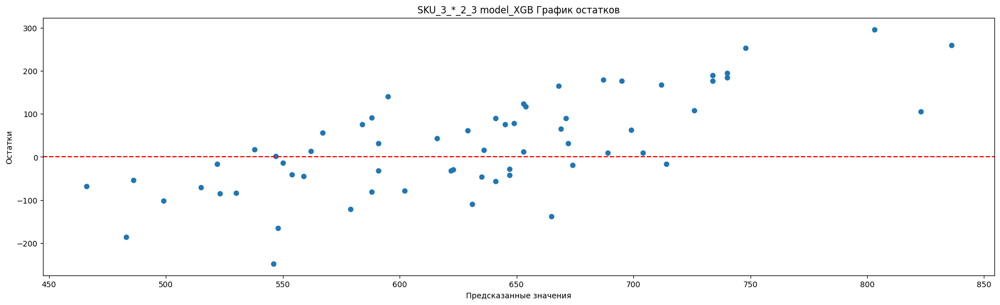

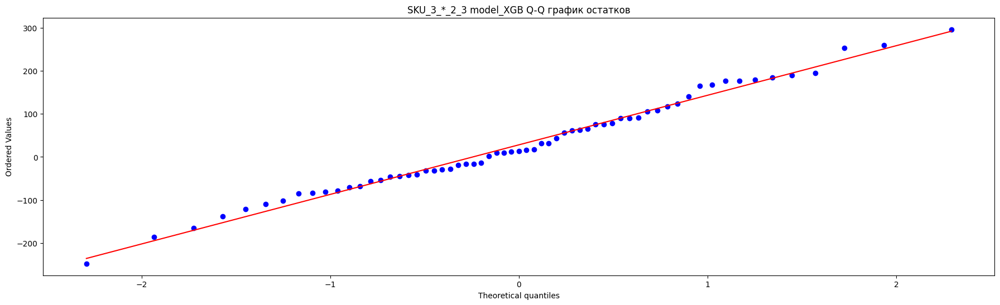

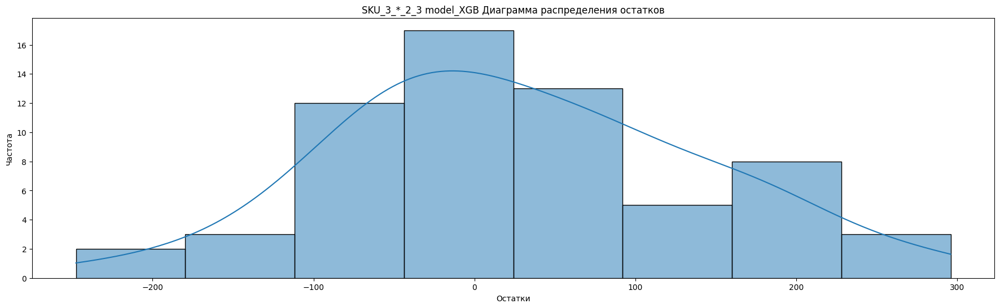

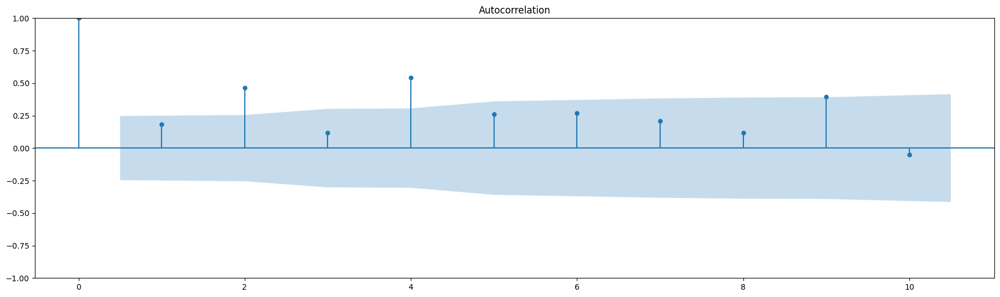

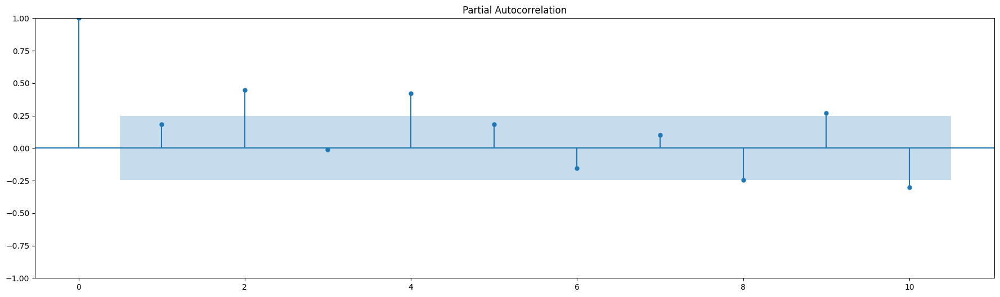


Статисткика по остаткам SKU_3_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.989284873008728
p-value Шапиро-Уилка : 0.860752522945404

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    2.208460  1.372557e-01   2.106531  1.466715e-01     белый шум
2   16.763166  2.290471e-04  15.765563  3.771825e-04  не белый шум
3   17.745172  4.964120e-04  16.672030  8.254276e-04  не белый шум
4   38.270511  9.854199e-08  35.302722  4.025519e-07  не белый шум
5   42.999145  3.696551e-08  39.522119  1.864194e-07  не белый шум
6   48.141304  1.107236e-08  44.031397  7.286871e-08  не белый шум
7   51.343327  7.864018e-09  46.790062  6.133787e-08  не белый шум
8   52.399208  1.409268e-08  47.683500  1.135579e-07  не белый шум
9   64.192406  2.070903e-10  57.480926  4.087562e-09  не белый шум
10  64.381782  5.321018e-10  57.635341  1.012475e-08 

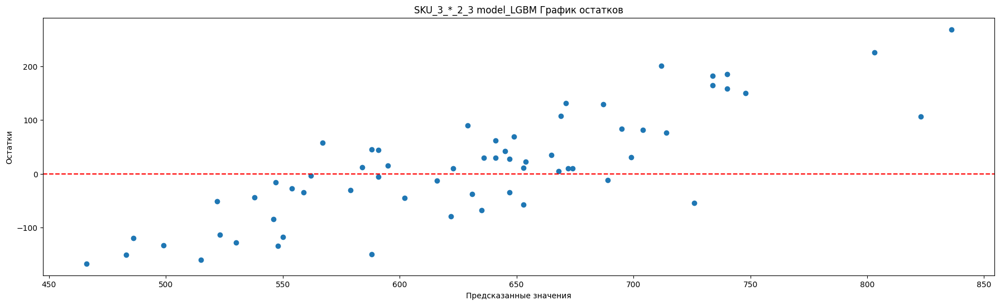

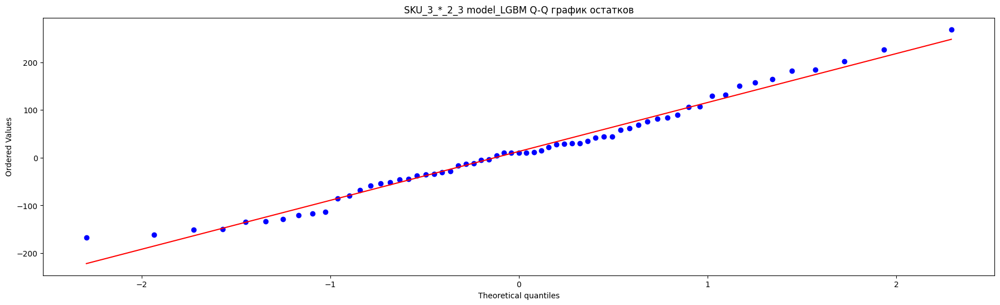

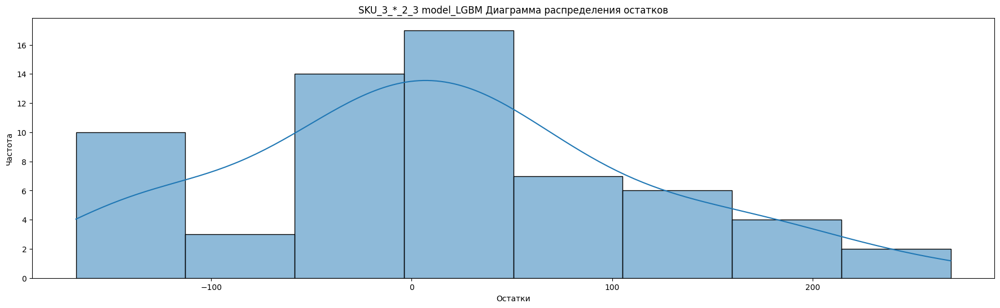

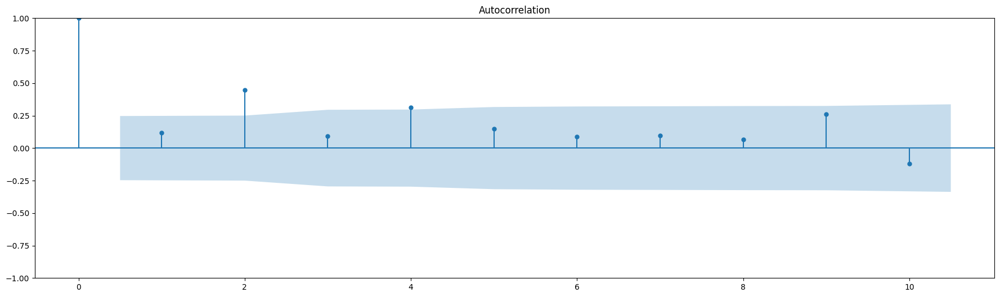

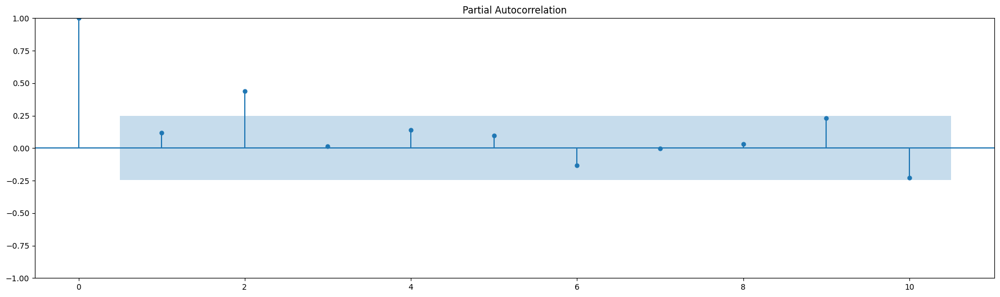


Статисткика по остаткам SKU_3_*_2_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9798495769500732
p-value Шапиро-Уилка : 0.38917994499206543

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    0.896961   0.343598   0.855563   0.354983     белый шум
2   14.304400   0.000783  13.437929   0.001208  не белый шум
3   14.891720   0.001912  13.980070   0.002932  не белый шум
4   21.713839   0.000228  20.172455   0.000462  не белый шум
5   23.234472   0.000304  21.529328   0.000643  не белый шум
6   23.812506   0.000565  22.036219   0.001193  не белый шум
7   24.484174   0.000936  22.614887   0.001989  не белый шум
8   24.815505   0.001670  22.895244   0.003501  не белый шум
9   29.908380   0.000455  27.126248   0.001333  не белый шум
10  30.985581   0.000590  28.004581   0.001802  не белый шум

Тест Дарбина-Уотсона: 1.7228721342203546
Отсутс

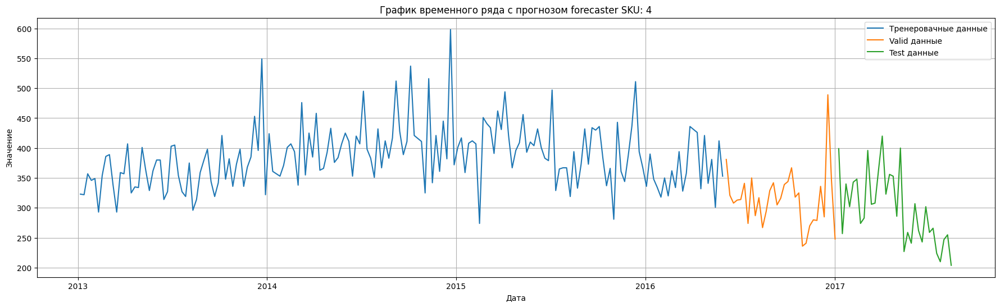

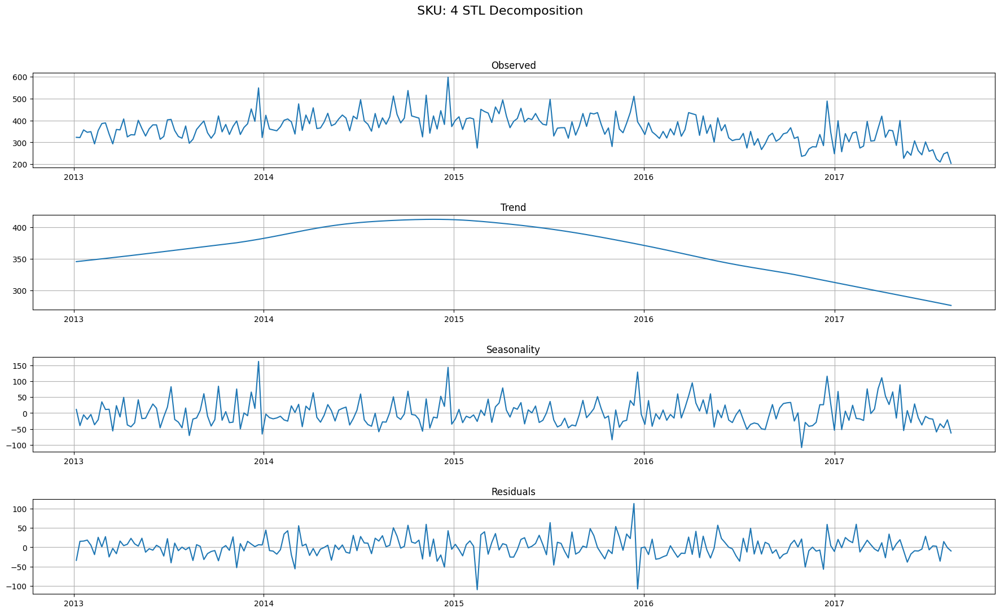

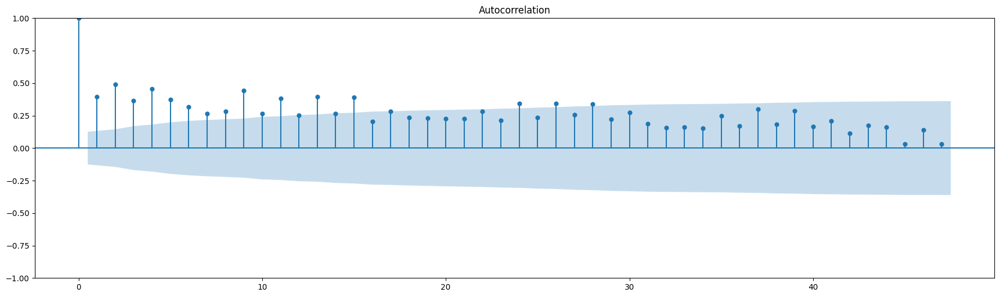

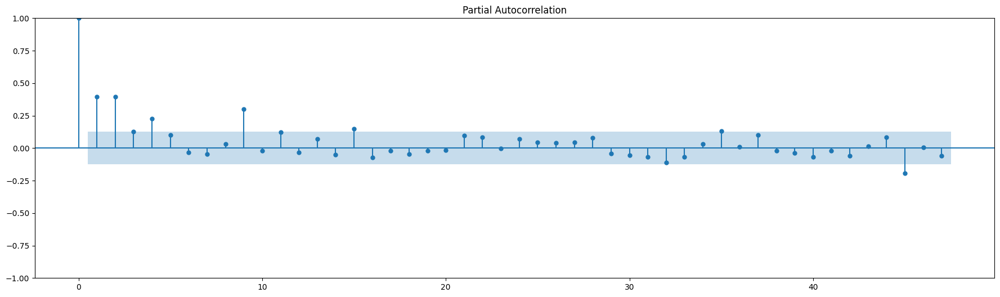

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3 27 52] 
  Parameters: {'depth': 12, 'learning_rate': 0.4941731597644129, 'iterations': 300}
  Backtesting metric: 33.59889479134911

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'max_depth': 11, 'reg_alpha': 0.30000000000000004, 'reg_lambda': 0.30000000000000004, 'n_estimators': 700}
  Backtesting metric: 50.07279648319368

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the

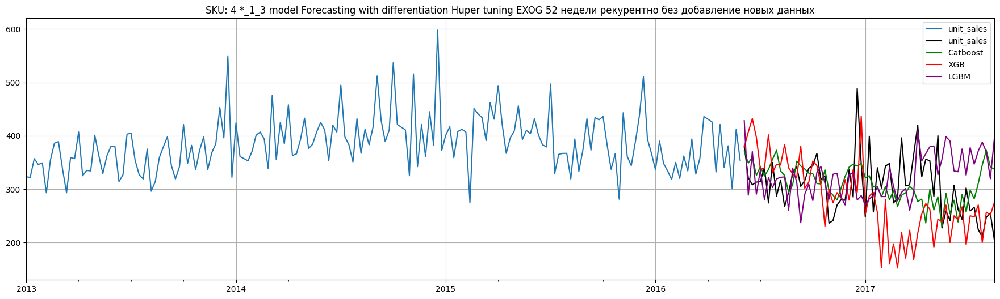

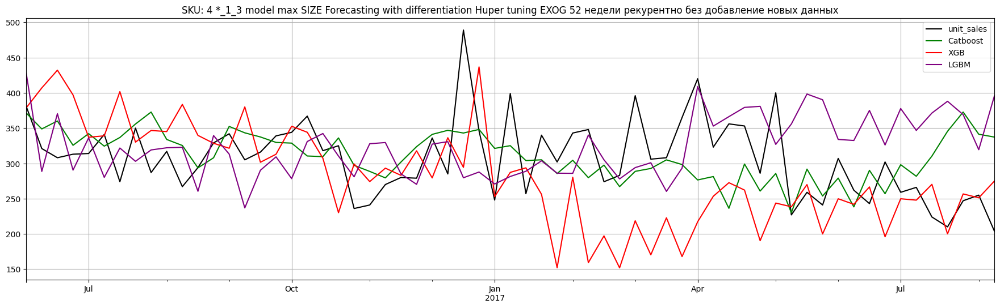

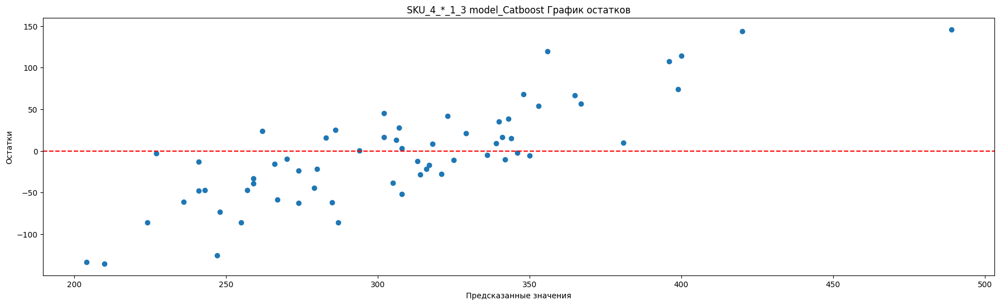

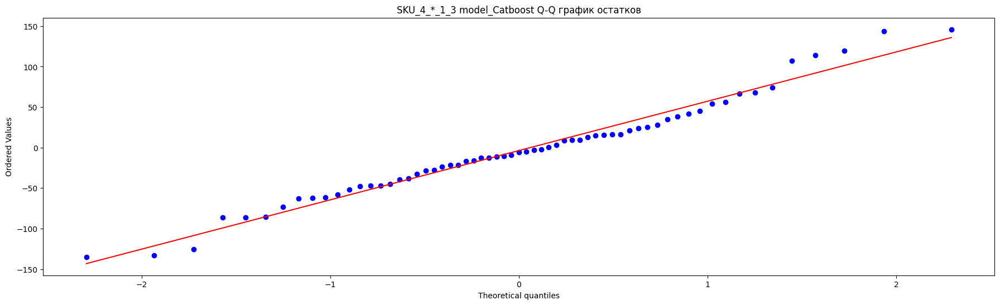

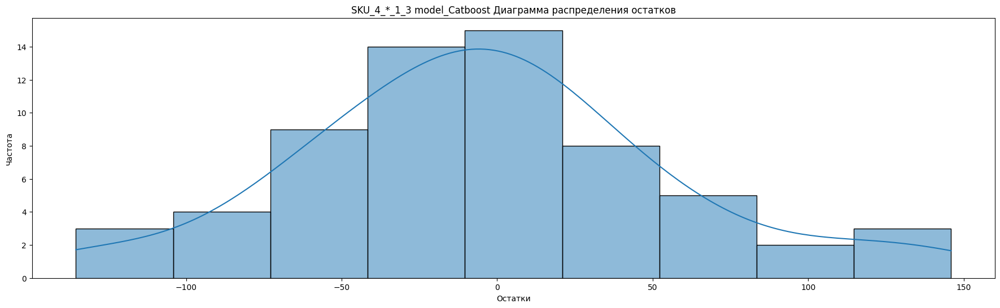

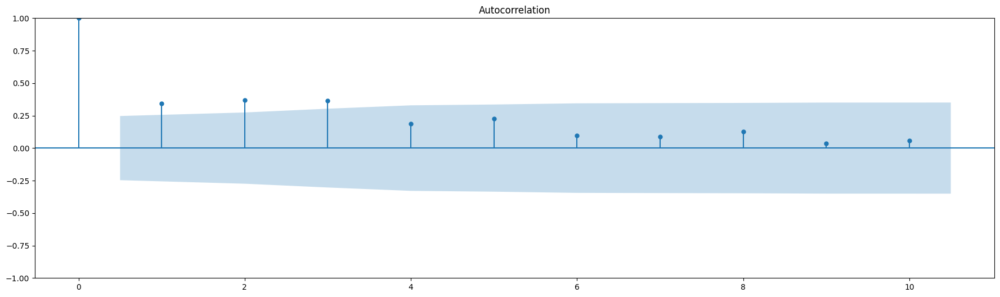

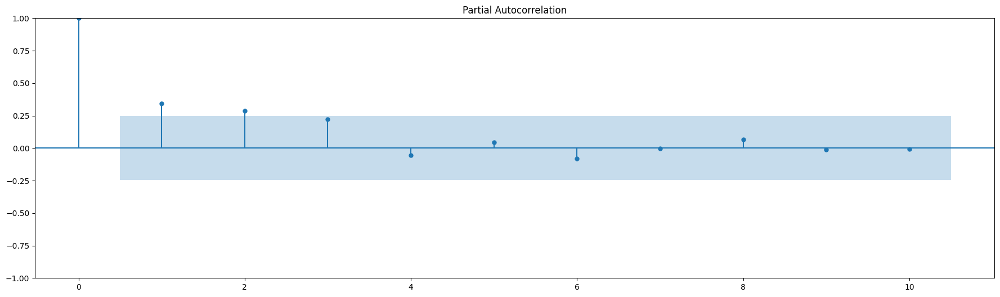


Статисткика по остаткам SKU_4_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9765775203704834
p-value Шапиро-Уилка : 0.2720221281051636

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    7.684674   0.005569   7.329997   0.006781  не белый шум
2   16.921654   0.000212  15.998547   0.000336  не белый шум
3   26.088632   0.000009  24.460373   0.000020  не белый шум
4   28.477667   0.000010  26.628882   0.000024  не белый шум
5   32.078135   0.000006  29.841607   0.000016  не белый шум
6   32.739188   0.000012  30.421300   0.000033  не белый шум
7   33.326065   0.000023  30.926917   0.000064  не белый шум
8   34.503511   0.000033  31.923217   0.000096  не белый шум
9   34.611519   0.000070  32.012947   0.000198  не белый шум
10  34.852523   0.000132  32.209458   0.000369  не белый шум

Тест Дарбина-Уотсона: 1.2377850090650855
Отс

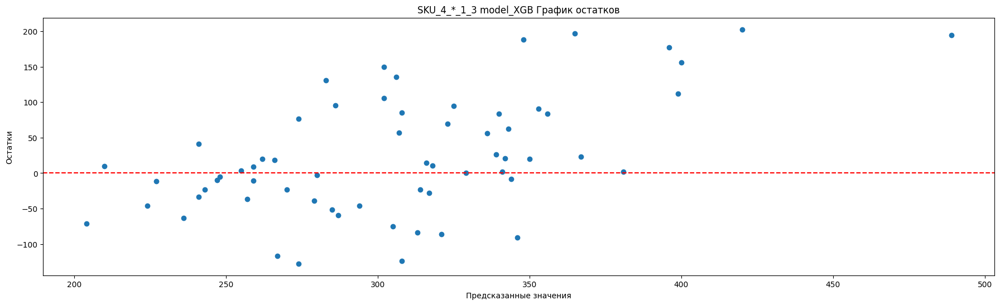

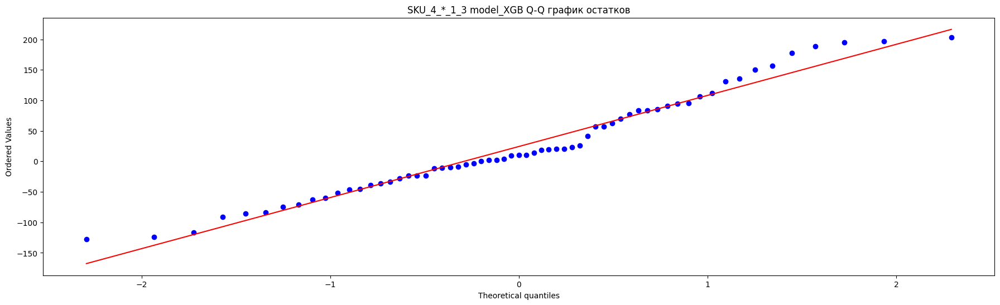

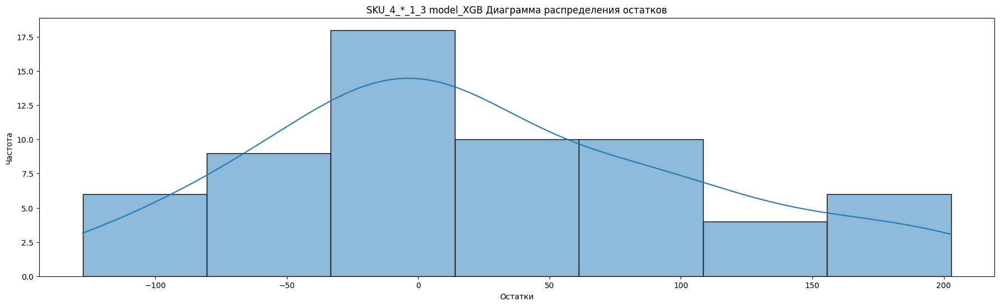

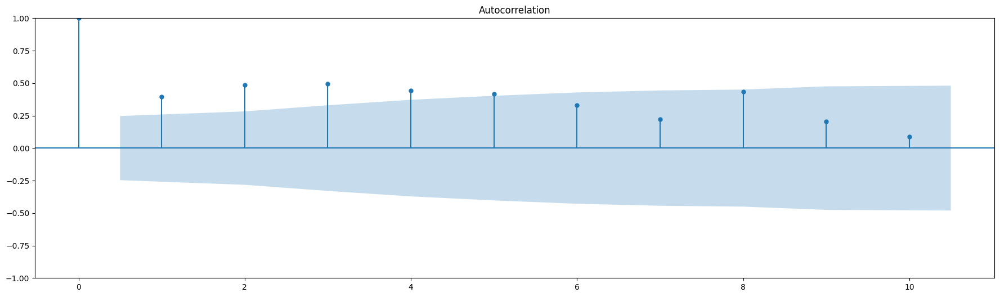

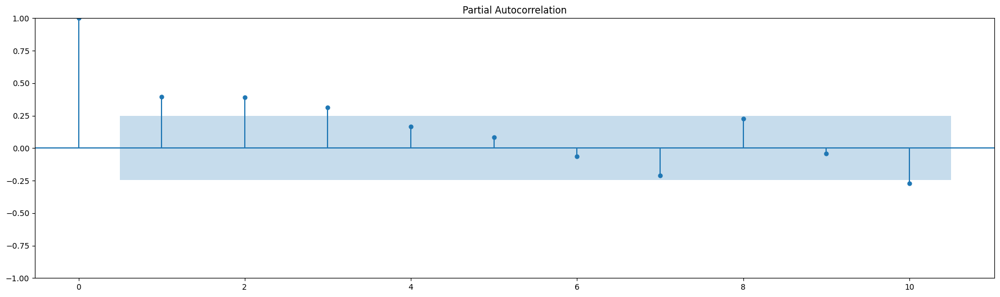


Статисткика по остаткам SKU_4_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9668341875076294
p-value Шапиро-Уилка : 0.08714570105075836

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   10.211538  1.395647e-03   9.740236  1.802777e-03  не белый шум
2   26.076756  2.175226e-06  24.629133  4.485921e-06  не белый шум
3   42.652031  2.917328e-09  39.929387  1.102871e-08  не белый шум
4   56.235426  1.789739e-11  52.258930  1.217752e-10  не белый шум
5   68.619705  1.984986e-13  63.309518  2.511584e-12  не белый шум
6   76.495932  1.888016e-14  70.216363  3.691686e-13  не белый шум
7   80.115068  1.305049e-14  73.334387  3.122846e-13  не белый шум
8   94.090931  6.851597e-17  85.160118  4.447577e-15  не белый шум
9   97.293687  5.542511e-17  87.820869  4.451167e-15  не белый шум
10  97.902058  1.431780e-16  88.316925  1.154206e-

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


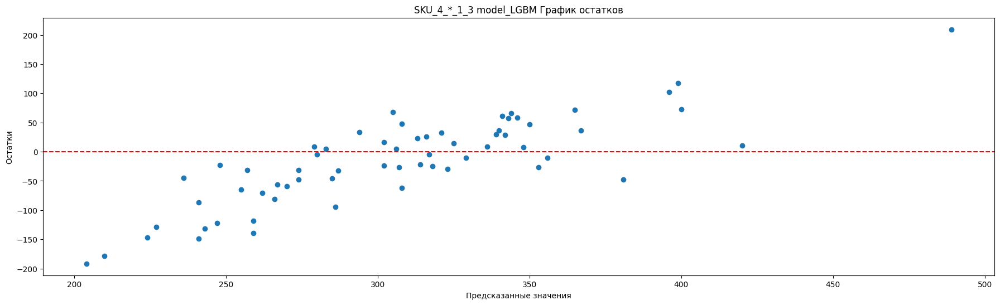

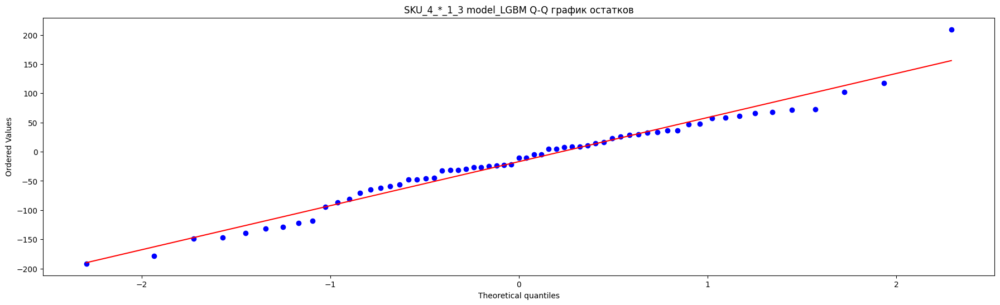

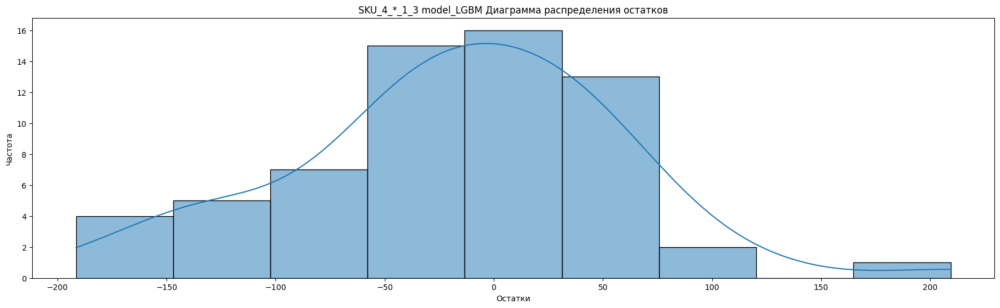

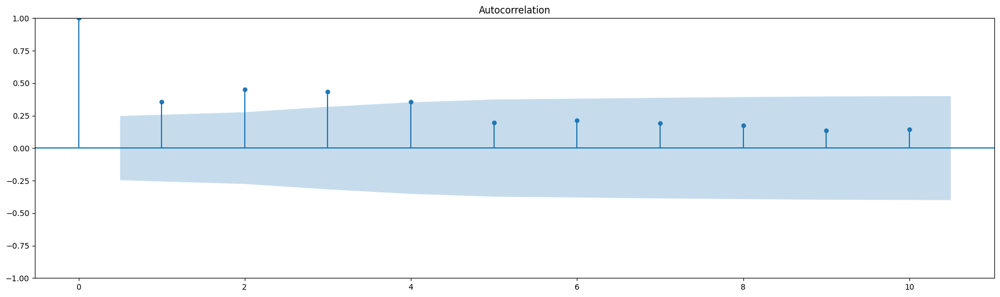

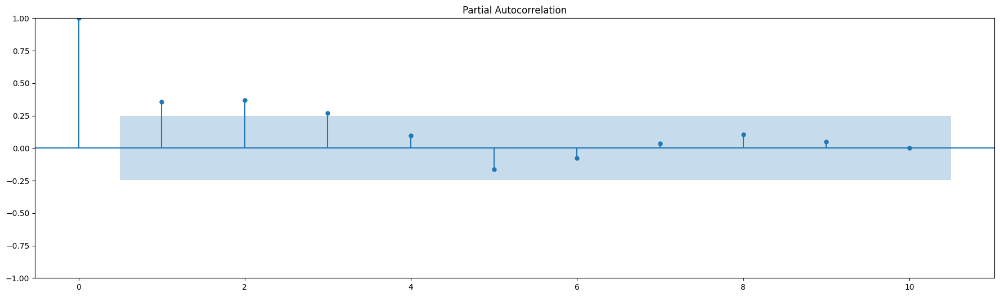


Статисткика по остаткам SKU_4_*_1_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9789870977401733
p-value Шапиро-Уилка : 0.3549267649650574

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    8.281623  4.004832e-03   7.899394  4.945136e-03  не белый шум
2   21.861865  1.789602e-05  20.643929  3.290242e-05  не белый шум
3   34.844465  1.313997e-07  32.627868  3.858597e-07  не белый шум
4   43.727653  7.308188e-09  40.691069  3.114252e-08  не белый шум
5   46.414374  7.478273e-09  43.088451  3.545639e-08  не белый шум
6   49.667237  5.481348e-09  45.940961  3.041765e-08  не белый шум
7   52.296964  5.102264e-09  48.206572  3.244390e-08  не белый шум
8   54.564749  5.363838e-09  50.125468  3.866022e-08  не белый шум
9   55.937277  8.068934e-09  51.265721  6.221293e-08  не белый шум
10  57.522028  1.063403e-08  52.557903  8.994151e-

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


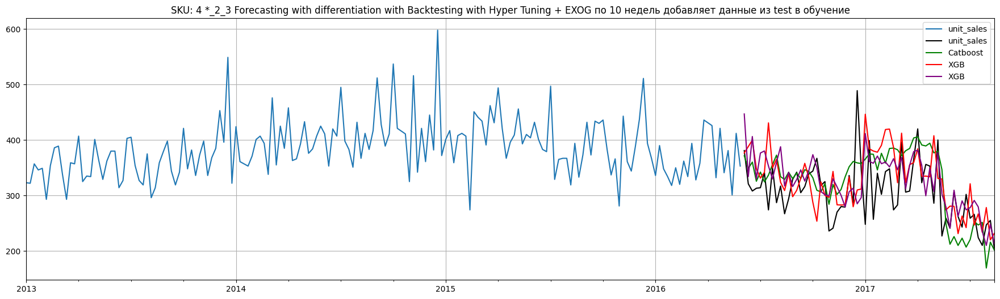

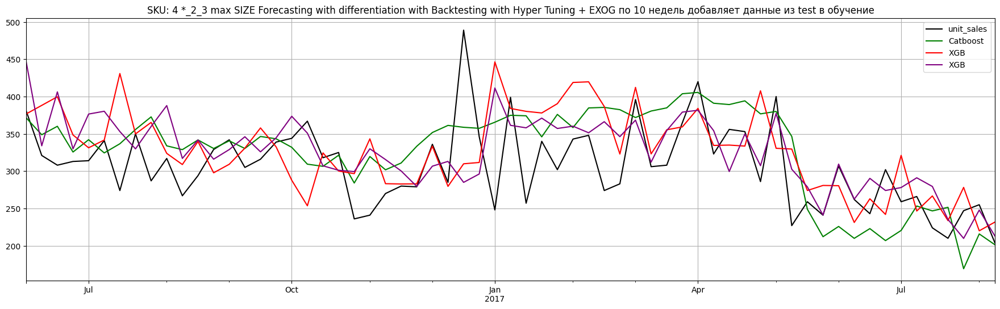

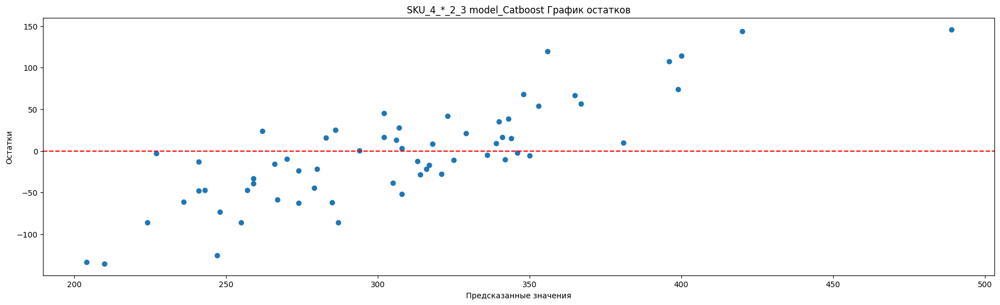

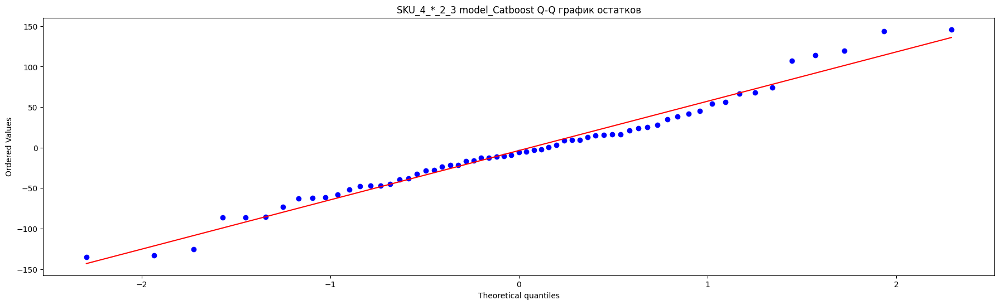

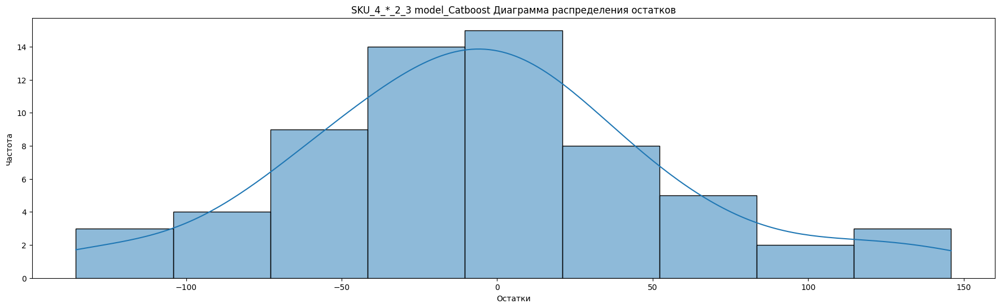

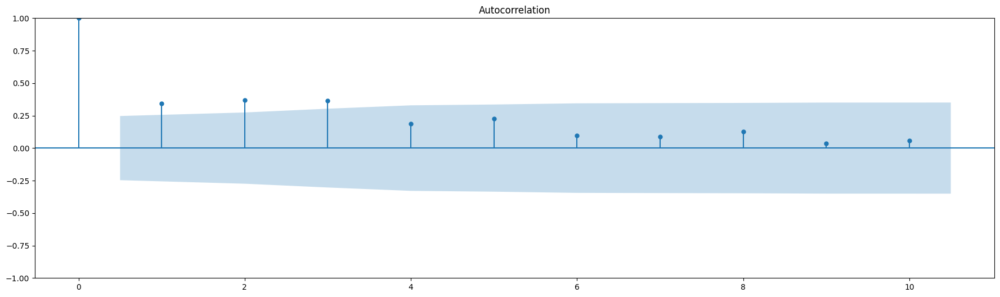

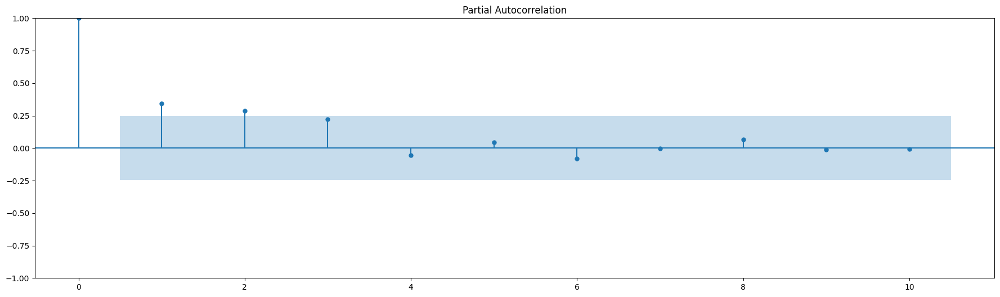


Статисткика по остаткам SKU_4_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9765775203704834
p-value Шапиро-Уилка : 0.2720221281051636

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    7.684674   0.005569   7.329997   0.006781  не белый шум
2   16.921654   0.000212  15.998547   0.000336  не белый шум
3   26.088632   0.000009  24.460373   0.000020  не белый шум
4   28.477667   0.000010  26.628882   0.000024  не белый шум
5   32.078135   0.000006  29.841607   0.000016  не белый шум
6   32.739188   0.000012  30.421300   0.000033  не белый шум
7   33.326065   0.000023  30.926917   0.000064  не белый шум
8   34.503511   0.000033  31.923217   0.000096  не белый шум
9   34.611519   0.000070  32.012947   0.000198  не белый шум
10  34.852523   0.000132  32.209458   0.000369  не белый шум

Тест Дарбина-Уотсона: 1.2377850090650855
Отс

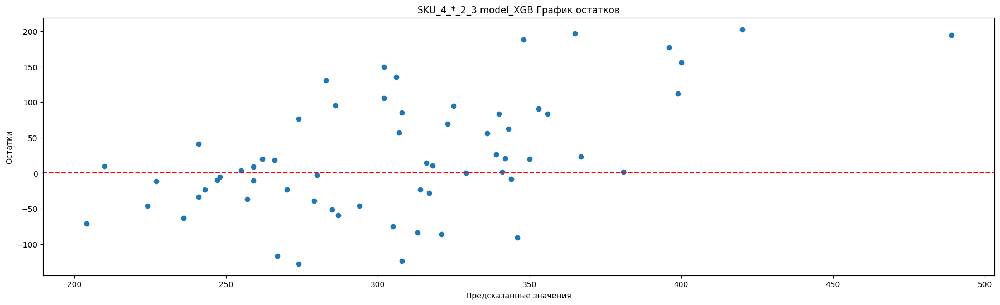

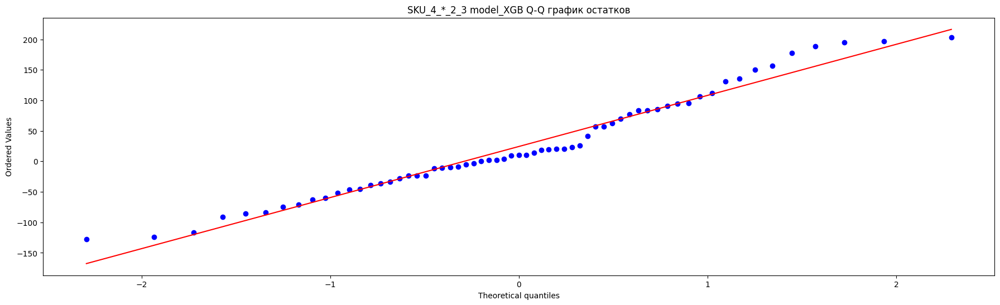

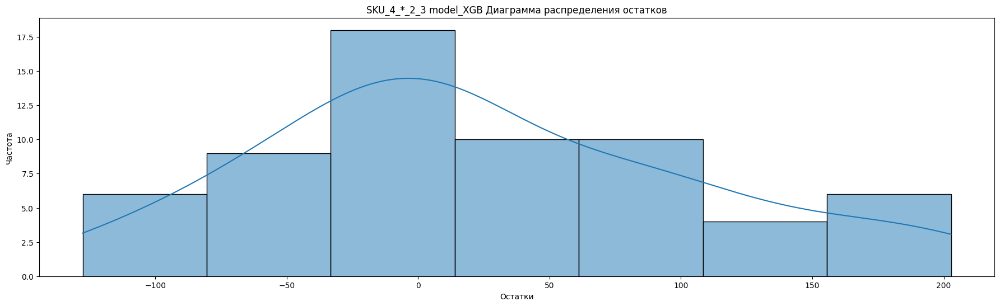

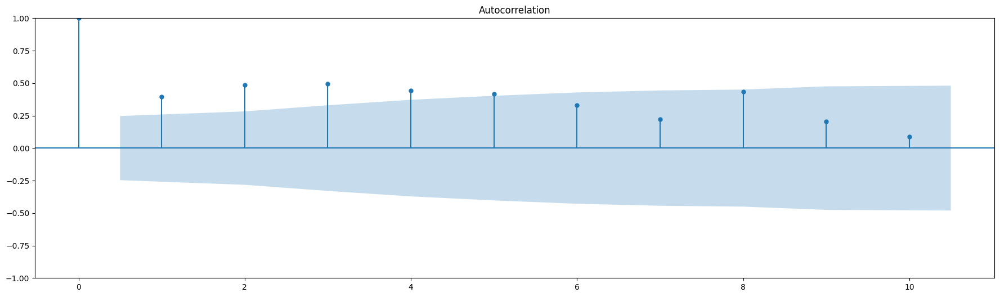

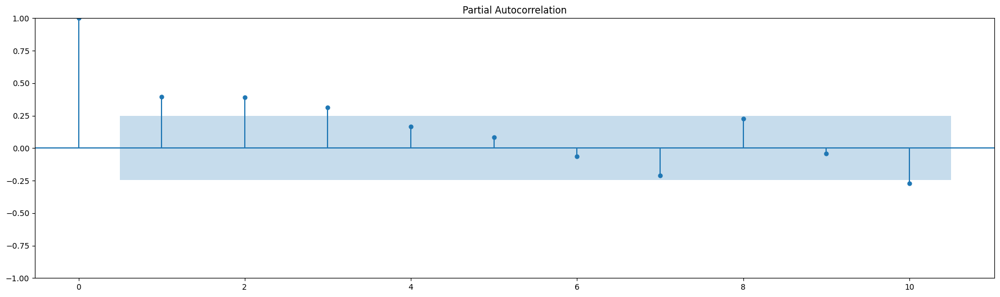


Статисткика по остаткам SKU_4_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9668341875076294
p-value Шапиро-Уилка : 0.08714570105075836

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   10.211538  1.395647e-03   9.740236  1.802777e-03  не белый шум
2   26.076756  2.175226e-06  24.629133  4.485921e-06  не белый шум
3   42.652031  2.917328e-09  39.929387  1.102871e-08  не белый шум
4   56.235426  1.789739e-11  52.258930  1.217752e-10  не белый шум
5   68.619705  1.984986e-13  63.309518  2.511584e-12  не белый шум
6   76.495932  1.888016e-14  70.216363  3.691686e-13  не белый шум
7   80.115068  1.305049e-14  73.334387  3.122846e-13  не белый шум
8   94.090931  6.851597e-17  85.160118  4.447577e-15  не белый шум
9   97.293687  5.542511e-17  87.820869  4.451167e-15  не белый шум
10  97.902058  1.431780e-16  88.316925  1.154206e-

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


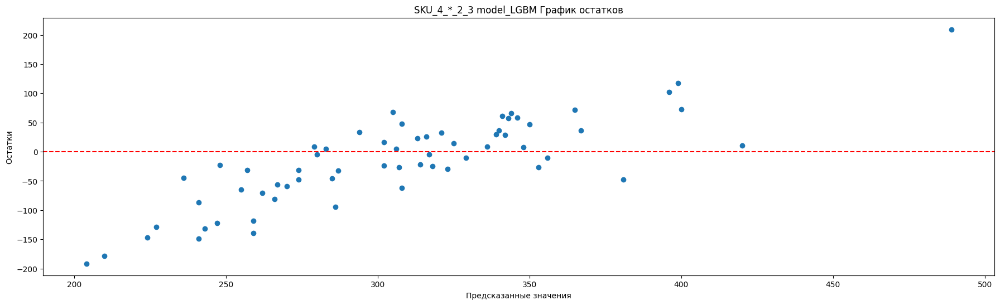

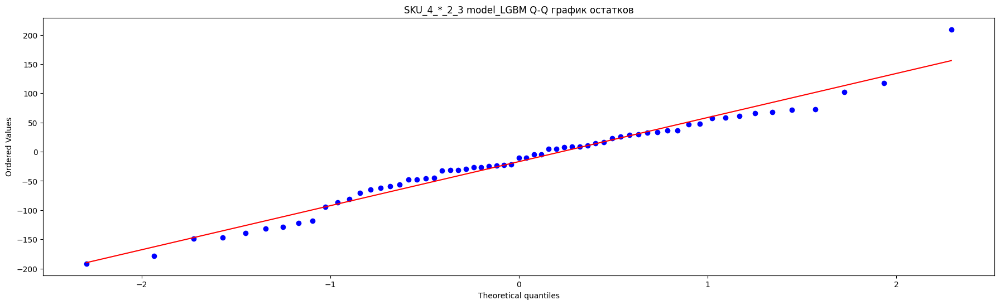

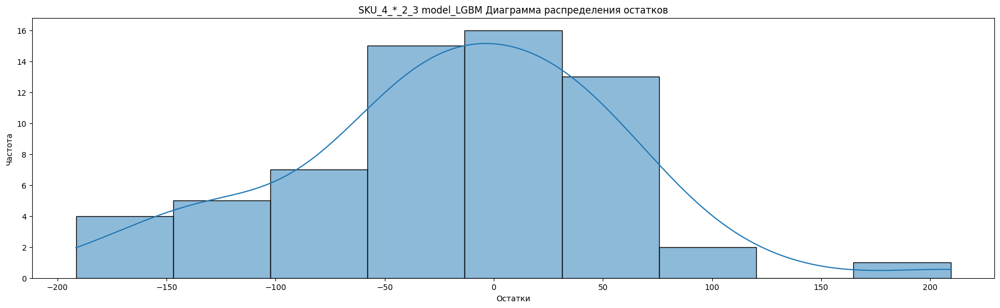

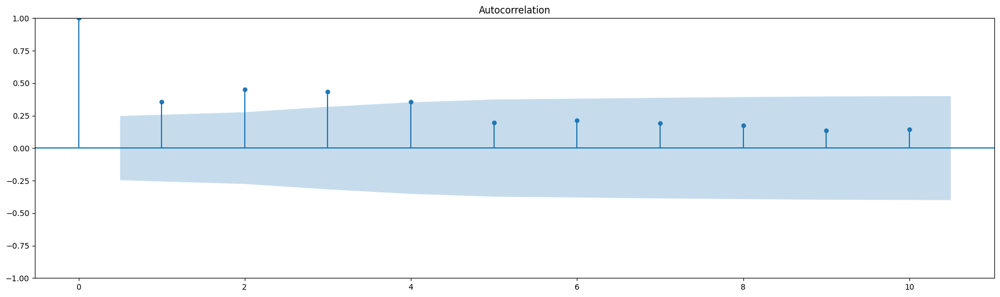

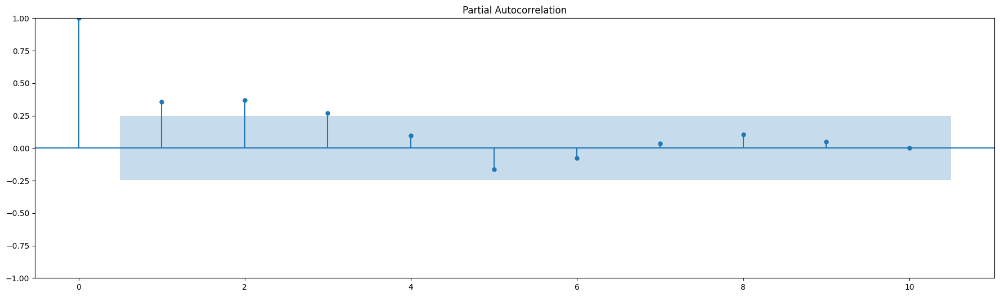


Статисткика по остаткам SKU_4_*_2_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9789870977401733
p-value Шапиро-Уилка : 0.3549267649650574

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    8.281623  4.004832e-03   7.899394  4.945136e-03  не белый шум
2   21.861865  1.789602e-05  20.643929  3.290242e-05  не белый шум
3   34.844465  1.313997e-07  32.627868  3.858597e-07  не белый шум
4   43.727653  7.308188e-09  40.691069  3.114252e-08  не белый шум
5   46.414374  7.478273e-09  43.088451  3.545639e-08  не белый шум
6   49.667237  5.481348e-09  45.940961  3.041765e-08  не белый шум
7   52.296964  5.102264e-09  48.206572  3.244390e-08  не белый шум
8   54.564749  5.363838e-09  50.125468  3.866022e-08  не белый шум
9   55.937277  8.068934e-09  51.265721  6.221293e-08  не белый шум
10  57.522028  1.063403e-08  52.557903  8.994151e-

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


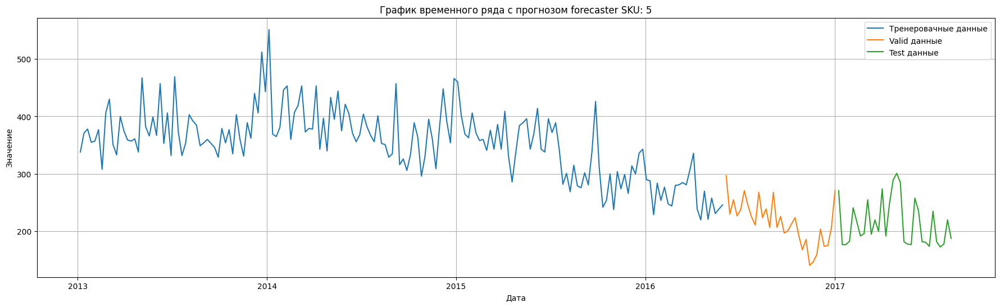

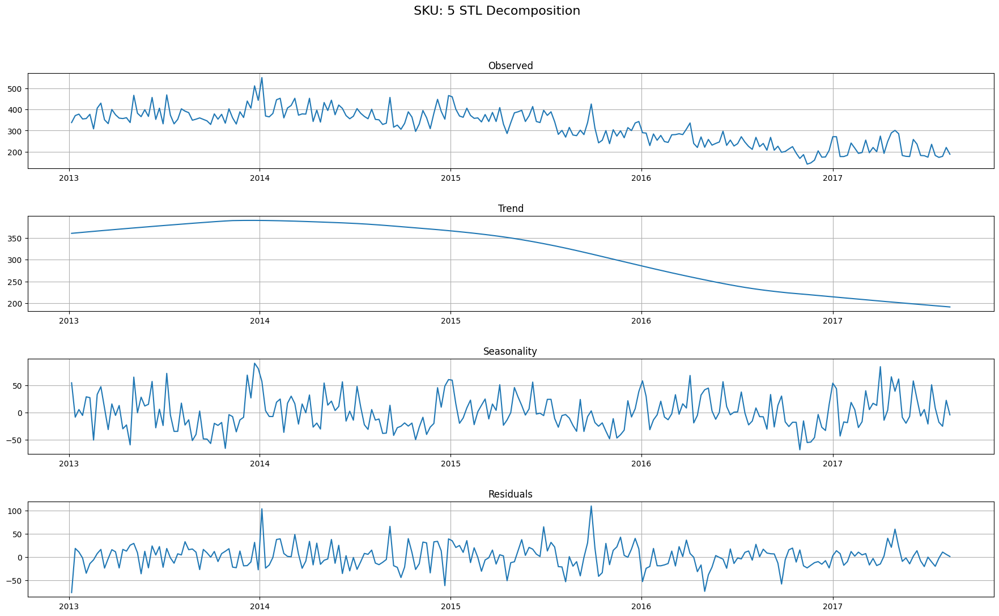

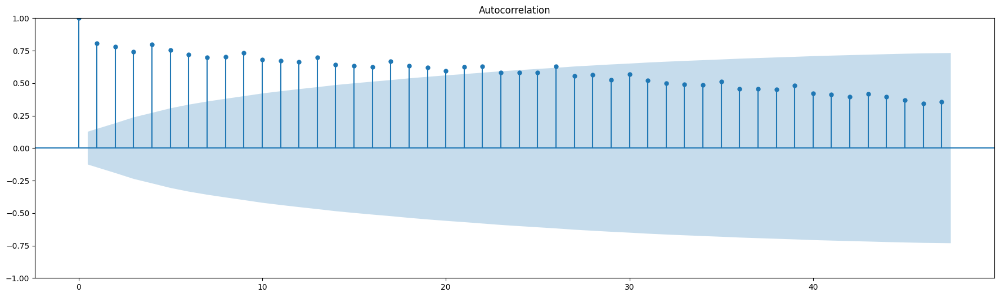

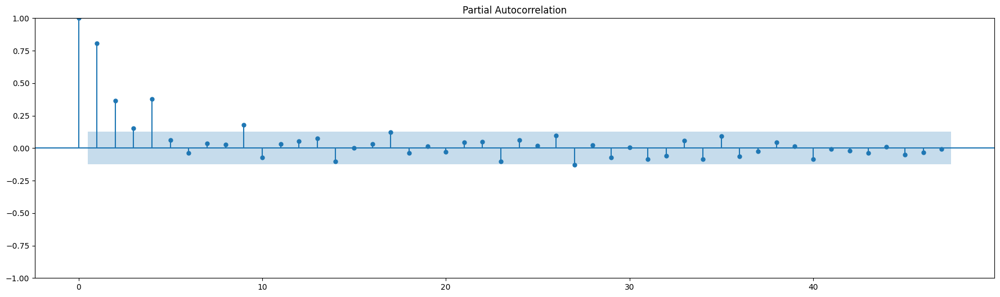

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'depth': 11, 'learning_rate': 0.23295777487661928, 'iterations': 300}
  Backtesting metric: 36.31713054135911

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'max_depth': 11, 'reg_alpha': 0.5, 'reg_lambda': 0.30000000000000004, 'n_estimators': 700}
  Backtesting metric: 29.35381863482537

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found la

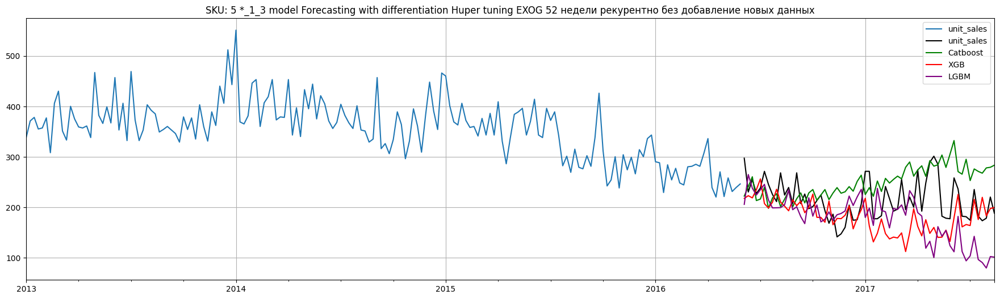

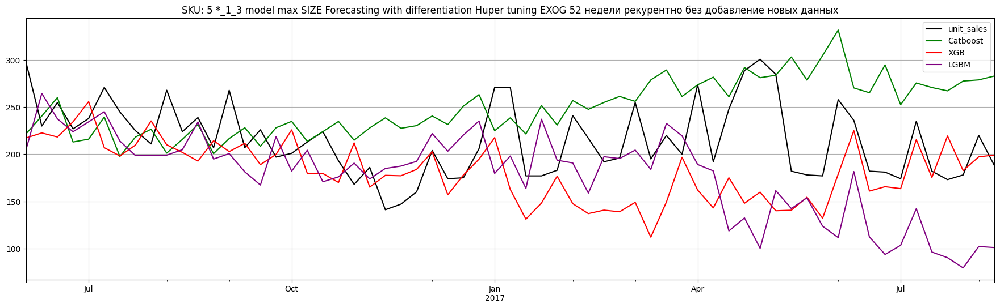

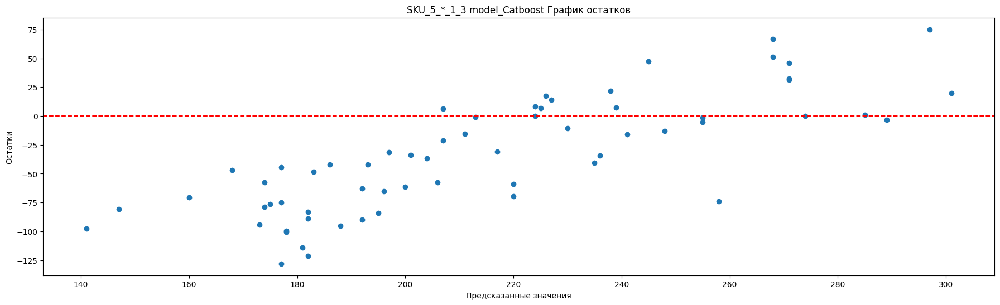

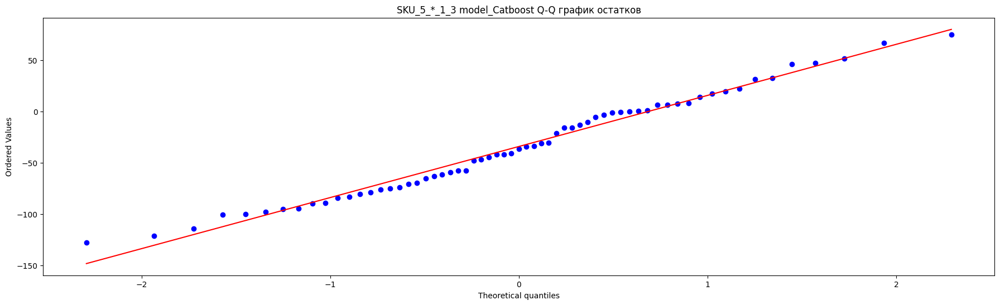

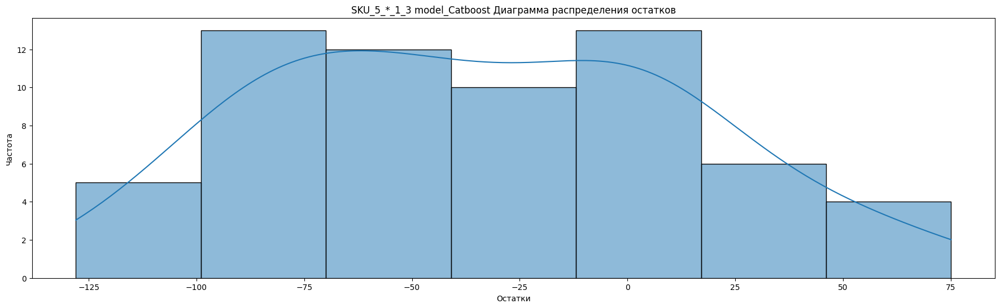

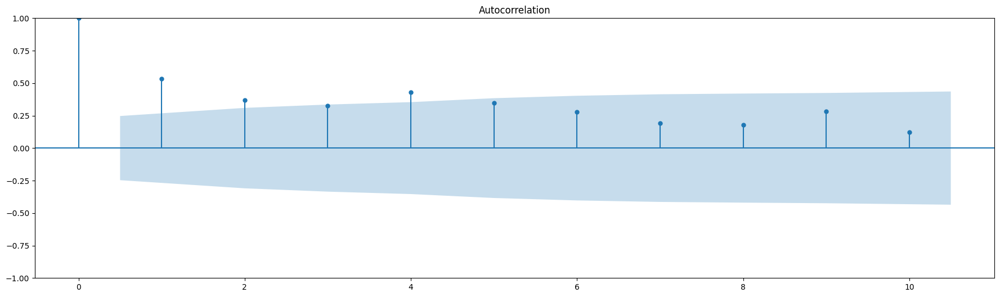

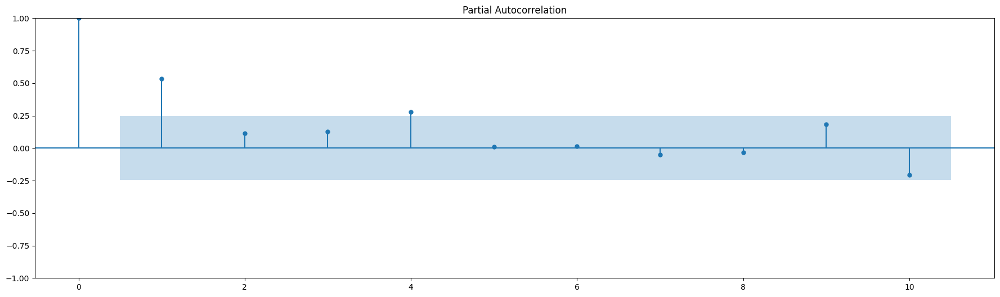


Статисткика по остаткам SKU_5_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9799597859382629
p-value Шапиро-Уилка : 0.39373210072517395

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   18.876336  1.394721e-05  18.005121  2.203115e-05  не белый шум
2   27.964960  8.462253e-07  26.534445  1.730288e-06  не белый шум
3   35.124810  1.146480e-07  33.143536  3.003780e-07  не белый шум
4   47.854654  1.011975e-09  44.698318  4.593617e-09  не белый шум
5   56.405211  6.705777e-11  52.328046  4.620428e-10  не белый шум
6   61.933173  1.820412e-11  57.175643  1.683289e-10  не белый шум
7   64.658359  1.761330e-11  59.523496  1.879131e-10  не белый шум
8   67.016755  1.924123e-11  61.519062  2.344732e-10  не белый шум
9   73.072032  3.792425e-12  66.549600  7.200592e-11  не белый шум
10  74.226212  6.728582e-12  67.490700  1.349

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


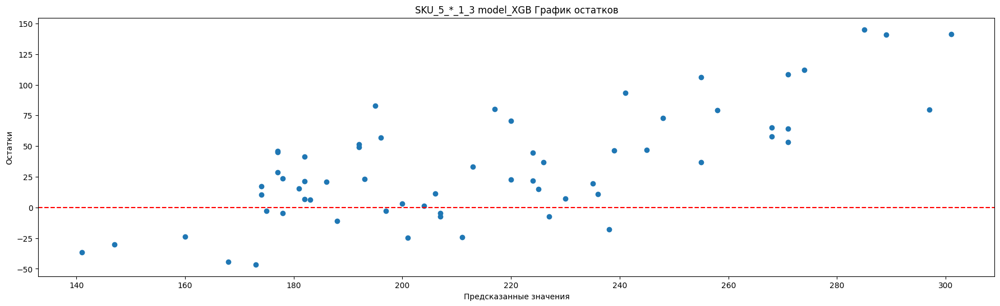

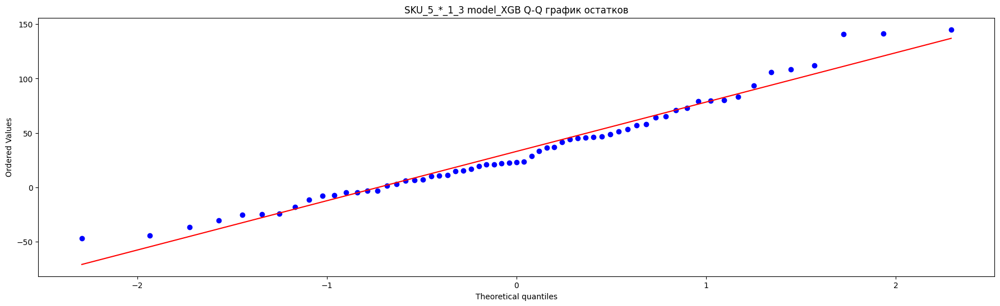

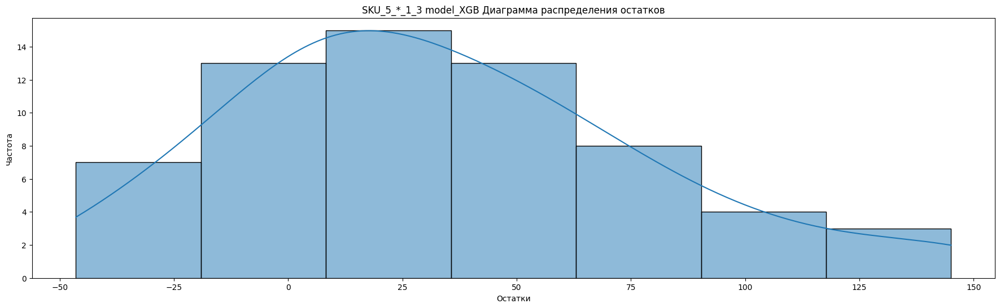

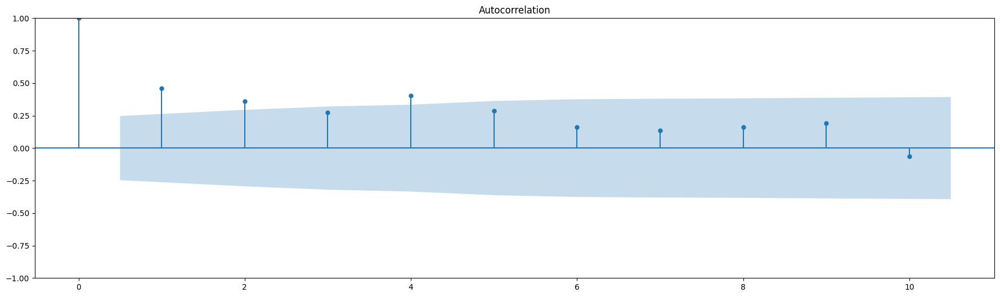

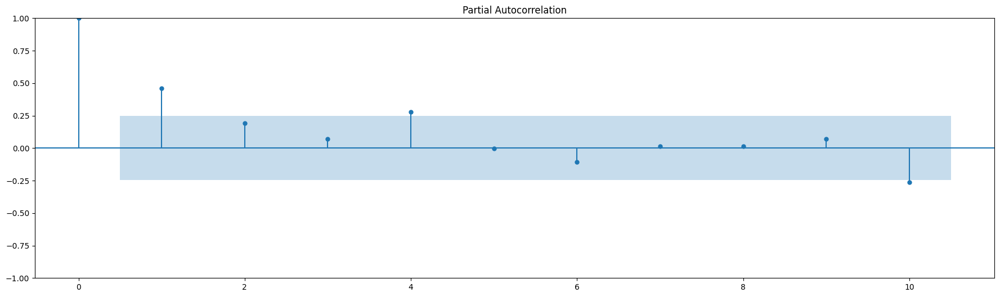


Статисткика по остаткам SKU_5_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9662870168685913
p-value Шапиро-Уилка : 0.08167204260826111

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   13.871445  1.957501e-04  13.231225  2.753239e-04  не белый шум
2   22.613183  1.229163e-05  21.435010  2.215373e-05  не белый шум
3   27.790105  4.019765e-06  26.213706  8.603586e-06  не белый шум
4   39.007751  6.940814e-08  36.395878  2.398778e-07  не белый шум
5   44.738934  1.639438e-08  41.509857  7.400968e-08  не белый шум
6   46.592413  2.256151e-08  43.135214  1.096731e-07  не белый шум
7   47.946904  3.646725e-08  44.302161  1.867660e-07  не белый шум
8   49.860539  4.346847e-08  45.921390  2.460198e-07  не белый шум
9   52.646582  3.410306e-08  48.235949  2.307392e-07  не белый шум
10  52.953072  7.596859e-08  48.485856  5.059079e-

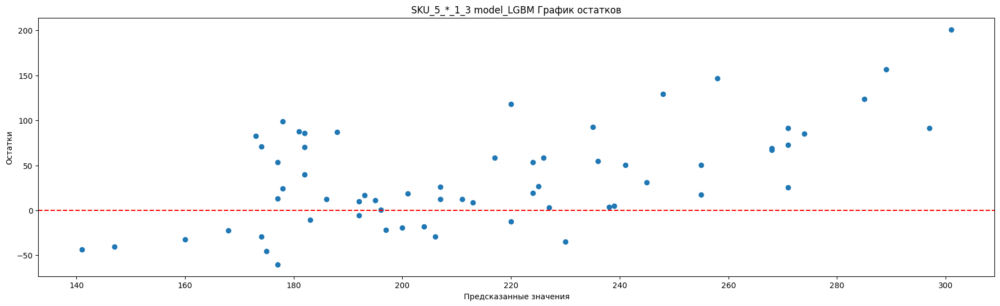

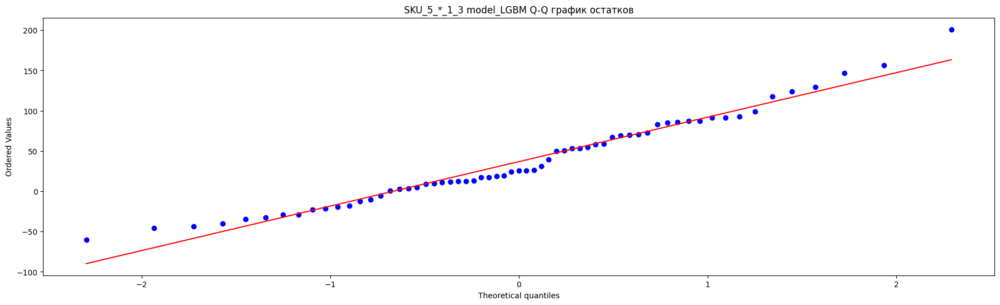

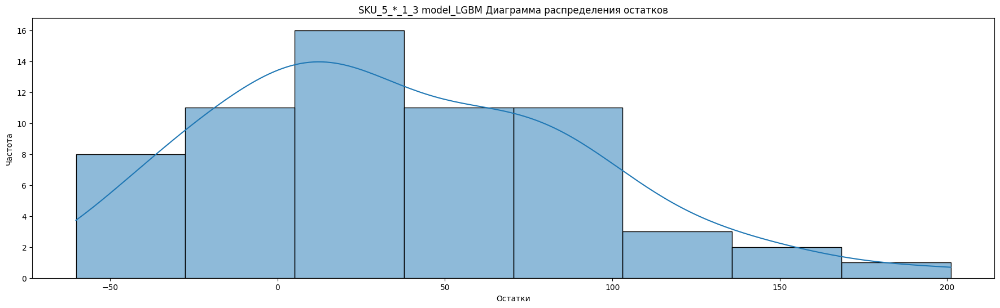

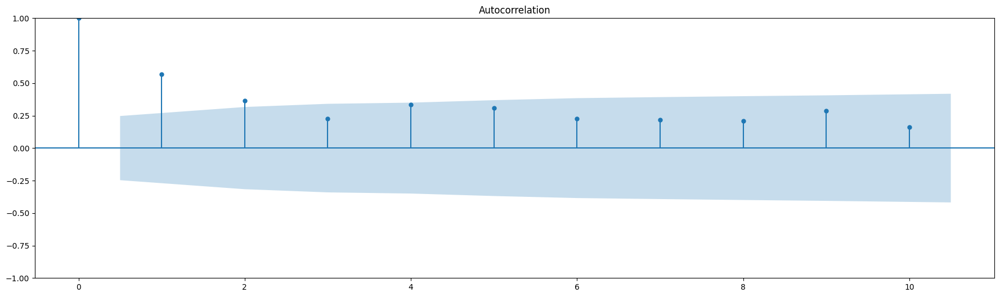

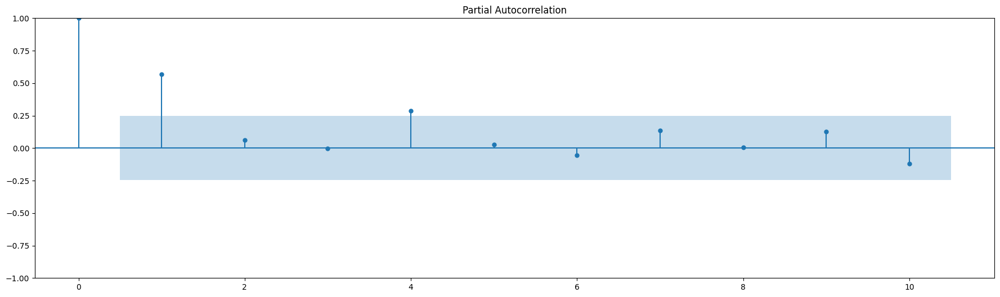


Статисткика по остаткам SKU_5_*_1_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9685745239257812
p-value Шапиро-Уилка : 0.10711175203323364

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   21.174980  4.192015e-06  20.197673  6.983783e-06  не белый шум
2   30.032965  3.009016e-07  28.510552  6.441876e-07  не белый шум
3   33.485714  2.543738e-07  31.697704  6.060237e-07  не белый шум
4   41.294432  2.335770e-08  38.785618  7.714134e-08  не белый шум
5   48.107709  3.376568e-09  44.865157  1.545402e-08  не белый шум
6   51.720253  2.122645e-09  48.033081  1.163770e-08  не белый шум
7   55.126651  1.407194e-09  50.967823  9.322462e-09  не белый шум
8   58.345344  9.831501e-10  53.691333  7.923443e-09  не белый шум
9   64.536841  1.775158e-10  58.835038  2.246674e-09  не белый шум
10  66.513932  2.078601e-10  60.447128  2.982454e

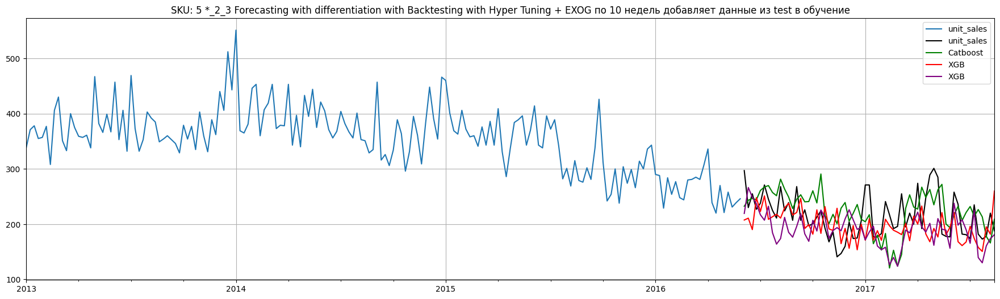

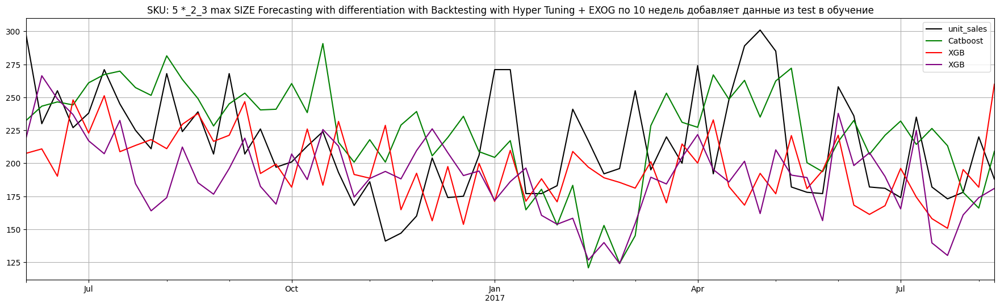

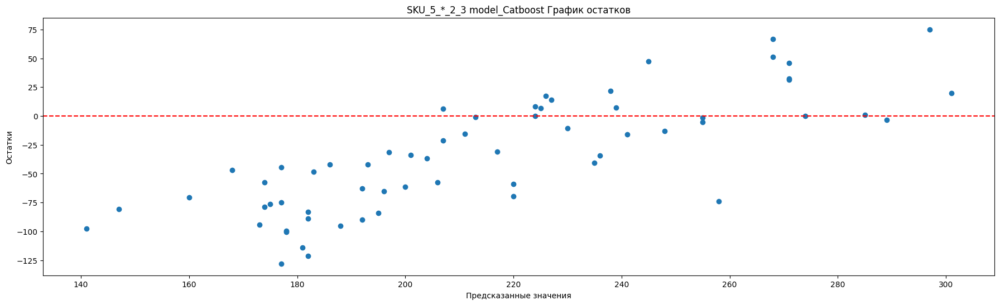

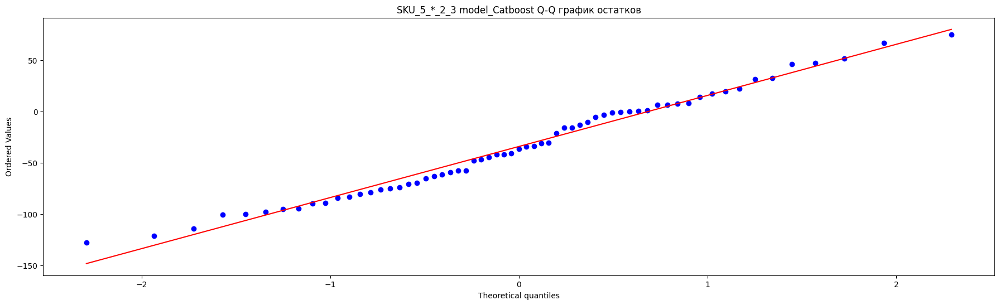

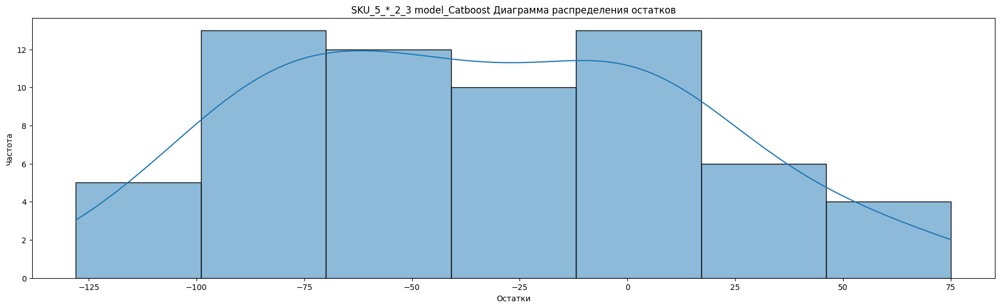

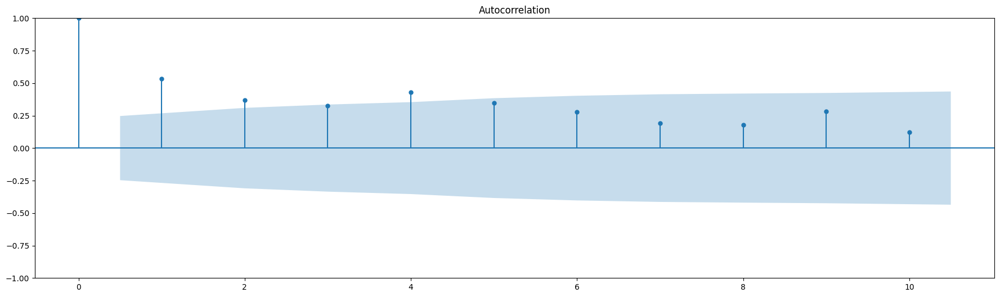

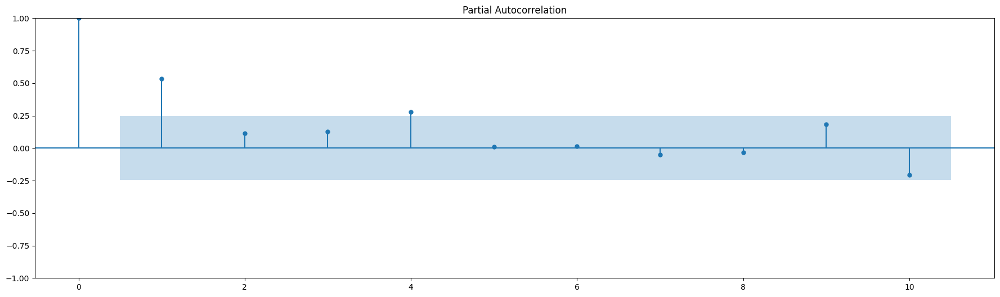


Статисткика по остаткам SKU_5_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9799597859382629
p-value Шапиро-Уилка : 0.39373210072517395

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   18.876336  1.394721e-05  18.005121  2.203115e-05  не белый шум
2   27.964960  8.462253e-07  26.534445  1.730288e-06  не белый шум
3   35.124810  1.146480e-07  33.143536  3.003780e-07  не белый шум
4   47.854654  1.011975e-09  44.698318  4.593617e-09  не белый шум
5   56.405211  6.705777e-11  52.328046  4.620428e-10  не белый шум
6   61.933173  1.820412e-11  57.175643  1.683289e-10  не белый шум
7   64.658359  1.761330e-11  59.523496  1.879131e-10  не белый шум
8   67.016755  1.924123e-11  61.519062  2.344732e-10  не белый шум
9   73.072032  3.792425e-12  66.549600  7.200592e-11  не белый шум
10  74.226212  6.728582e-12  67.490700  1.349

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


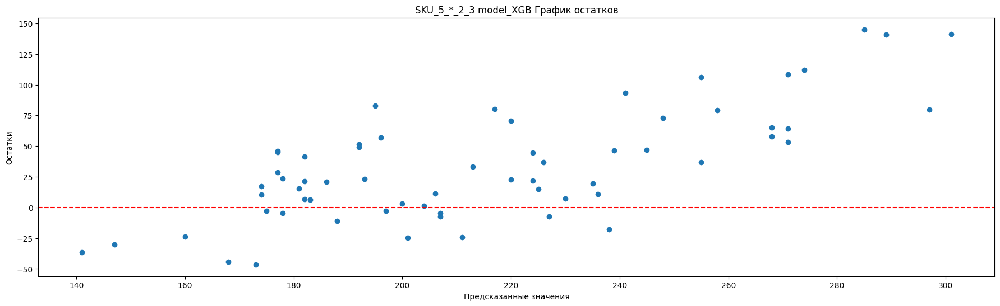

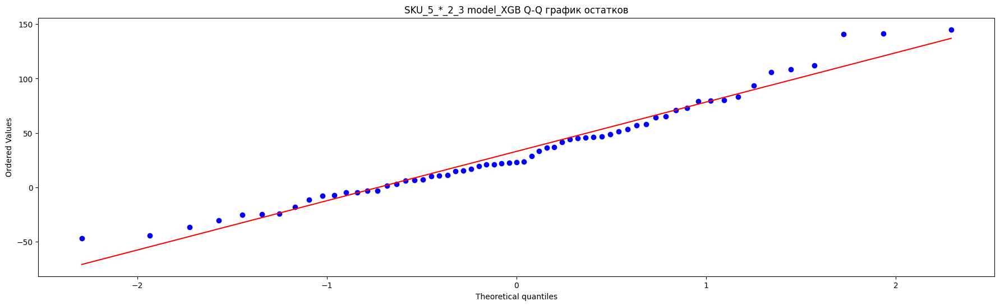

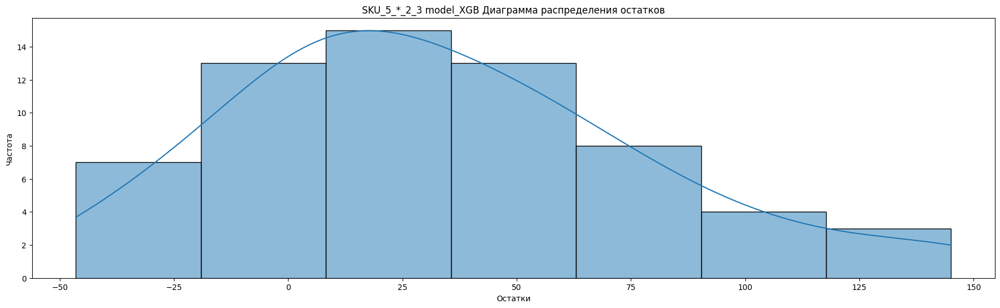

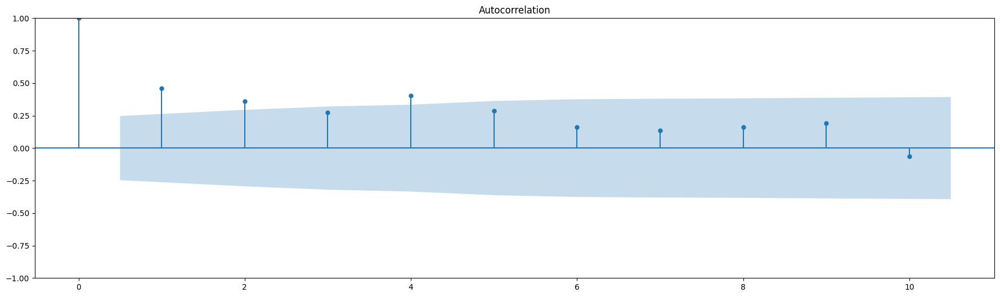

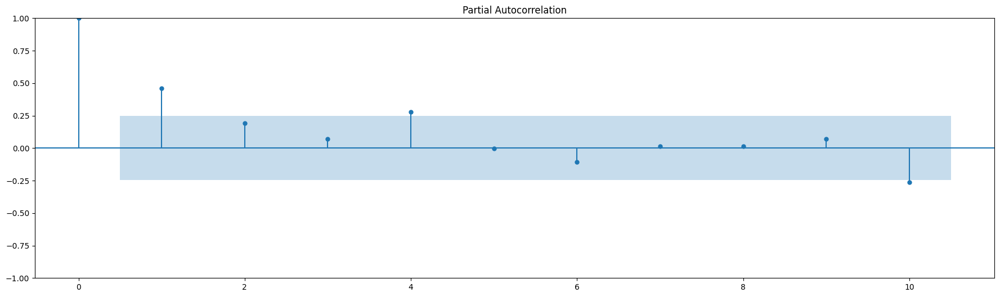


Статисткика по остаткам SKU_5_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9662870168685913
p-value Шапиро-Уилка : 0.08167204260826111

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   13.871445  1.957501e-04  13.231225  2.753239e-04  не белый шум
2   22.613183  1.229163e-05  21.435010  2.215373e-05  не белый шум
3   27.790105  4.019765e-06  26.213706  8.603586e-06  не белый шум
4   39.007751  6.940814e-08  36.395878  2.398778e-07  не белый шум
5   44.738934  1.639438e-08  41.509857  7.400968e-08  не белый шум
6   46.592413  2.256151e-08  43.135214  1.096731e-07  не белый шум
7   47.946904  3.646725e-08  44.302161  1.867660e-07  не белый шум
8   49.860539  4.346847e-08  45.921390  2.460198e-07  не белый шум
9   52.646582  3.410306e-08  48.235949  2.307392e-07  не белый шум
10  52.953072  7.596859e-08  48.485856  5.059079e-

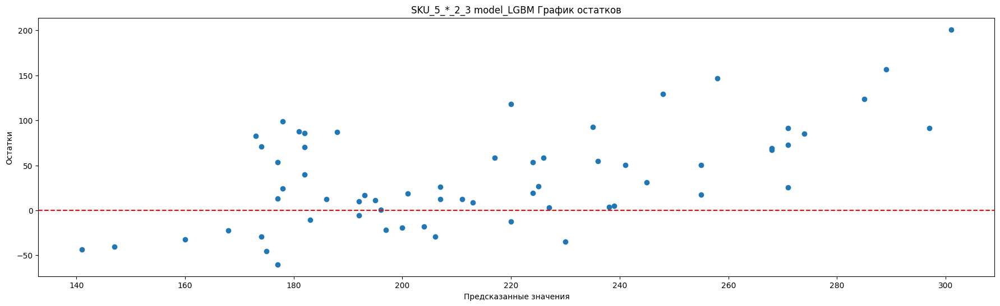

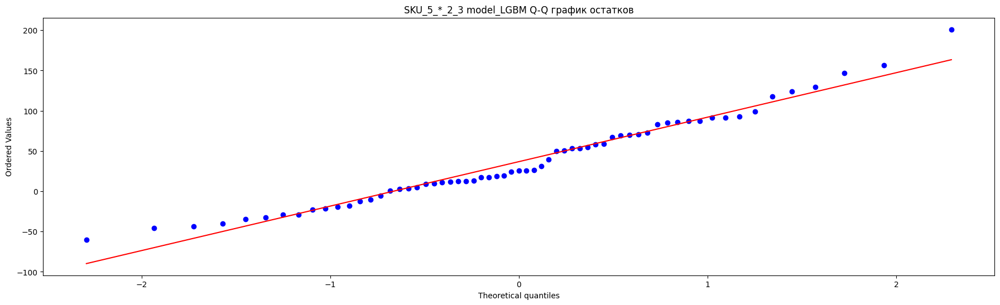

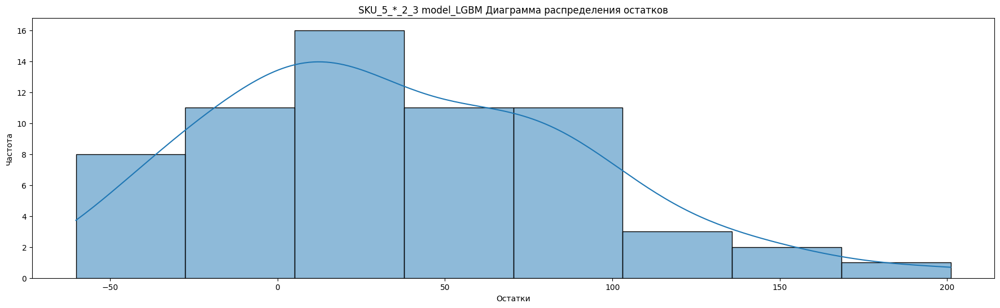

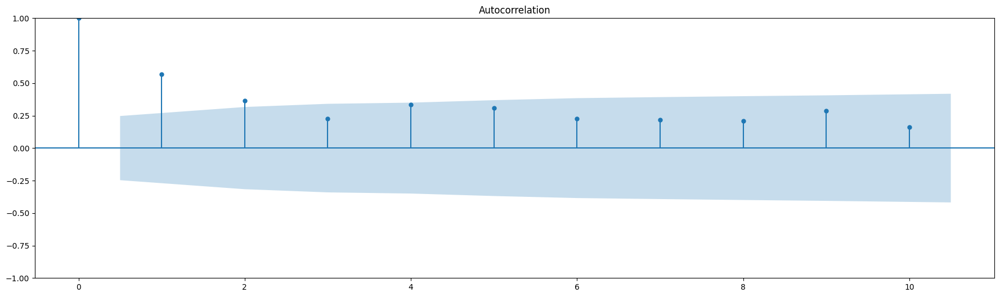

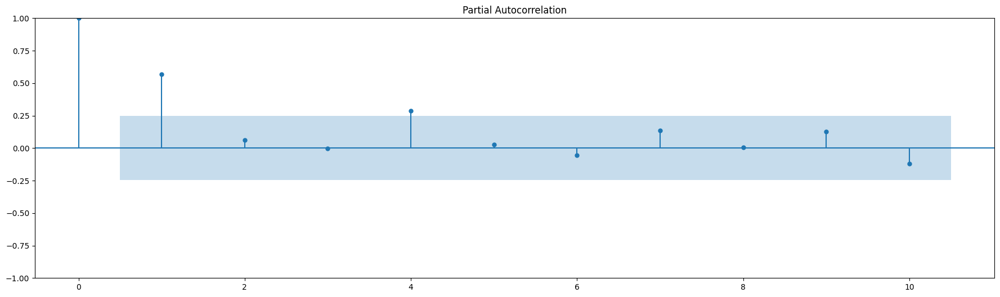


Статисткика по остаткам SKU_5_*_2_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9685745239257812
p-value Шапиро-Уилка : 0.10711175203323364

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   21.174980  4.192015e-06  20.197673  6.983783e-06  не белый шум
2   30.032965  3.009016e-07  28.510552  6.441876e-07  не белый шум
3   33.485714  2.543738e-07  31.697704  6.060237e-07  не белый шум
4   41.294432  2.335770e-08  38.785618  7.714134e-08  не белый шум
5   48.107709  3.376568e-09  44.865157  1.545402e-08  не белый шум
6   51.720253  2.122645e-09  48.033081  1.163770e-08  не белый шум
7   55.126651  1.407194e-09  50.967823  9.322462e-09  не белый шум
8   58.345344  9.831501e-10  53.691333  7.923443e-09  не белый шум
9   64.536841  1.775158e-10  58.835038  2.246674e-09  не белый шум
10  66.513932  2.078601e-10  60.447128  2.982454e

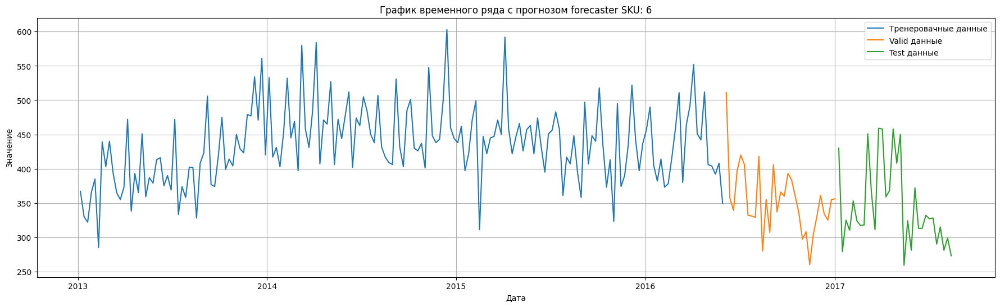

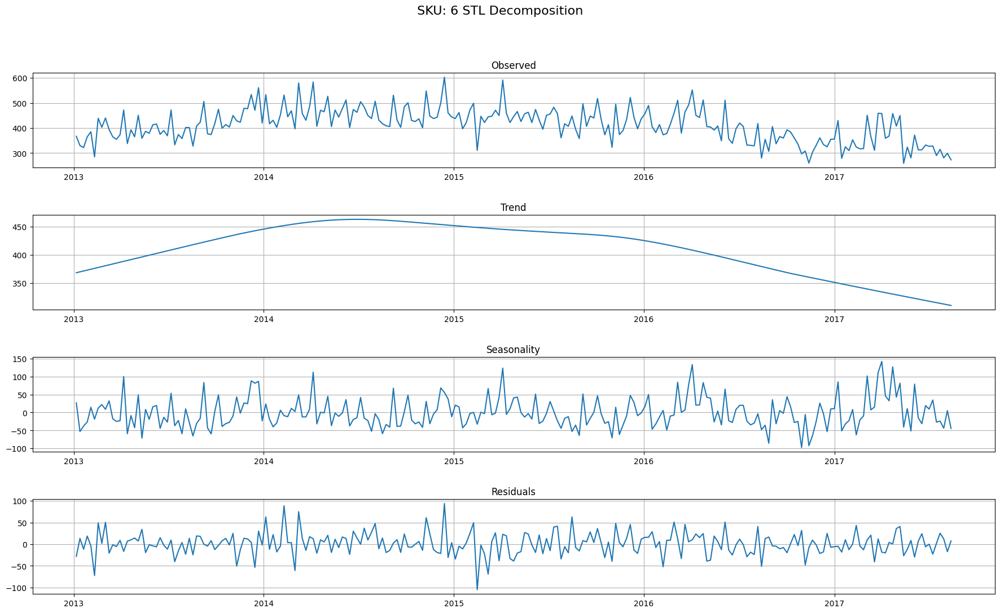

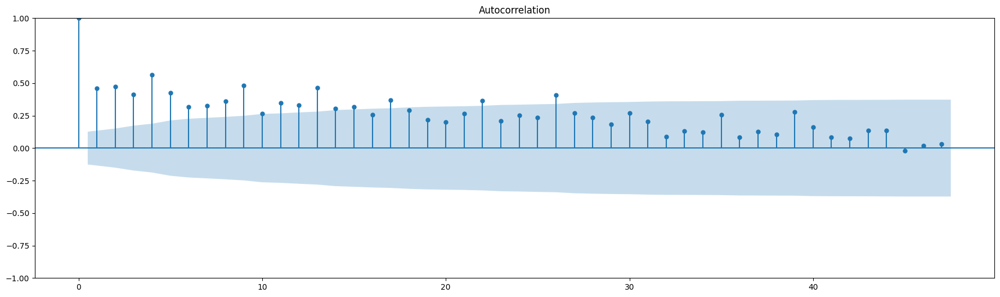

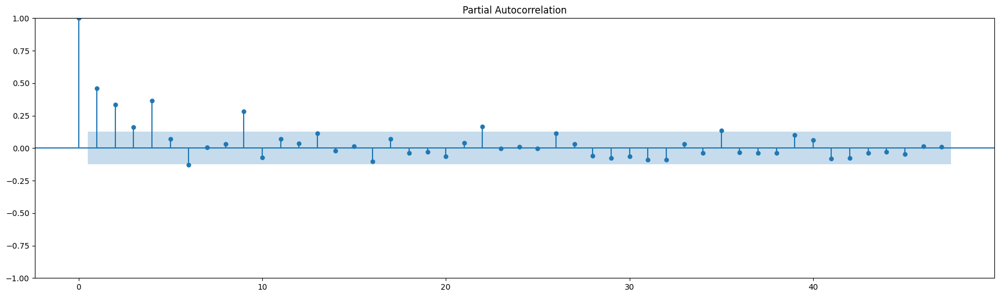

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3 27 52] 
  Parameters: {'depth': 11, 'learning_rate': 0.09942094792221498, 'iterations': 100}
  Backtesting metric: 41.52314187720671

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'max_depth': 12, 'reg_alpha': 0.7000000000000001, 'reg_lambda': 0.7000000000000001, 'n_estimators': 700}
  Backtesting metric: 36.89722647205476

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the 

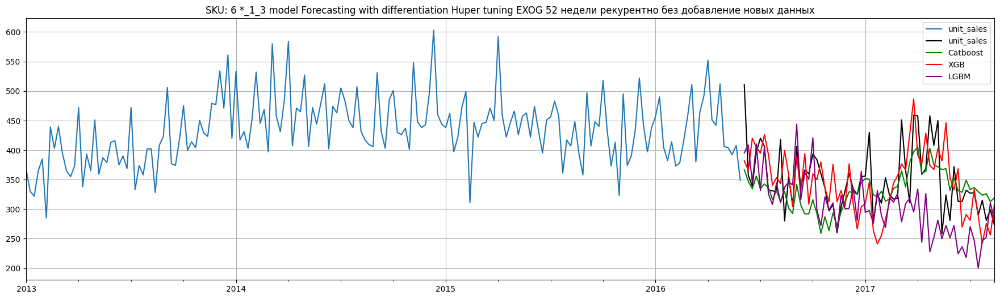

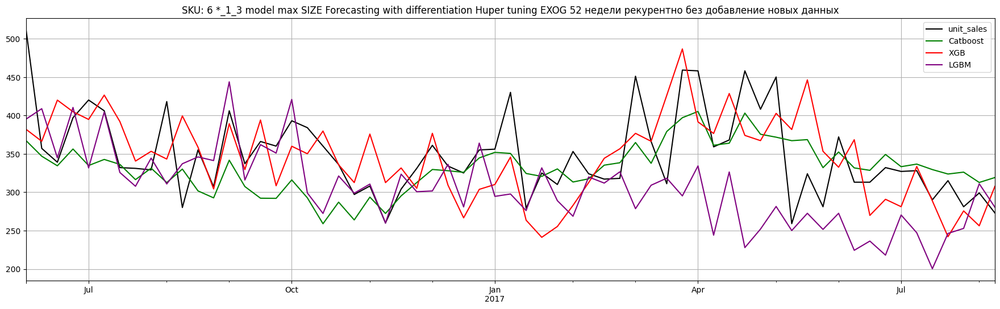

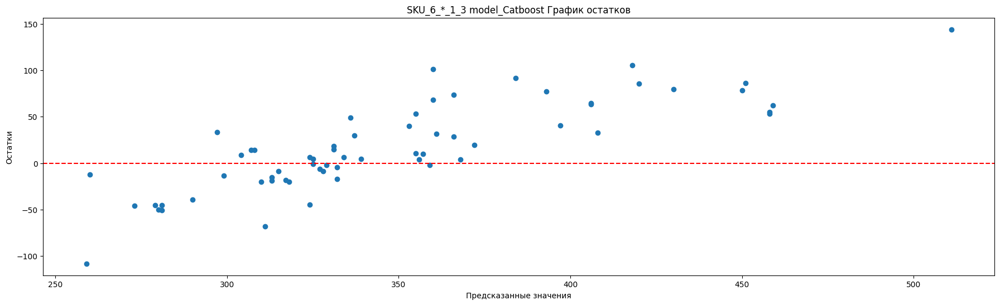

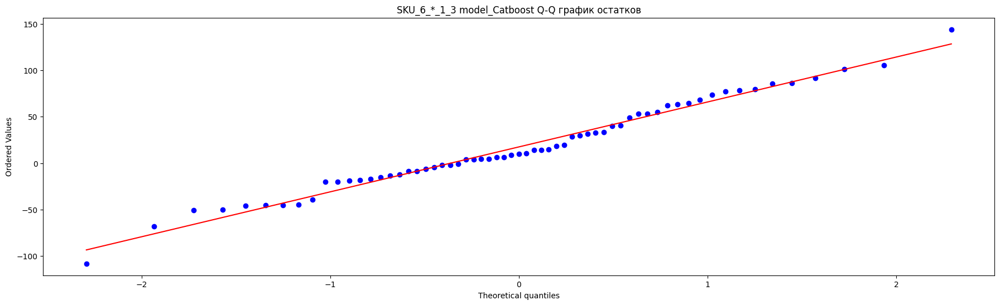

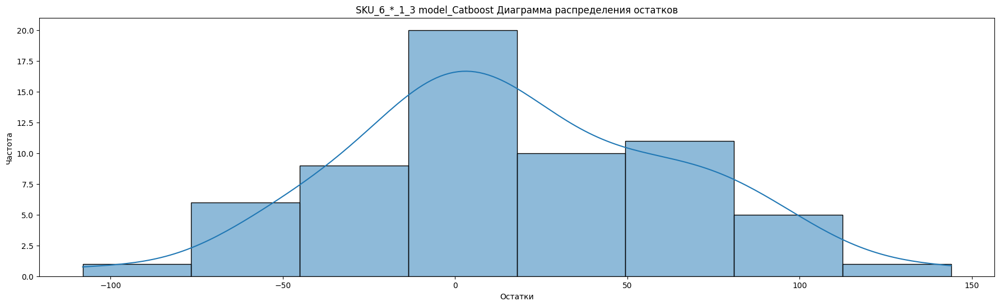

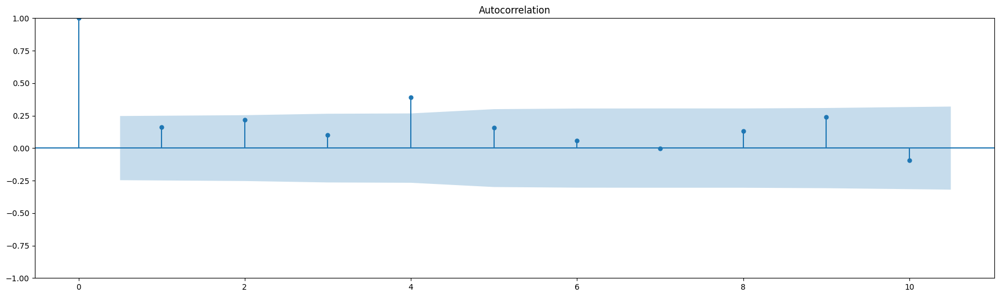

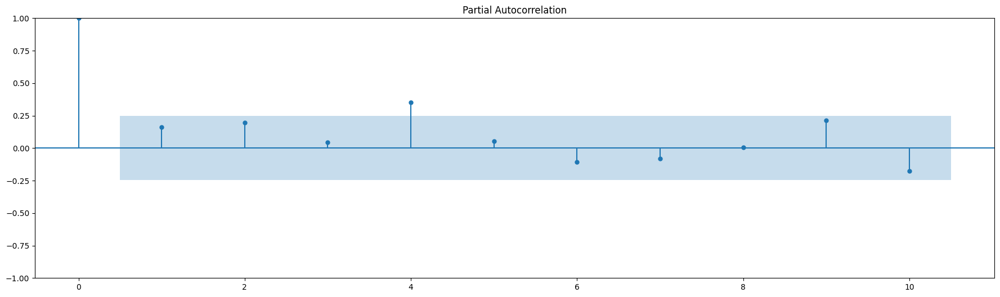


Статисткика по остаткам SKU_6_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.986528217792511
p-value Шапиро-Уилка : 0.7220147848129272

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    1.745458   0.186449   1.664898   0.196943     белый шум
2    4.896575   0.086442   4.622100   0.099157     белый шум
3    5.617585   0.131772   5.287648   0.151906     белый шум
4   16.195689   0.002768  14.889312   0.004936  не белый шум
5   17.899093   0.003076  16.409272   0.005768  не белый шум
6   18.146376   0.005877  16.626121   0.010760  не белый шум
7   18.147145   0.011323  16.626783   0.019968  не белый шум
8   19.411630   0.012807  17.696732   0.023619  не белый шум
9   23.752404   0.004710  21.302914   0.011371  не белый шум
10  24.435579   0.006524  21.859964   0.015834  не белый шум

Тест Дарбина-Уотсона: 1.3488502422722362
Отсу

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


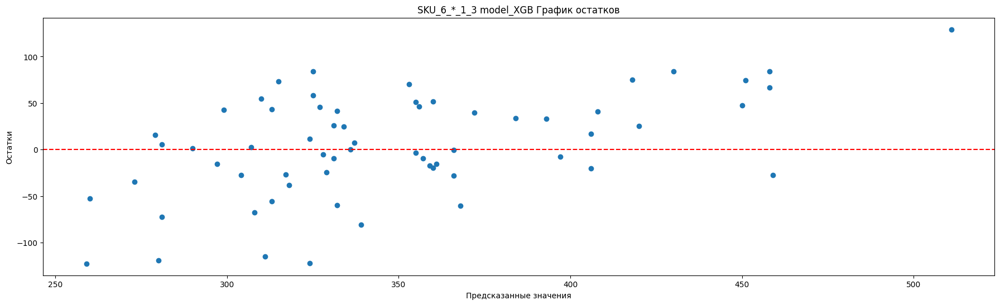

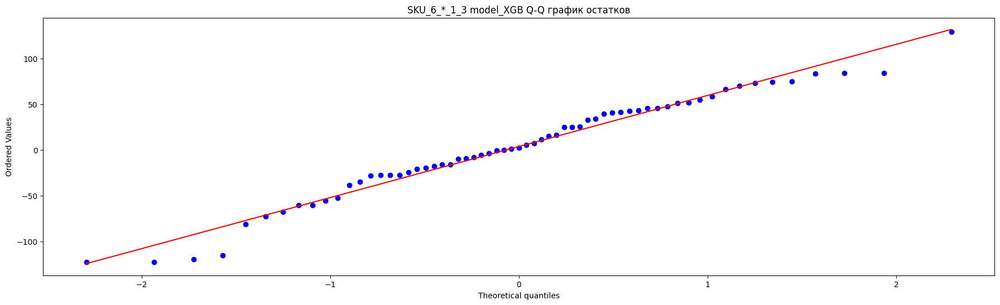

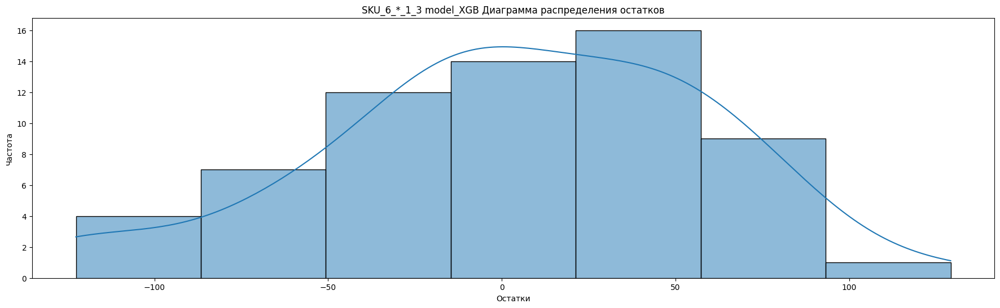

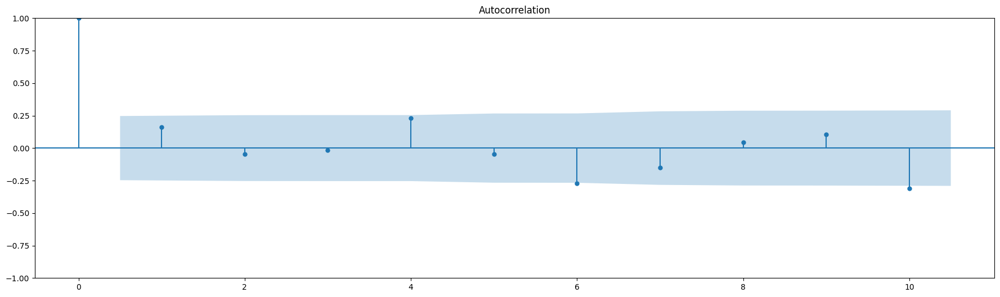

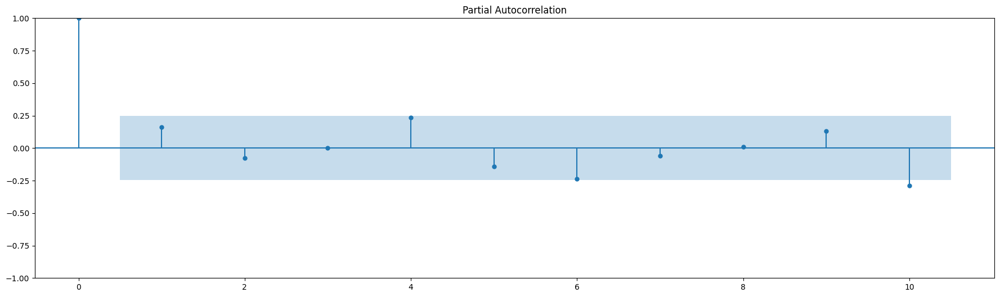


Статисткика по остаткам SKU_6_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9741502404212952
p-value Шапиро-Уилка : 0.20615121722221375

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    1.761492   0.184438   1.680193   0.194899     белый шум
2    1.907603   0.385274   1.817311   0.403066     белый шум
3    1.929788   0.587107   1.837790   0.606746     белый шум
4    5.582123   0.232605   5.152987   0.271957     белый шум
5    5.739252   0.332423   5.293194   0.381156     белый шум
6   10.989579   0.088699   9.897327   0.129043     белый шум
7   12.622475   0.081859  11.304130   0.125892     белый шум
8   12.770813   0.119982  11.429646   0.178523     белый шум
9   13.639654   0.135733  12.151453   0.204905     белый шум
10  21.056232   0.020705  18.198817   0.051701  не белый шум

Тест Дарбина-Уотсона: 1.5746795438448211
Отсутст

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


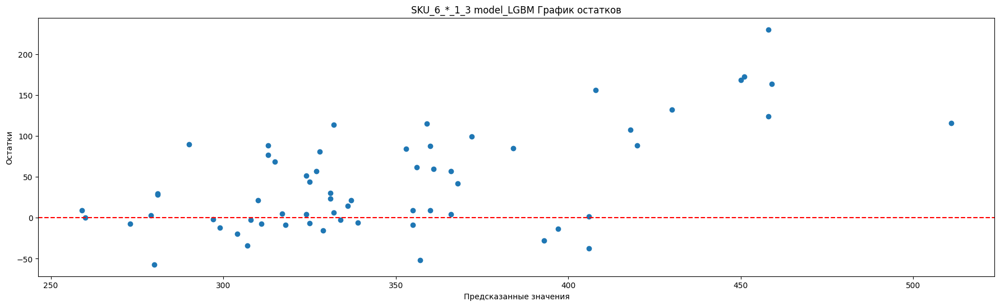

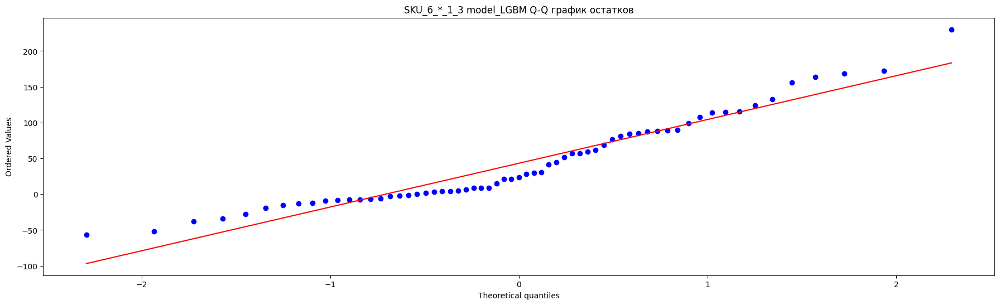

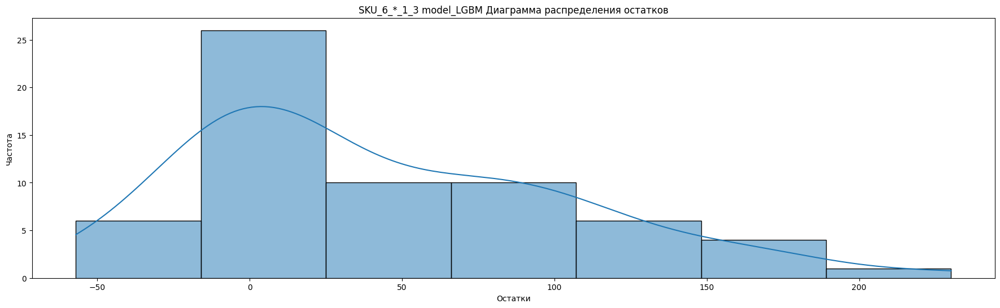

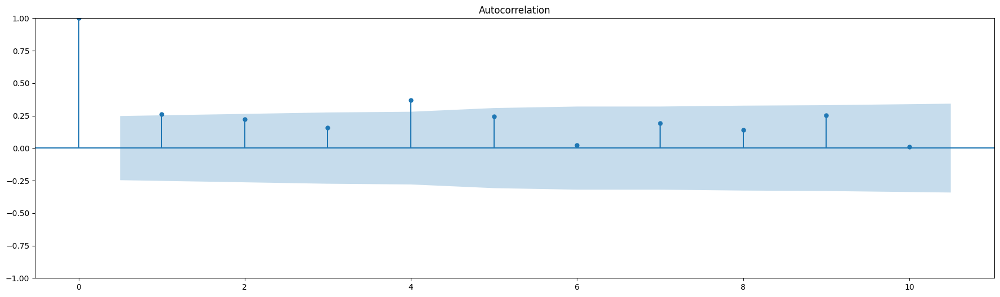

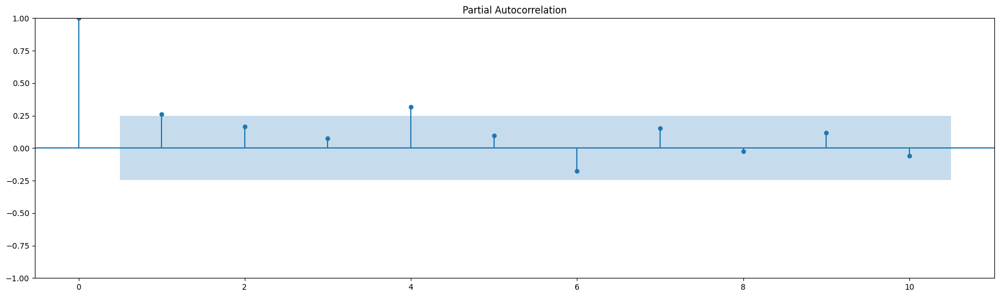


Статисткика по остаткам SKU_6_*_1_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9355223178863525
p-value Шапиро-Уилка : 0.0025906709488481283

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    4.506069   0.033775   4.298096   0.038155  не белый шум
2    7.791082   0.020332   7.380955   0.024960  не белый шум
3    9.481535   0.023529   8.941373   0.030081  не белый шум
4   18.989857   0.000790  17.572004   0.001496  не белый шум
5   23.233304   0.000305  21.358464   0.000693  не белый шум
6   23.269916   0.000711  21.390570   0.001560  не белый шум
7   25.903255   0.000524  23.659293   0.001308  не белый шум
8   27.326444   0.000621  24.863530   0.001640  не белый шум
9   32.183451   0.000185  28.898582   0.000674  не белый шум
10  32.189532   0.000372  28.903540   0.001292  не белый шум

Тест Дарбина-Уотсона: 0.9652526101833124
П

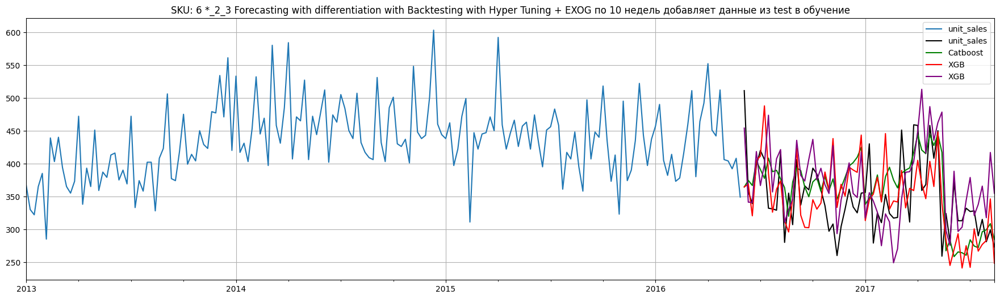

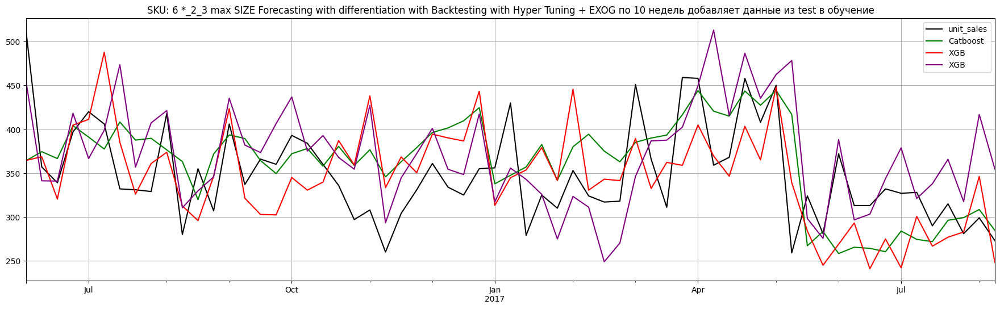

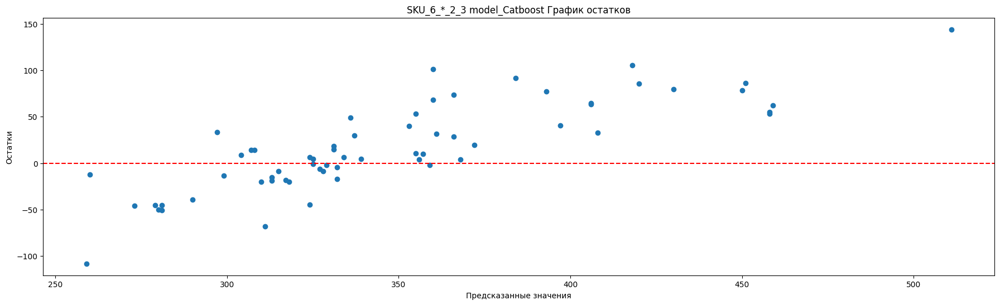

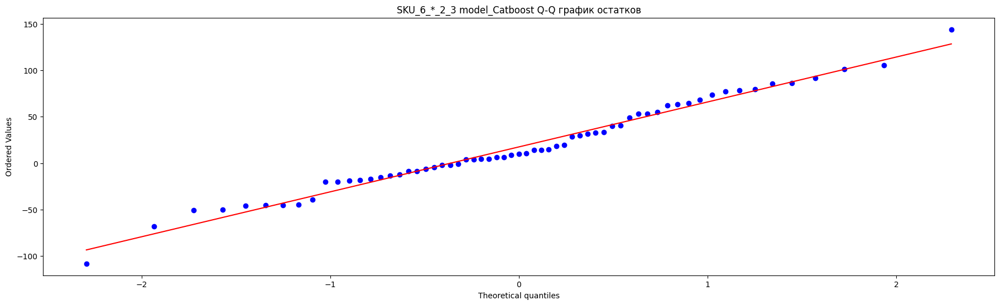

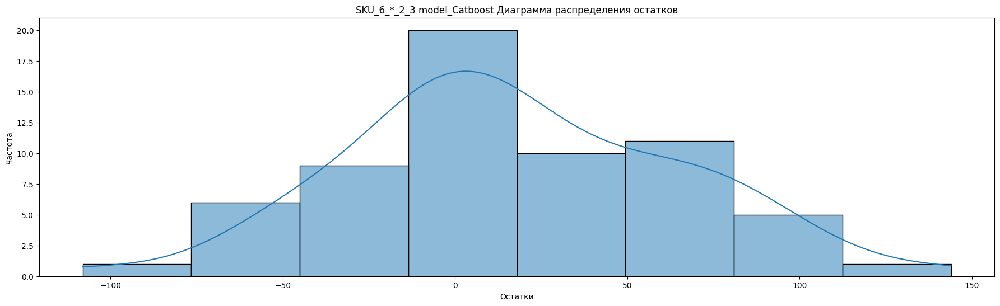

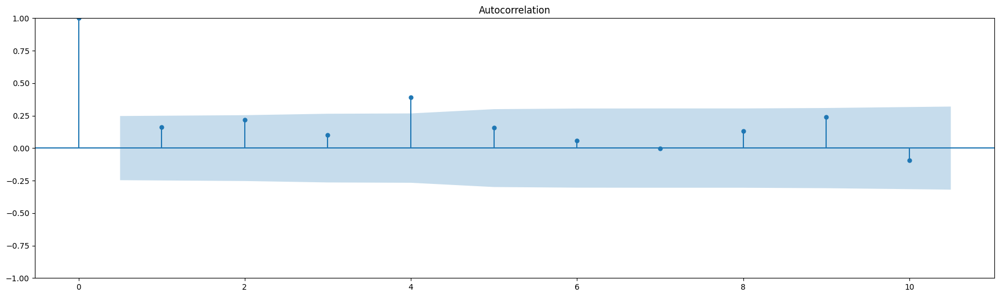

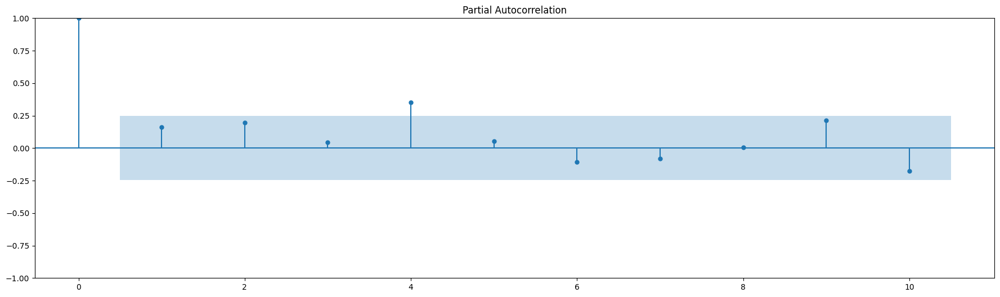


Статисткика по остаткам SKU_6_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.986528217792511
p-value Шапиро-Уилка : 0.7220147848129272

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    1.745458   0.186449   1.664898   0.196943     белый шум
2    4.896575   0.086442   4.622100   0.099157     белый шум
3    5.617585   0.131772   5.287648   0.151906     белый шум
4   16.195689   0.002768  14.889312   0.004936  не белый шум
5   17.899093   0.003076  16.409272   0.005768  не белый шум
6   18.146376   0.005877  16.626121   0.010760  не белый шум
7   18.147145   0.011323  16.626783   0.019968  не белый шум
8   19.411630   0.012807  17.696732   0.023619  не белый шум
9   23.752404   0.004710  21.302914   0.011371  не белый шум
10  24.435579   0.006524  21.859964   0.015834  не белый шум

Тест Дарбина-Уотсона: 1.3488502422722362
Отсу

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


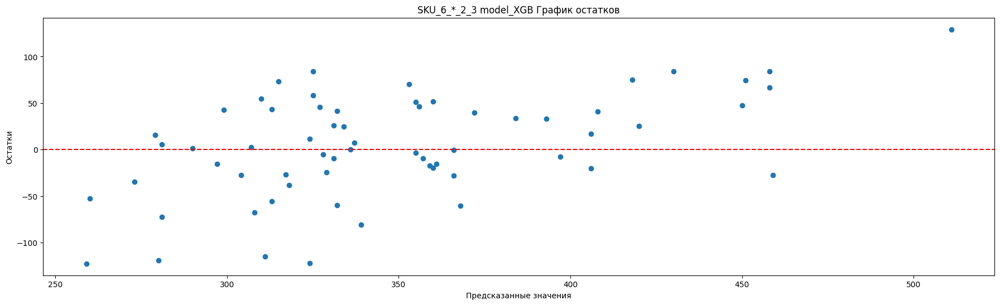

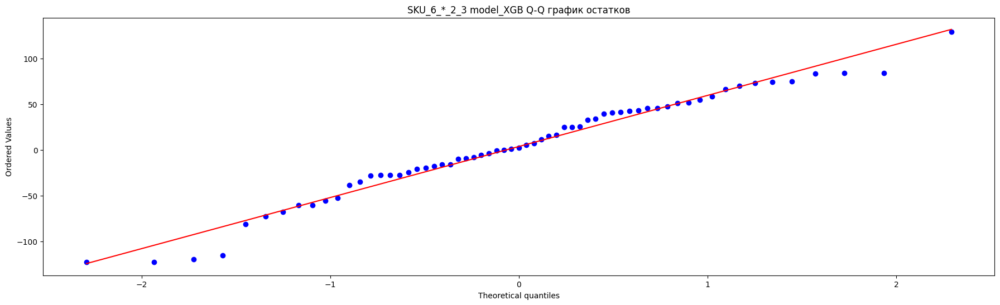

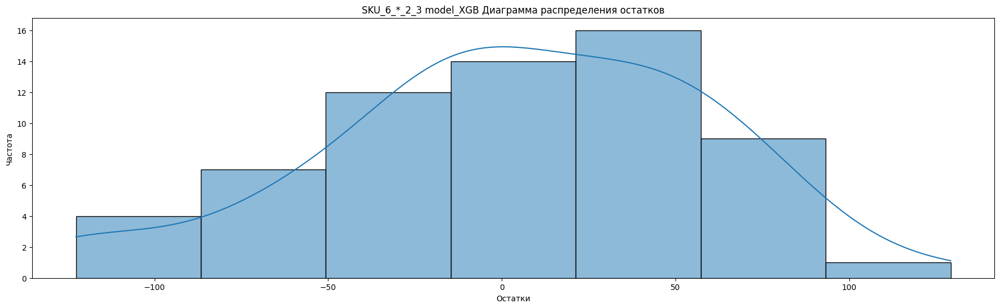

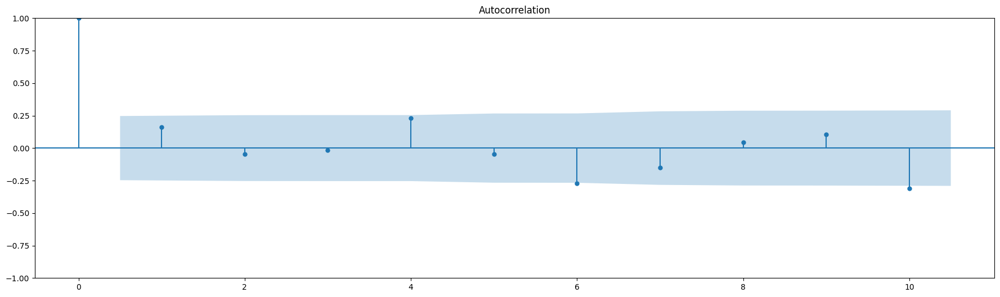

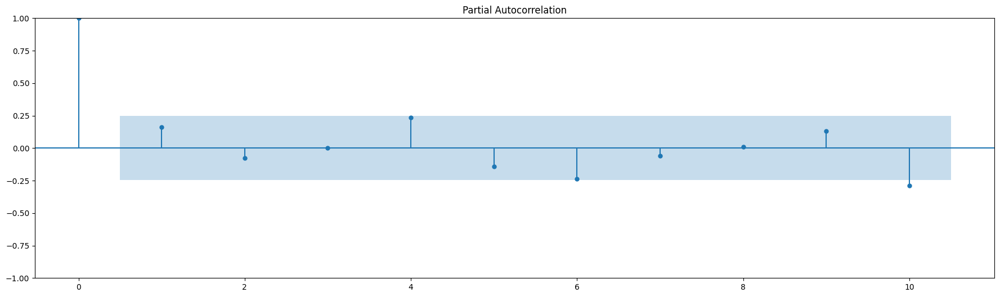


Статисткика по остаткам SKU_6_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9741502404212952
p-value Шапиро-Уилка : 0.20615121722221375

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    1.761492   0.184438   1.680193   0.194899     белый шум
2    1.907603   0.385274   1.817311   0.403066     белый шум
3    1.929788   0.587107   1.837790   0.606746     белый шум
4    5.582123   0.232605   5.152987   0.271957     белый шум
5    5.739252   0.332423   5.293194   0.381156     белый шум
6   10.989579   0.088699   9.897327   0.129043     белый шум
7   12.622475   0.081859  11.304130   0.125892     белый шум
8   12.770813   0.119982  11.429646   0.178523     белый шум
9   13.639654   0.135733  12.151453   0.204905     белый шум
10  21.056232   0.020705  18.198817   0.051701  не белый шум

Тест Дарбина-Уотсона: 1.5746795438448211
Отсутст

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


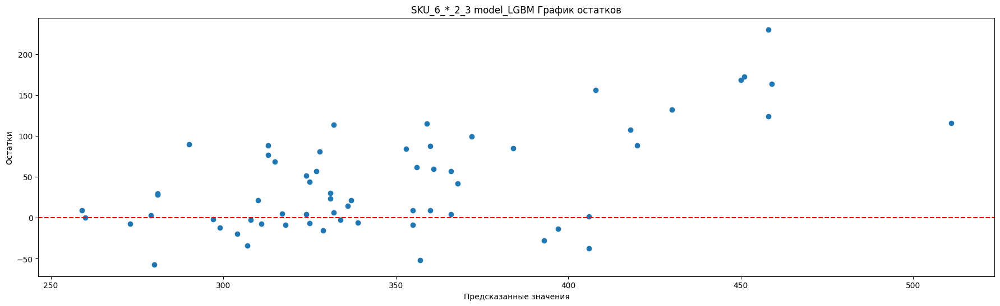

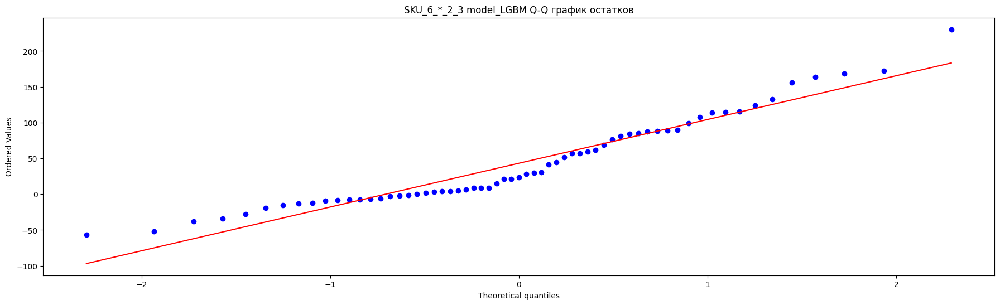

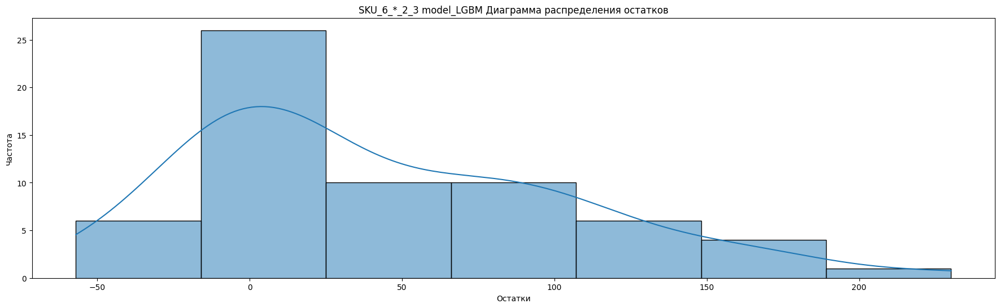

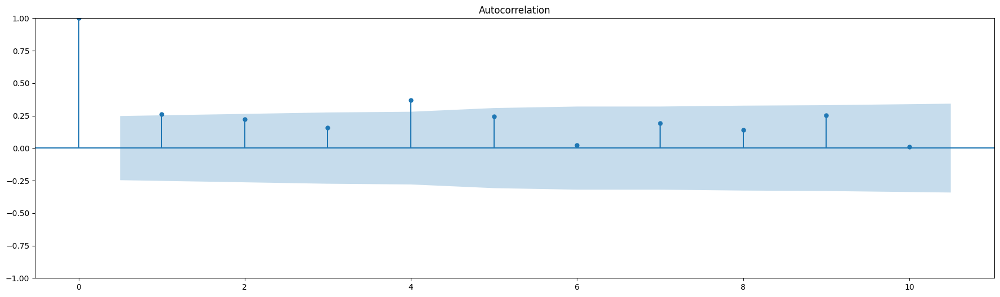

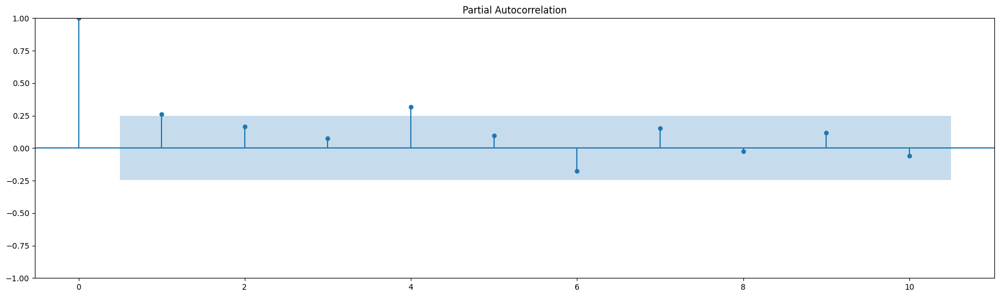


Статисткика по остаткам SKU_6_*_2_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9355223178863525
p-value Шапиро-Уилка : 0.0025906709488481283

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    4.506069   0.033775   4.298096   0.038155  не белый шум
2    7.791082   0.020332   7.380955   0.024960  не белый шум
3    9.481535   0.023529   8.941373   0.030081  не белый шум
4   18.989857   0.000790  17.572004   0.001496  не белый шум
5   23.233304   0.000305  21.358464   0.000693  не белый шум
6   23.269916   0.000711  21.390570   0.001560  не белый шум
7   25.903255   0.000524  23.659293   0.001308  не белый шум
8   27.326444   0.000621  24.863530   0.001640  не белый шум
9   32.183451   0.000185  28.898582   0.000674  не белый шум
10  32.189532   0.000372  28.903540   0.001292  не белый шум

Тест Дарбина-Уотсона: 0.9652526101833124
П

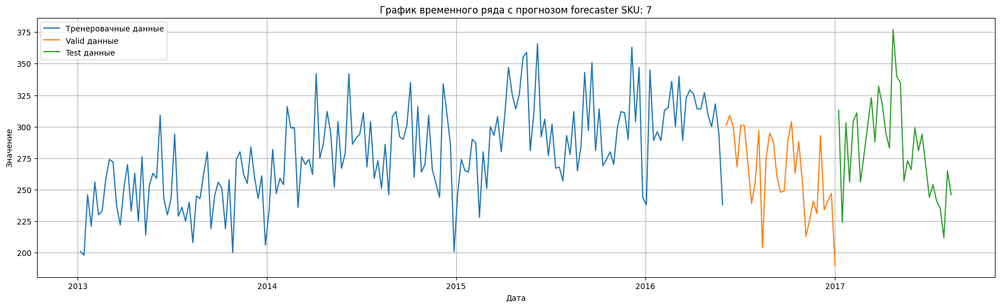

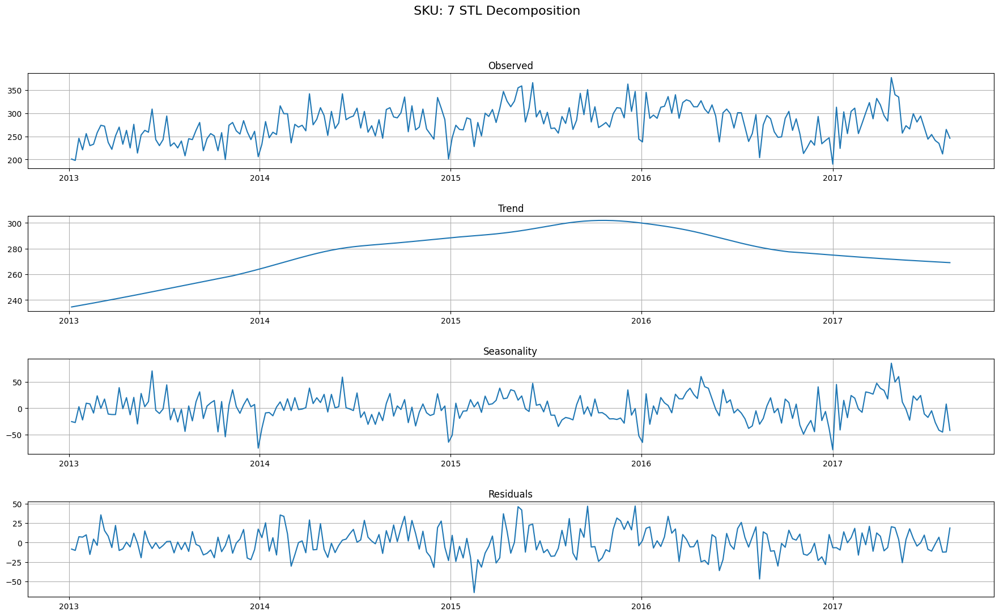

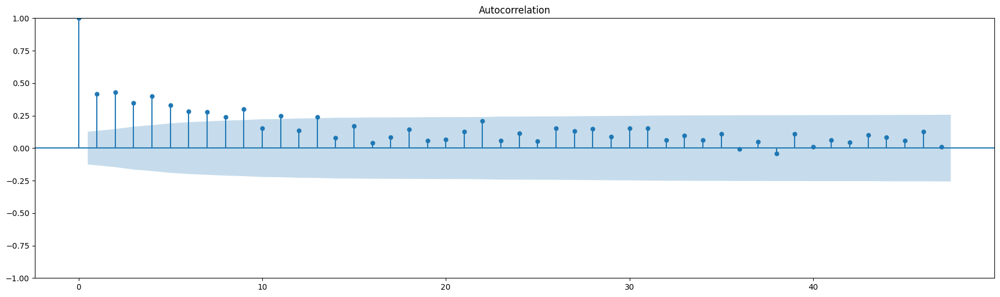

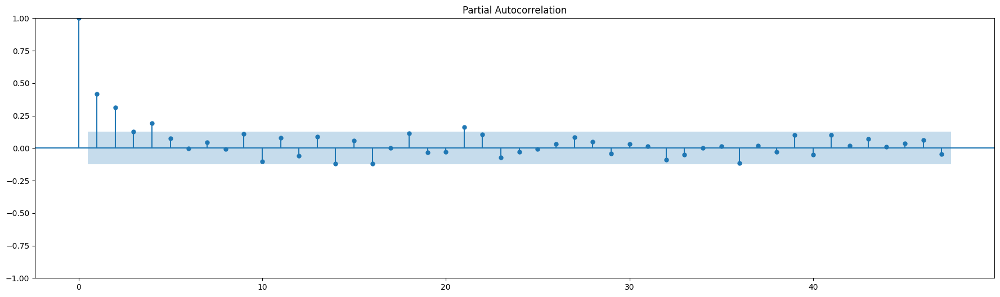

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3 27 52] 
  Parameters: {'depth': 11, 'learning_rate': 0.44203301189191113, 'iterations': 100}
  Backtesting metric: 31.69847101898612

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'max_depth': 12, 'reg_alpha': 0.8, 'reg_lambda': 0.9, 'n_estimators': 1100}
  Backtesting metric: 23.723733998114064

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and paramete

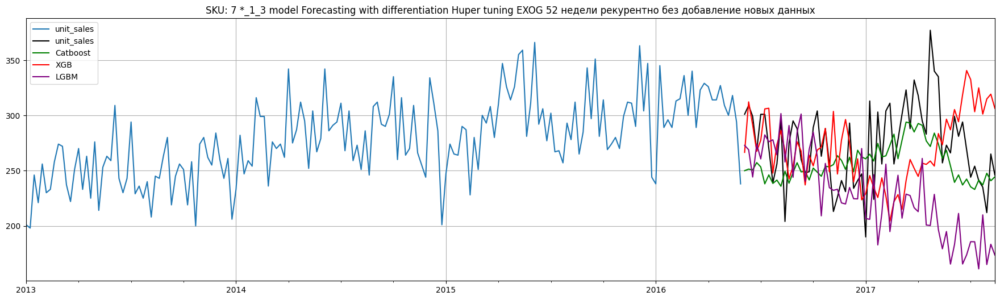

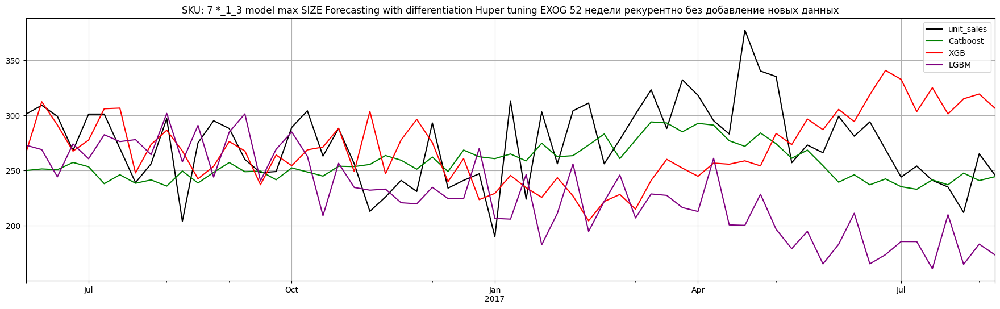

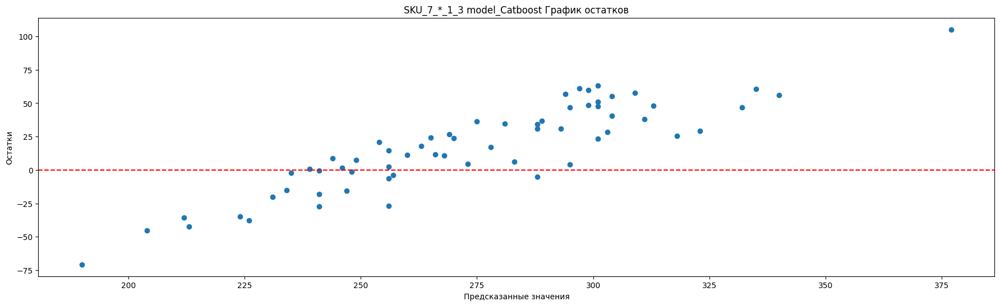

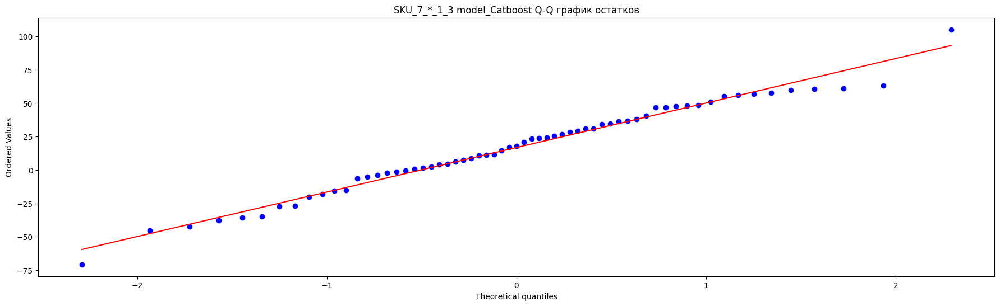

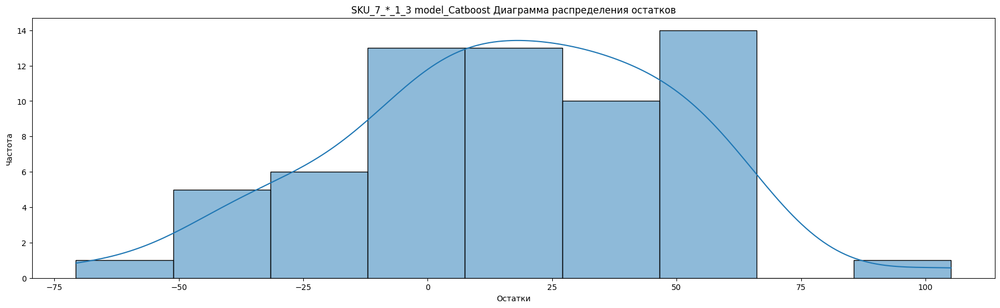

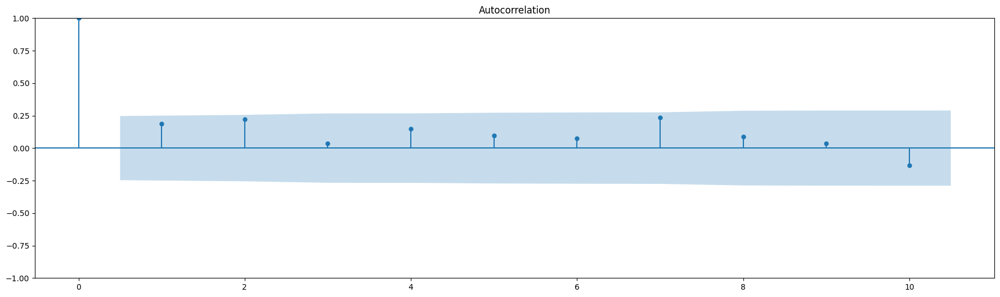

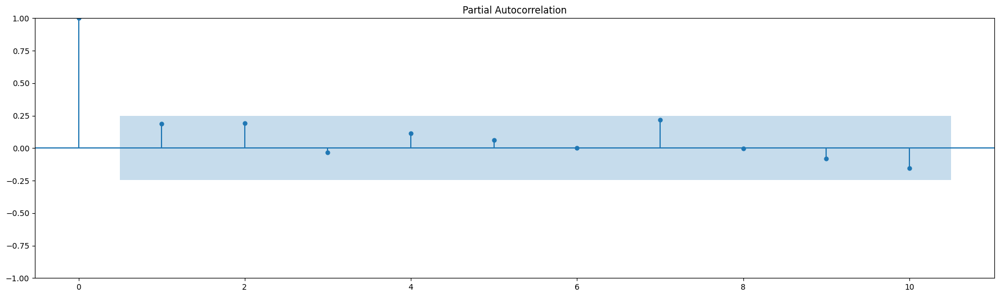


Статисткика по остаткам SKU_7_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9850596189498901
p-value Шапиро-Уилка : 0.6425139904022217

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue     result
1    2.348354   0.125415   2.239968   0.134484  белый шум
2    5.628563   0.059948   5.318319   0.070007  белый шум
3    5.722457   0.125922   5.404990   0.144433  белый шум
4    7.214418   0.124982   6.759231   0.149172  белый шум
5    7.882874   0.162810   7.355700   0.195502  белый шум
6    8.266727   0.219206   7.692309   0.261523  белый шум
7   12.331524   0.090170  11.194288   0.130366  белый шум
8   12.904838   0.115166  11.679400   0.166092  белый шум
9   13.002681   0.162485  11.760685   0.227139  белый шум
10  14.368972   0.156817  12.874738   0.230760  белый шум

Тест Дарбина-Уотсона: 1.2652676553836115
Отсутствие автокорреляции первого по

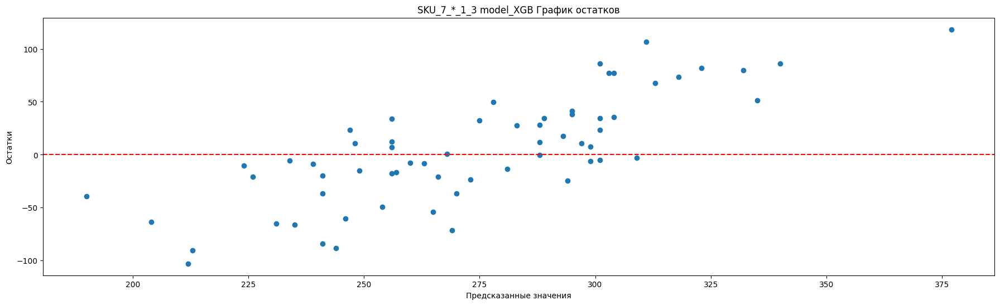

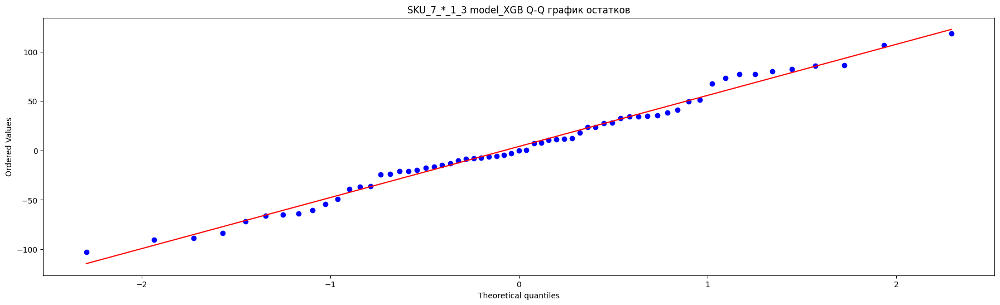

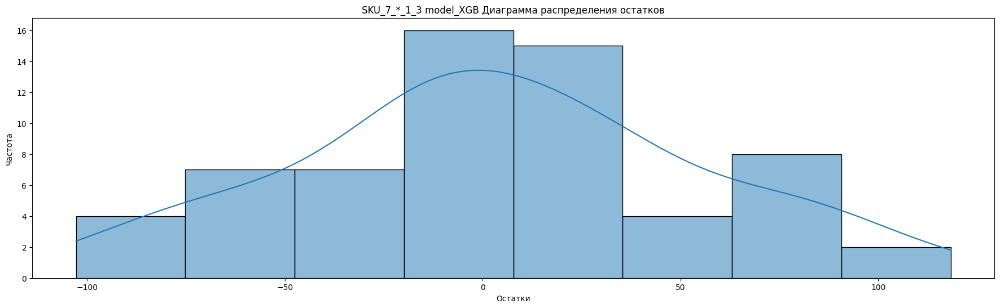

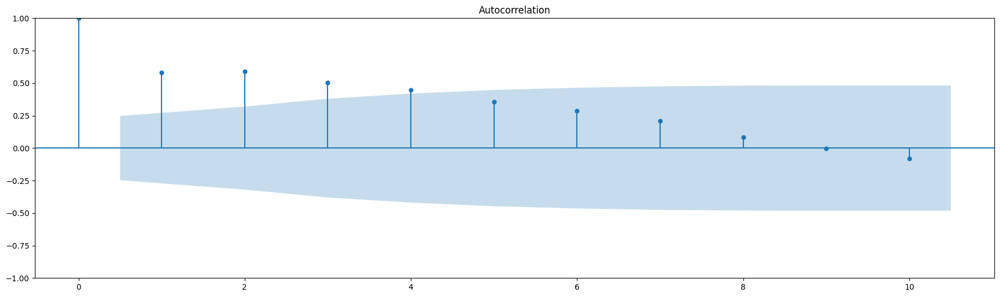

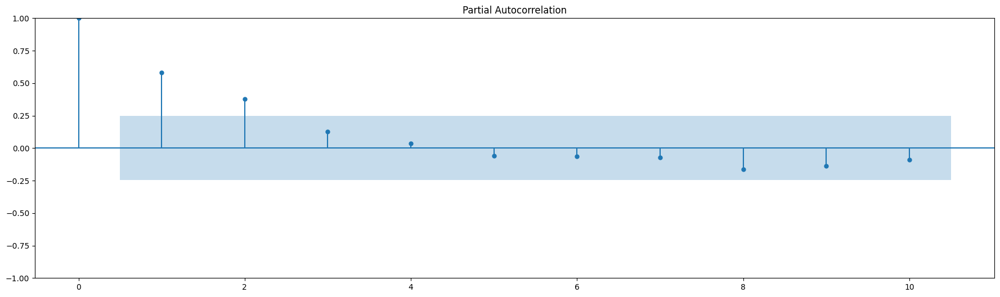


Статисткика по остаткам SKU_7_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9851716160774231
p-value Шапиро-Уилка : 0.6485661864280701

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   22.338900  2.285301e-06  21.307874  3.911217e-06  не белый шум
2   45.637597  1.230047e-10  43.172805  4.218368e-10  не белый шум
3   63.041552  1.315790e-13  59.237994  8.551205e-13  не белый шум
4   77.044874  7.358036e-16  71.948702  8.799105e-15  не белый шум
5   86.027893  4.582612e-17  79.964319  8.537309e-16  не белый шум
6   92.007160  1.159651e-17  85.207676  2.989758e-16  не белый шум
7   95.172531  1.068076e-17  87.934765  3.283082e-16  не белый шум
8   95.706531  3.211244e-17  88.386611  9.881188e-16  не белый шум
9   95.707482  1.157962e-16  88.387401  3.427664e-15  не белый шум
10  96.204175  3.124833e-16  88.792397  9.292728e-1

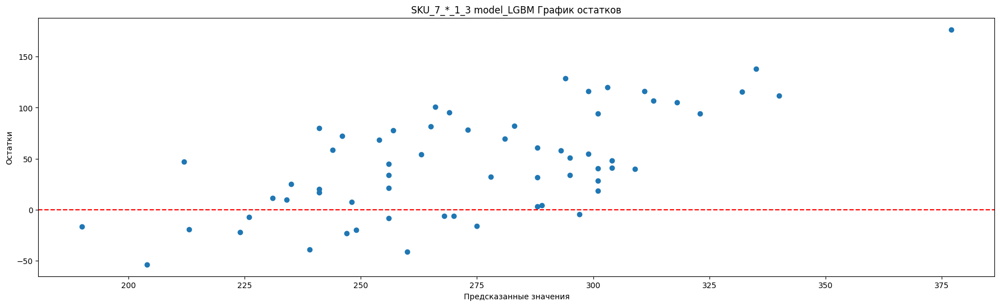

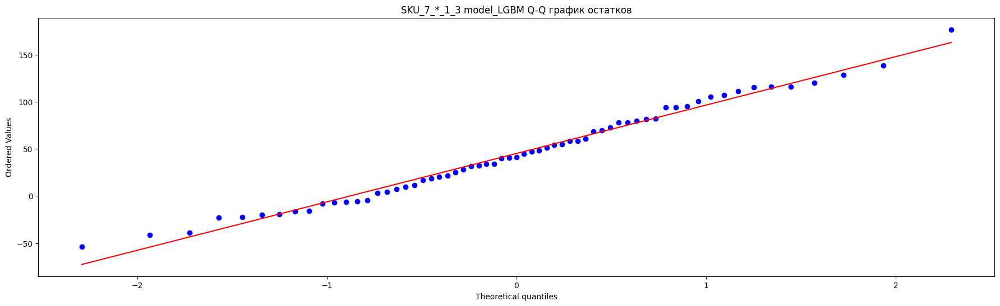

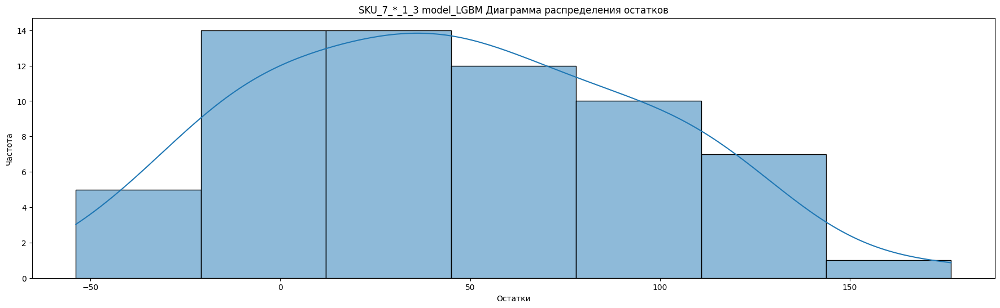

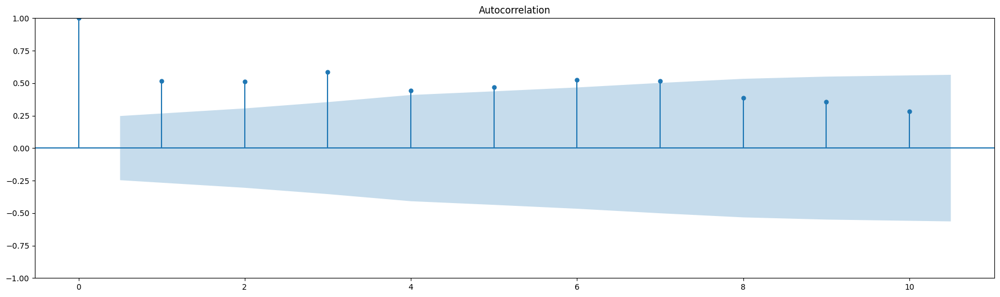

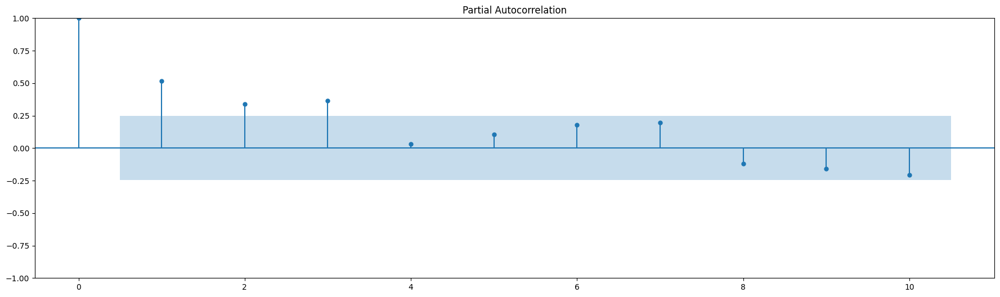


Статисткика по остаткам SKU_7_*_1_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9843685030937195
p-value Шапиро-Уилка : 0.6054332256317139

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
       lb_stat     lb_pvalue     bp_stat     bp_pvalue        result
1    17.501242  2.871200e-05   16.693493  4.393143e-05  не белый шум
2    35.133454  2.348915e-08   33.240645  6.051814e-08  не белый шум
3    58.521953  1.216070e-12   54.830029  7.464049e-12  не белый шум
4    72.053068  8.363502e-15   67.112118  9.232365e-14  не белый шум
5    87.642494  2.100605e-17   81.022683  5.126910e-16  не белый шум
6   107.539283  6.673227e-21   98.470636  5.230382e-19  не белый шум
7   127.141662  2.484562e-24  115.358840  7.079822e-22  не белый шум
8   138.359100  5.205358e-26  124.850518  3.296227e-23  не белый шум
9   148.041716  2.243803e-27  132.894537  3.009350e-24  не белый шум
10  154.231020  5.015700e-28  

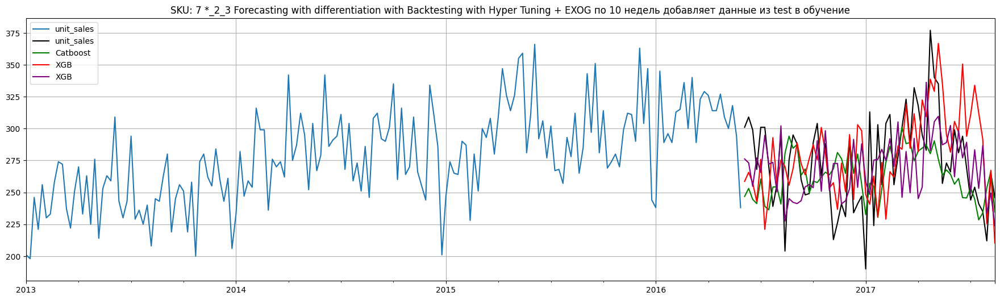

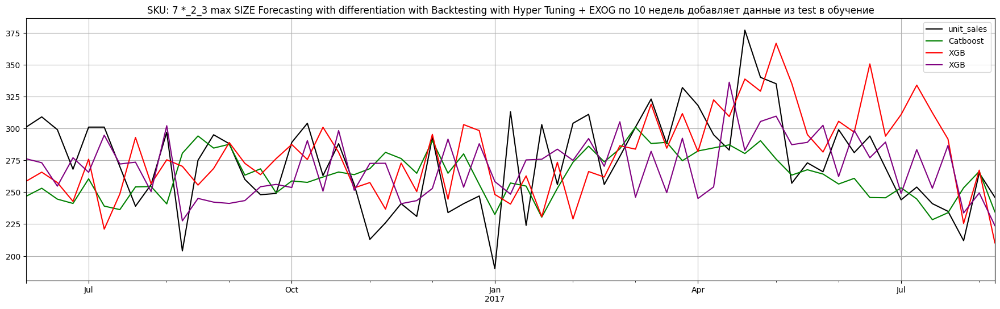

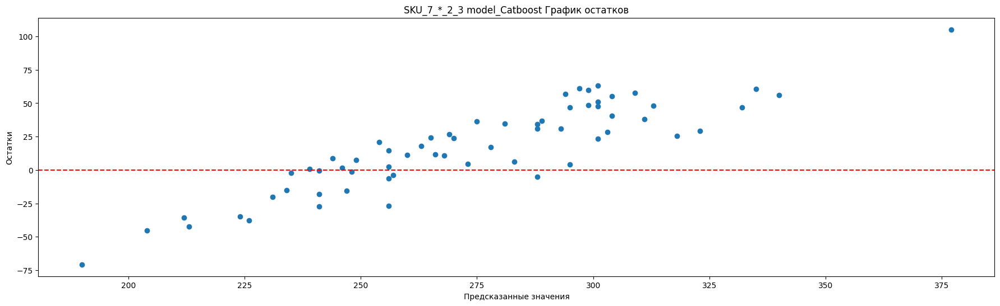

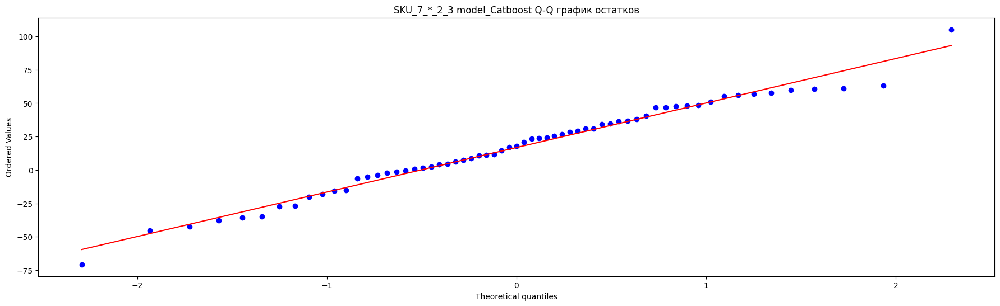

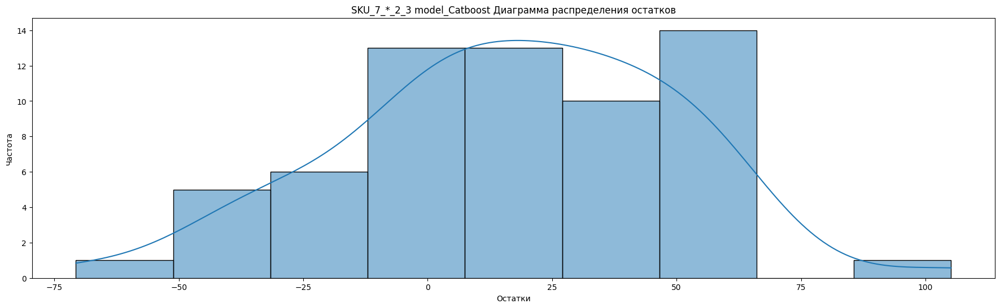

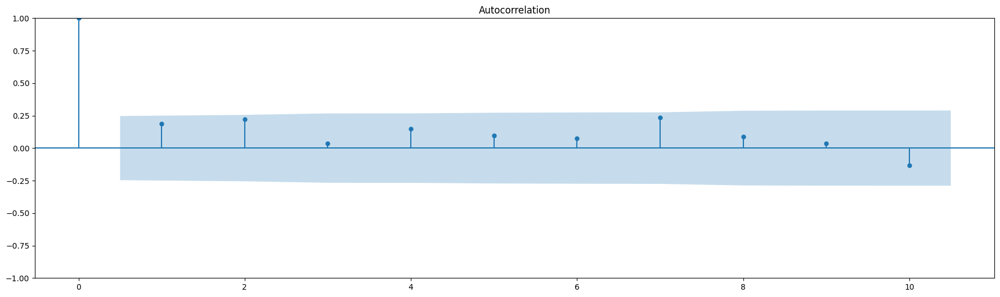

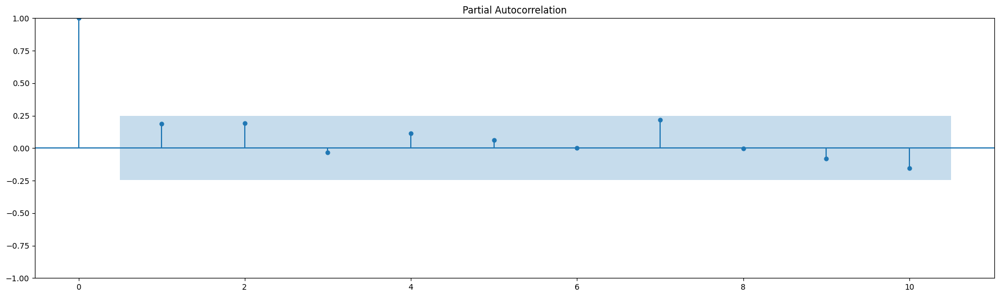


Статисткика по остаткам SKU_7_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9850596189498901
p-value Шапиро-Уилка : 0.6425139904022217

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue     result
1    2.348354   0.125415   2.239968   0.134484  белый шум
2    5.628563   0.059948   5.318319   0.070007  белый шум
3    5.722457   0.125922   5.404990   0.144433  белый шум
4    7.214418   0.124982   6.759231   0.149172  белый шум
5    7.882874   0.162810   7.355700   0.195502  белый шум
6    8.266727   0.219206   7.692309   0.261523  белый шум
7   12.331524   0.090170  11.194288   0.130366  белый шум
8   12.904838   0.115166  11.679400   0.166092  белый шум
9   13.002681   0.162485  11.760685   0.227139  белый шум
10  14.368972   0.156817  12.874738   0.230760  белый шум

Тест Дарбина-Уотсона: 1.2652676553836115
Отсутствие автокорреляции первого по

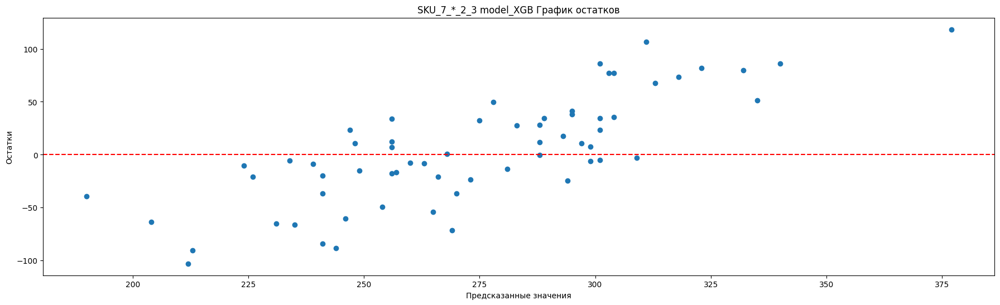

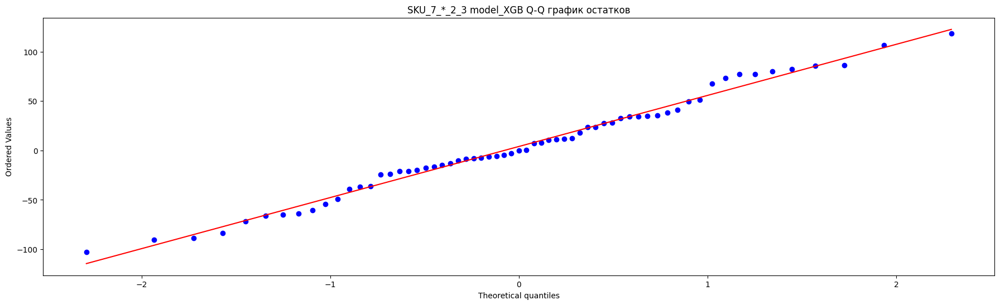

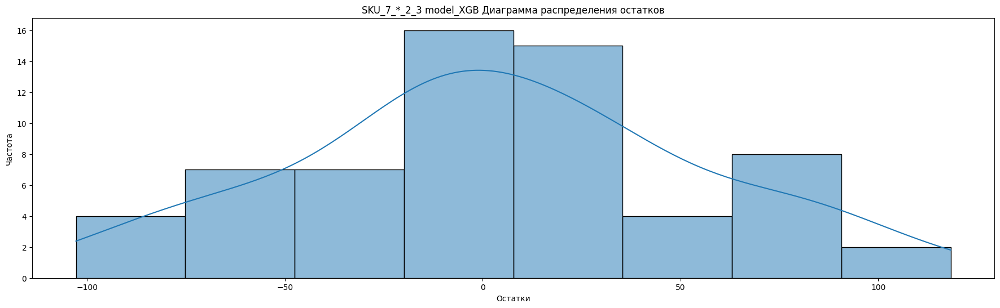

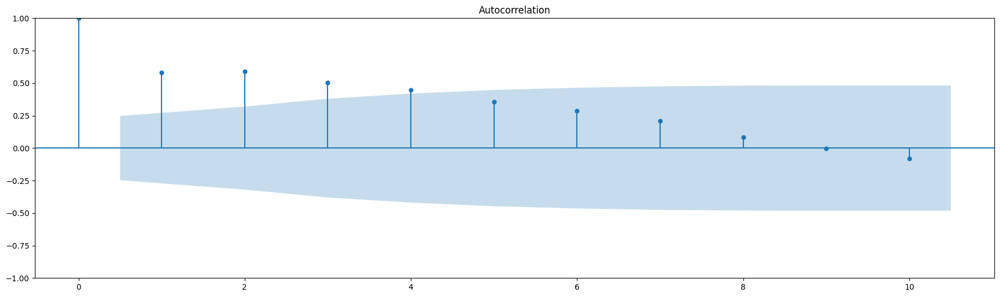

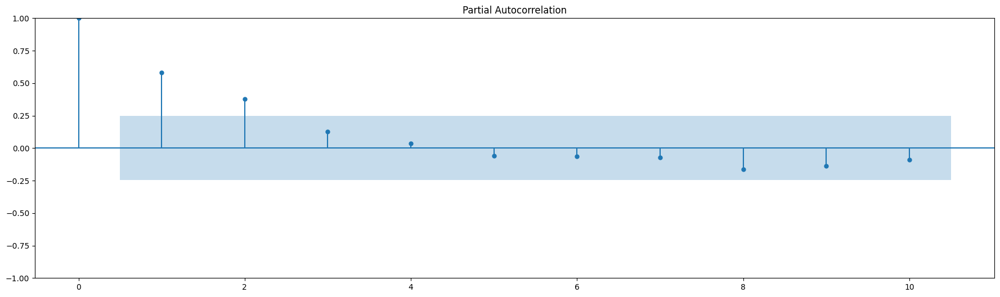


Статисткика по остаткам SKU_7_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9851716160774231
p-value Шапиро-Уилка : 0.6485661864280701

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   22.338900  2.285301e-06  21.307874  3.911217e-06  не белый шум
2   45.637597  1.230047e-10  43.172805  4.218368e-10  не белый шум
3   63.041552  1.315790e-13  59.237994  8.551205e-13  не белый шум
4   77.044874  7.358036e-16  71.948702  8.799105e-15  не белый шум
5   86.027893  4.582612e-17  79.964319  8.537309e-16  не белый шум
6   92.007160  1.159651e-17  85.207676  2.989758e-16  не белый шум
7   95.172531  1.068076e-17  87.934765  3.283082e-16  не белый шум
8   95.706531  3.211244e-17  88.386611  9.881188e-16  не белый шум
9   95.707482  1.157962e-16  88.387401  3.427664e-15  не белый шум
10  96.204175  3.124833e-16  88.792397  9.292728e-1

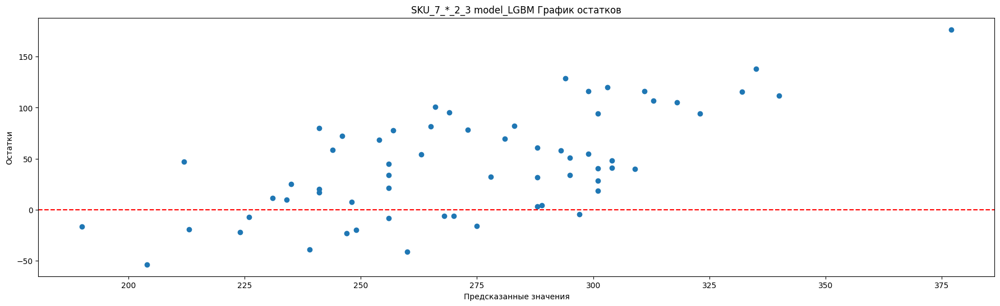

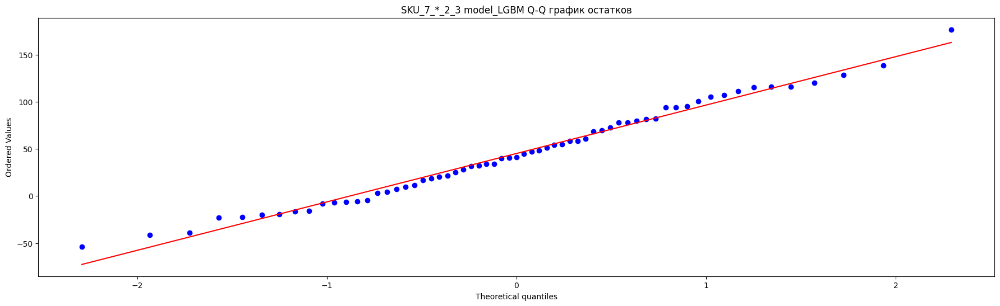

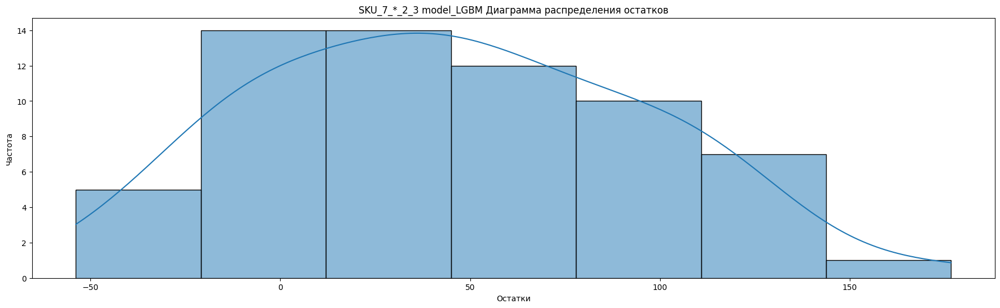

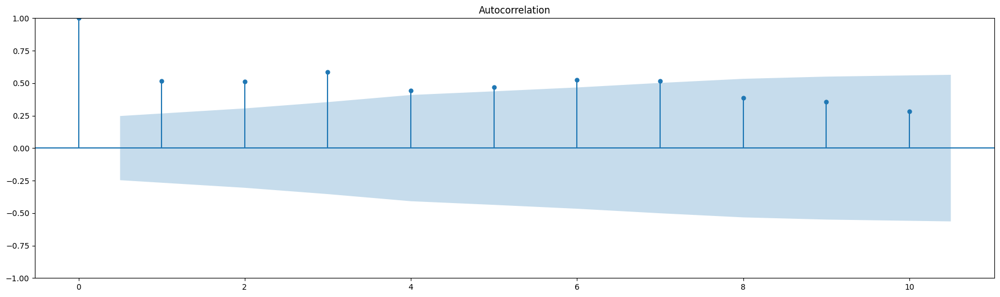

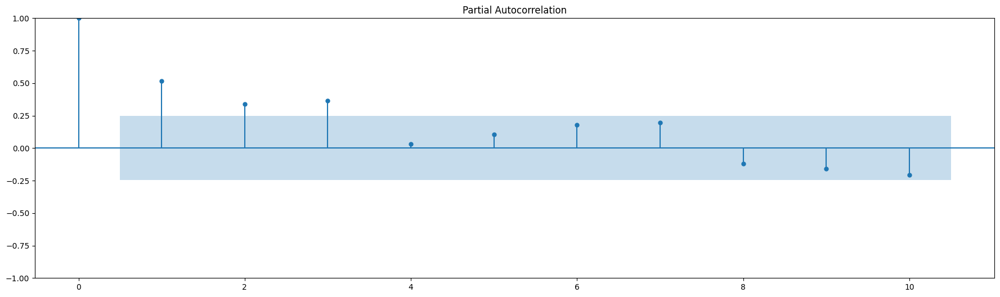


Статисткика по остаткам SKU_7_*_2_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9843685030937195
p-value Шапиро-Уилка : 0.6054332256317139

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
       lb_stat     lb_pvalue     bp_stat     bp_pvalue        result
1    17.501242  2.871200e-05   16.693493  4.393143e-05  не белый шум
2    35.133454  2.348915e-08   33.240645  6.051814e-08  не белый шум
3    58.521953  1.216070e-12   54.830029  7.464049e-12  не белый шум
4    72.053068  8.363502e-15   67.112118  9.232365e-14  не белый шум
5    87.642494  2.100605e-17   81.022683  5.126910e-16  не белый шум
6   107.539283  6.673227e-21   98.470636  5.230382e-19  не белый шум
7   127.141662  2.484562e-24  115.358840  7.079822e-22  не белый шум
8   138.359100  5.205358e-26  124.850518  3.296227e-23  не белый шум
9   148.041716  2.243803e-27  132.894537  3.009350e-24  не белый шум
10  154.231020  5.015700e-28  

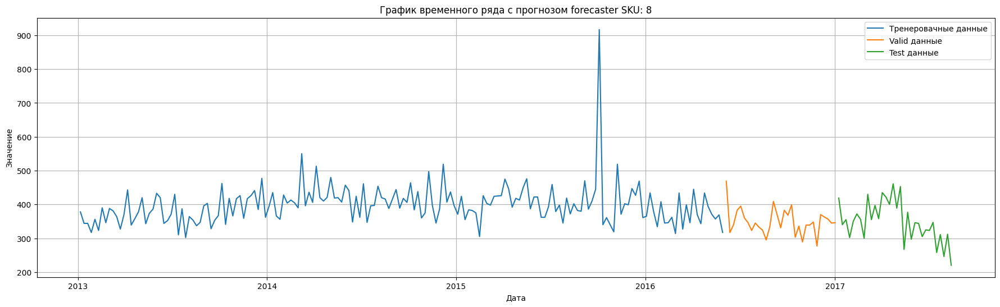

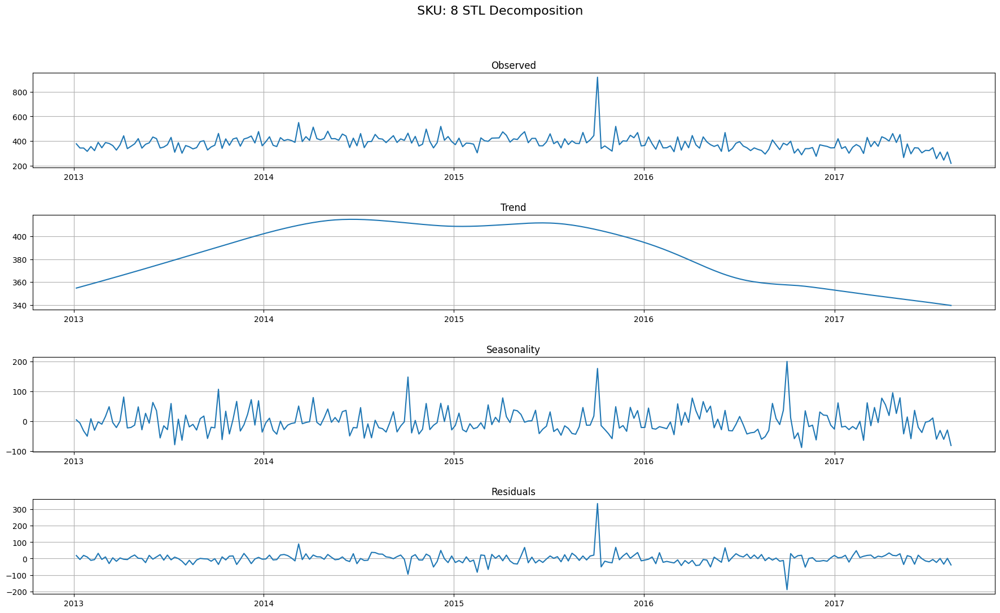

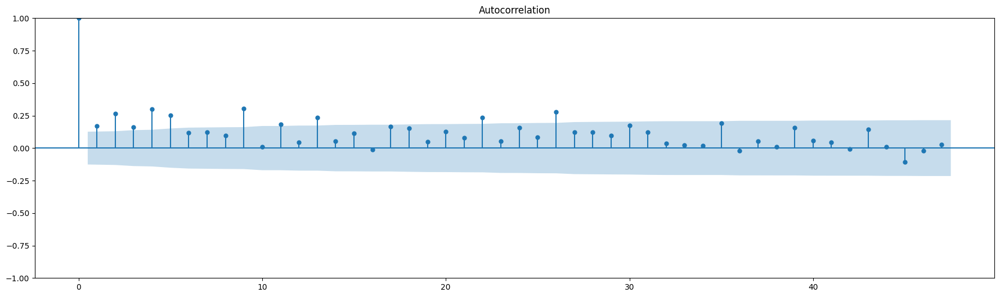

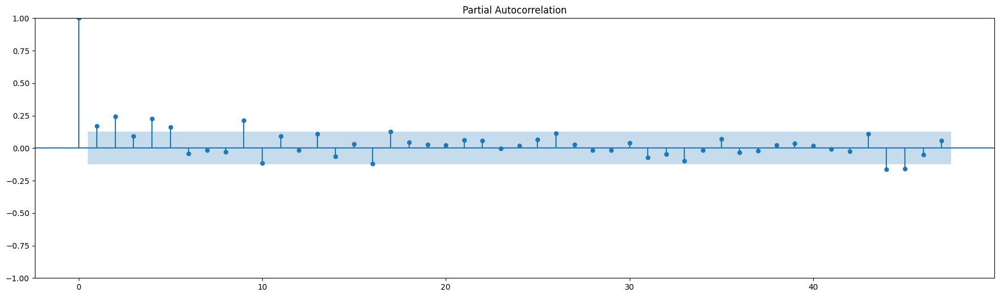

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'depth': 10, 'learning_rate': 0.42166632091687567, 'iterations': 100}
  Backtesting metric: 41.36465507271776

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'max_depth': 10, 'reg_alpha': 0.6000000000000001, 'reg_lambda': 0.1, 'n_estimators': 900}
  Backtesting metric: 26.762721553925545

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and p

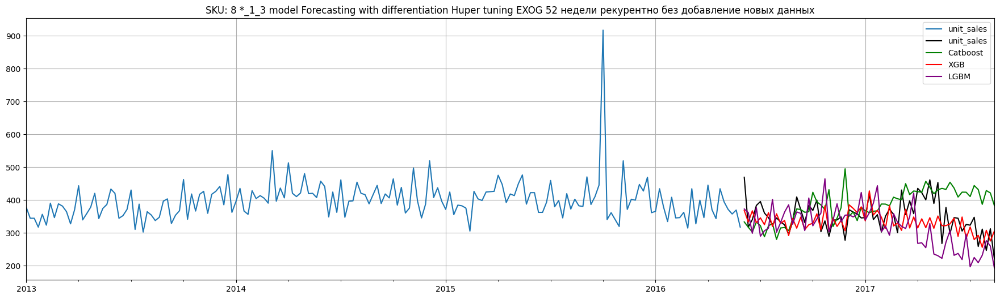

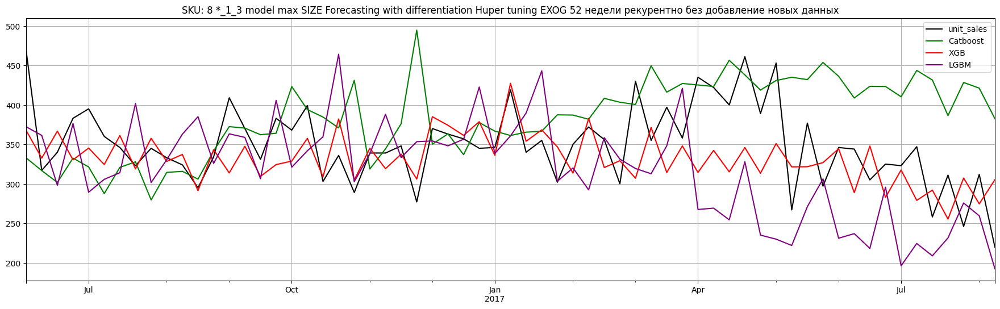

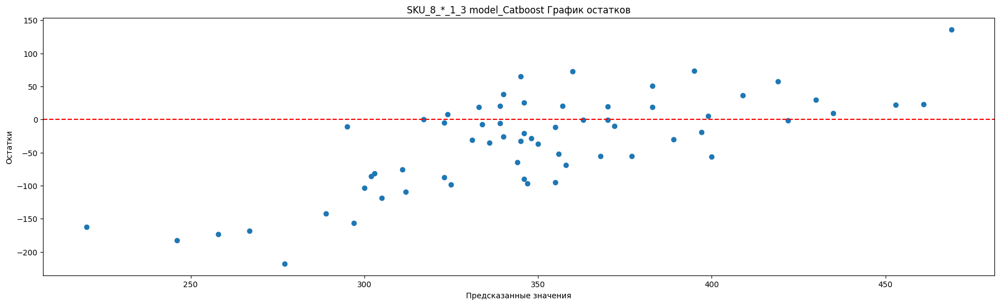

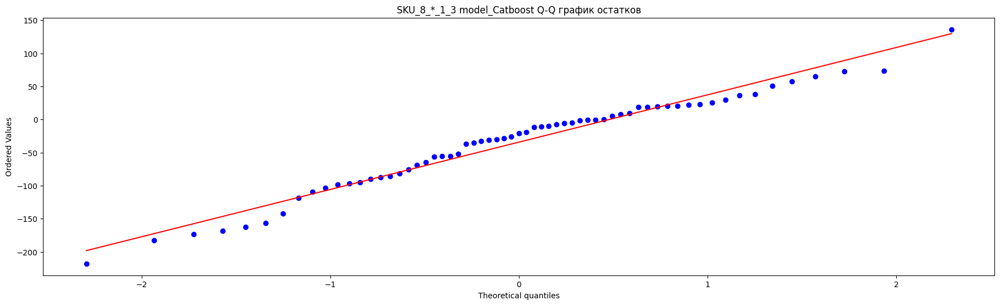

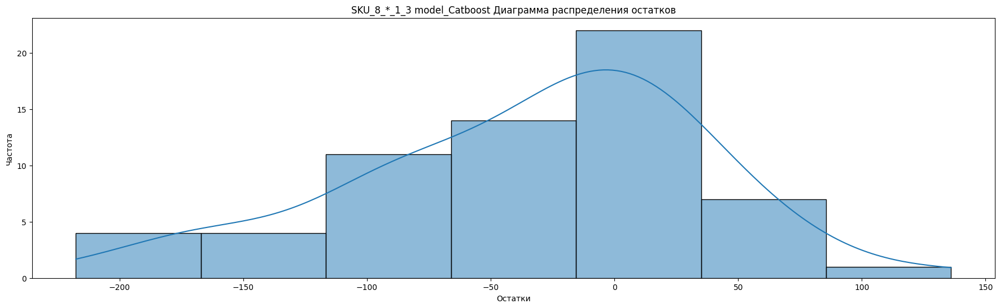

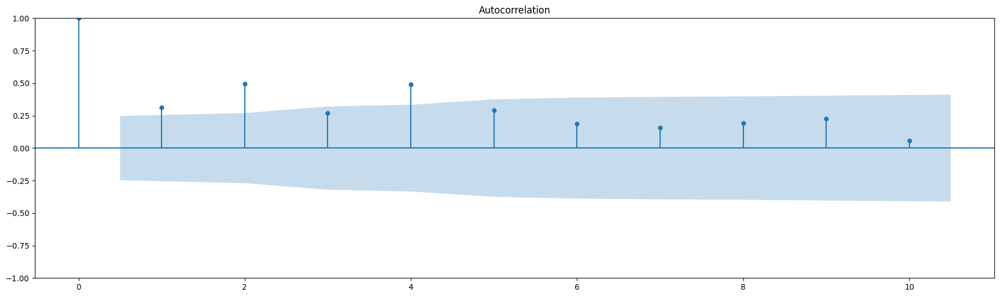

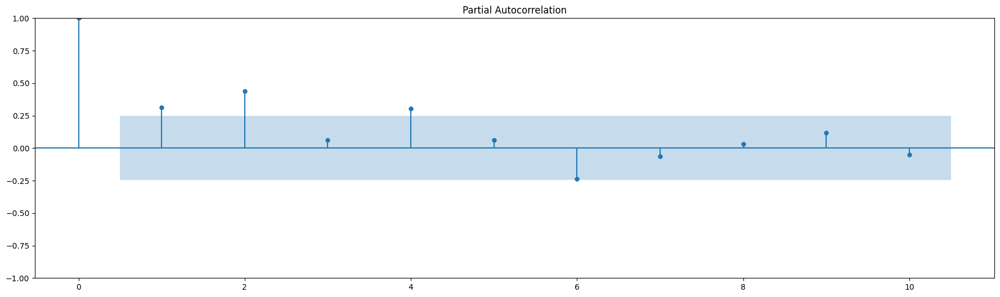


Статисткика по остаткам SKU_8_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9719787836074829
p-value Шапиро-Уилка : 0.16006340086460114

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    6.461664  1.102264e-02   6.163434  1.304178e-02  не белый шум
2   22.782299  1.129501e-05  21.479722  2.166395e-05  не белый шум
3   27.748213  4.101957e-06  26.063642  9.249212e-06  не белый шум
4   44.477645  5.105240e-09  41.248819  2.387135e-08  не белый шум
5   50.399112  1.148183e-09  46.532589  7.074872e-09  не белый шум
6   52.942302  1.205103e-09  48.762772  8.317120e-09  не белый шум
7   54.784941  1.644575e-09  50.350276  1.232890e-08  не белый шум
8   57.518782  1.426191e-09  52.663526  1.252839e-08  не белый шум
9   61.422603  7.125278e-10  55.906701  8.178165e-09  не белый шум
10  61.683128  1.738275e-09  56.119128  1.950

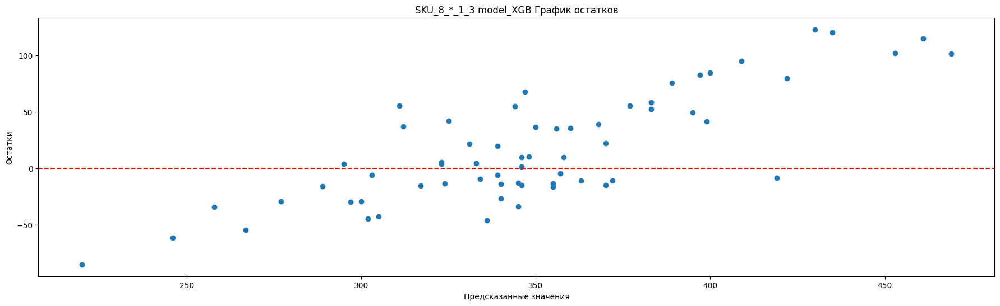

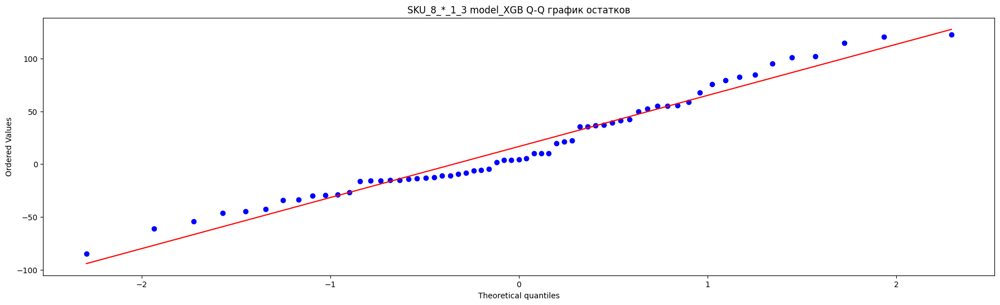

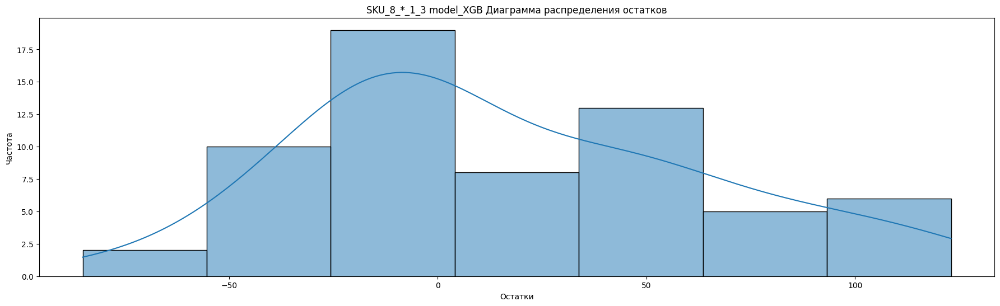

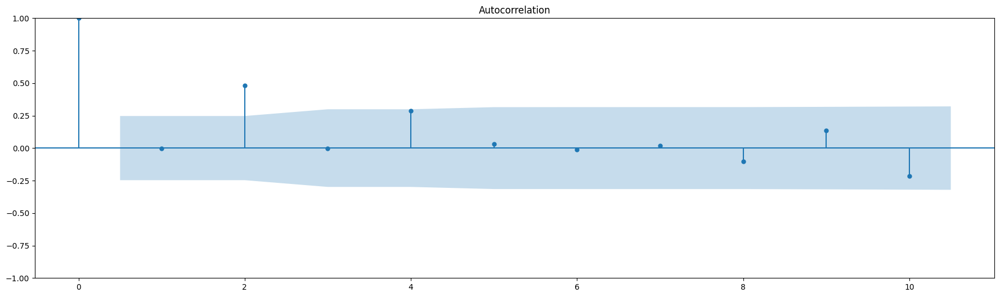

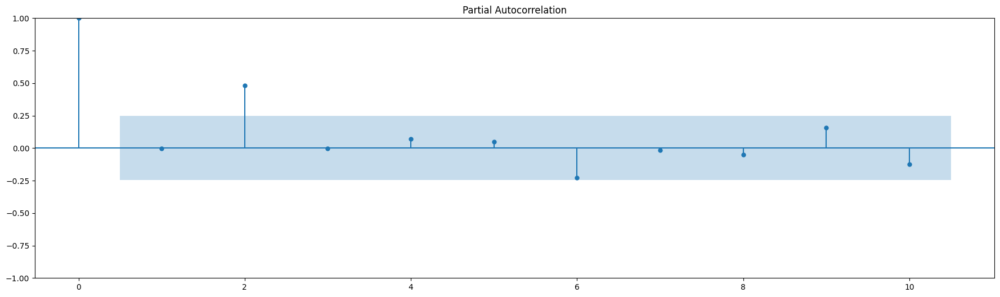


Статисткика по остаткам SKU_8_*_1_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9647092819213867
p-value Шапиро-Уилка : 0.06774765998125076

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    0.000809   0.977306   0.000772   0.977835     белый шум
2   15.580950   0.000414  14.622135   0.000668  не белый шум
3   15.582123   0.001381  14.623218   0.002169  не белый шум
4   21.284649   0.000278  19.799357   0.000547  не белый шум
5   21.358698   0.000693  19.865431   0.001325  не белый шум
6   21.369136   0.001574  19.874584   0.002915  не белый шум
7   21.391242   0.003232  19.893630   0.005804  не белый шум
8   22.195558   0.004566  20.574204   0.008369  не белый шум
9   23.590019   0.004999  21.732680   0.009766  не белый шум
10  27.195543   0.002425  24.672569   0.006002  не белый шум

Тест Дарбина-Уотсона: 1.679514058781305
Отсутств

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


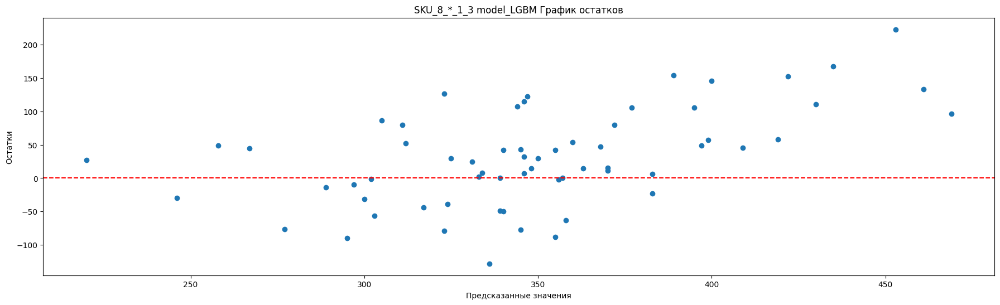

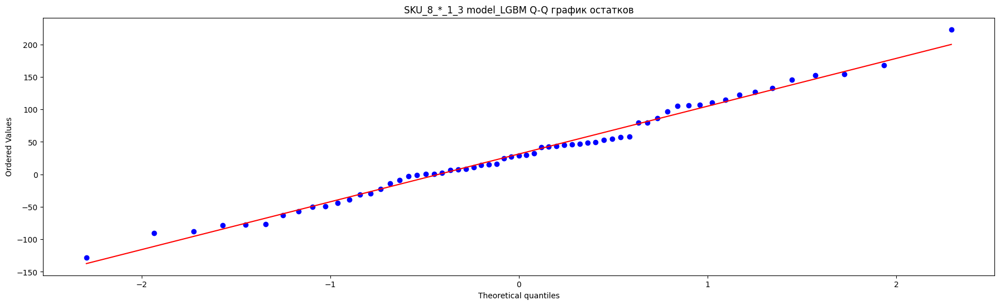

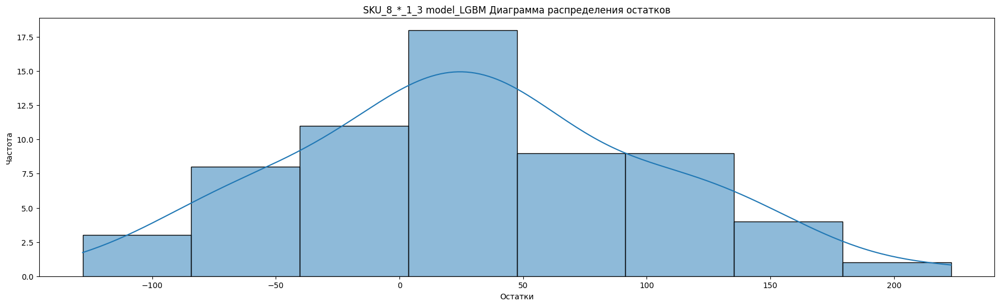

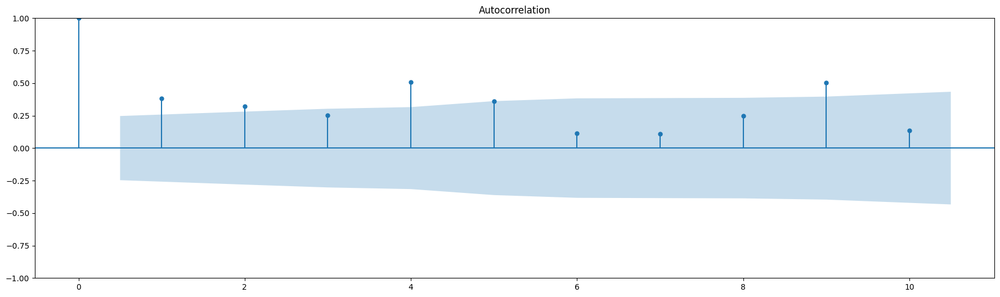

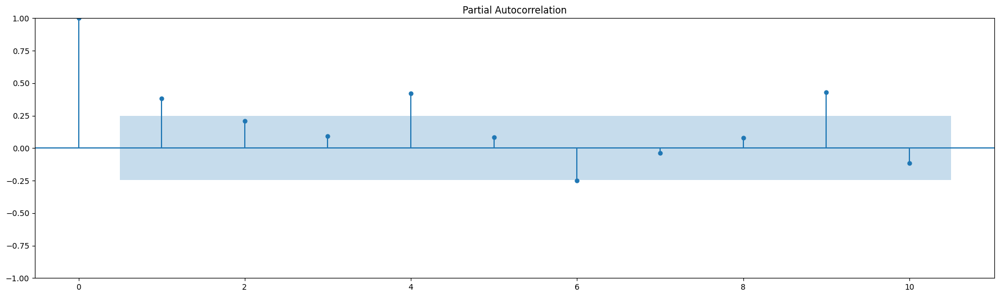


Статисткика по остаткам SKU_8_*_1_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9891369342803955
p-value Шапиро-Уилка : 0.8540744781494141

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    9.712285  1.830403e-03   9.264026  2.336987e-03  не белый шум
2   16.740957  2.316047e-04  15.860164  3.597569e-04  не белый шум
3   21.148760  9.804647e-05  19.928905  1.755994e-04  не белый шум
4   38.899229  7.308441e-08  36.040870  2.838213e-07  не белый шум
5   48.048542  3.471797e-09  44.204872  2.104676e-08  не белый шум
6   49.006619  7.433239e-09  45.045032  4.584767e-08  не белый шум
7   49.913107  1.502346e-08  45.826006  9.450601e-08  не белый шум
8   54.462423  5.614907e-09  49.675427  4.717658e-08  не белый шум
9   73.687155  2.868971e-12  65.646743  1.079725e-10  не белый шум
10  75.118666  4.511353e-12  66.813975  1.820489e-

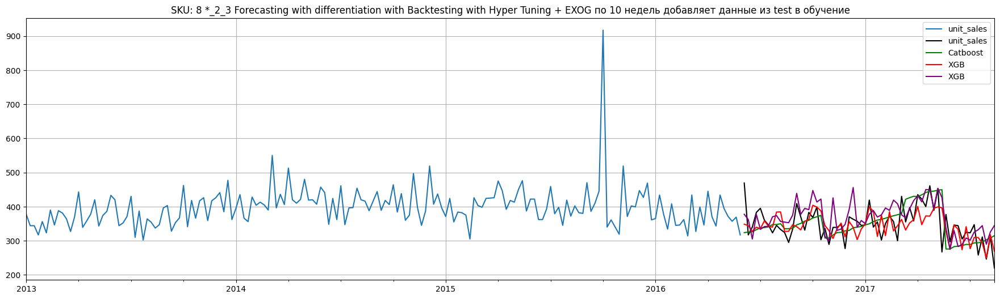

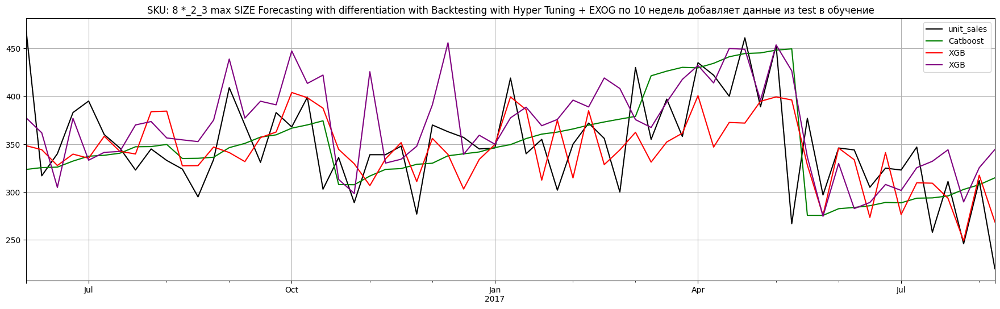

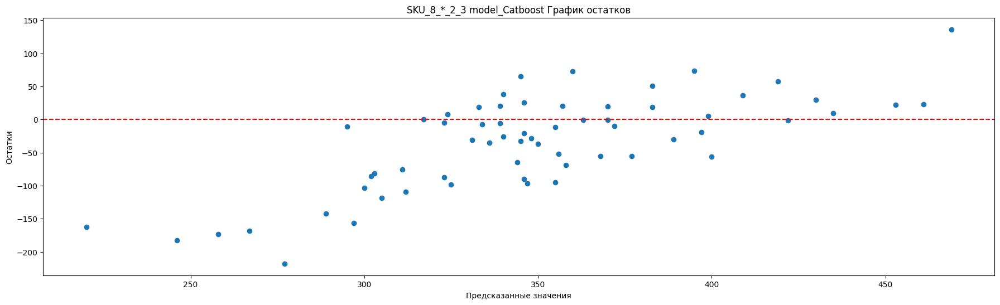

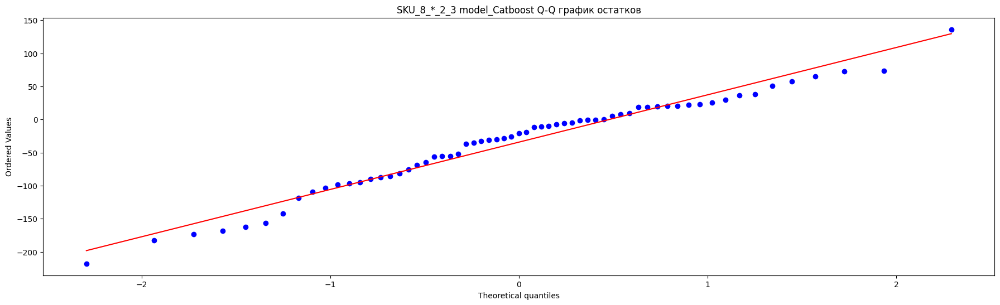

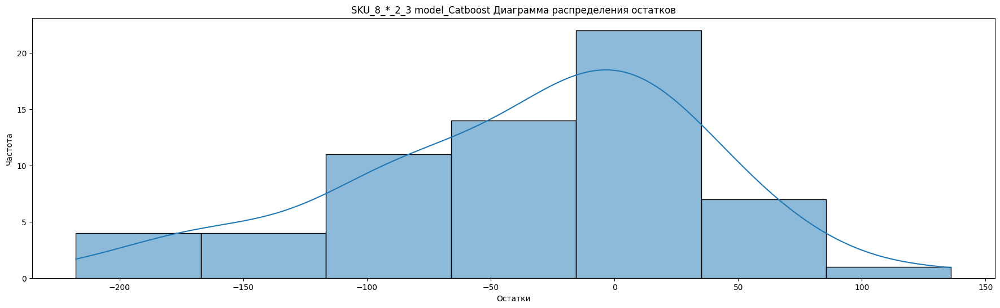

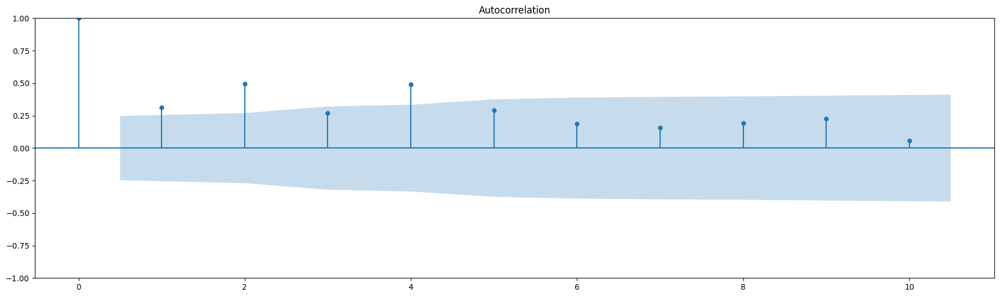

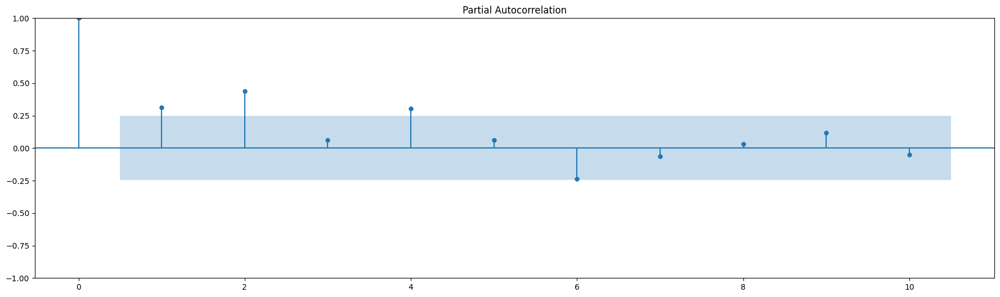


Статисткика по остаткам SKU_8_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9719787836074829
p-value Шапиро-Уилка : 0.16006340086460114

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    6.461664  1.102264e-02   6.163434  1.304178e-02  не белый шум
2   22.782299  1.129501e-05  21.479722  2.166395e-05  не белый шум
3   27.748213  4.101957e-06  26.063642  9.249212e-06  не белый шум
4   44.477645  5.105240e-09  41.248819  2.387135e-08  не белый шум
5   50.399112  1.148183e-09  46.532589  7.074872e-09  не белый шум
6   52.942302  1.205103e-09  48.762772  8.317120e-09  не белый шум
7   54.784941  1.644575e-09  50.350276  1.232890e-08  не белый шум
8   57.518782  1.426191e-09  52.663526  1.252839e-08  не белый шум
9   61.422603  7.125278e-10  55.906701  8.178165e-09  не белый шум
10  61.683128  1.738275e-09  56.119128  1.950

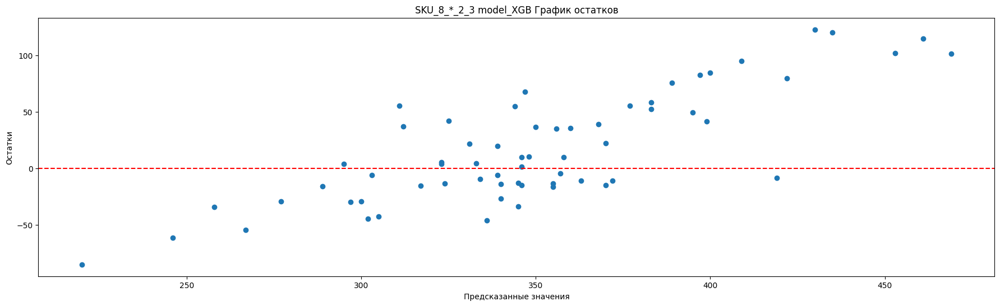

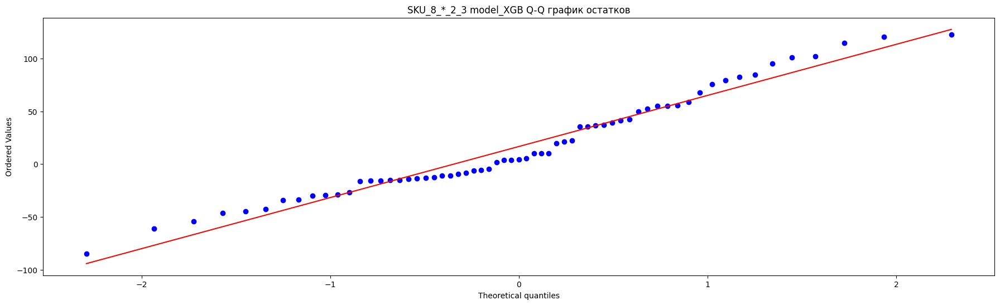

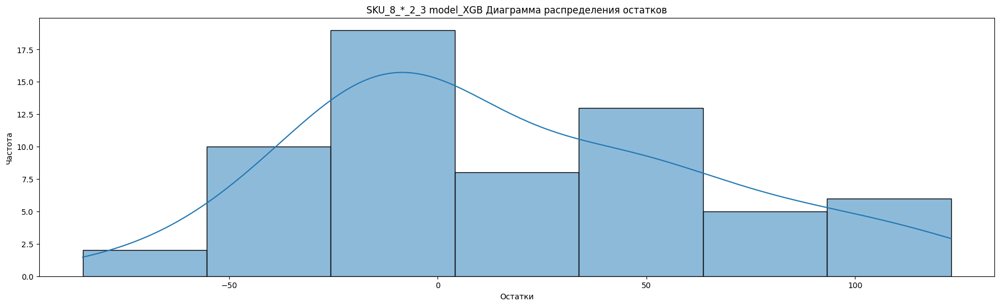

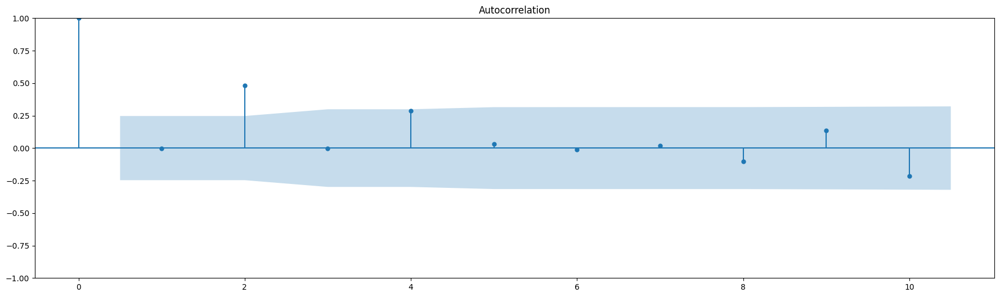

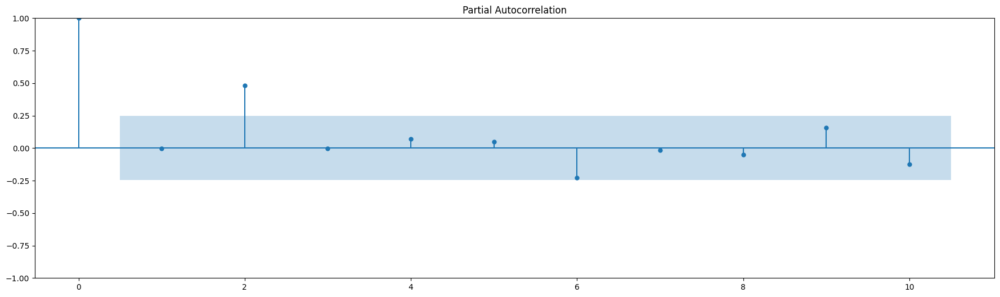


Статисткика по остаткам SKU_8_*_2_3 model_XGB
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9647092819213867
p-value Шапиро-Уилка : 0.06774765998125076

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    0.000809   0.977306   0.000772   0.977835     белый шум
2   15.580950   0.000414  14.622135   0.000668  не белый шум
3   15.582123   0.001381  14.623218   0.002169  не белый шум
4   21.284649   0.000278  19.799357   0.000547  не белый шум
5   21.358698   0.000693  19.865431   0.001325  не белый шум
6   21.369136   0.001574  19.874584   0.002915  не белый шум
7   21.391242   0.003232  19.893630   0.005804  не белый шум
8   22.195558   0.004566  20.574204   0.008369  не белый шум
9   23.590019   0.004999  21.732680   0.009766  не белый шум
10  27.195543   0.002425  24.672569   0.006002  не белый шум

Тест Дарбина-Уотсона: 1.679514058781305
Отсутств

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


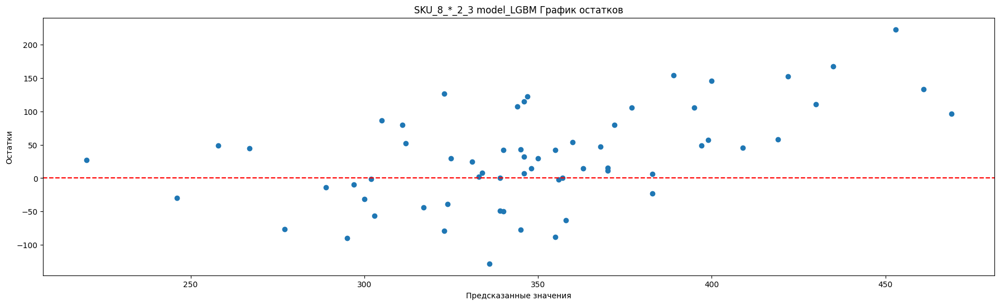

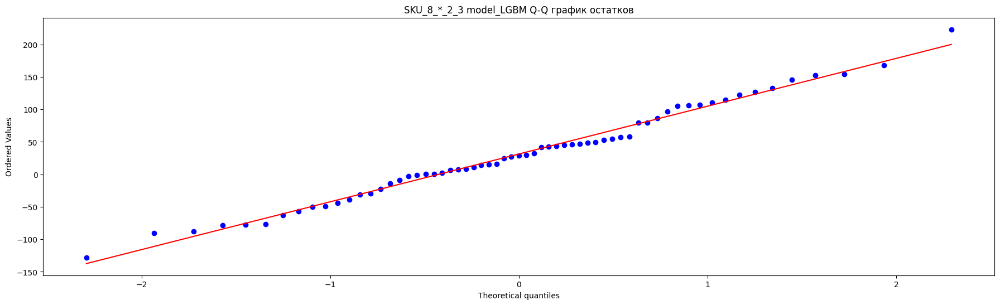

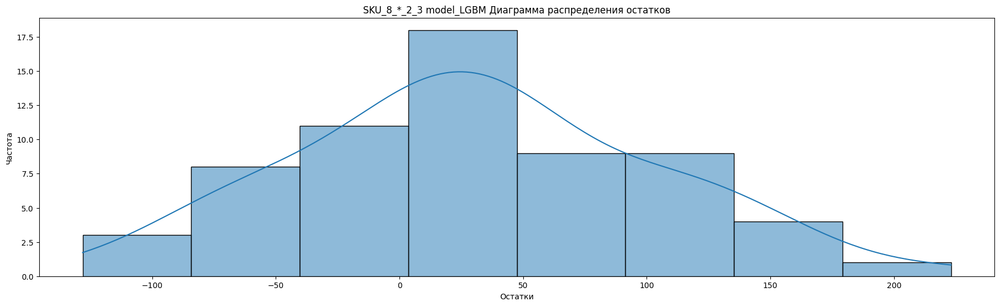

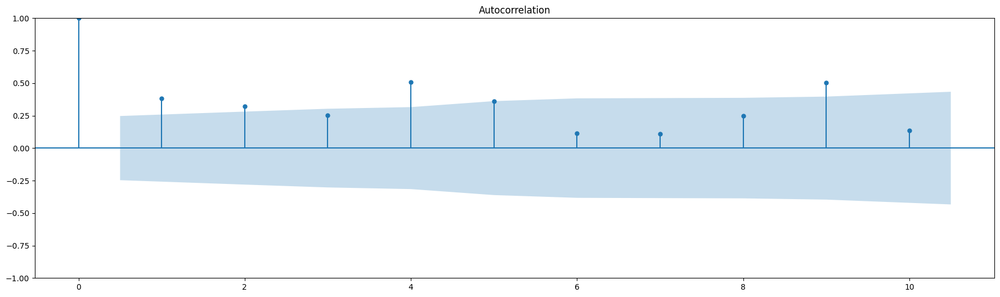

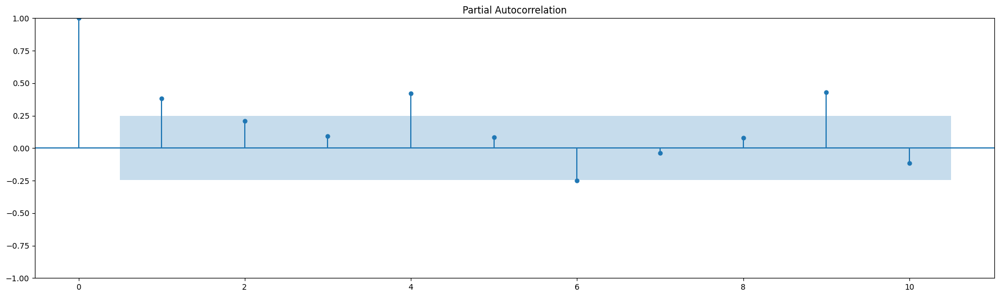


Статисткика по остаткам SKU_8_*_2_3 model_LGBM
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9891369342803955
p-value Шапиро-Уилка : 0.8540744781494141

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1    9.712285  1.830403e-03   9.264026  2.336987e-03  не белый шум
2   16.740957  2.316047e-04  15.860164  3.597569e-04  не белый шум
3   21.148760  9.804647e-05  19.928905  1.755994e-04  не белый шум
4   38.899229  7.308441e-08  36.040870  2.838213e-07  не белый шум
5   48.048542  3.471797e-09  44.204872  2.104676e-08  не белый шум
6   49.006619  7.433239e-09  45.045032  4.584767e-08  не белый шум
7   49.913107  1.502346e-08  45.826006  9.450601e-08  не белый шум
8   54.462423  5.614907e-09  49.675427  4.717658e-08  не белый шум
9   73.687155  2.868971e-12  65.646743  1.079725e-10  не белый шум
10  75.118666  4.511353e-12  66.813975  1.820489e-

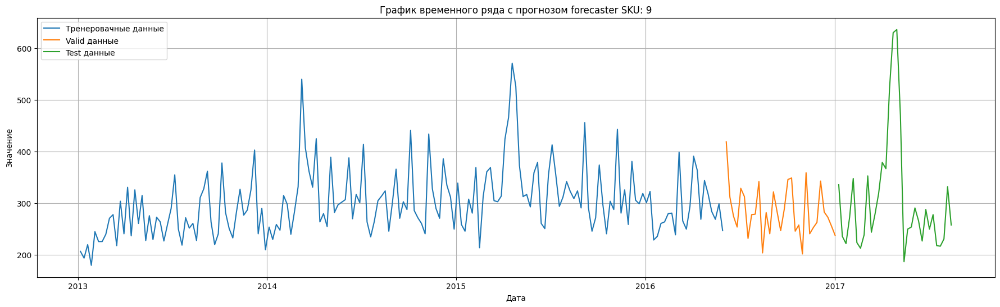

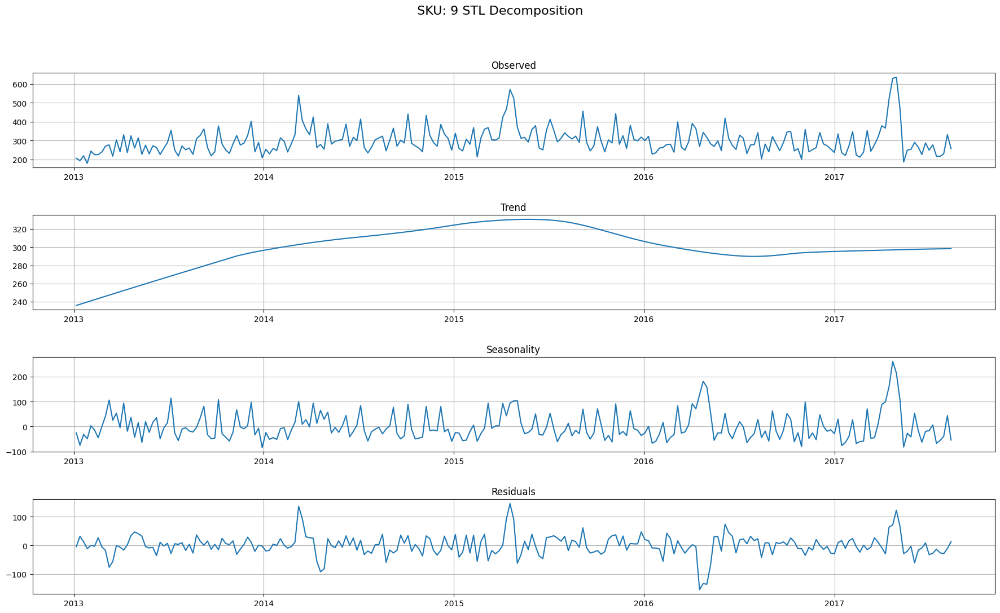

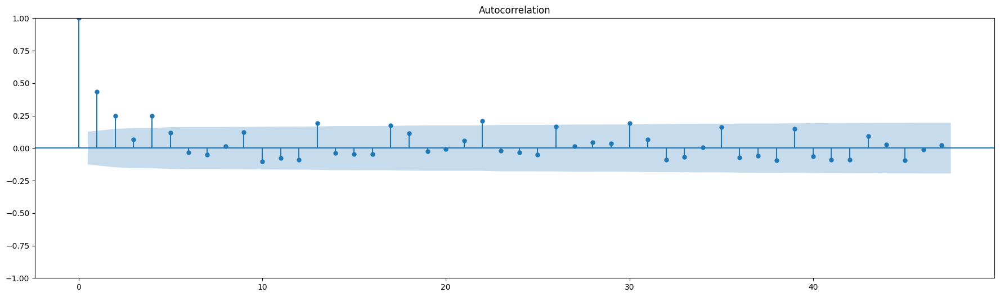

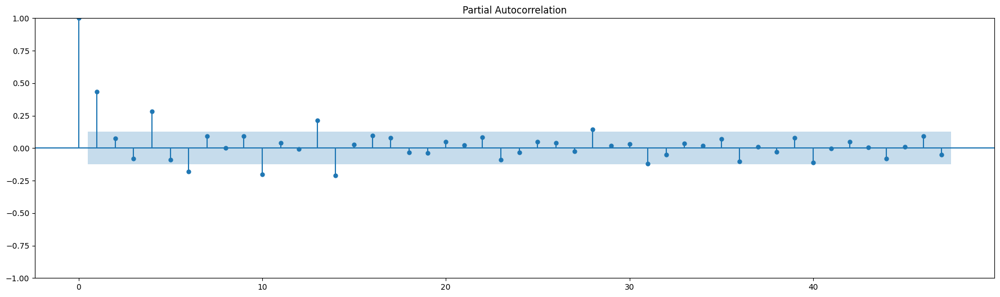

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4] 
  Parameters: {'depth': 10, 'learning_rate': 0.42166632091687567, 'iterations': 300}
  Backtesting metric: 42.878221941510255

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'max_depth': 10, 'reg_alpha': 0.5, 'reg_lambda': 0.4, 'n_estimators': 800}
  Backtesting metric: 47.0781298452808

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameter

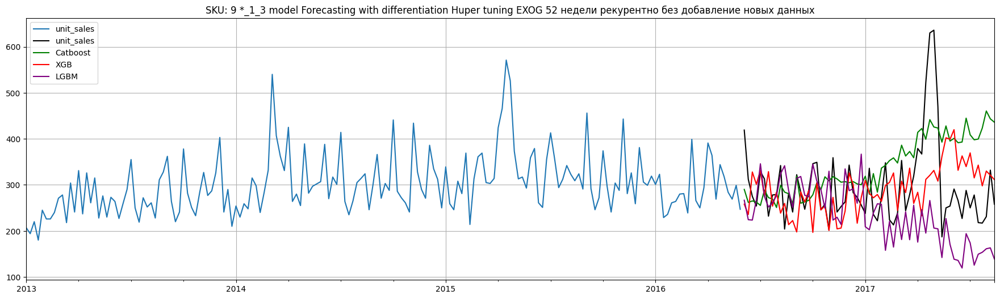

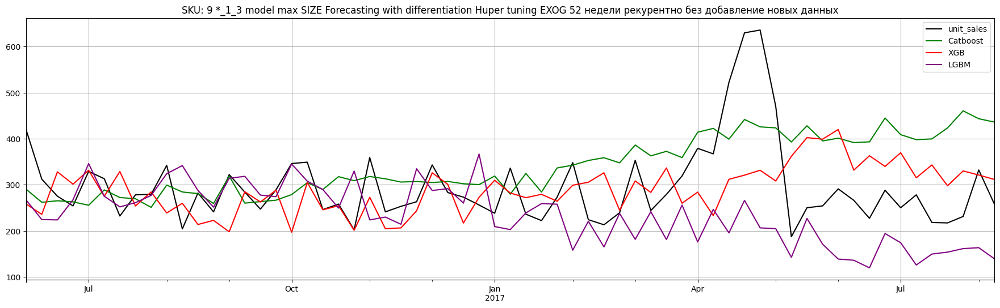

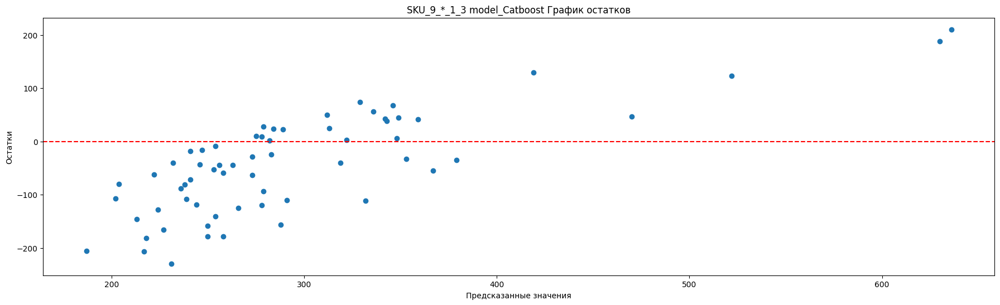

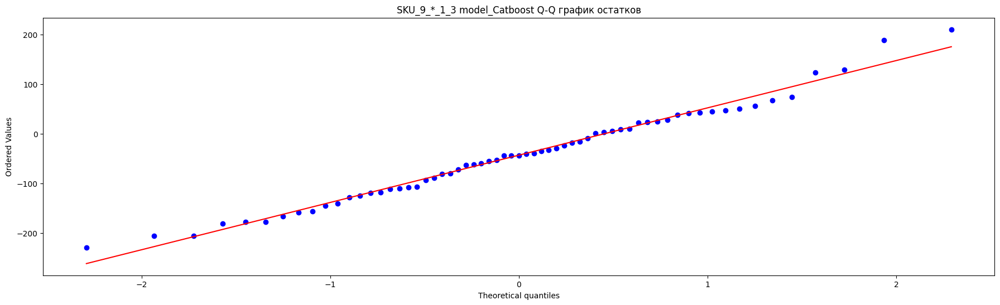

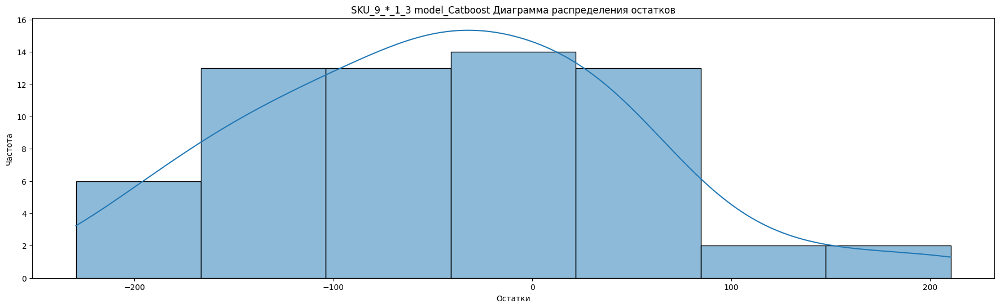

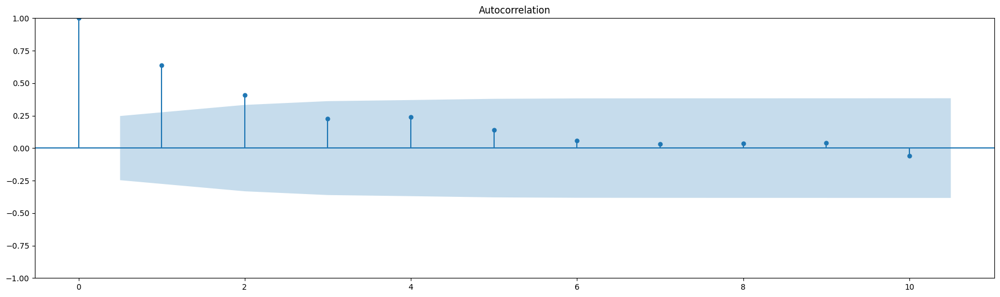

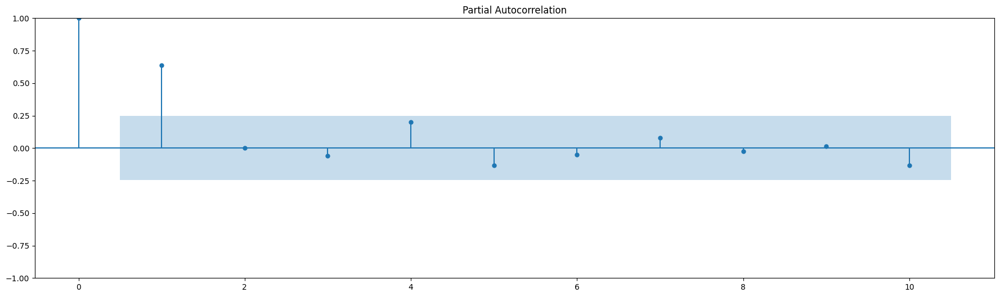


Статисткика по остаткам SKU_9_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9840400218963623
p-value Шапиро-Уилка : 0.5880325436592102

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   26.797099  2.259763e-07  25.560310  4.287689e-07  не белый шум
2   37.894790  5.905422e-09  35.975066  1.542104e-08  не белый шум
3   41.348592  5.515490e-09  39.163191  1.602851e-08  не белый шум
4   45.366416  3.336173e-09  42.810138  1.133034e-08  не белый шум
5   46.749865  6.389182e-09  44.044601  2.268435e-08  не белый шум
6   46.990680  1.879159e-08  44.255777  6.577081e-08  не белый шум
7   47.062548  5.427383e-08  44.317695  1.854761e-07  не белый шум
8   47.160795  1.428855e-07  44.400827  4.778614e-07  не белый шум
9   47.277294  3.484404e-07  44.497610  1.142561e-06  не белый шум
10  47.530910  7.558451e-07  44.704404  2.4586

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


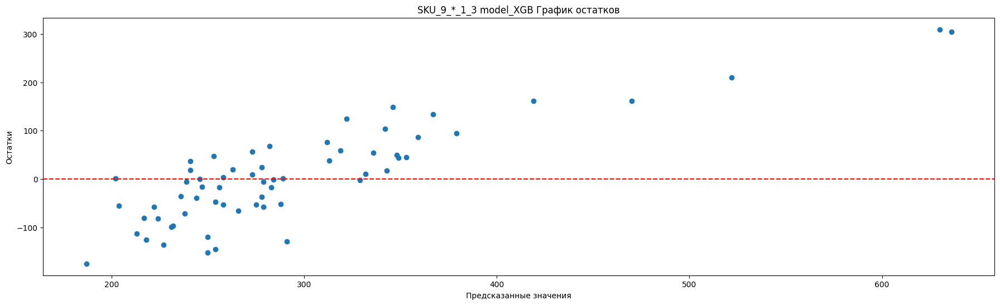

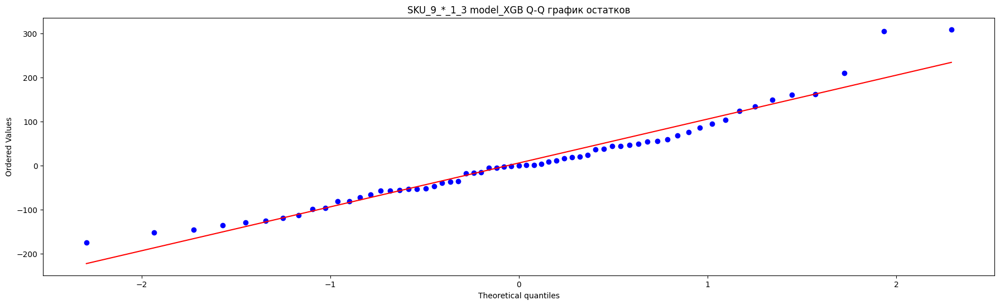

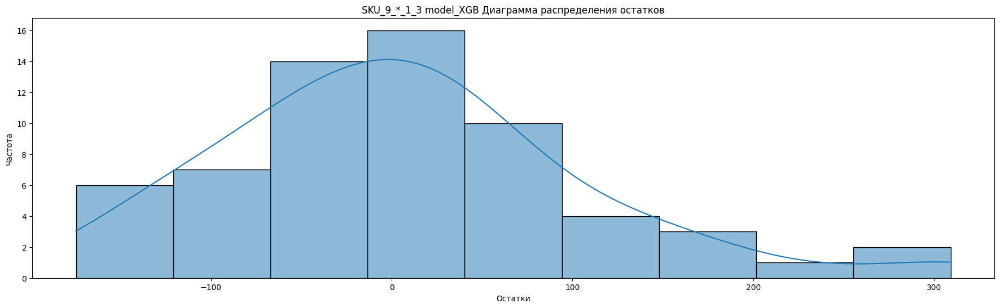

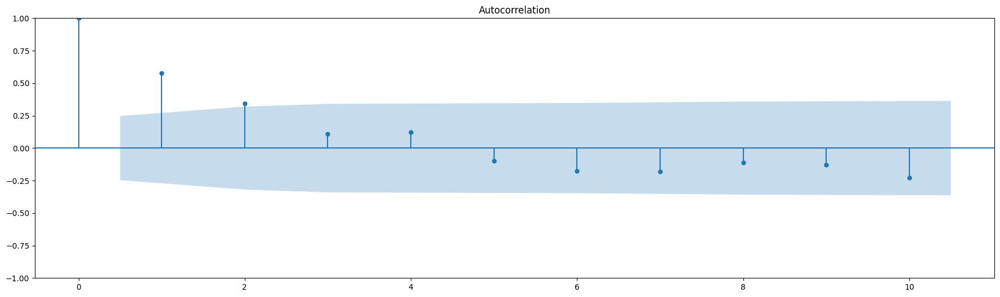

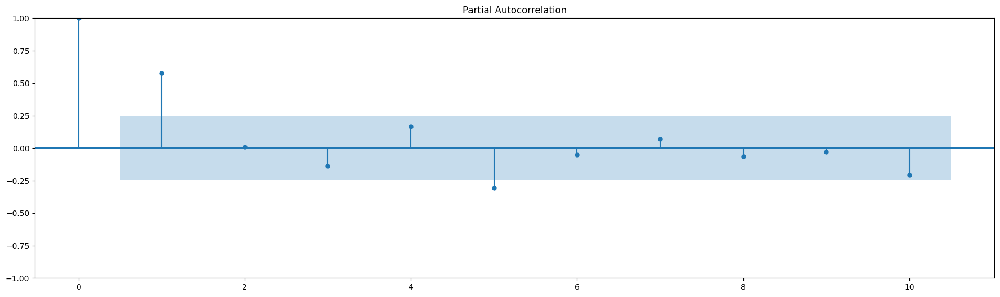


Статисткика по остаткам SKU_9_*_1_3 model_XGB
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.95433509349823
p-value Шапиро-Уилка : 0.020190594717860222

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   22.072082  2.626013e-06  21.053371  4.466664e-06  не белый шум
2   29.905815  3.206526e-07  28.405028  6.790889e-07  не белый шум
3   30.744637  9.620663e-07  29.179325  2.053299e-06  не белый шум
4   31.782636  2.119102e-06  30.121509  4.623421e-06  не белый шум
5   32.463578  4.808631e-06  30.729118  1.059433e-05  не белый шум
6   34.648942  5.039671e-06  32.645515  1.226777e-05  не белый шум
7   37.072695  4.544251e-06  34.733671  1.254984e-05  не белый шум
8   37.997025  7.537823e-06  35.515797  2.153087e-05  не белый шум
9   39.288228  1.022038e-05  36.588488  3.116066e-05  не белый шум
10  43.254237  4.478561e-06  39.822311  1.820997

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


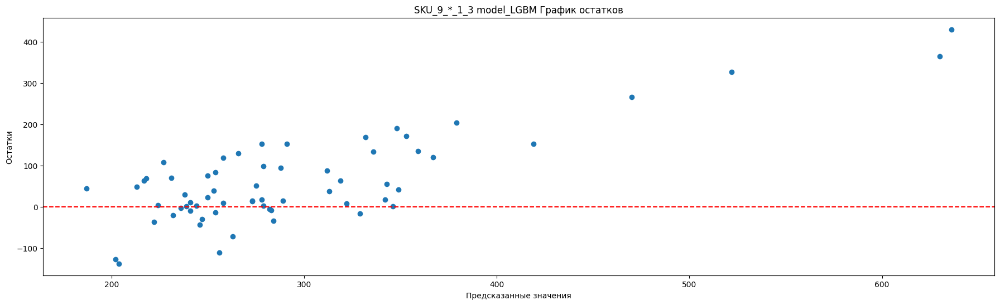

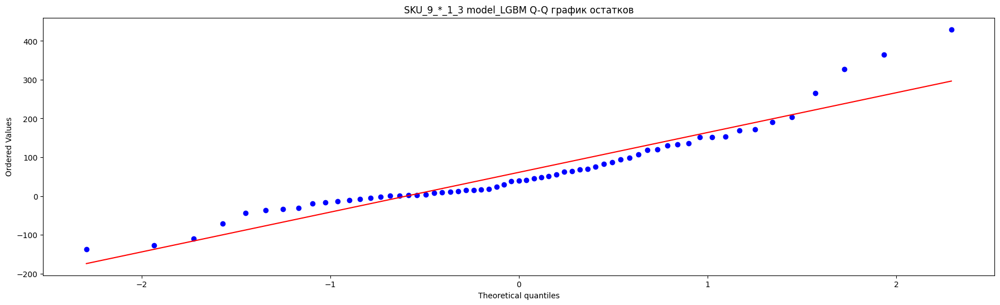

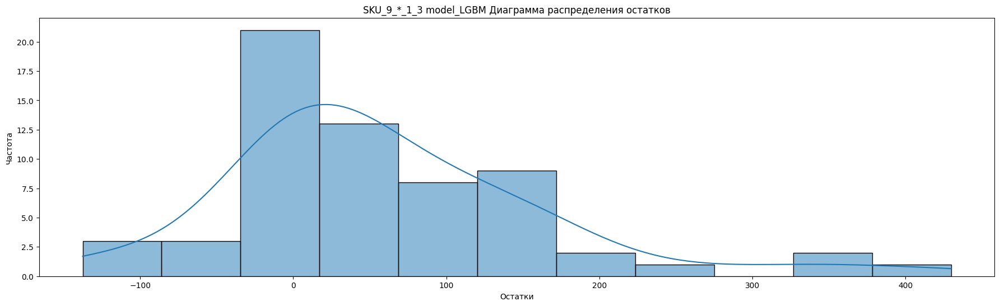

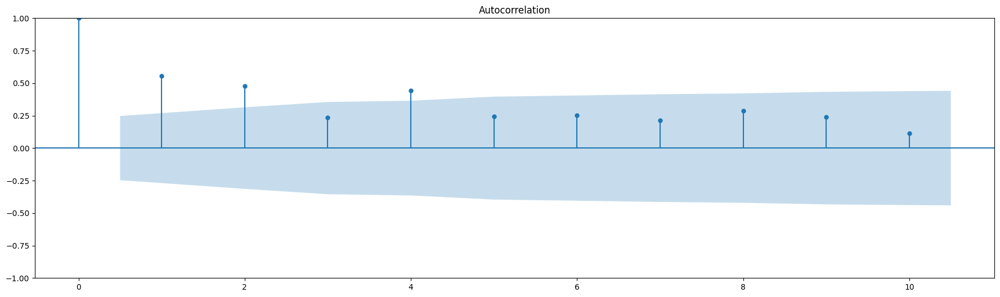

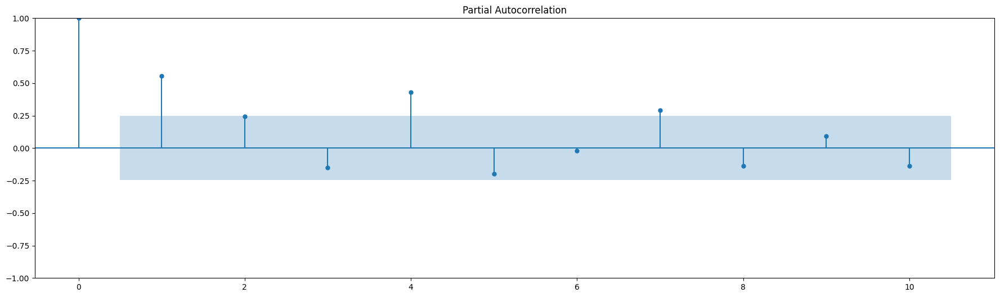


Статисткика по остаткам SKU_9_*_1_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.911749541759491
p-value Шапиро-Уилка : 0.00025642040418460965

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   20.318031  6.557964e-06  19.380276  1.071076e-05  не белый шум
2   35.484784  1.970503e-08  33.613690  5.022037e-08  не белый шум
3   39.310615  1.491617e-08  37.145227  4.287070e-08  не белый шум
4   52.934430  8.795269e-11  49.511459  4.566644e-10  не белый шум
5   57.112480  4.794071e-11  53.239565  3.003174e-10  не белый шум
6   61.711657  2.019573e-11  57.272689  1.608818e-10  не белый шум
7   65.007328  1.498734e-11  60.112036  1.433764e-10  не белый шум
8   71.186220  2.851971e-12  65.340329  4.133164e-11  не белый шум
9   75.534459  1.239306e-12  68.952713  2.442312e-11  не белый шум
10  76.536532  2.387835e-12  69.769788  4.91

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


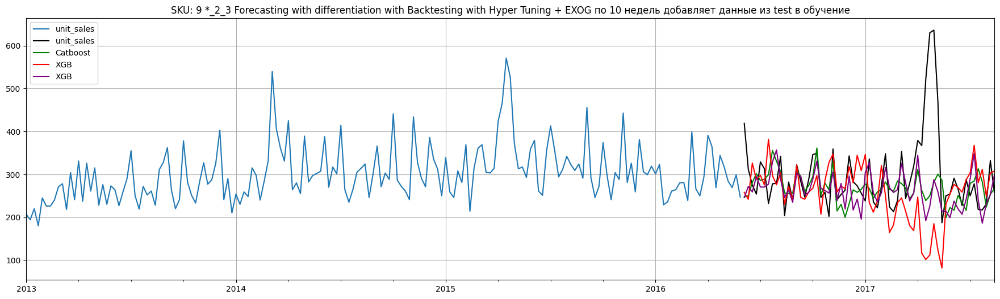

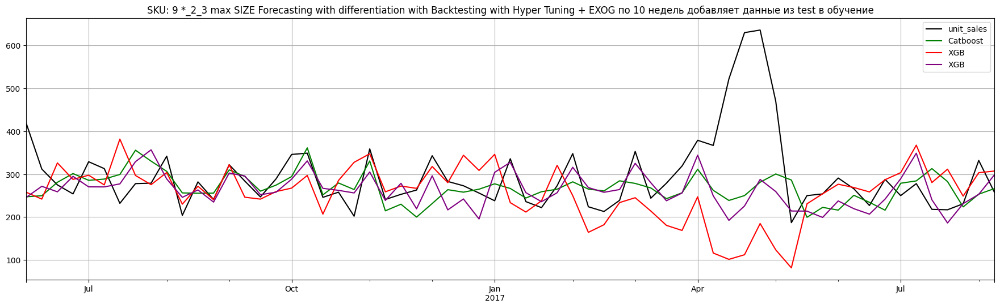

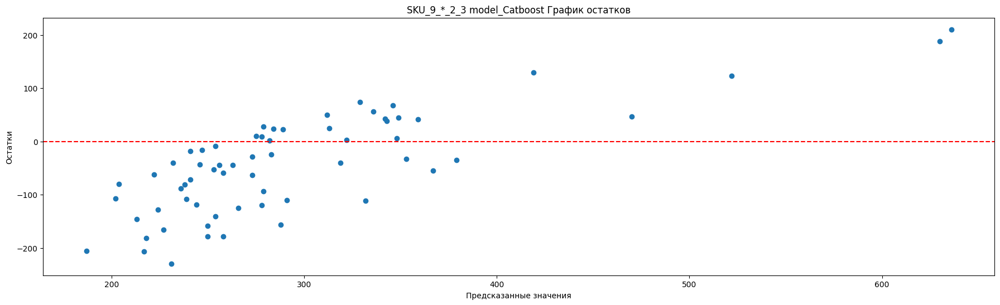

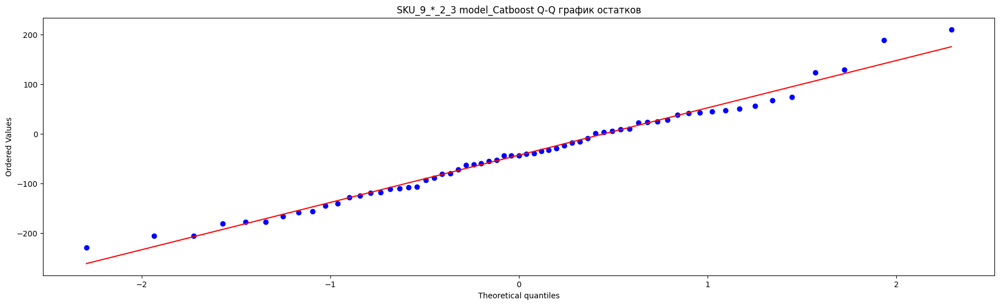

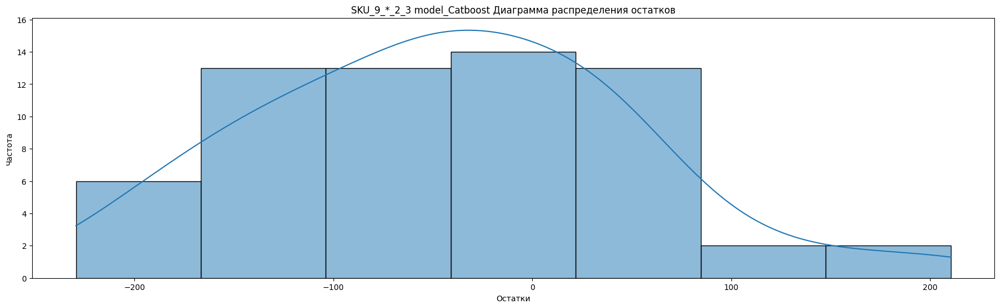

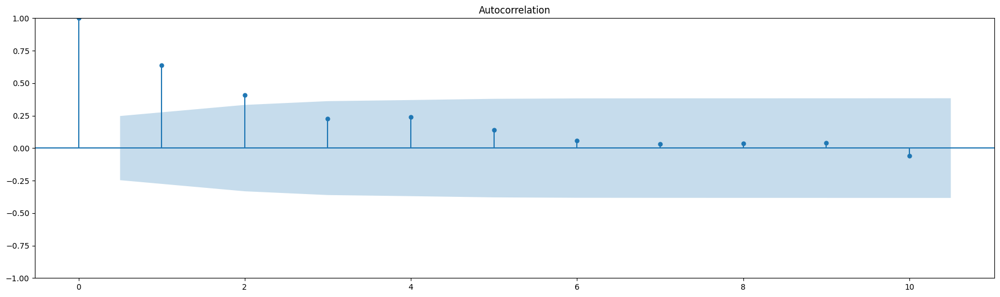

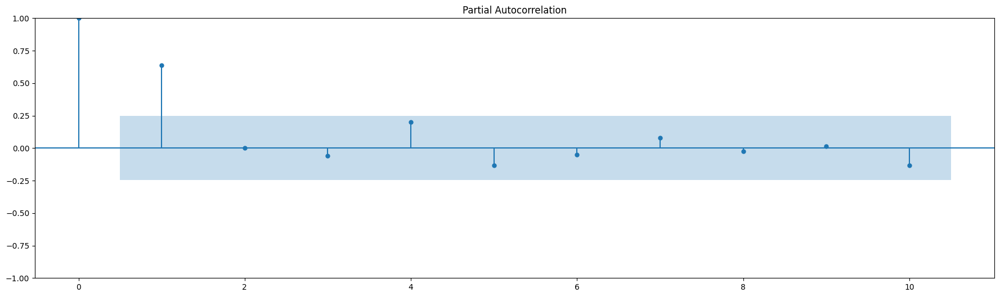


Статисткика по остаткам SKU_9_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9840400218963623
p-value Шапиро-Уилка : 0.5880325436592102

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   26.797099  2.259763e-07  25.560310  4.287689e-07  не белый шум
2   37.894790  5.905422e-09  35.975066  1.542104e-08  не белый шум
3   41.348592  5.515490e-09  39.163191  1.602851e-08  не белый шум
4   45.366416  3.336173e-09  42.810138  1.133034e-08  не белый шум
5   46.749865  6.389182e-09  44.044601  2.268435e-08  не белый шум
6   46.990680  1.879159e-08  44.255777  6.577081e-08  не белый шум
7   47.062548  5.427383e-08  44.317695  1.854761e-07  не белый шум
8   47.160795  1.428855e-07  44.400827  4.778614e-07  не белый шум
9   47.277294  3.484404e-07  44.497610  1.142561e-06  не белый шум
10  47.530910  7.558451e-07  44.704404  2.4586

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


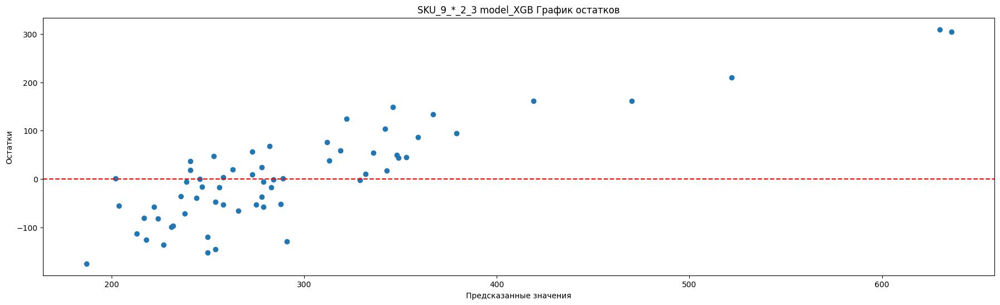

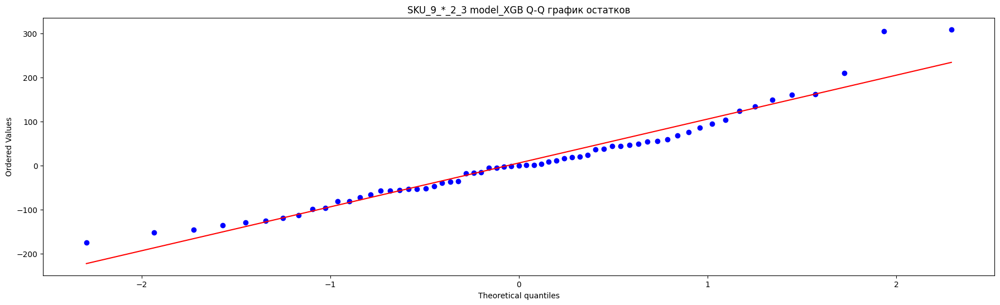

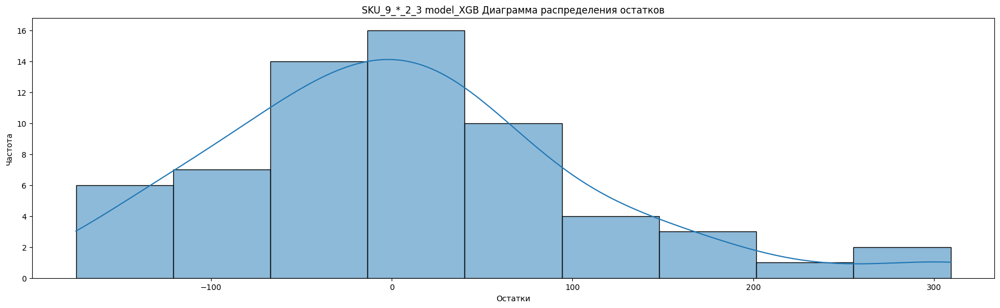

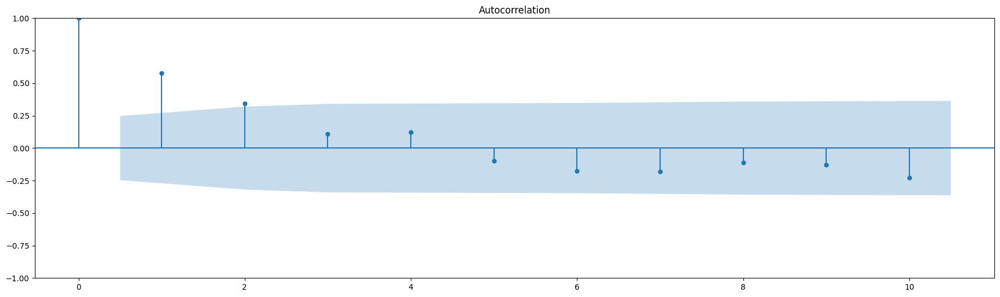

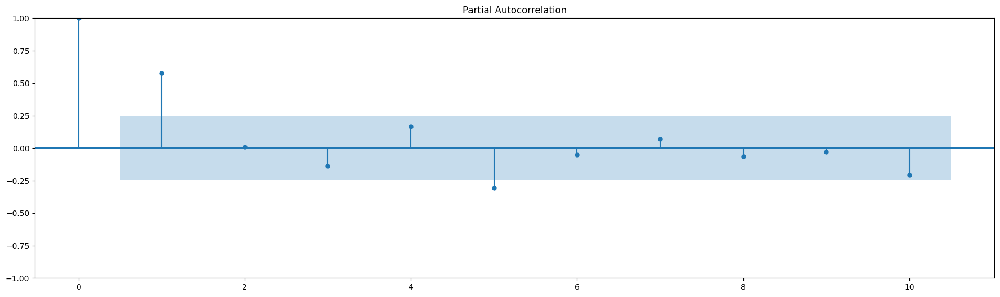


Статисткика по остаткам SKU_9_*_2_3 model_XGB
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.95433509349823
p-value Шапиро-Уилка : 0.020190594717860222

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   22.072082  2.626013e-06  21.053371  4.466664e-06  не белый шум
2   29.905815  3.206526e-07  28.405028  6.790889e-07  не белый шум
3   30.744637  9.620663e-07  29.179325  2.053299e-06  не белый шум
4   31.782636  2.119102e-06  30.121509  4.623421e-06  не белый шум
5   32.463578  4.808631e-06  30.729118  1.059433e-05  не белый шум
6   34.648942  5.039671e-06  32.645515  1.226777e-05  не белый шум
7   37.072695  4.544251e-06  34.733671  1.254984e-05  не белый шум
8   37.997025  7.537823e-06  35.515797  2.153087e-05  не белый шум
9   39.288228  1.022038e-05  36.588488  3.116066e-05  не белый шум
10  43.254237  4.478561e-06  39.822311  1.820997

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


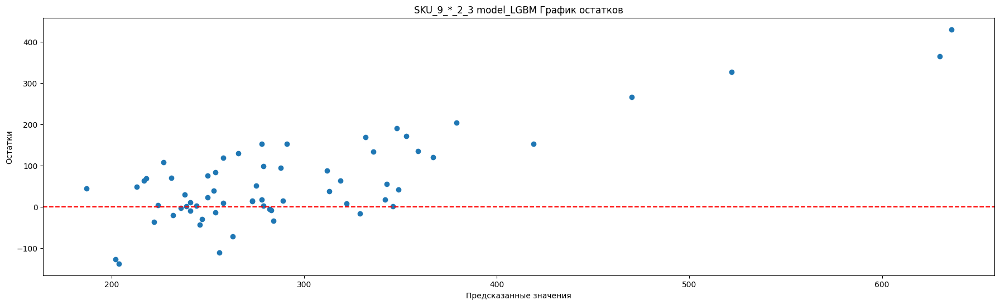

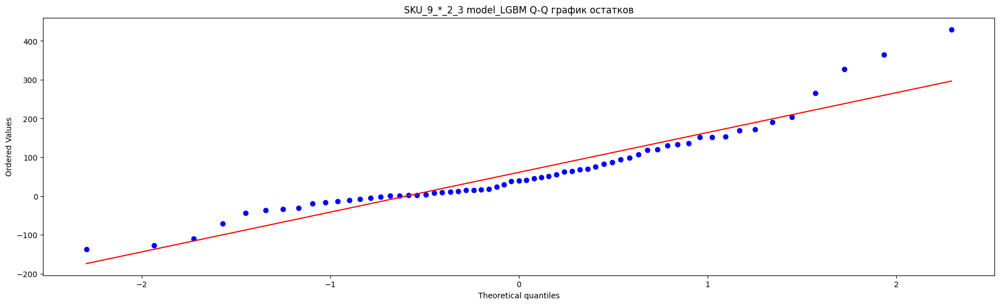

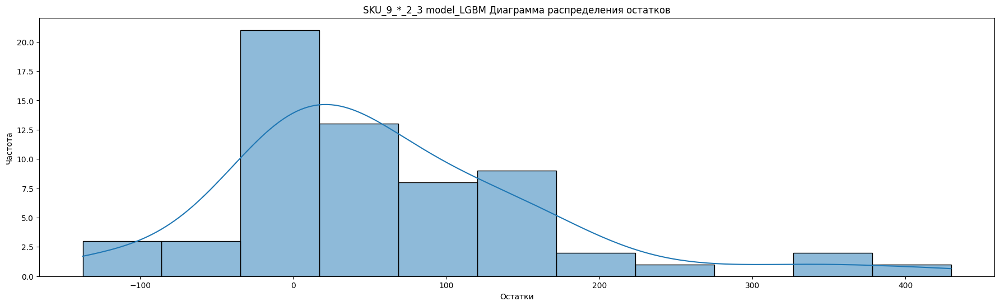

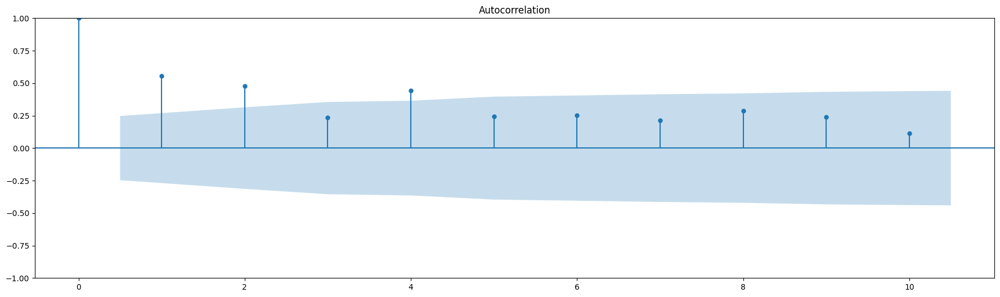

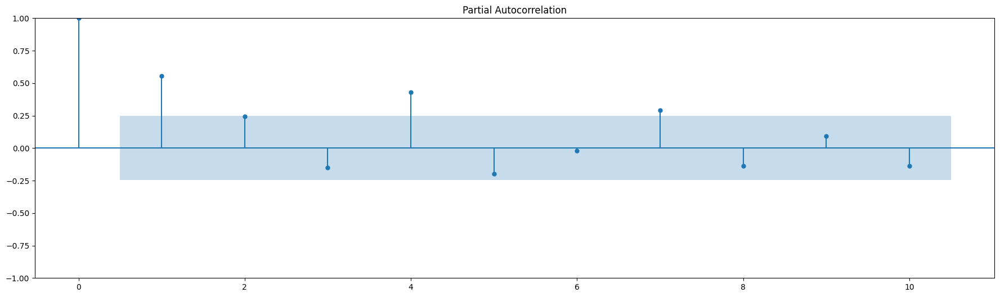


Статисткика по остаткам SKU_9_*_2_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.911749541759491
p-value Шапиро-Уилка : 0.00025642040418460965

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   20.318031  6.557964e-06  19.380276  1.071076e-05  не белый шум
2   35.484784  1.970503e-08  33.613690  5.022037e-08  не белый шум
3   39.310615  1.491617e-08  37.145227  4.287070e-08  не белый шум
4   52.934430  8.795269e-11  49.511459  4.566644e-10  не белый шум
5   57.112480  4.794071e-11  53.239565  3.003174e-10  не белый шум
6   61.711657  2.019573e-11  57.272689  1.608818e-10  не белый шум
7   65.007328  1.498734e-11  60.112036  1.433764e-10  не белый шум
8   71.186220  2.851971e-12  65.340329  4.133164e-11  не белый шум
9   75.534459  1.239306e-12  68.952713  2.442312e-11  не белый шум
10  76.536532  2.387835e-12  69.769788  4.91

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


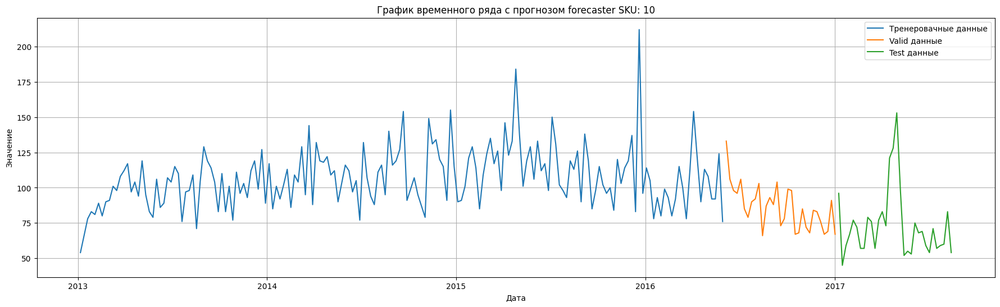

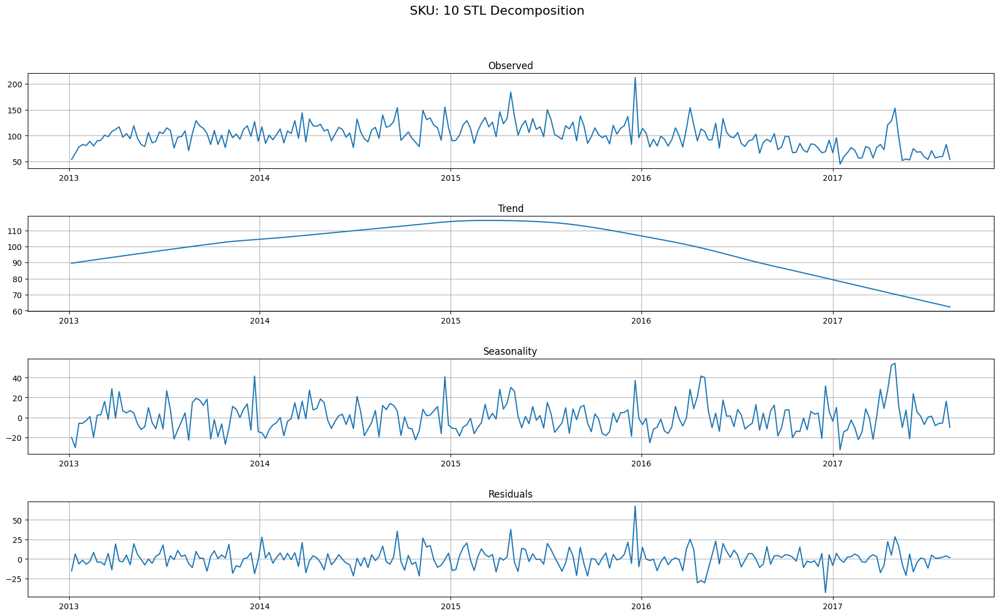

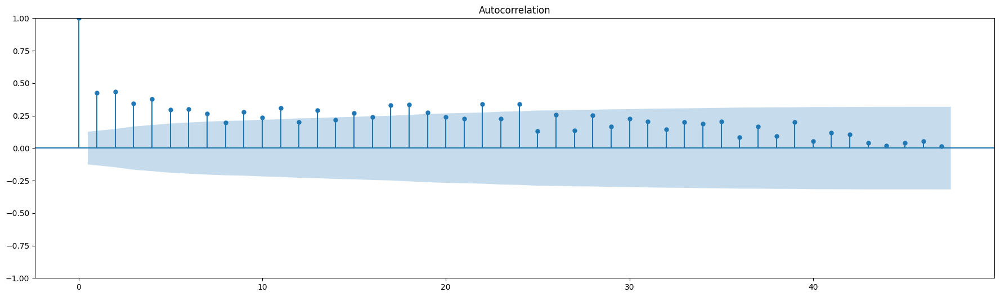

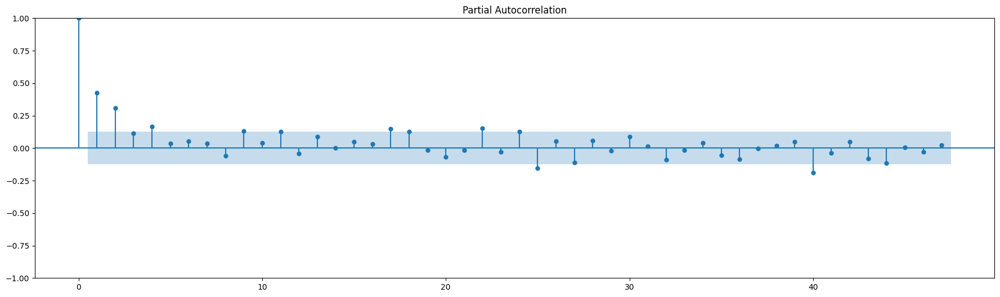

Train dates : 2013-01-06 00:00:00 --- 2016-05-29 00:00:00  (n=178)
Valid dates  : 2016-06-05 00:00:00 --- 2017-01-01 00:00:00  (n=31)
Test dates  : 2017-01-08 00:00:00 --- 2017-08-13 00:00:00  (n=32)
Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'depth': 10, 'learning_rate': 0.11181855841694613, 'iterations': 300}
  Backtesting metric: 10.830539678271384

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [1 2 3 4 5 6 7 8] 
  Parameters: {'max_depth': 10, 'reg_alpha': 0.4, 'reg_lambda': 0.30000000000000004, 'n_estimators': 1100}
  Backtesting metric: 11.566618707872205

Number of models compared: 60,
         20 bayesian search in each lag configuration.
`Forecaster` refitted using the be

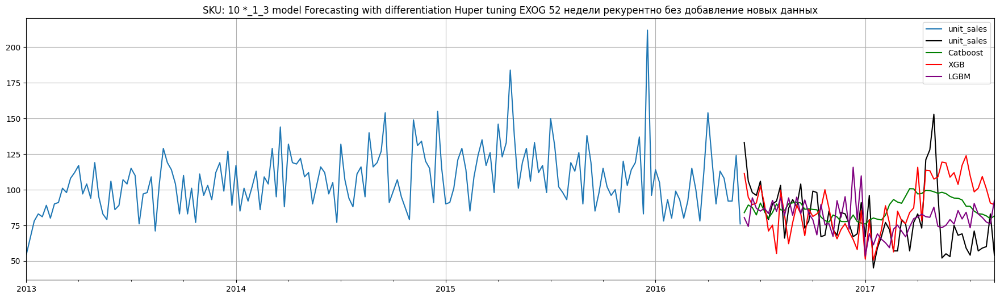

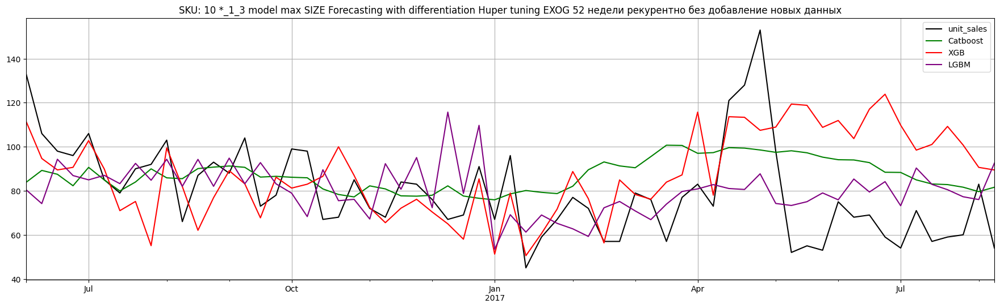

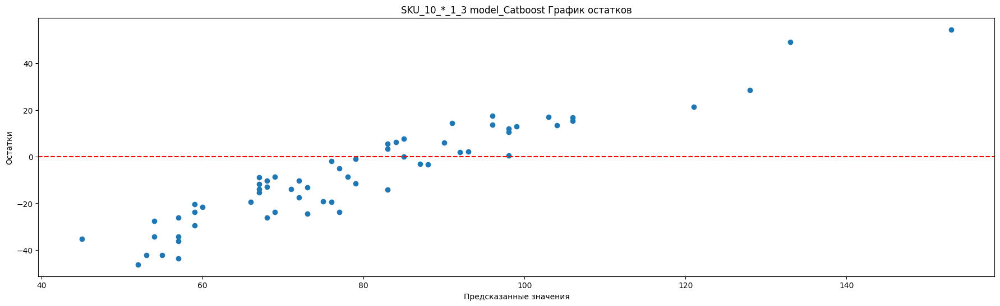

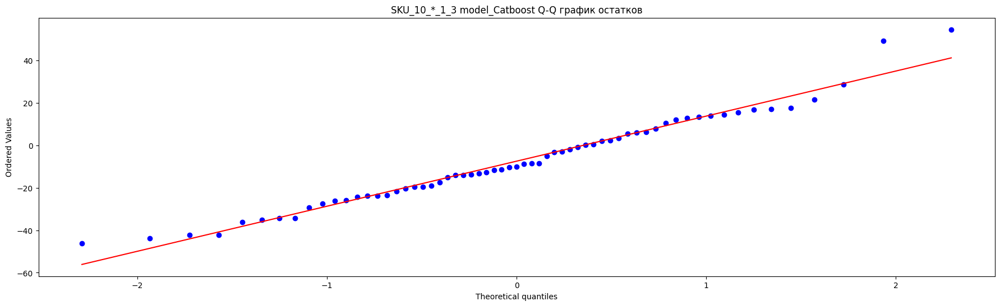

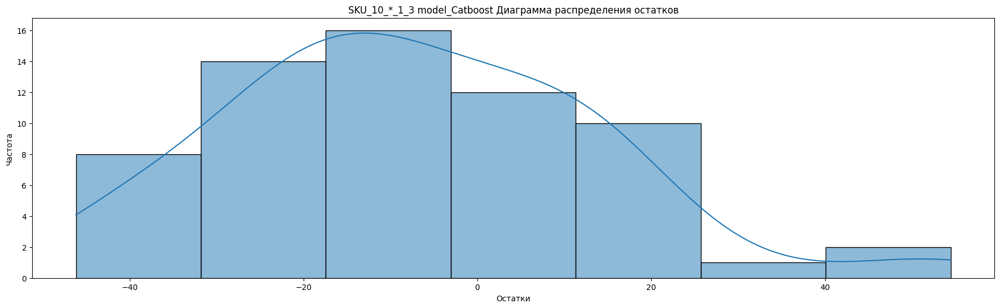

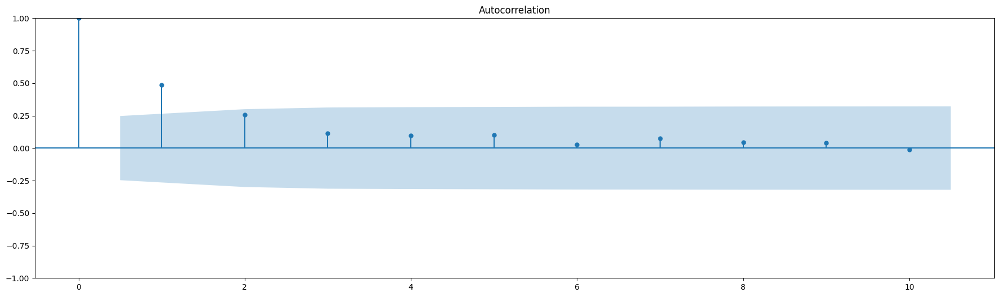

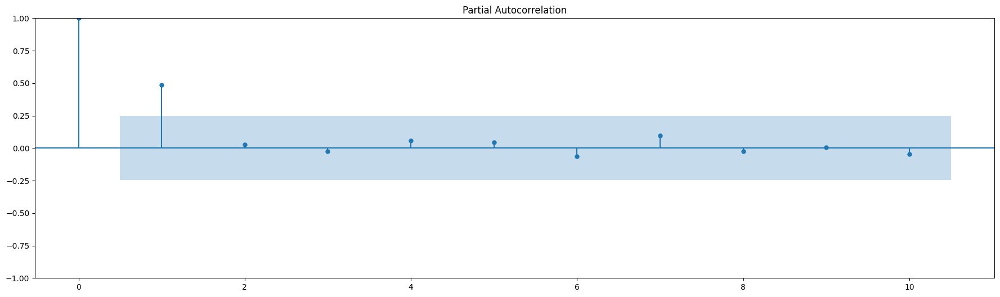


Статисткика по остаткам SKU_10_*_1_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9738643169403076
p-value Шапиро-Уилка : 0.19943924248218536

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1   15.546505   0.000081  14.828974   0.000118  не белый шум
2   19.964028   0.000046  18.974650   0.000076  не белый шум
3   20.872667   0.000112  19.813393   0.000186  не белый шум
4   21.530003   0.000249  20.410052   0.000414  не белый шум
5   22.227436   0.000474  21.032377   0.000799  не белый шум
6   22.276637   0.001079  21.075523   0.001778  не белый шум
7   22.700454   0.001922  21.440657   0.003170  не белый шум
8   22.851600   0.003560  21.568549   0.005781  не белый шум
9   22.981376   0.006238  21.676364   0.009963  не белый шум
10  22.994122   0.010768  21.686756   0.016782  не белый шум

Тест Дарбина-Уотсона: 0.7949621645283006
П

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


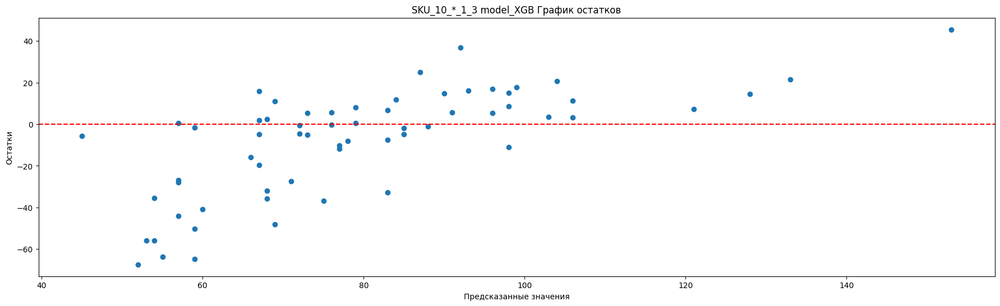

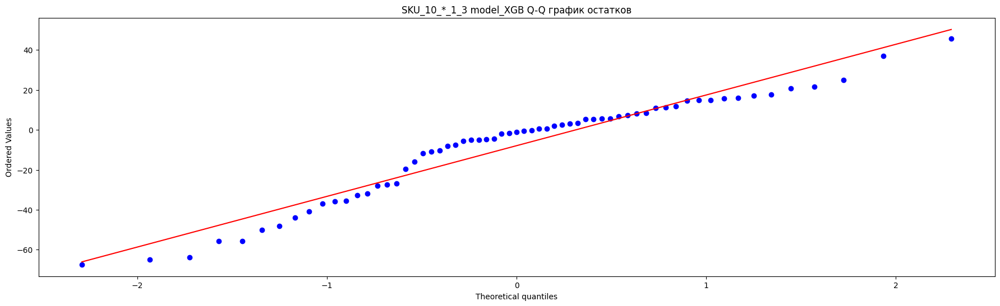

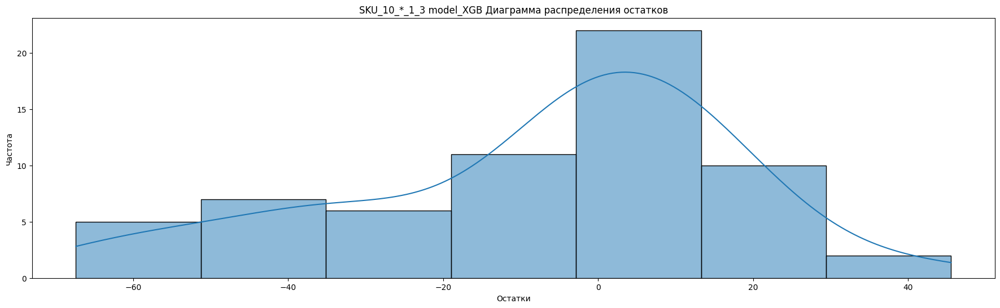

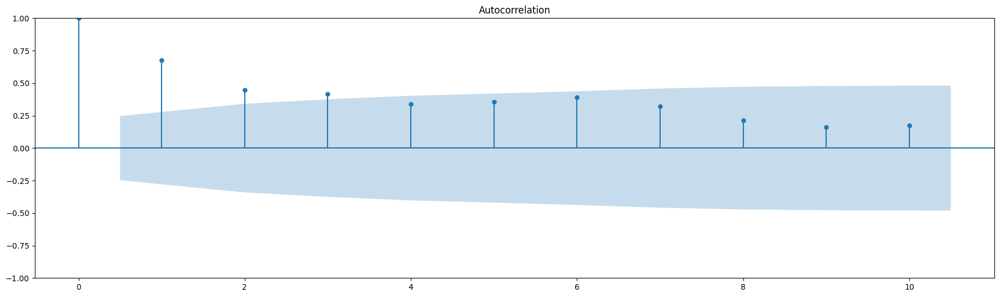

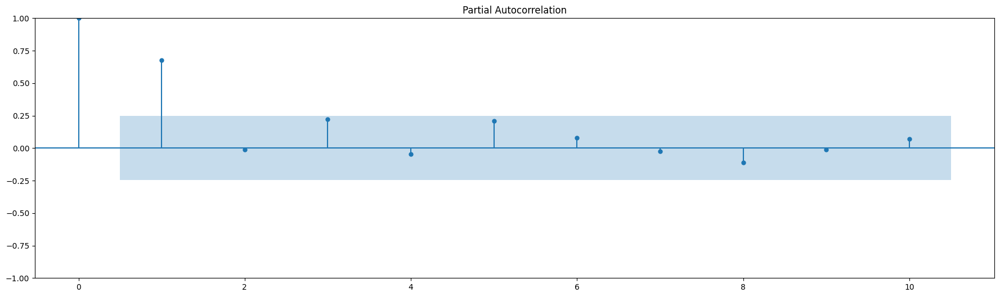


Статисткика по остаткам SKU_10_*_1_3 model_XGB
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9400218725204468
p-value Шапиро-Уилка : 0.004155442118644714

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   30.053481  4.202934e-08  28.666397  8.598284e-08  не белый шум
2   43.502701  3.576913e-10  41.287973  1.082506e-09  не белый шум
3   55.420482  5.584767e-12  52.289001  2.599037e-11  не белый шум
4   63.421485  5.532098e-13  59.551451  3.603919e-12  не белый шум
5   72.379594  3.274064e-14  67.544840  3.320275e-13  не белый шум
6   83.319461  7.356205e-16  77.138261  1.391873e-14  не белый шум
7   90.877579  8.169409e-17  83.649871  2.476134e-15  не белый шум
8   94.251465  6.354848e-17  86.504698  2.377257e-15  не белый шум
9   96.202775  9.200688e-17  88.125786  3.867291e-15  не белый шум
10  98.602231  1.037417e-16  90.082266  5.158

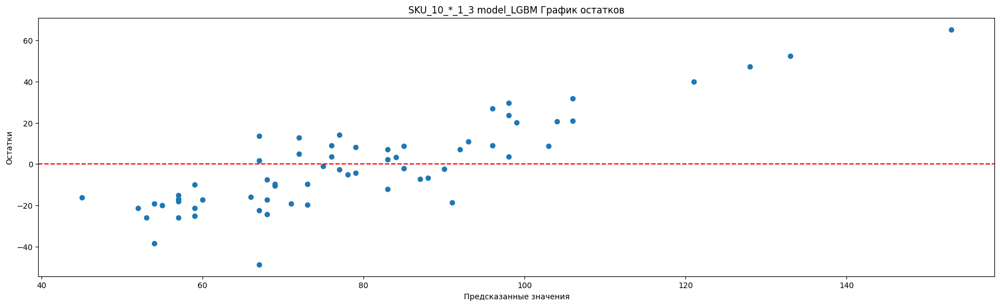

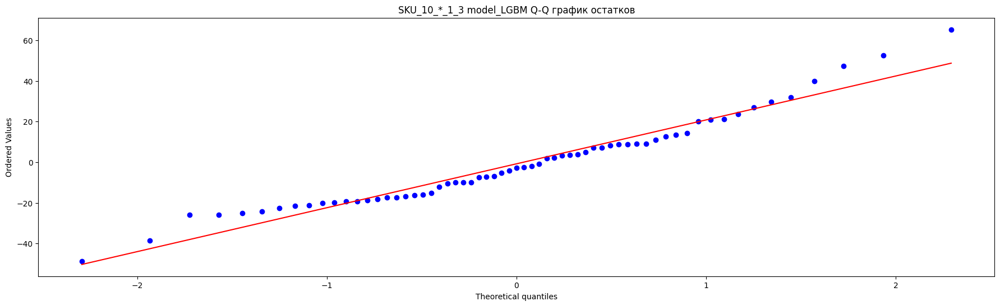

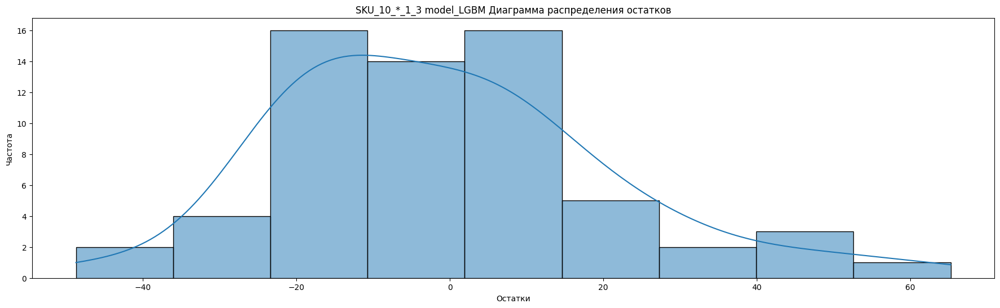

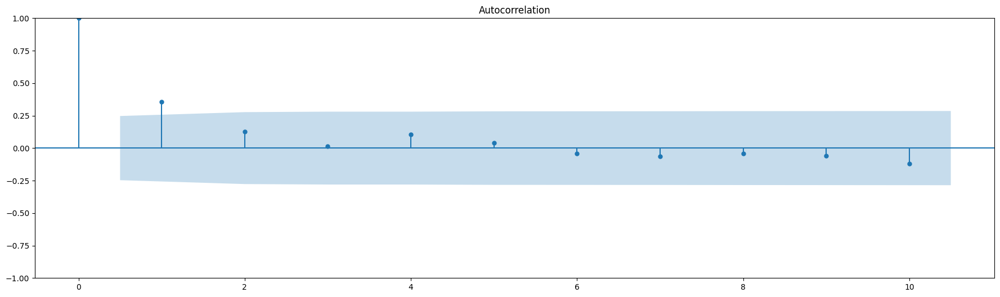

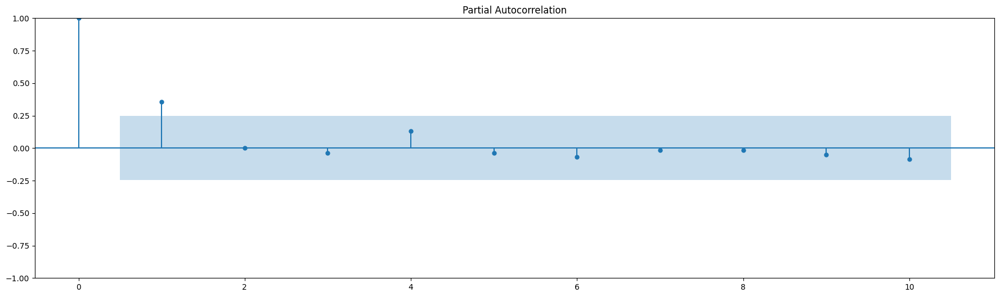


Статисткика по остаткам SKU_10_*_1_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.959530770778656
p-value Шапиро-Уилка : 0.036828335374593735

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    8.479832   0.003591   8.088455   0.004455  не белый шум
2    9.582676   0.008301   9.123431   0.010444  не белый шум
3    9.594117   0.022351   9.133993   0.027561  не белый шум
4   10.377339   0.034529   9.844918   0.043123  не белый шум
5   10.495375   0.062356   9.950242   0.076657     белый шум
6   10.610392   0.101190  10.051103   0.122516     белый шум
7   10.897754   0.143142  10.298676   0.172270     белый шум
8   11.016517   0.200765  10.399168   0.238119     белый шум
9   11.286674   0.256570  10.623606   0.302393     белый шум
10  12.426645   0.257517  11.553121   0.316077     белый шум

Тест Дарбина-Уотсона: 1.1344094718302742
От

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


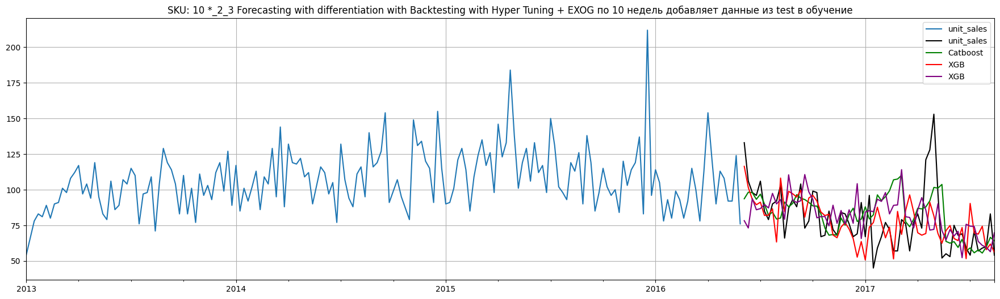

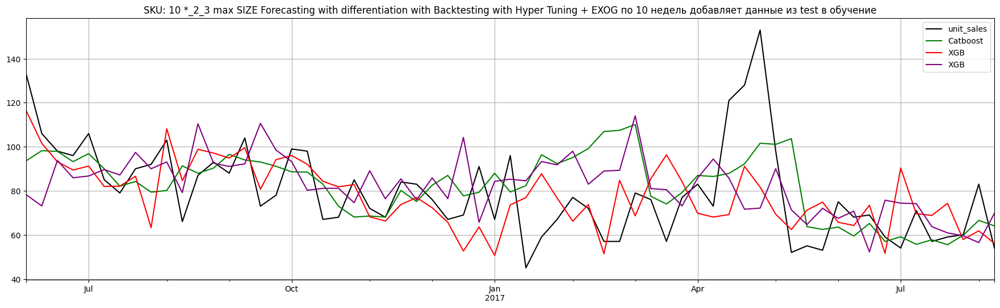

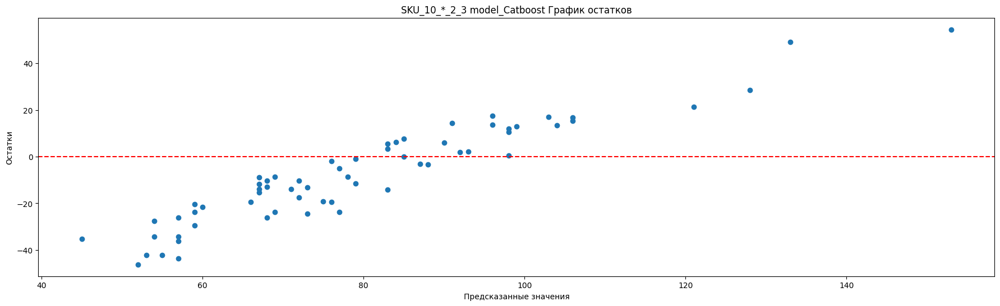

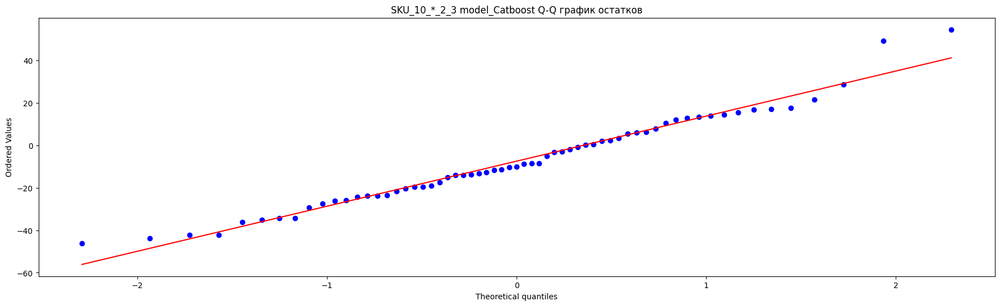

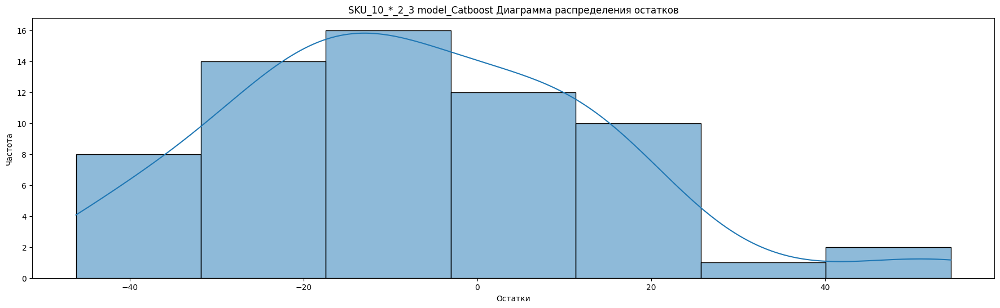

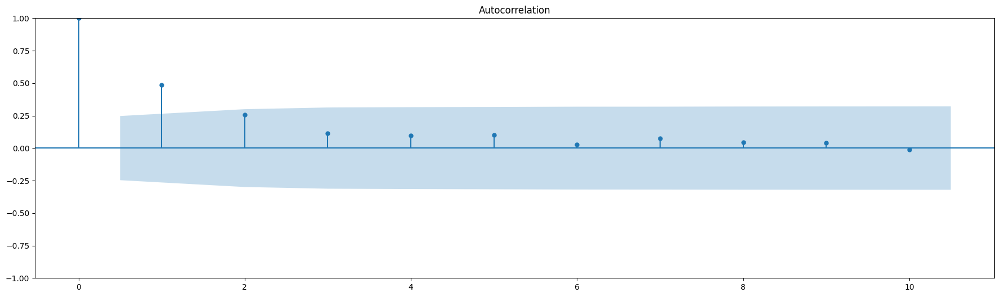

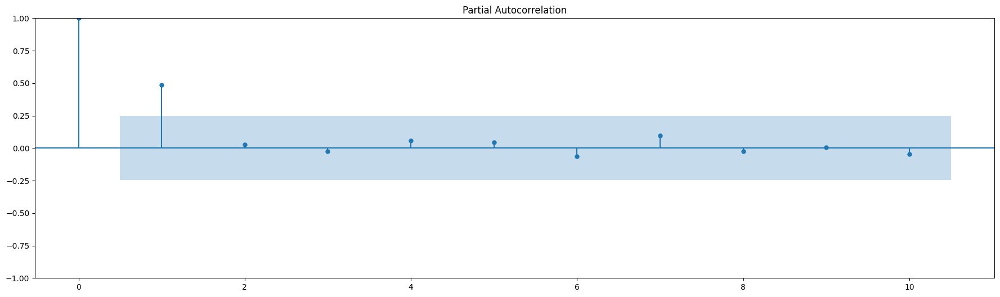


Статисткика по остаткам SKU_10_*_2_3 model_Catboost
Остатки временного ряда распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9738643169403076
p-value Шапиро-Уилка : 0.19943924248218536

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1   15.546505   0.000081  14.828974   0.000118  не белый шум
2   19.964028   0.000046  18.974650   0.000076  не белый шум
3   20.872667   0.000112  19.813393   0.000186  не белый шум
4   21.530003   0.000249  20.410052   0.000414  не белый шум
5   22.227436   0.000474  21.032377   0.000799  не белый шум
6   22.276637   0.001079  21.075523   0.001778  не белый шум
7   22.700454   0.001922  21.440657   0.003170  не белый шум
8   22.851600   0.003560  21.568549   0.005781  не белый шум
9   22.981376   0.006238  21.676364   0.009963  не белый шум
10  22.994122   0.010768  21.686756   0.016782  не белый шум

Тест Дарбина-Уотсона: 0.7949621645283006
П

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


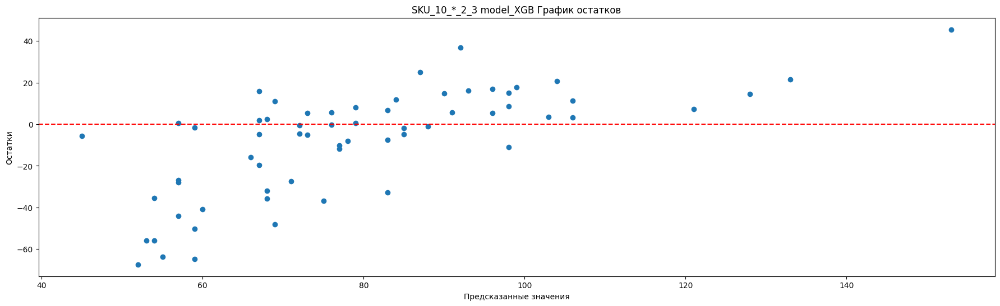

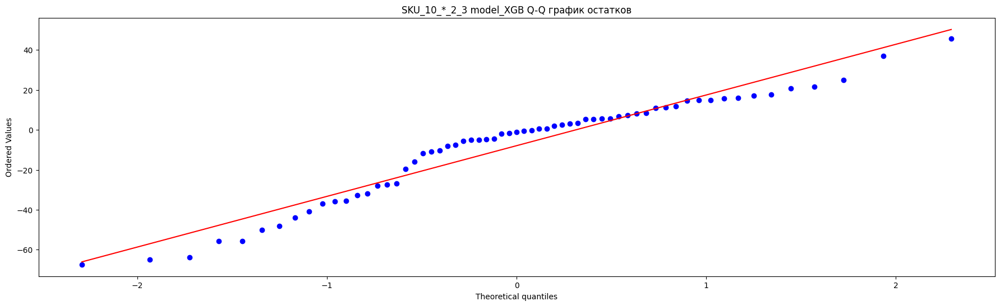

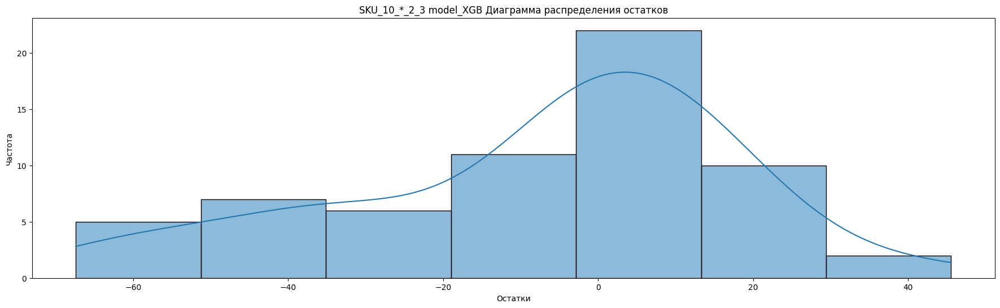

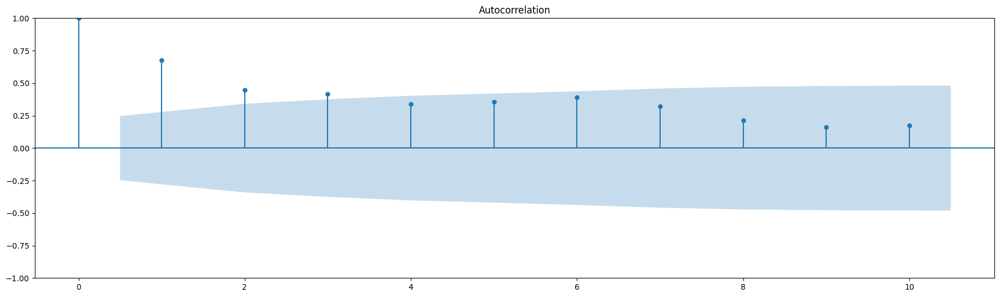

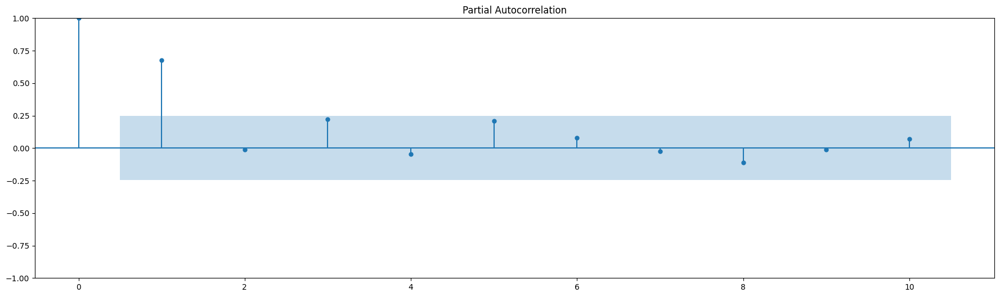


Статисткика по остаткам SKU_10_*_2_3 model_XGB
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.9400218725204468
p-value Шапиро-Уилка : 0.004155442118644714

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat     lb_pvalue    bp_stat     bp_pvalue        result
1   30.053481  4.202934e-08  28.666397  8.598284e-08  не белый шум
2   43.502701  3.576913e-10  41.287973  1.082506e-09  не белый шум
3   55.420482  5.584767e-12  52.289001  2.599037e-11  не белый шум
4   63.421485  5.532098e-13  59.551451  3.603919e-12  не белый шум
5   72.379594  3.274064e-14  67.544840  3.320275e-13  не белый шум
6   83.319461  7.356205e-16  77.138261  1.391873e-14  не белый шум
7   90.877579  8.169409e-17  83.649871  2.476134e-15  не белый шум
8   94.251465  6.354848e-17  86.504698  2.377257e-15  не белый шум
9   96.202775  9.200688e-17  88.125786  3.867291e-15  не белый шум
10  98.602231  1.037417e-16  90.082266  5.158

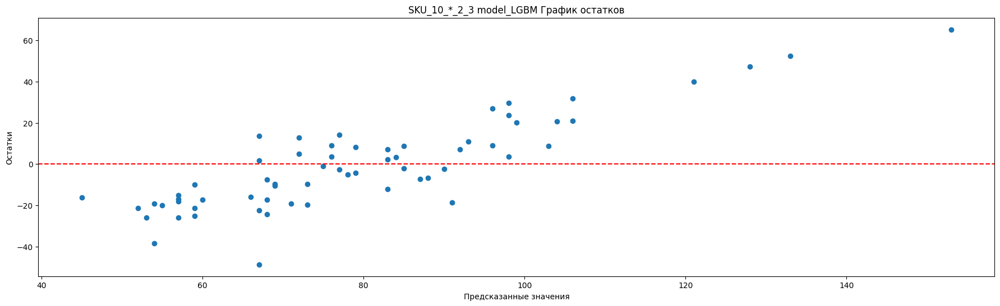

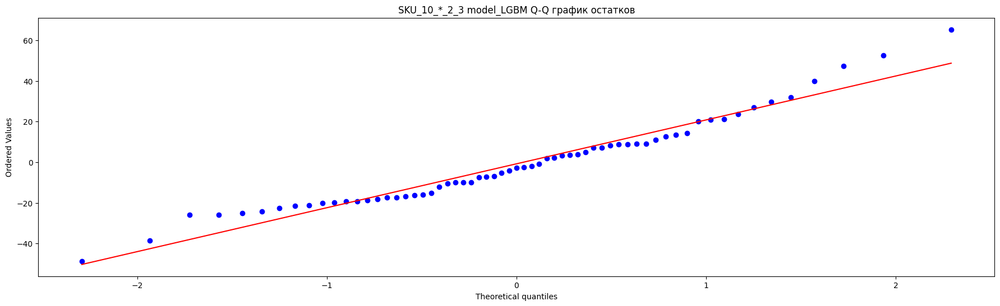

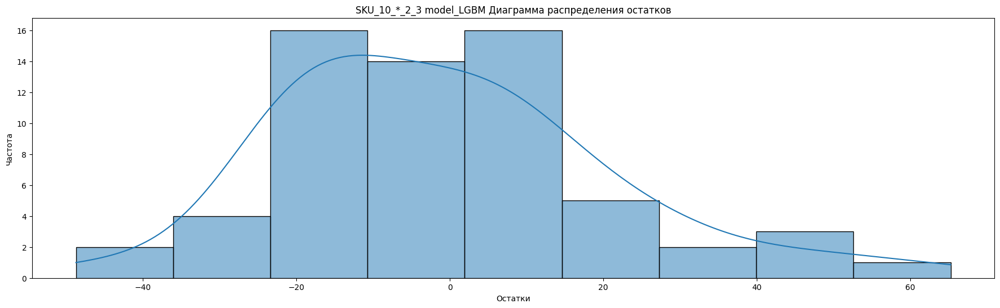

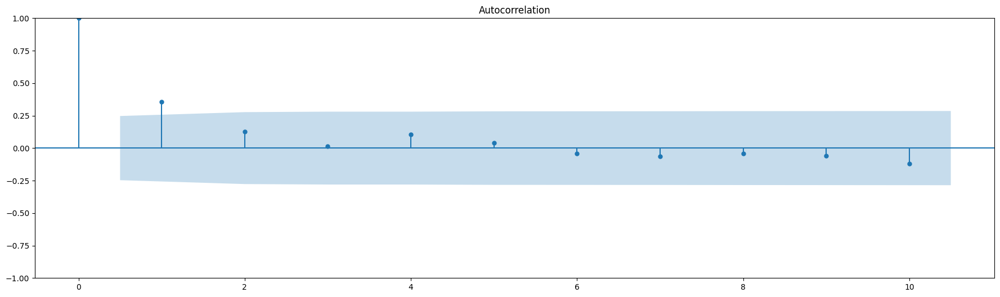

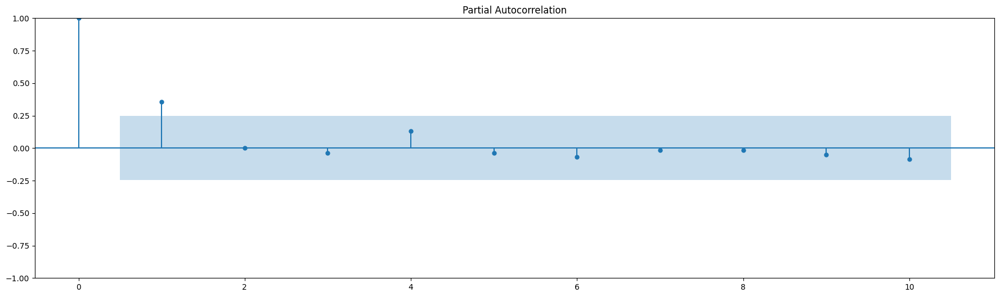


Статисткика по остаткам SKU_10_*_2_3 model_LGBM
Остатки временного ряда НЕ распределены согласно нормальному закону
Статистика теста Шапиро-Уилка : 0.959530770778656
p-value Шапиро-Уилка : 0.036828335374593735

Тест Бокса-Пирса (BP) и Льюнга-Бокса (LB) на определение шума в остатках
      lb_stat  lb_pvalue    bp_stat  bp_pvalue        result
1    8.479832   0.003591   8.088455   0.004455  не белый шум
2    9.582676   0.008301   9.123431   0.010444  не белый шум
3    9.594117   0.022351   9.133993   0.027561  не белый шум
4   10.377339   0.034529   9.844918   0.043123  не белый шум
5   10.495375   0.062356   9.950242   0.076657     белый шум
6   10.610392   0.101190  10.051103   0.122516     белый шум
7   10.897754   0.143142  10.298676   0.172270     белый шум
8   11.016517   0.200765  10.399168   0.238119     белый шум
9   11.286674   0.256570  10.623606   0.302393     белый шум
10  12.426645   0.257517  11.553121   0.316077     белый шум

Тест Дарбина-Уотсона: 1.1344094718302742
От

<ipython-input-11-0378c106cb67>:88: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat,p_value, lags,crit = kpss(residuals,regression = 'ct')


In [ ]:
for sku in range(1,11):
    even_df = filtered_grouped_data[filtered_grouped_data['store_nbr']==sku][['date','unit_sales']]
    even_df['date'] = pd.to_datetime(even_df['date'])
    even_df = even_df.set_index('date')
    even_df = even_df.asfreq('D')
    weekly_df = even_df.resample('W').sum()


    func_model(weekly_df[:-1],sku)
    # static_stacionar(weekly_df[:-1], sku)